In [134]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.image as mpimg
import cv2
import matplotlib.cm as cm
from pdf2image import convert_from_path  
pd.options.display.max_columns = None
import pickle
import seaborn as sns

#csvファイルを読み込んで名前を付け開始時間を０：００にする
def load(a):
    df = pd.read_csv(a+"_gazedata.csv")
    feature = ["time","x","y"]
    df.columns=feature
#     df["time"]=df["time"]-min(df["time"])
    return df

#y軸を反転させて画像の左右を切り取る
def translate(df):
#     data["y"]=data["y"].max()-data["y"]
    df["x"]=df["x"]-350
    df["x"][df["x"]<0]=0
    df["x"][df["x"]>900]=900
    return df

def plot_color(df,img):

    dfx = df["x"].values
    dfy = df["y"].values
    plt.plot(dfx,dfy)
    plt.imshow(img)
    plt.xlim(0,1280)
    plt.ylim(0,720)
    plt.show()

#範囲チェック用関数 ,座標の位置、範囲を確認する
def green_circle(im,x,y,r=20):
    cv2.circle(im, (x, y), r, color=(245, 0,0 ), thickness=2)


In [548]:
def time_y_plot_sub(df4,title=0):
    plt.figure(figsize=(15,5))
    sns.set_style("white")
    plt.title(str(title))
    plt.ylim(1050,0)
    p = plt.hlines([82], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([157], df4["time"].min(), df4["time"].max(), "green", linestyles='dashed')
    p = plt.hlines([232], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([382], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([532], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([682], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([832], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([982], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    plt.plot(df4["time"],df4["y"],color="b")

In [356]:
np.set_printoptions(precision=4, floatmode='maxprec')

In [3]:
cd Desktop/gaze_data/

/Users/hasegawatakashikana/Desktop/gaze_data


In [4]:
gl = globals()
for i in range(24):                     #24
    data_name = "e"+str(i+1)
    gl[data_name]= load(data_name)

In [106]:
for i in range(2,5):
    print(i)

2
3
4


In [5]:
t_1 = 5
t_2 = t_1 + 5
t_3 = t_2 + 5
ts_1= t_3 + 5
te_1 = ts_1 + 30
for i in range(2,16):
    start_name = "ts_"+str(i)
    end_name = "te_"+str(i)
    before_name = "te_" + str(i-1)
    gl[start_name]=gl[before_name]+5
    gl[end_name]=gl[start_name]+30
for i in range(1,4):
    for j in range(1,16):
        name = "df_"+str(i)+"_"+str(j)
        data_name = "e"+str(i)
        s_name = "ts_"+str(j)
        e_name = "te_"+str(j)
        df = gl[data_name]
        df = df[df["time"]>gl[s_name]]
        df = df[df["time"]<gl[e_name]]
        gl[name] = df

t_4 = t_3 + 5
t_5 = t_4 + 5
t_6 = t_5 + 5
t_7 = t_6 + 5
ts_1= t_7 + 5
te_1 = ts_1 + 30
for i in range(2,16):
    start_name = "ts_"+str(i)
    end_name = "te_"+str(i)
    before_name = "te_" + str(i-1)
    gl[start_name]=gl[before_name]+5
    gl[end_name]=gl[start_name]+30
for i in range(4,25):
    for j in range(1,16):
        name = "df_"+str(i)+"_"+str(j)
        data_name = "e"+str(i)
        s_name = "ts_"+str(j)
        e_name = "te_"+str(j)
        df = gl[data_name]
        df = df[df["time"]>gl[s_name]]
        df = df[df["time"]<gl[e_name]]
        gl[name] = df



In [166]:
df = [df_1,df_2,df_3,df_4,df_5,df_6,df_7,df_8,df_9,df_10,df_11,df_12,df_13,df_14,df_15]
with open('data.pickle', mode='wb') as fo:
    pickle.dump(df, fo)

In [72]:
df = pd.read_pickle('data.pickle')

In [73]:
for i in range(1,16):
    name = "df_"+str(i)
    gl[name]=df[i-1]

In [566]:
df_15

[             time          x          y  velo
 23868  405.005621  1035.0750  503.25400     0
 23869  405.021937   889.8616  478.27680     0
 23870  405.039035   889.8616  478.27680     0
 23871  405.055199   889.8616  478.27680     0
 23872  405.072461   907.1117  500.47400     0
 23873  405.089236   907.1117  500.47400     0
 23874  405.108780  1022.2370  557.24820     0
 23875  405.128499  1022.2370  557.24820     0
 23876  405.140443  1022.2370  557.24820     0
 23877  405.155396   932.1291  498.52490     0
 23878  405.172576   932.1291  498.52490     0
 23879  405.188890  1024.7780  553.37750     0
 23880  405.206527  1015.9100  561.95680     0
 23881  405.222586  1015.9100  561.95680     0
 23882  405.239980  1015.8810  544.62060     0
 23883  405.256677  1015.8810  544.62060     0
 23884  405.273349  1024.4810  547.70150     0
 23885  405.289366  1026.8670  542.54580     0
 23886  405.306406  1026.8670  542.54580     0
 23887  405.322577  1036.5980  520.49350     0
 23888  405.3

In [551]:
#終了ゾーンの表示をどうするか
def finish(d):
    if d["x"] > 1100 : 
        return 1080
    else:
        return d["y"]

変数名一覧

df_n ：n課題目のデータ[一人目の1課題目のデータ、二人目の1課題目のデータ、・・・]

e_n_check_all ：n人目の35秒までのデータ

check_line_of_en：n人目の各行のチェック時の平均[１行目、２行目、３行目]


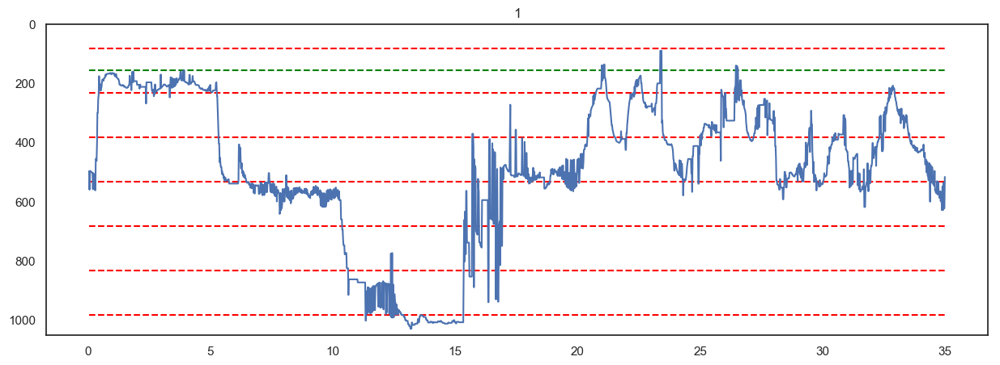

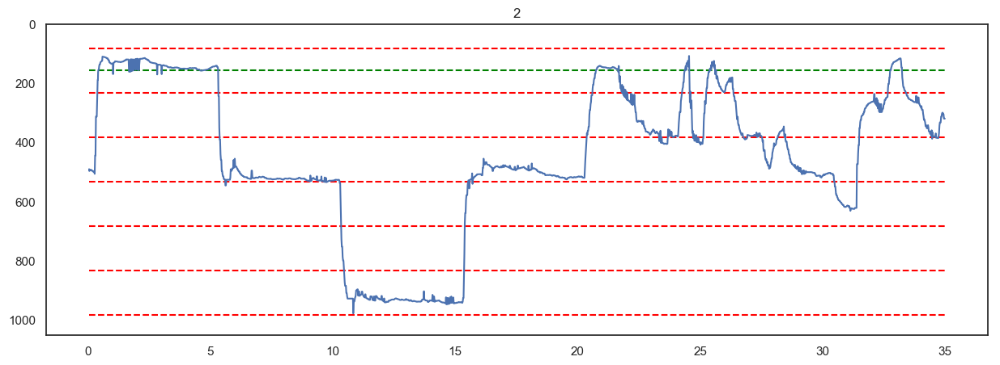

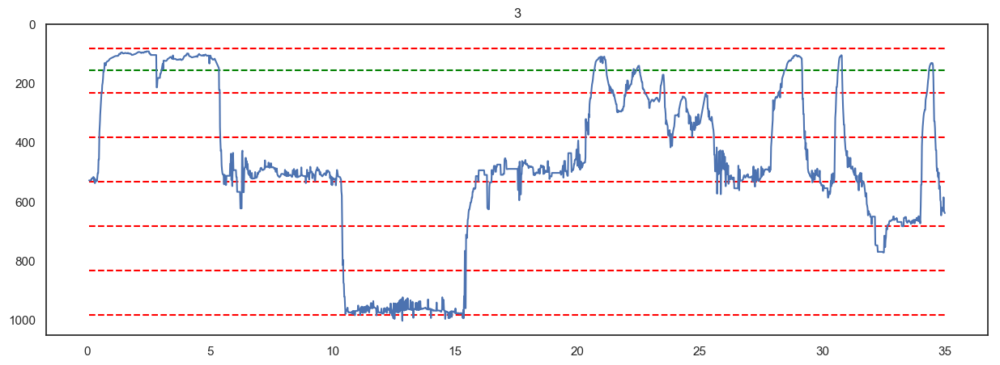

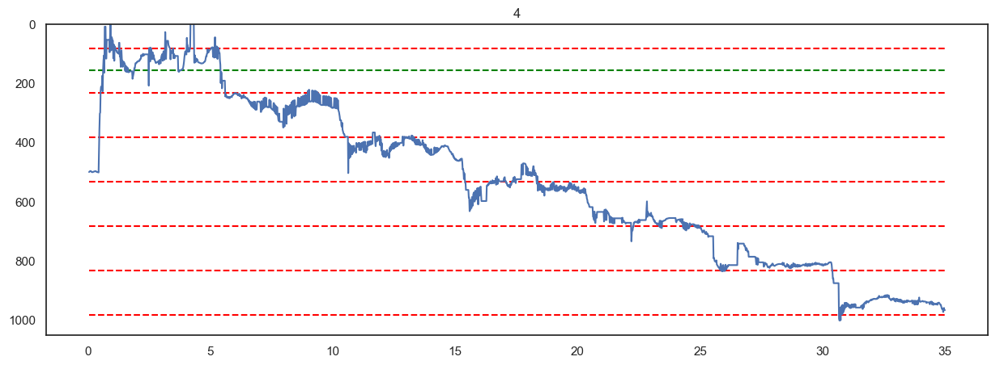

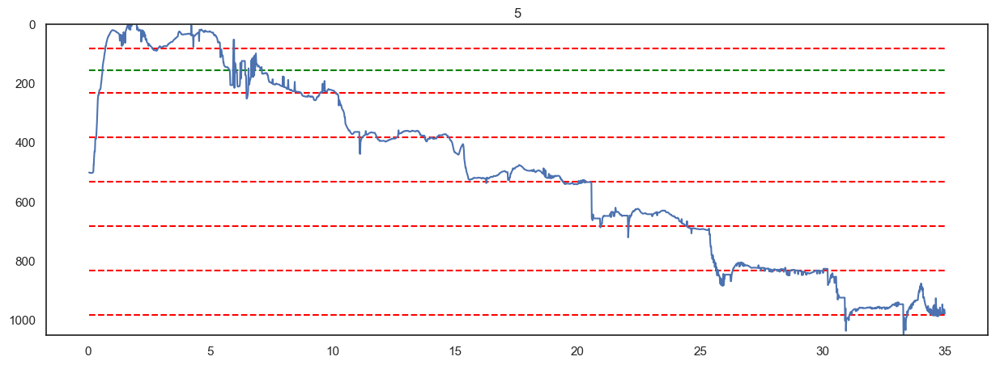

...

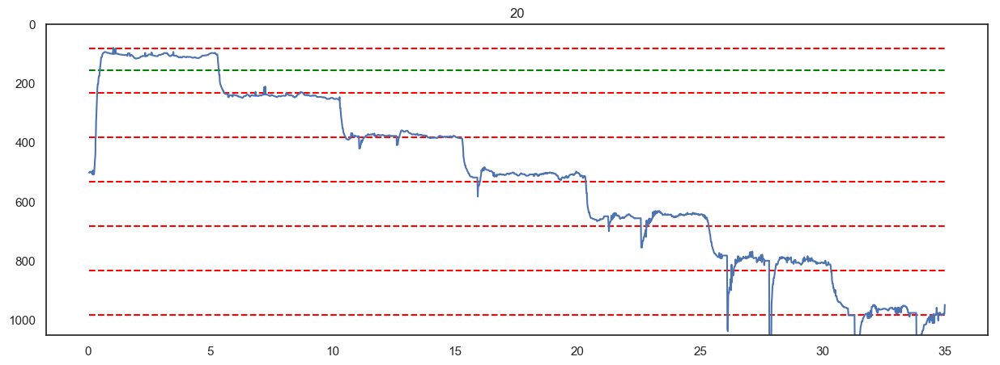

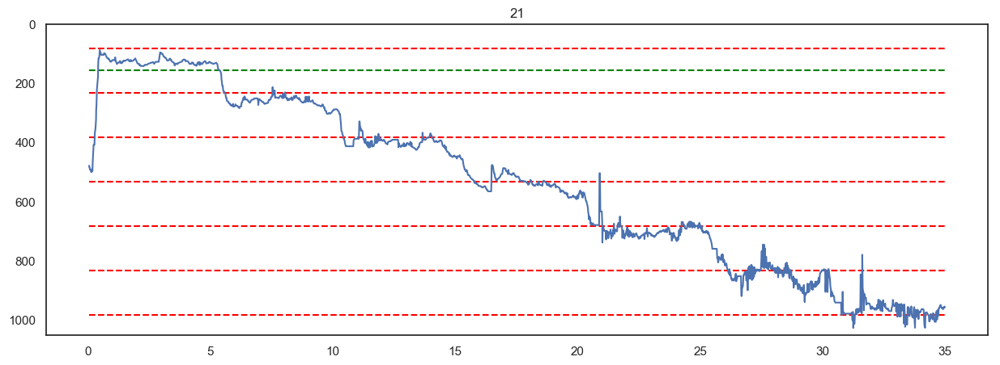

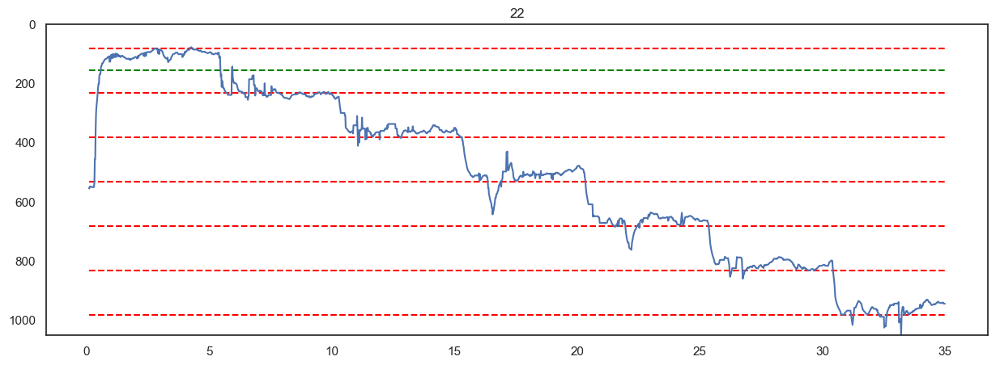

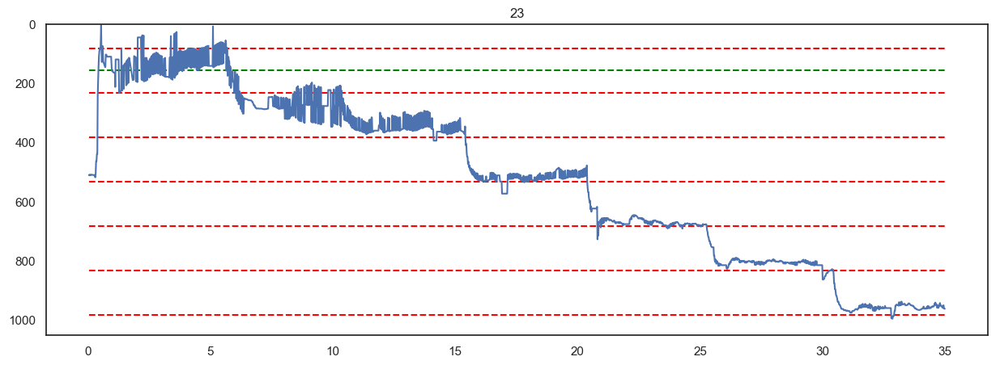

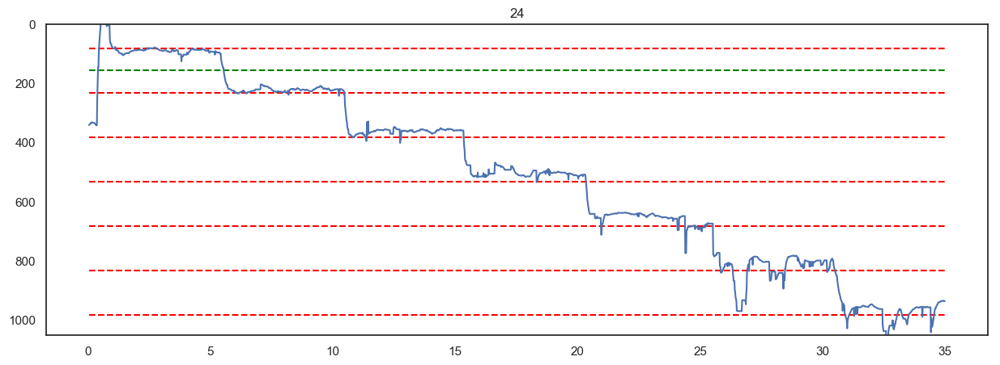

In [549]:
for i in range(1,25):
    name = "e"+str(i)+"_check_all"
    df = gl[name]
    time_y_plot_sub(df,title=i)

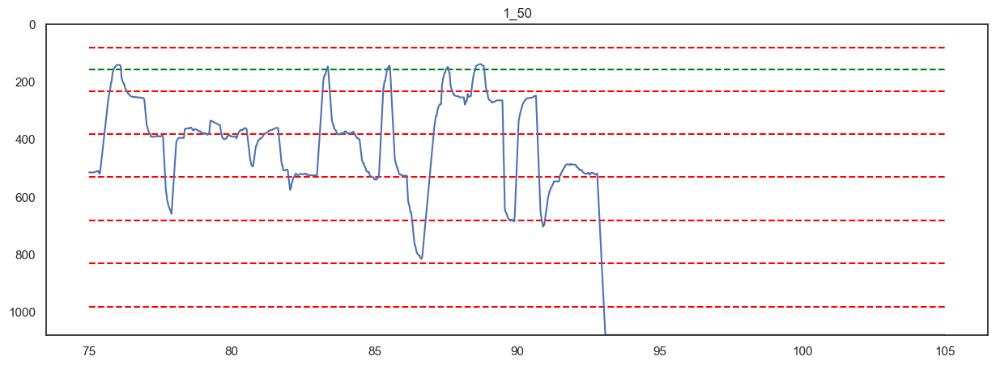

In [556]:
check_y_plot(df_3[5],title=1,fix_time=0.1)

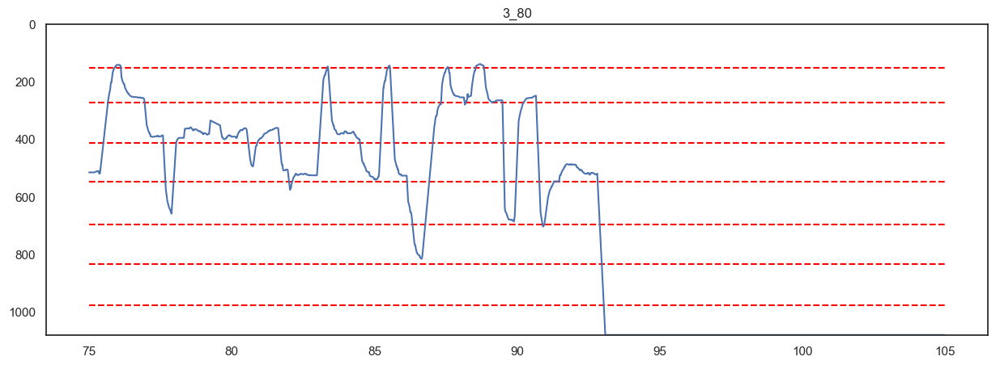

In [775]:

check_y_plot_revise(df4=df_3[5],fix_time=0.1,m=3,n=6)

In [6]:
for i in range(1,4):
    name = "e"+str(i)
    df = gl[name]
    name = "check_line_of_e"+str(i)
    a = np.array([])
    for j in range(1,4):
        t1 = 5*(j-1)+2
        t2 = 5 * j
        t = df[df["time"]>t1]
        t = t[t["time"]<t2]
        a = np.append(a,t["y"].mean())
    gl[name]=a
        

In [ ]:
check_line_of_e1

In [10]:
check_line_of_e1 = np.insert(check_line_of_e1,1,(2*check_line_of_e1[0]+check_line_of_e1[1])/3)
check_line_of_e1= np.insert(check_line_of_e1,2,(2*check_line_of_e1[1]-check_line_of_e1[0]))
check_line_of_e1 = np.insert(check_line_of_e1,4,(2*check_line_of_e1[3]+check_line_of_e1[4])/3)
check_line_of_e1= np.insert(check_line_of_e1,5,(2*check_line_of_e1[4]-check_line_of_e1[3]))
check_line_of_e1

array([205.79395587, 327.62773556, 449.46151525, 571.29529494,
       708.49938695, 845.70347895, 982.90757095])

In [11]:
check_line_of_e2 = np.insert(check_line_of_e2,1,(2*check_line_of_e2[0]+check_line_of_e2[1])/3)
check_line_of_e2= np.insert(check_line_of_e2,2,(2*check_line_of_e2[1]-check_line_of_e2[0]))
check_line_of_e2 = np.insert(check_line_of_e2,4,(2*check_line_of_e2[3]+check_line_of_e2[4])/3)
check_line_of_e2= np.insert(check_line_of_e2,5,(2*check_line_of_e2[4]-check_line_of_e2[3]))
check_line_of_e2

array([142.12109111, 269.35480185, 396.58851259, 523.82222333,
       660.5956407 , 797.36905806, 934.14247542])

In [12]:
check_line_of_e3 = np.insert(check_line_of_e3,1,(2*check_line_of_e3[0]+check_line_of_e3[1])/3)
check_line_of_e3= np.insert(check_line_of_e3,2,(2*check_line_of_e3[1]-check_line_of_e3[0]))
check_line_of_e3 = np.insert(check_line_of_e3,4,(2*check_line_of_e3[3]+check_line_of_e3[4])/3)
check_line_of_e3= np.insert(check_line_of_e3,5,(2*check_line_of_e3[4]-check_line_of_e3[3]))
check_line_of_e3

array([113.92811511, 243.52571522, 373.12331532, 502.72091543,
       656.23902968, 809.75714394, 963.27525819])

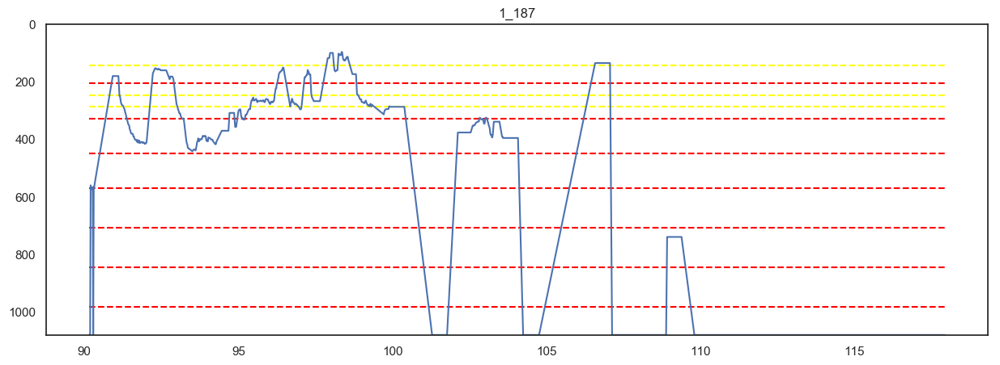

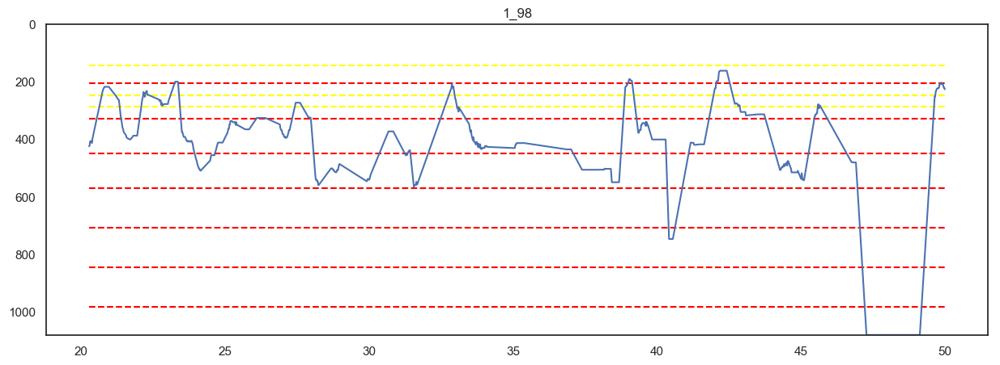

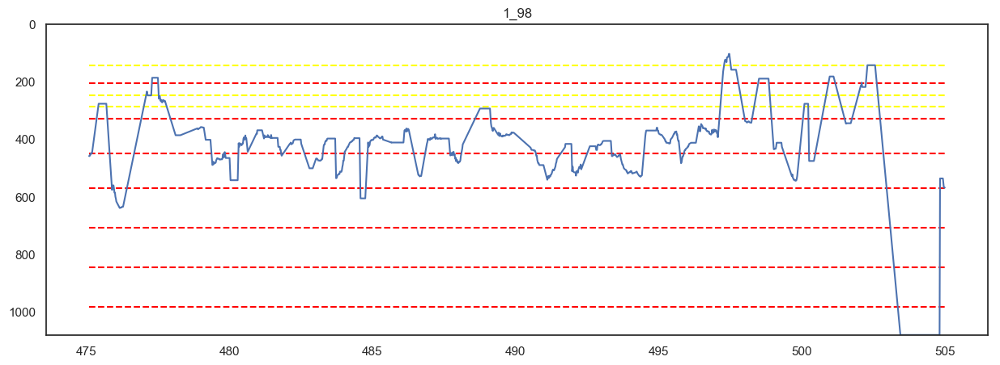

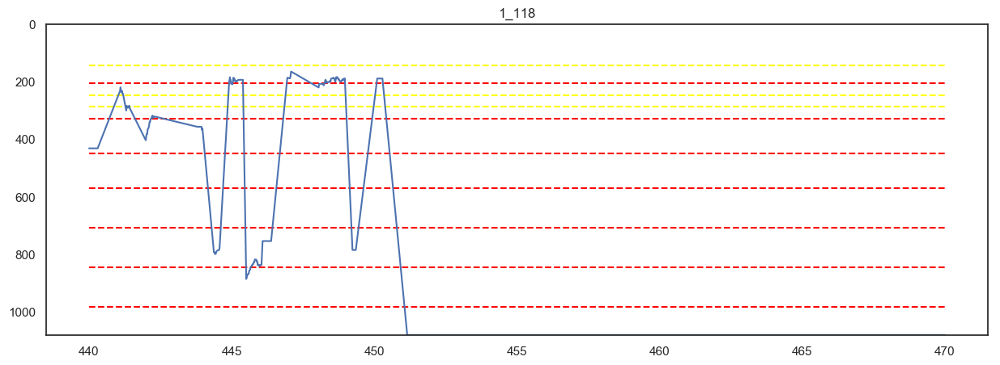

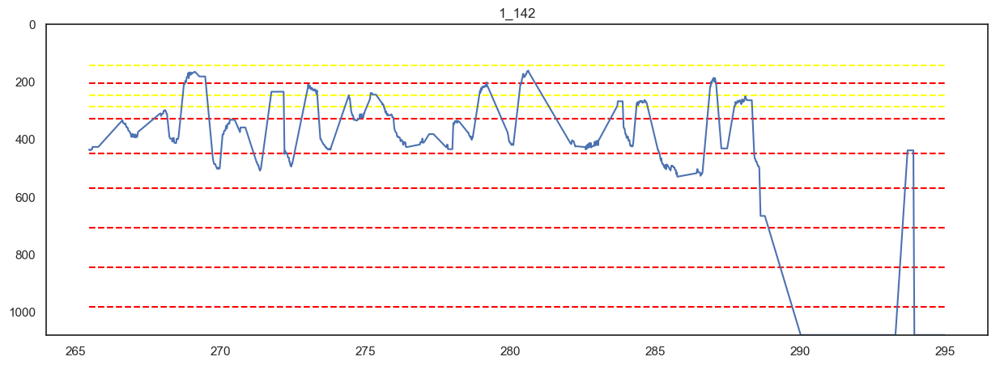

...

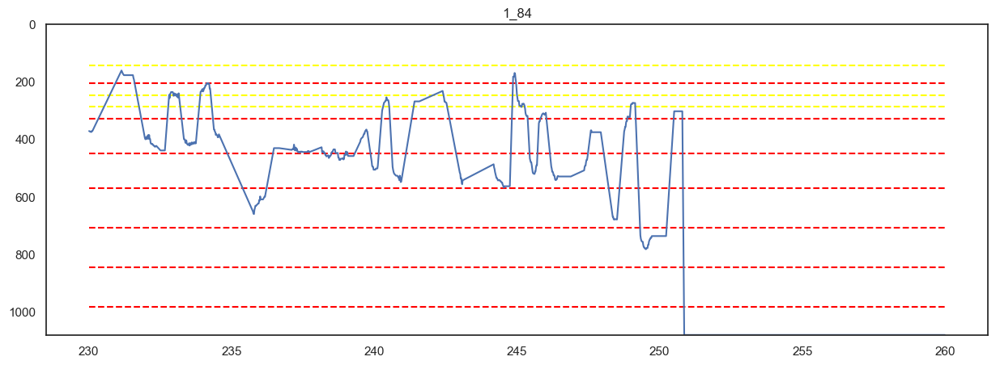

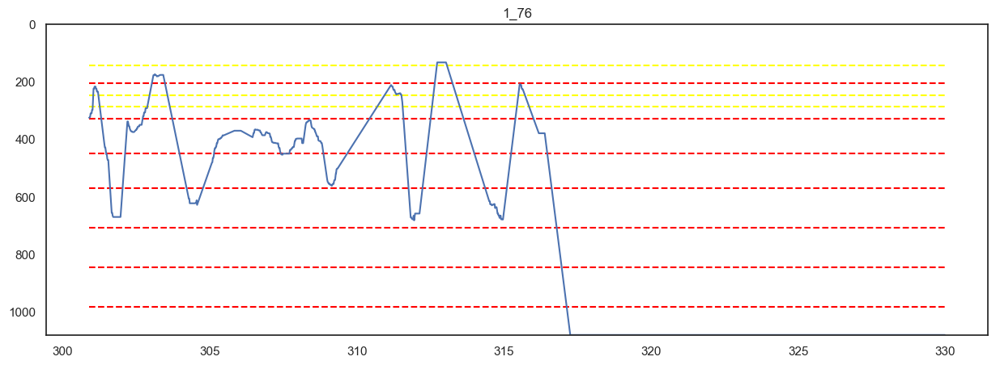

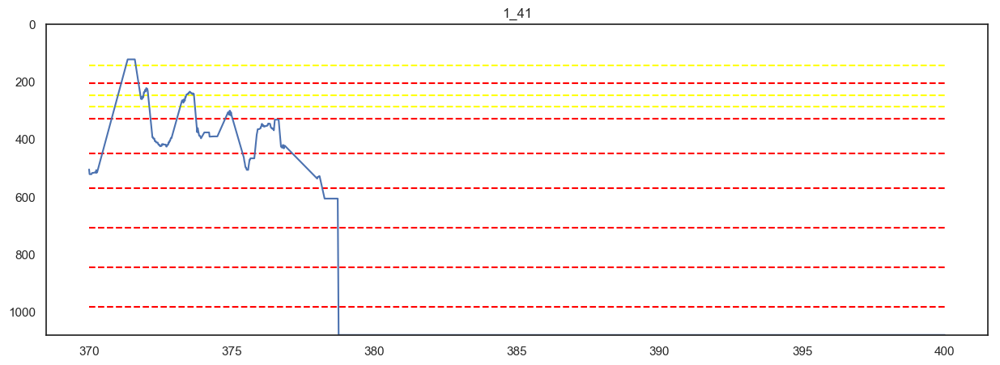

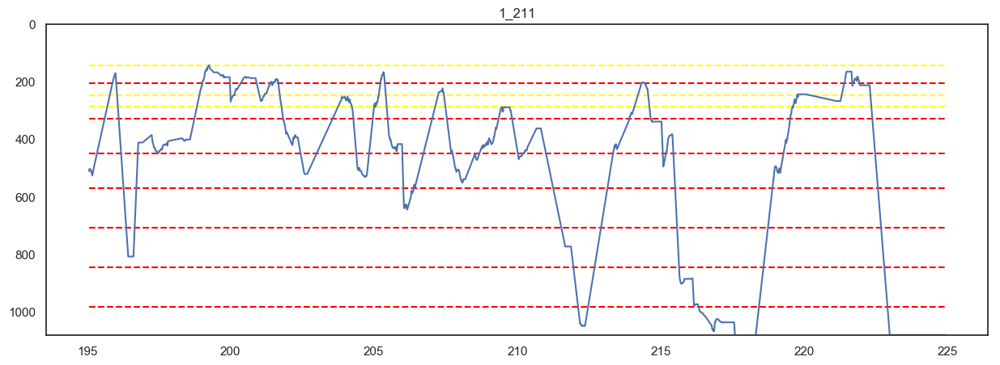

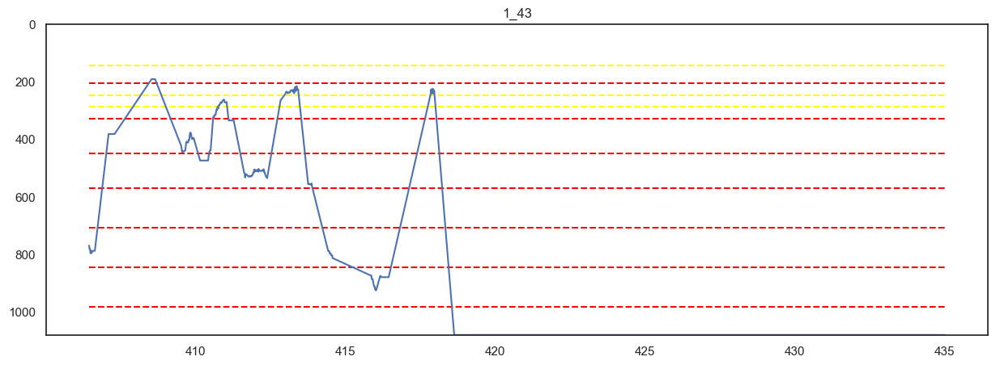

In [1320]:
for i in range(1,16):
    df = gl["df_"+str(i)]
    check_y_plot_revise(df[0],n=1,fix_time=0.1)

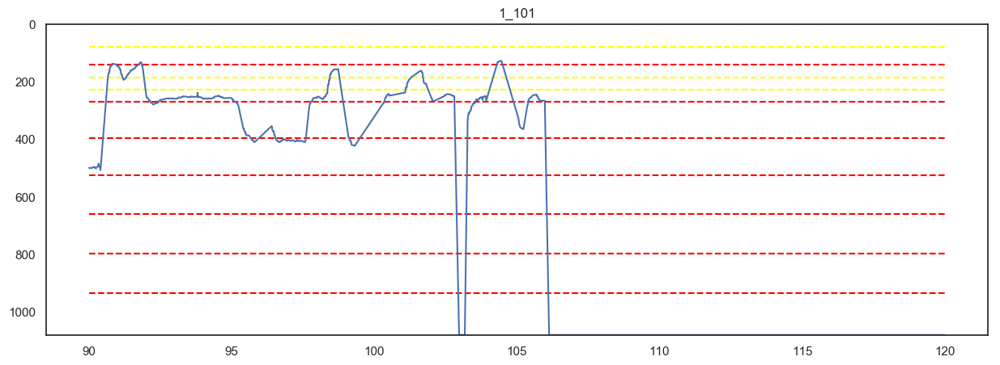

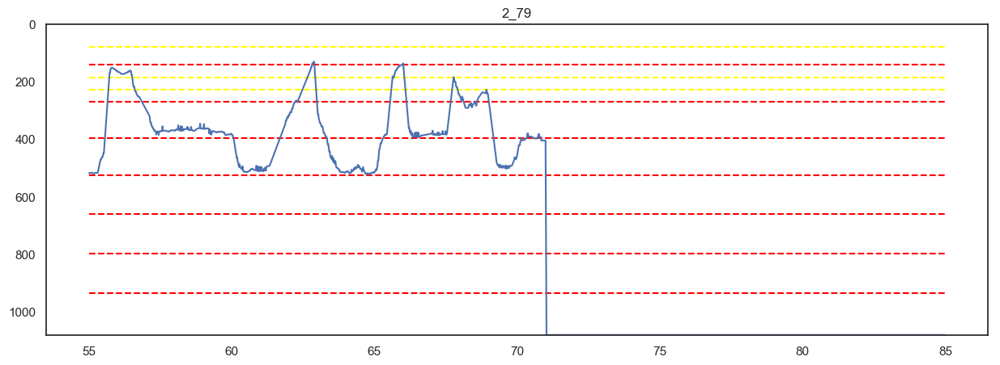

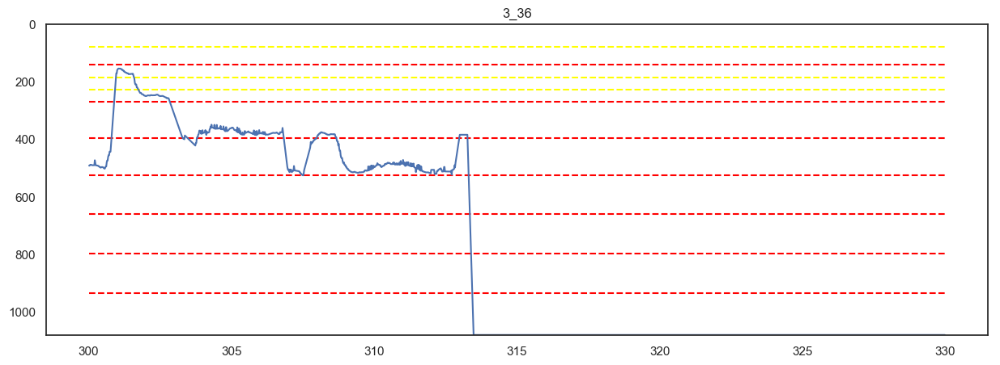

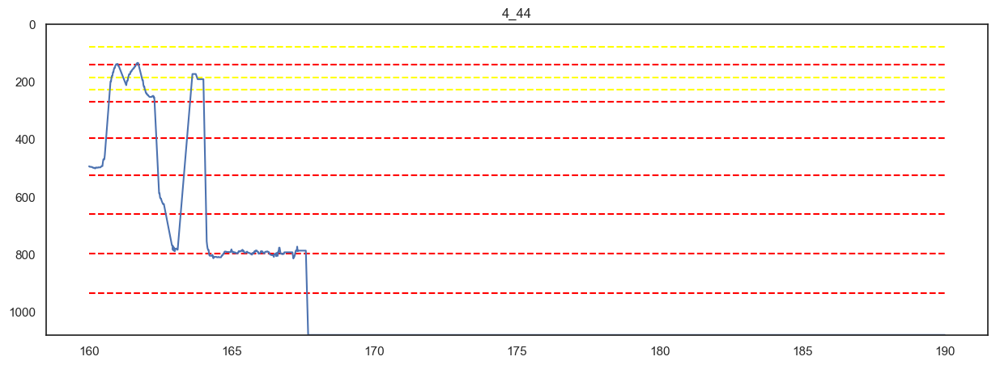

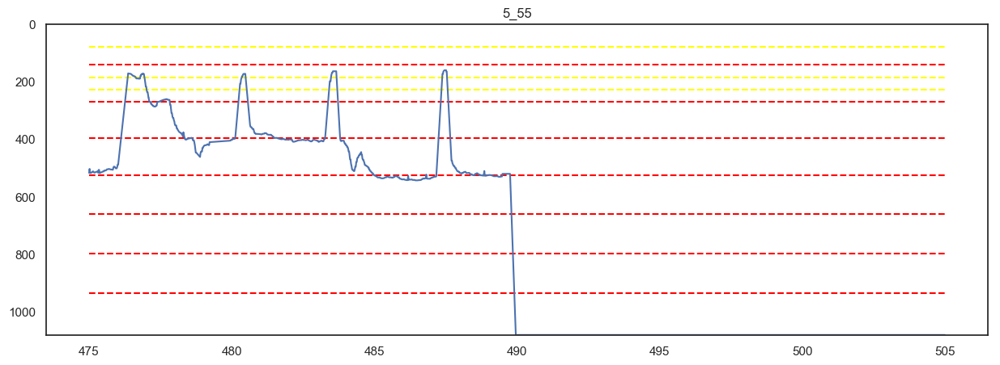

...

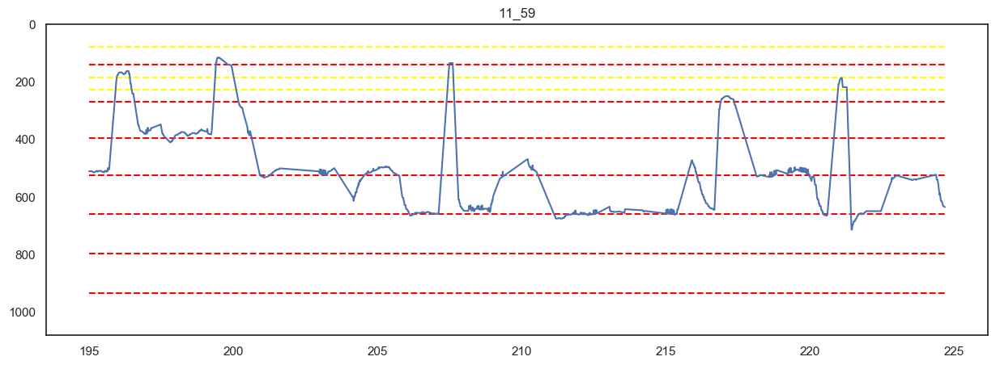

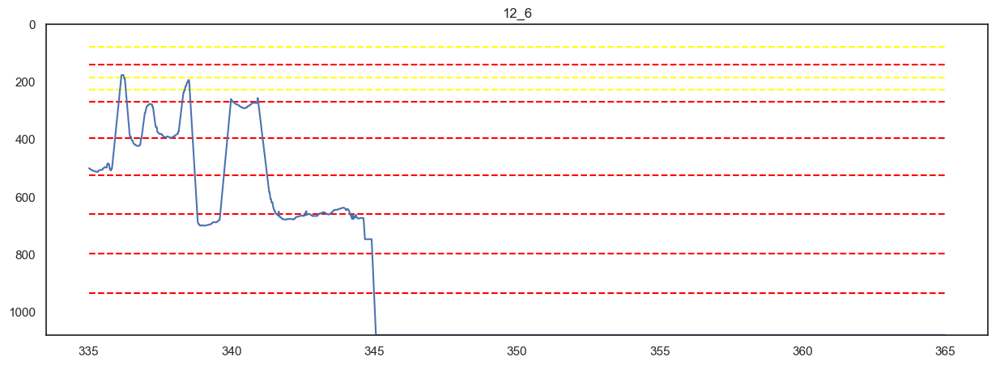

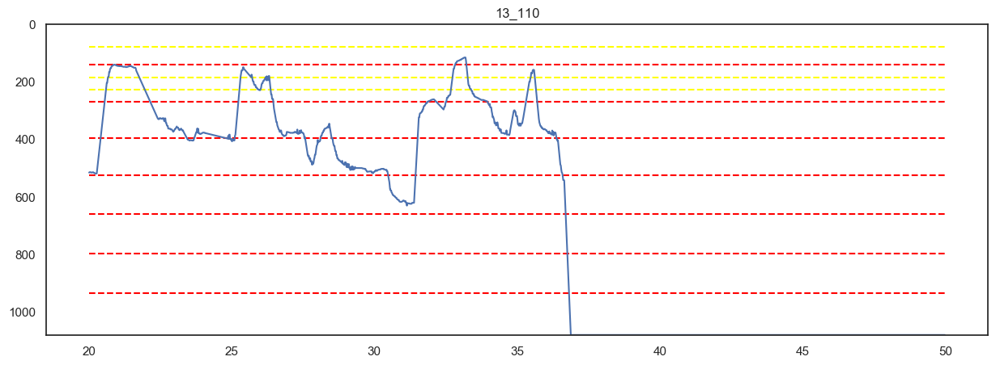

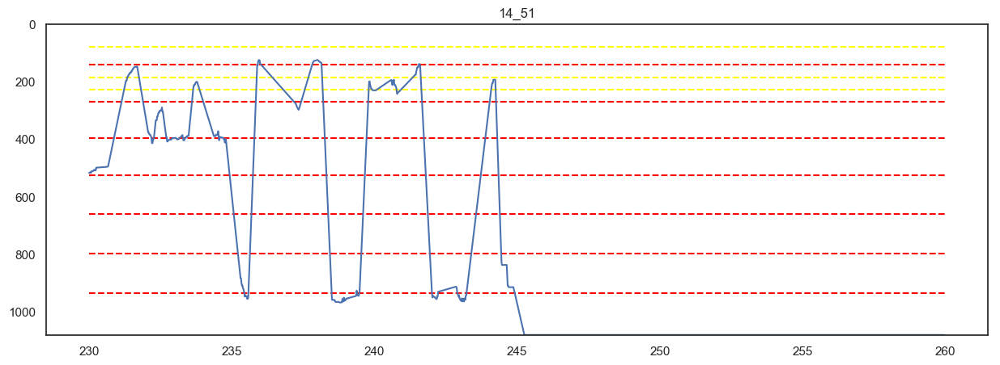

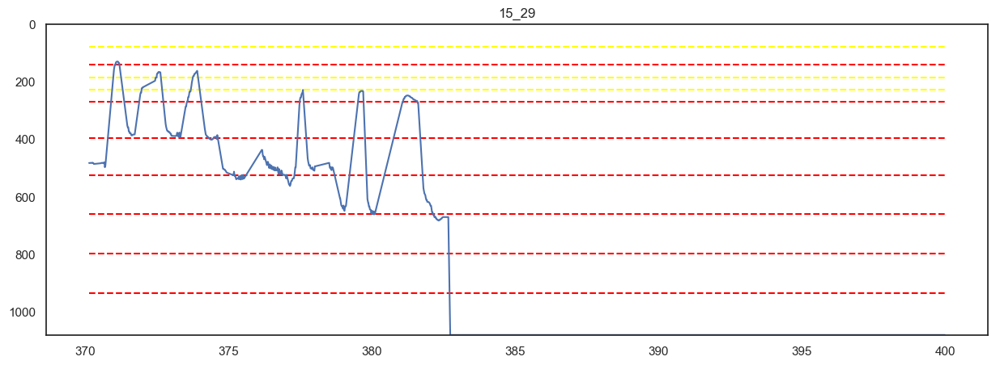

In [1326]:
for i in range(1,16):
    df = gl["df_"+str(i)]
    check_y_plot_revise(df[1],n=2,m=i,fix_time=0.1)

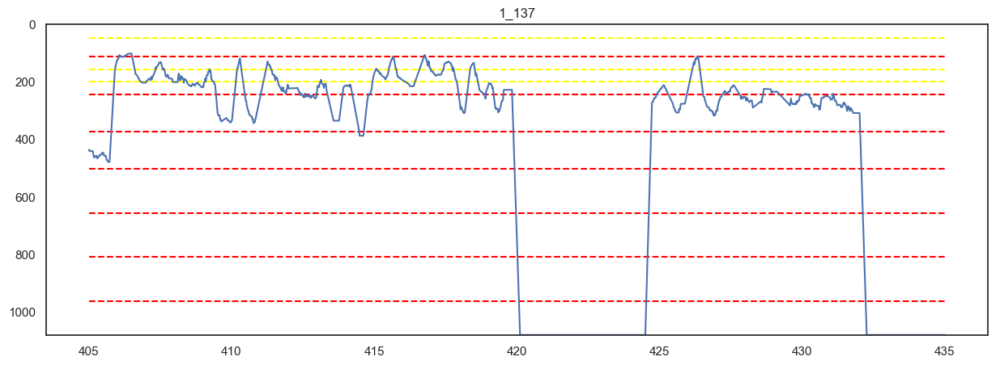

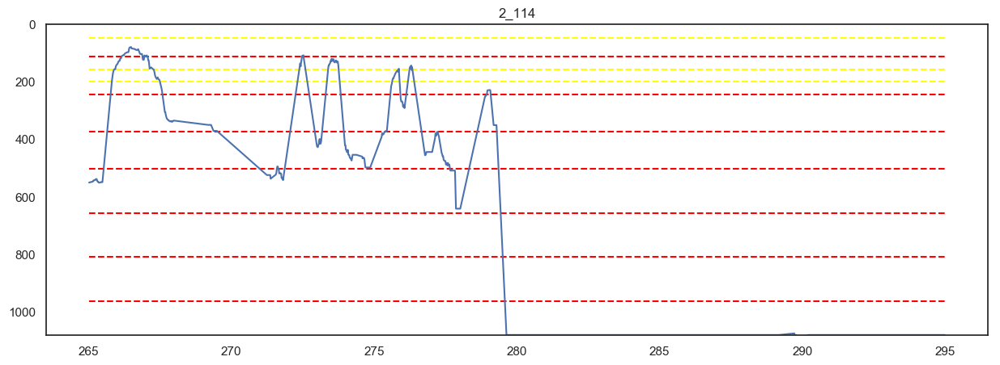

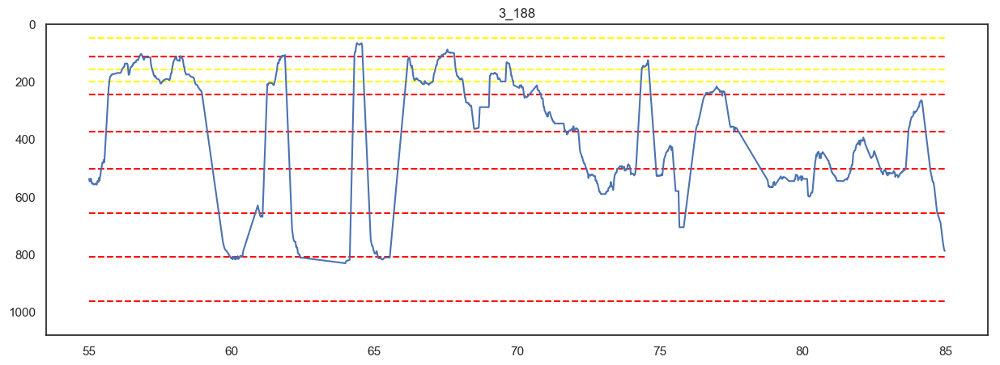

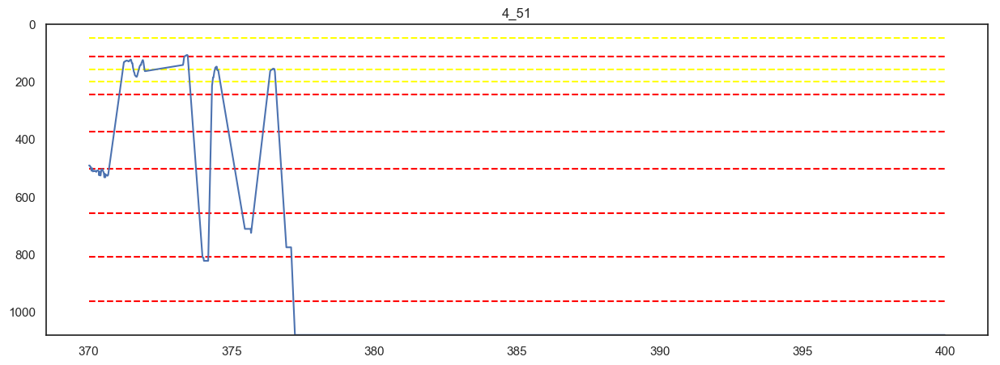

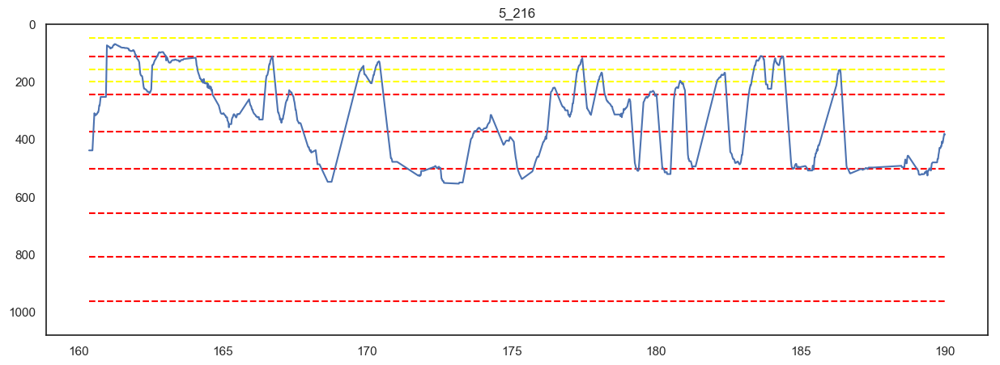

...

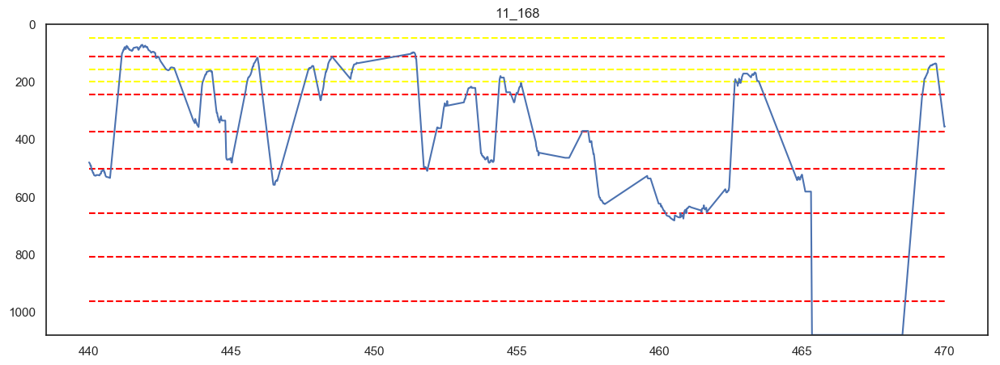

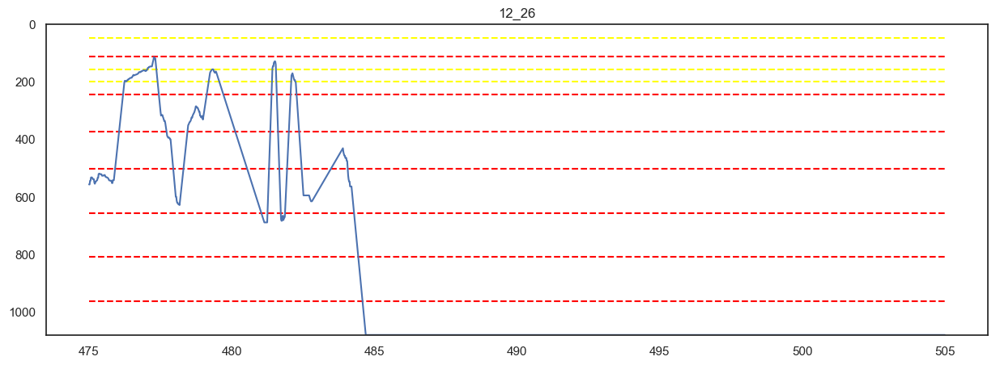

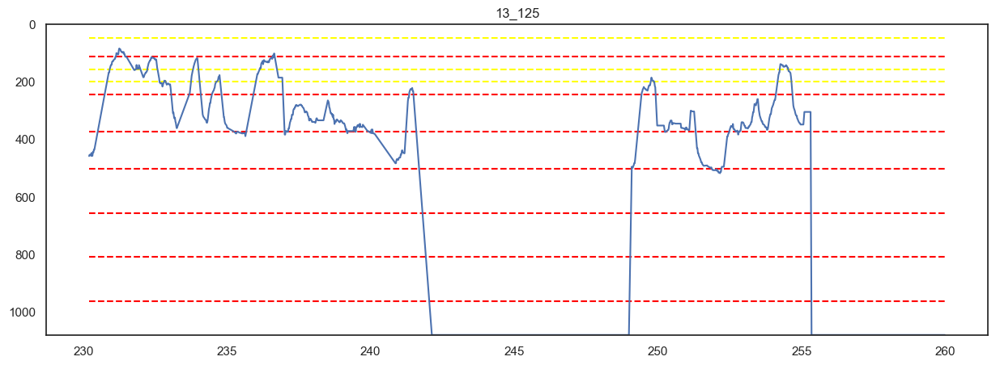

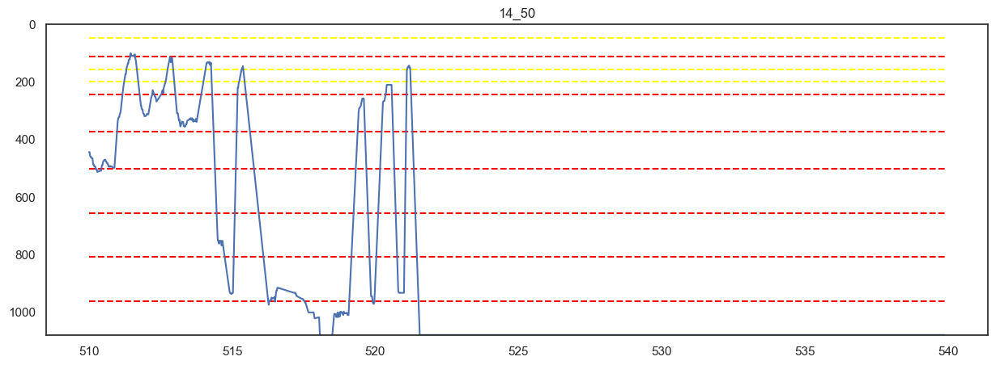

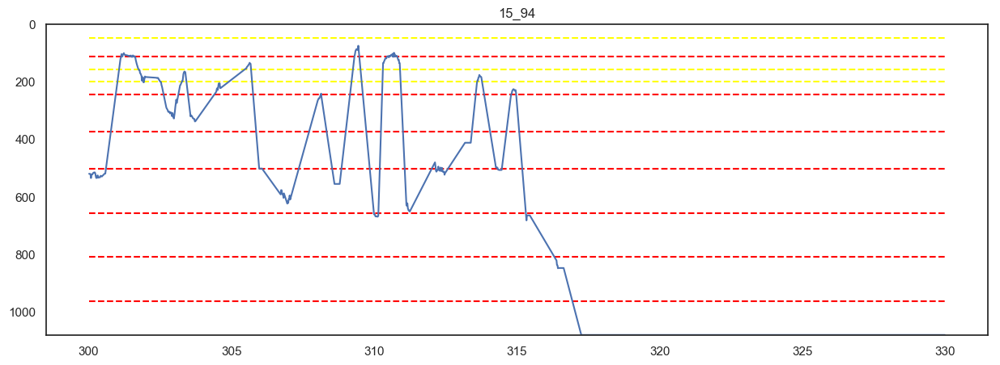

In [1327]:
for i in range(1,16):
    df = gl["df_"+str(i)]
    check_y_plot_revise(df[2],n=3,m=i,fix_time=0.1)

In [1271]:
check_line_of_e10

[166.69872111111115,
 293.3504649999999,
 431.78094245810036,
 561.6859744444447,
 702.9637854748609,
 830.8688266666672,
 978.22302888889]

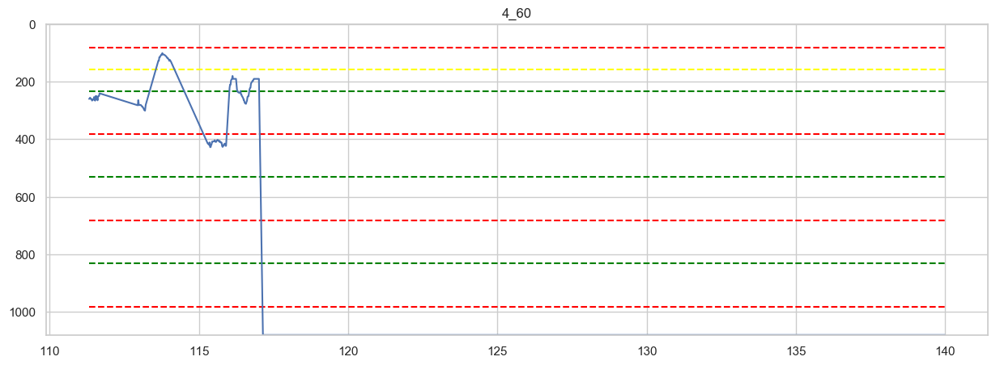

In [1243]:
check_y_plot(df_1[3],n="4")

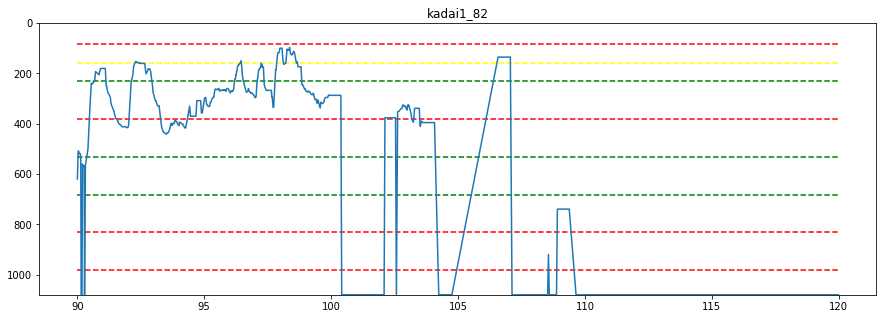

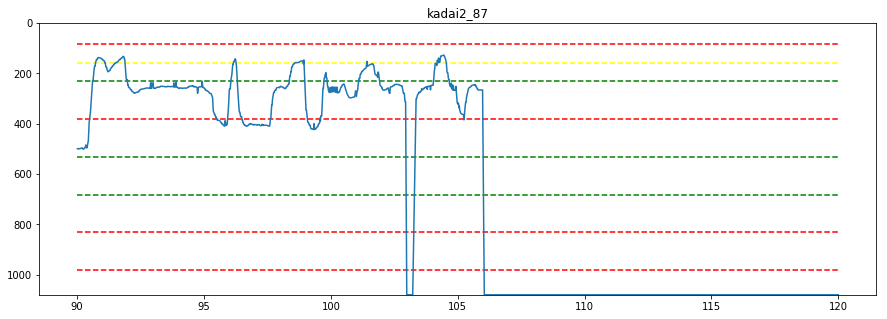

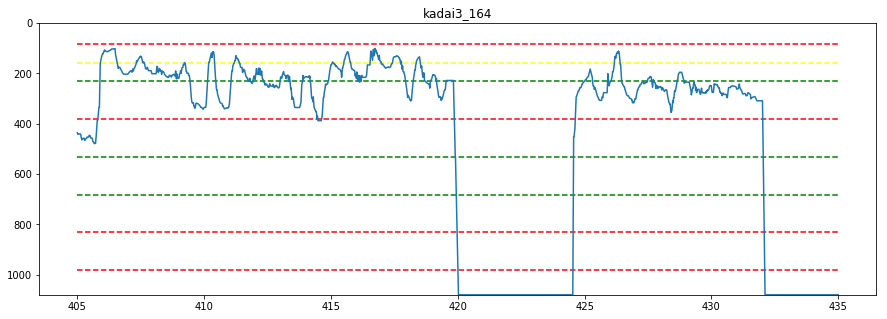

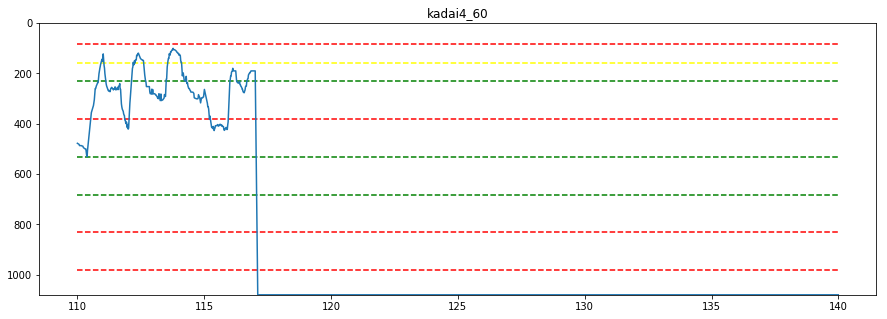

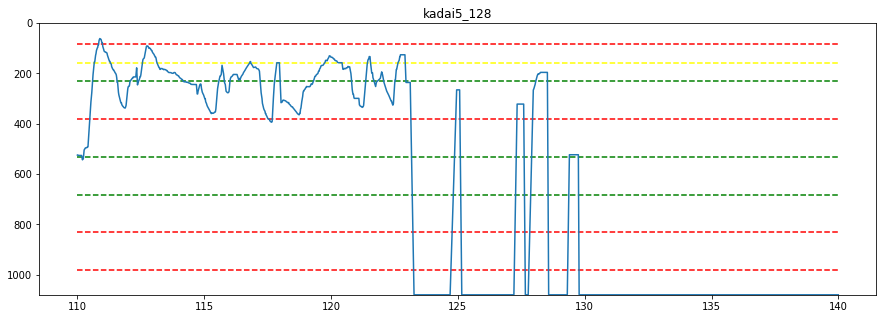

...

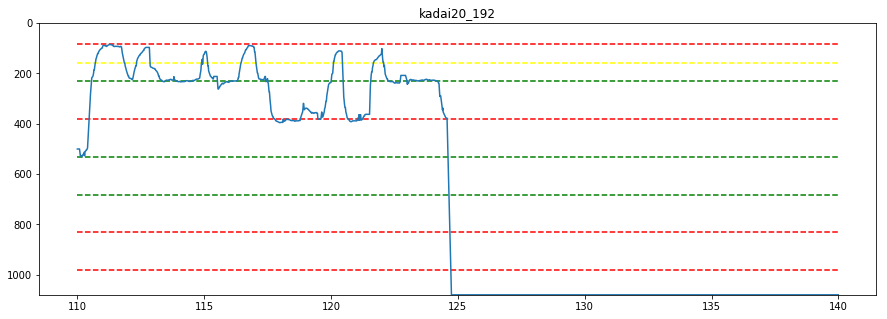

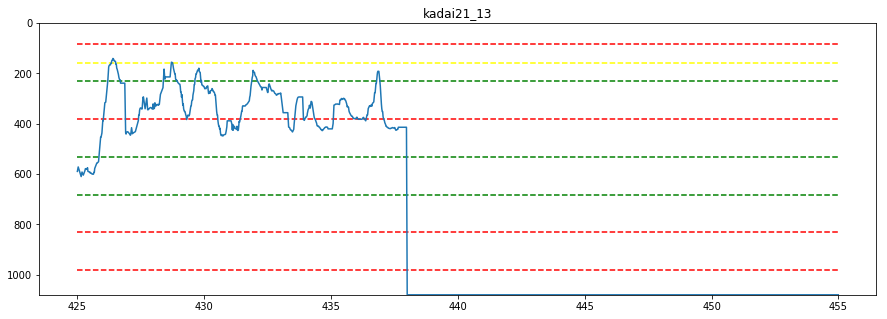

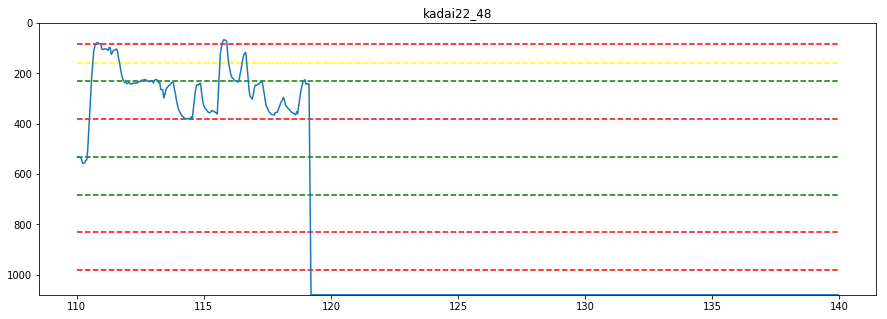

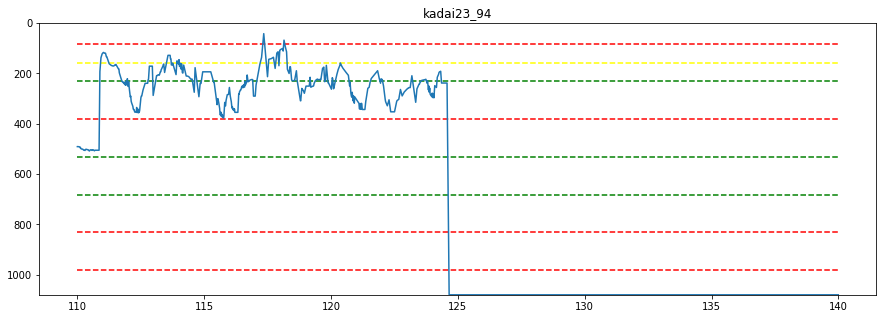

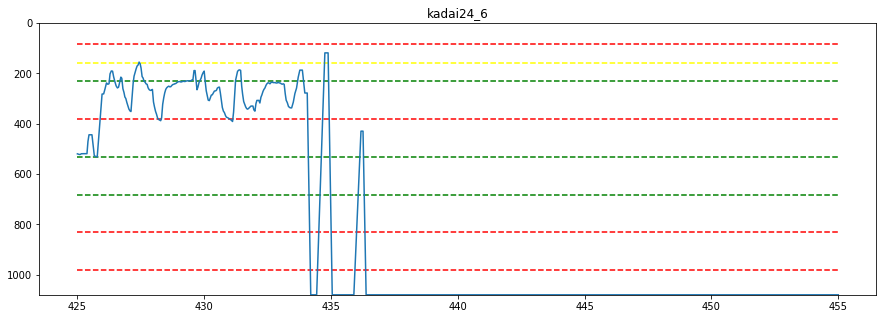

In [94]:
for i in range(1,25):
    name = "kadai"+str(i)
    check_y_plot(df_1[i-1],n=name)

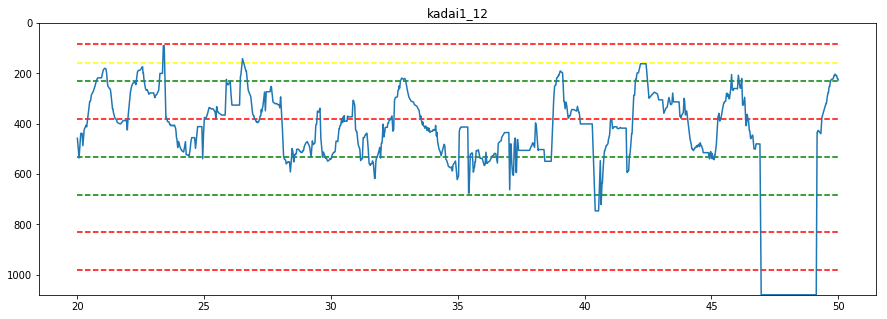

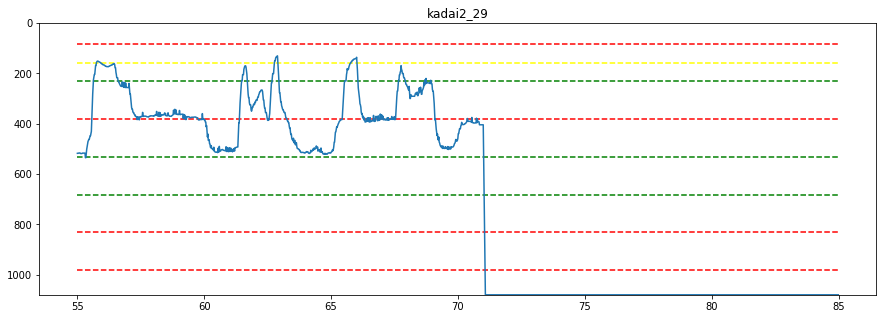

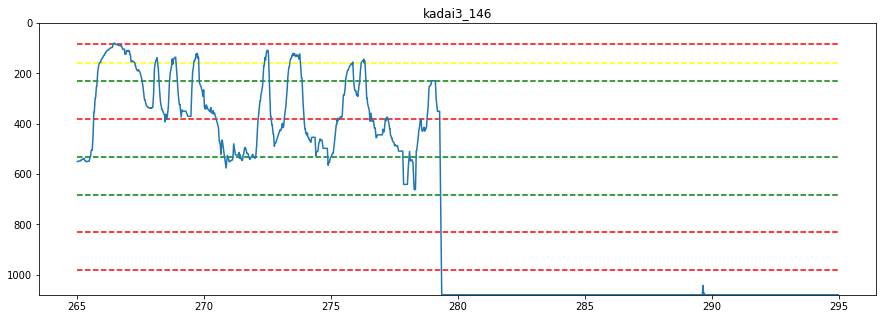

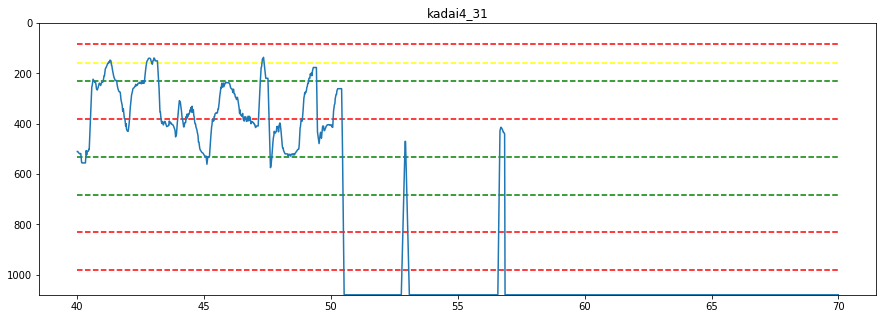

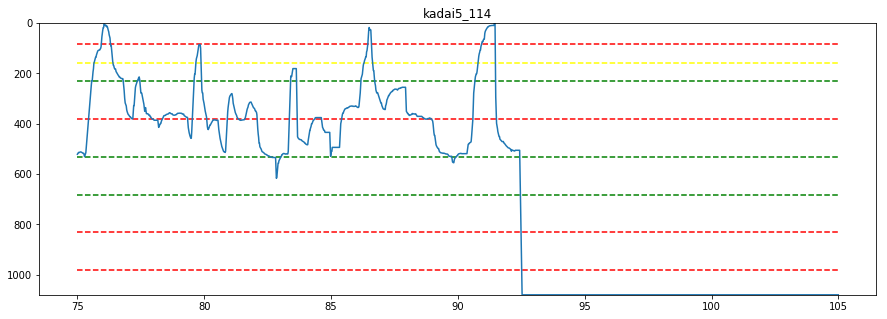

...

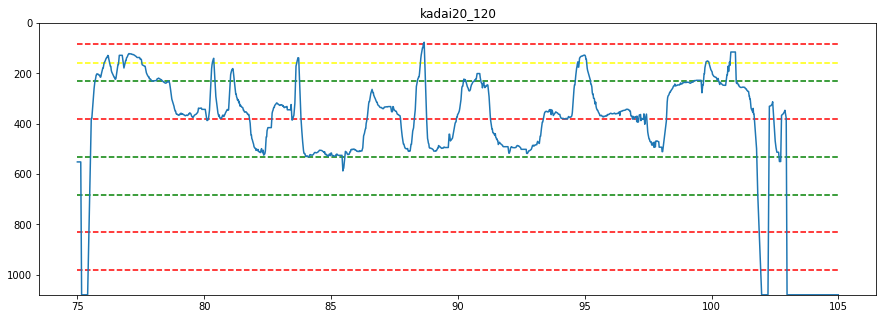

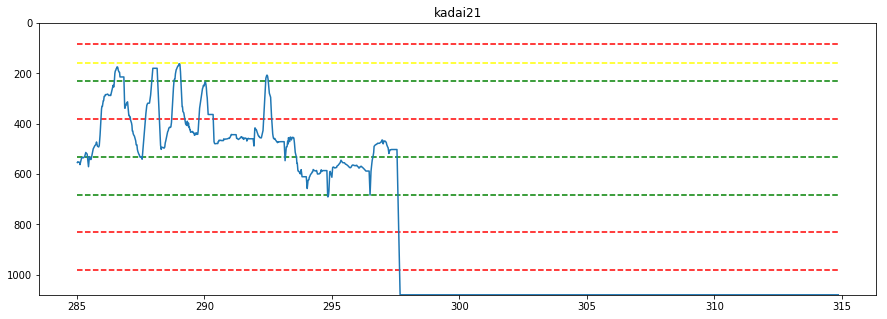

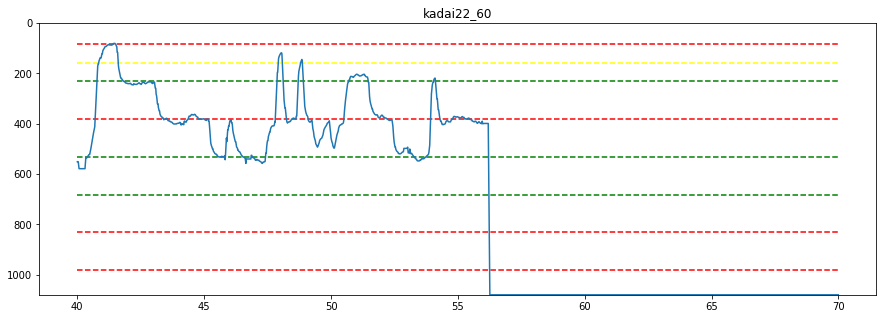

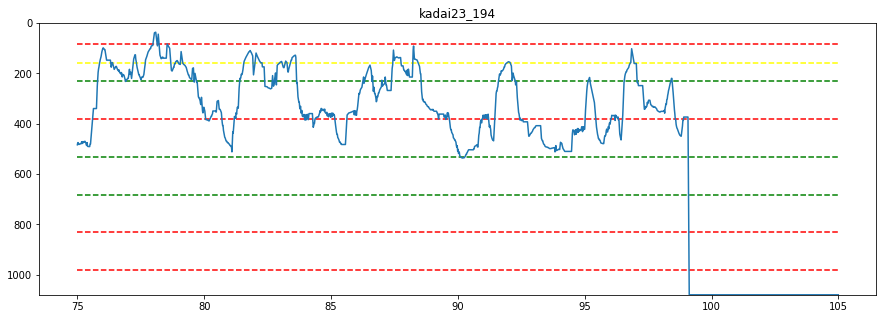

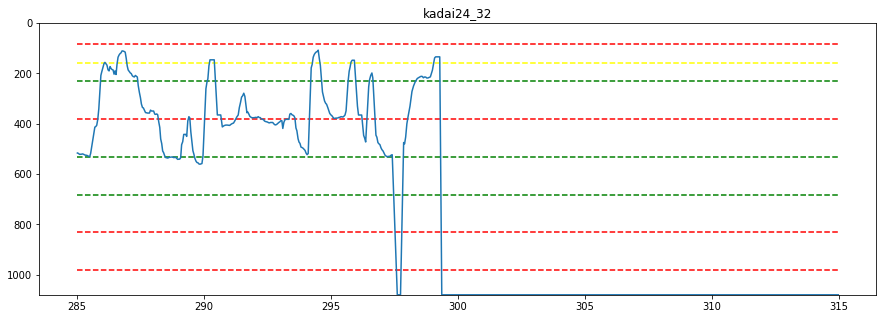

In [95]:
for i in range(1,25):
    name = "kadai"+str(i)
    check_y_plot(df_2[i-1],n=name)

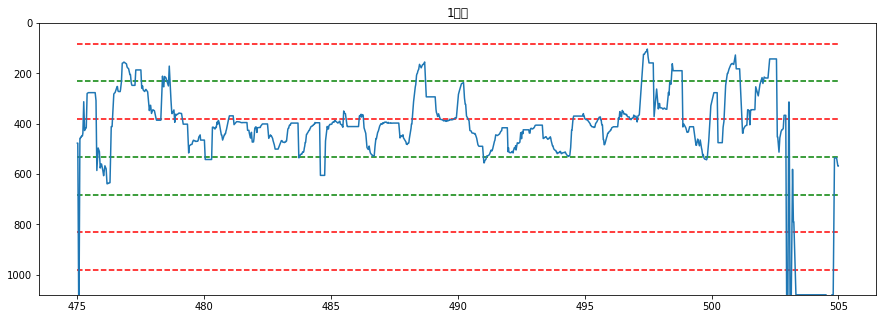

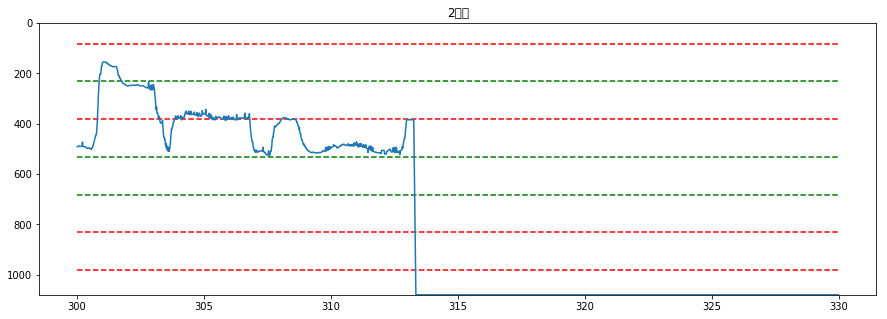

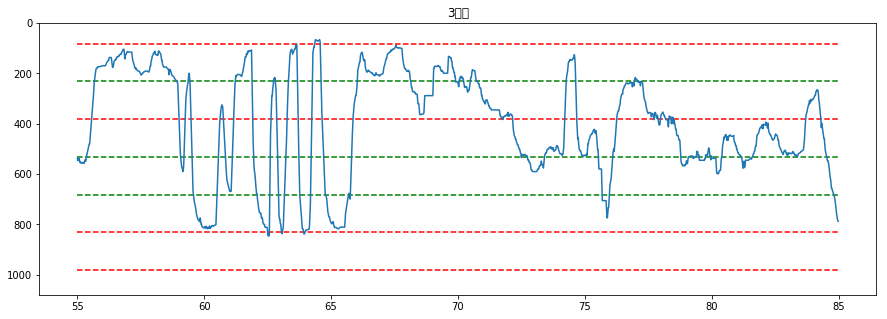

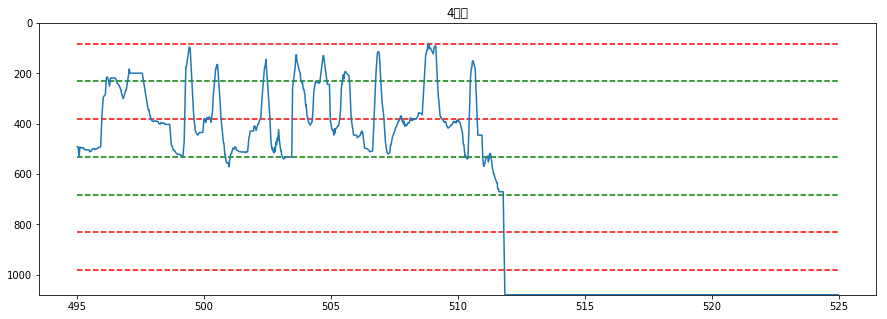

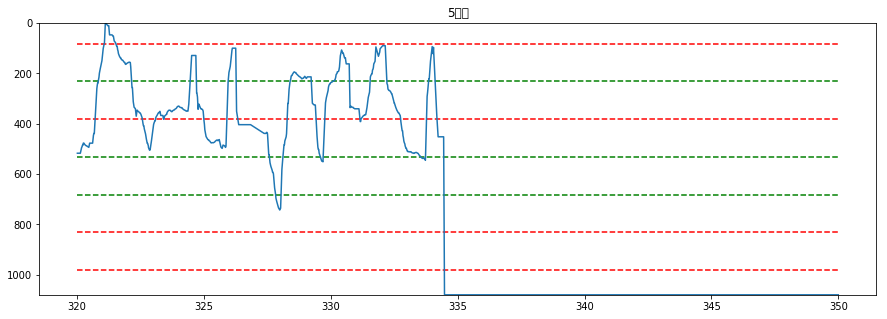

...

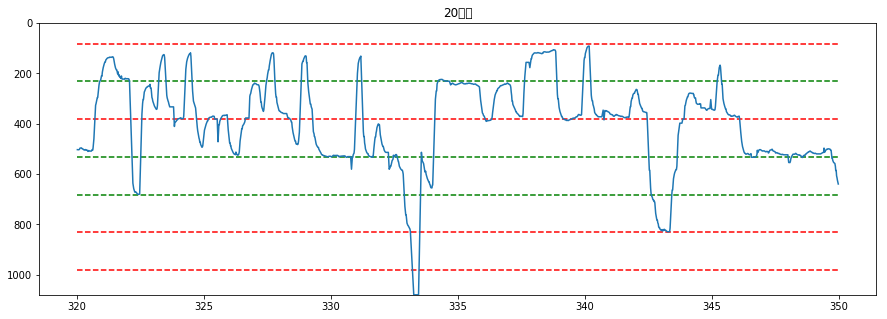

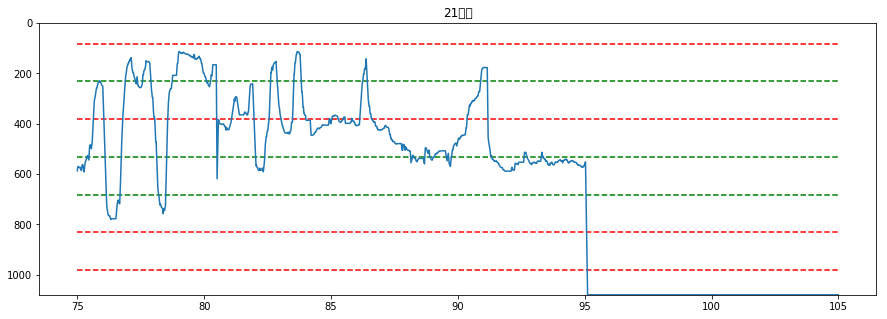

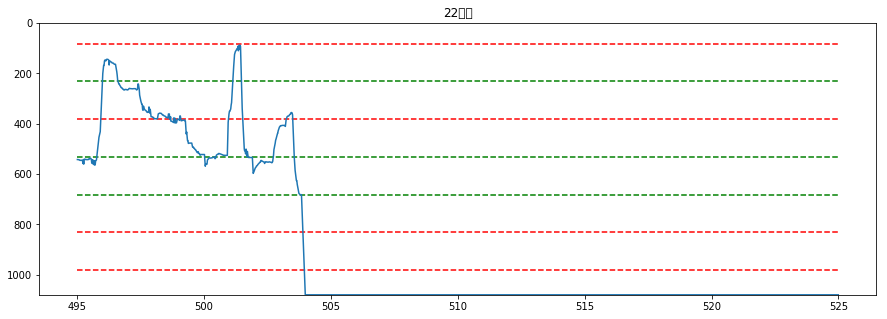

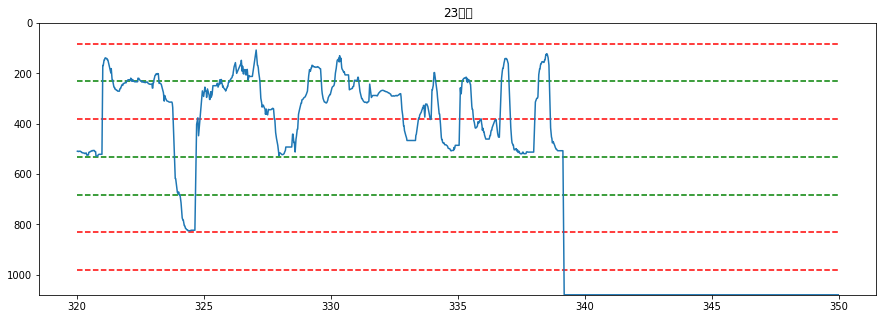

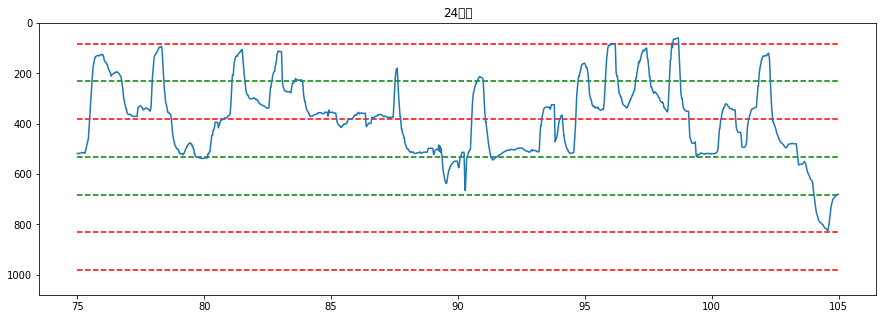

In [73]:
for i in range(1,25):
    name = "kadai"+str(i)
    check_y_plot(df_3[i-1],n=name)

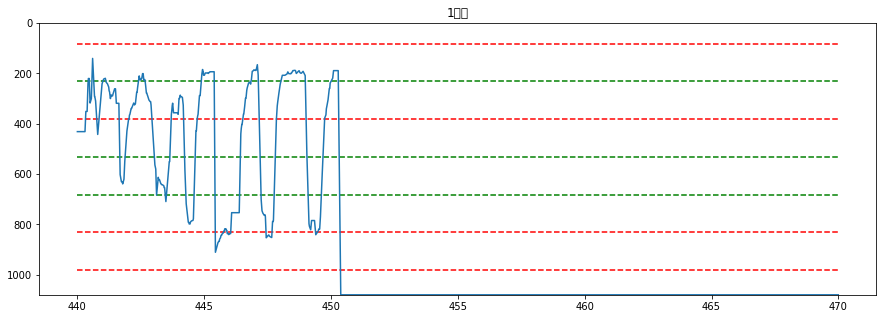

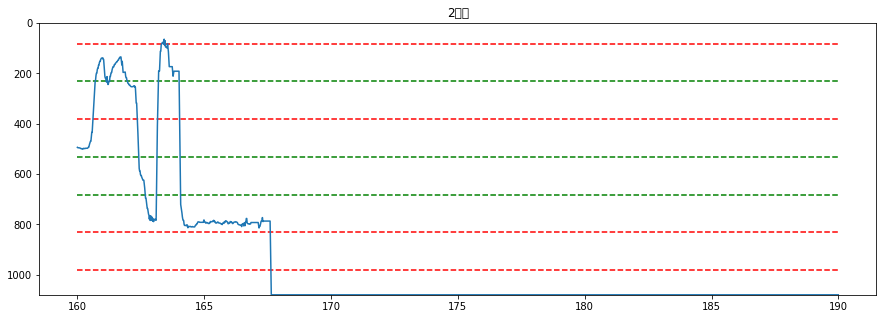

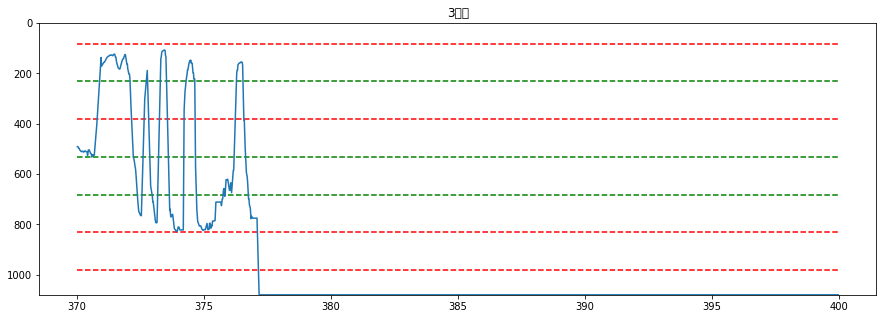

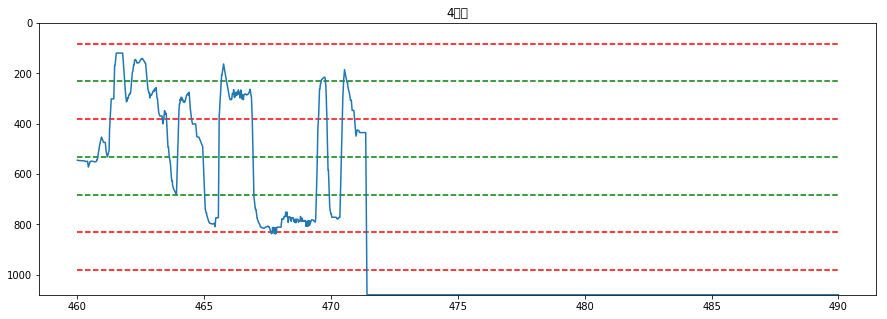

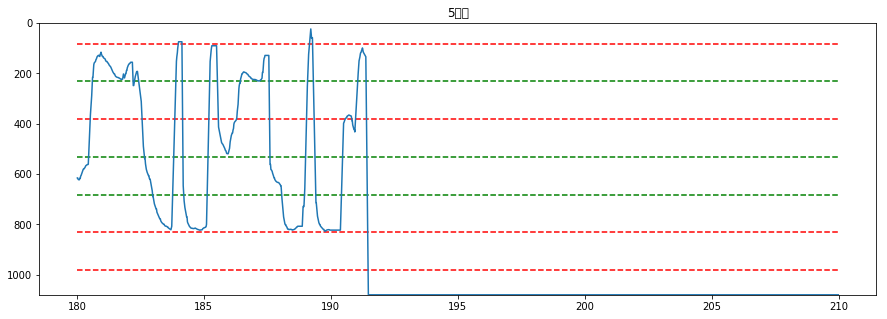

...

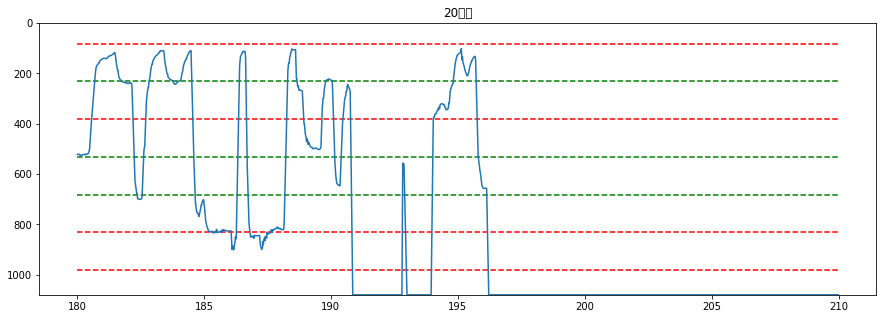

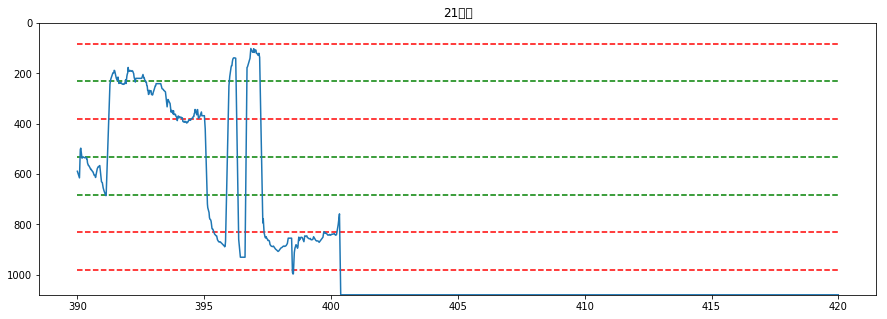

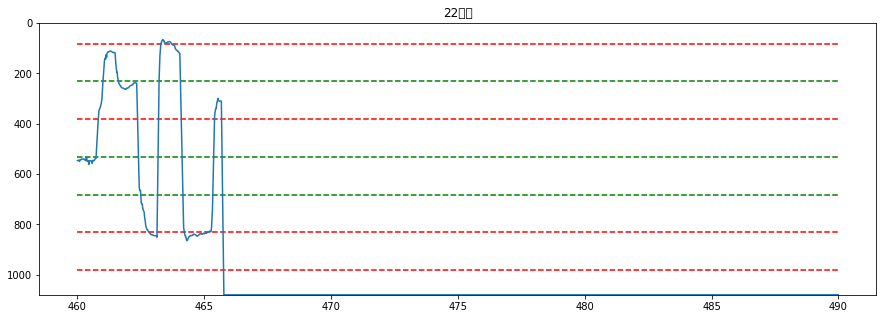

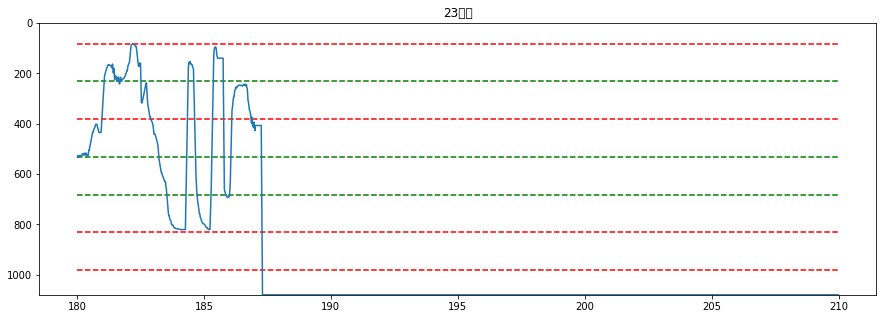

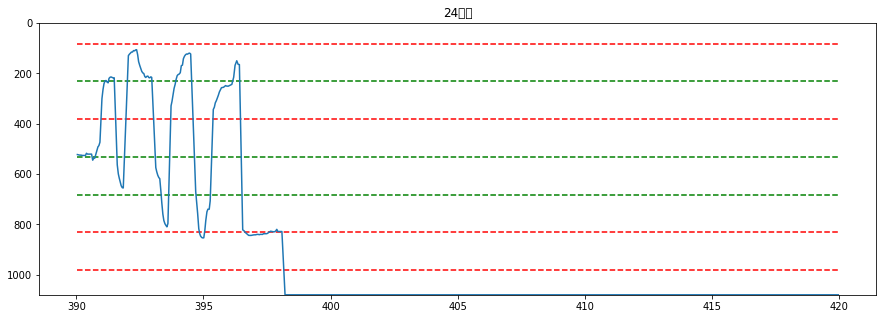

In [74]:
for i in range(1,25):
    name = str(i)+"問目"
    check_y_plot(df_4[i-1],n=name)

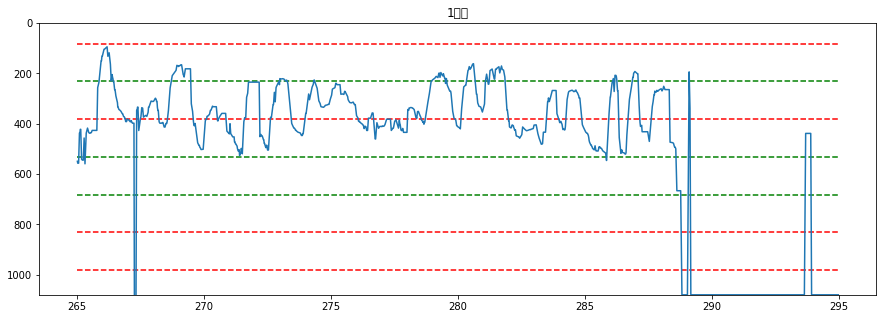

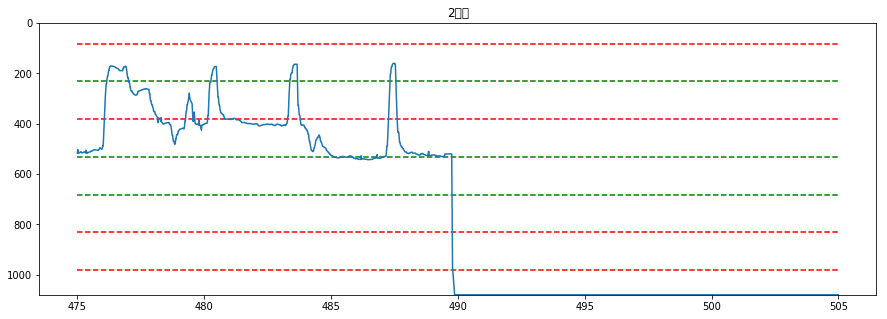

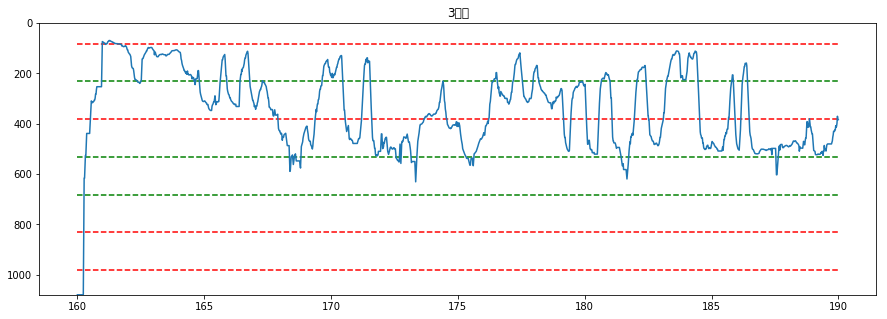

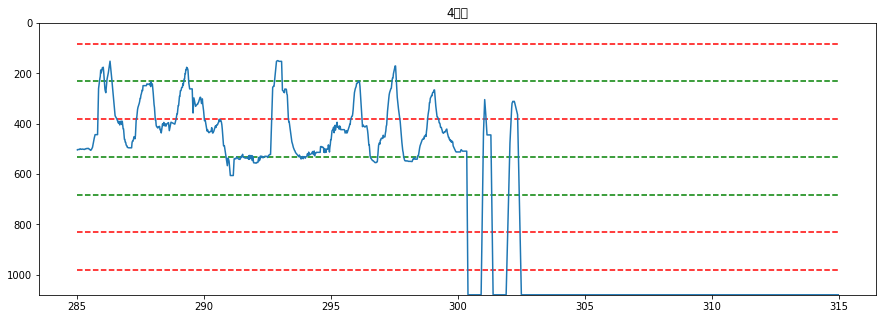

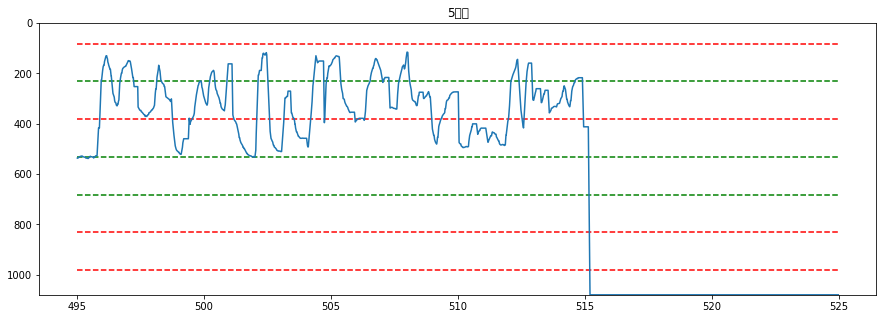

...

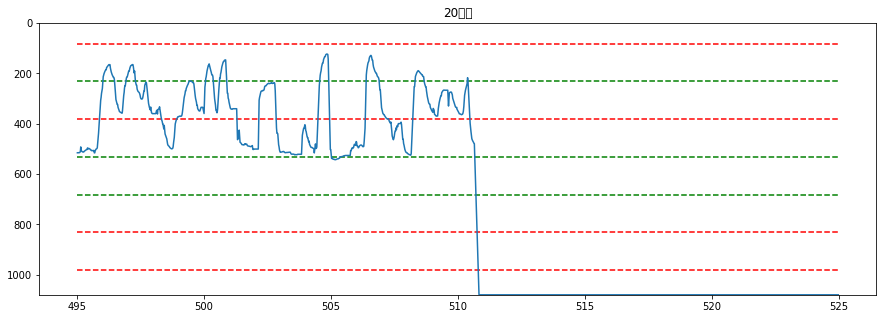

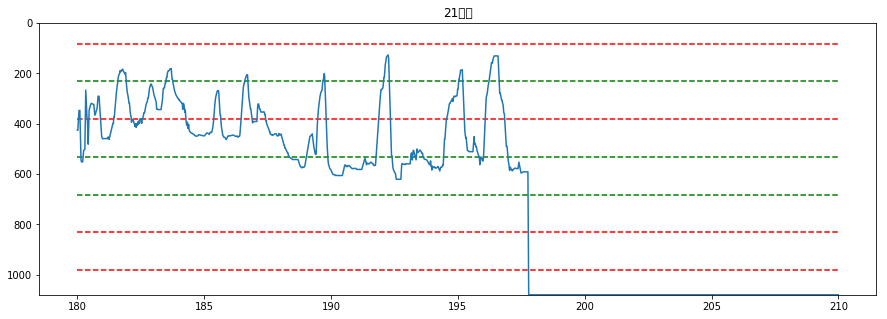

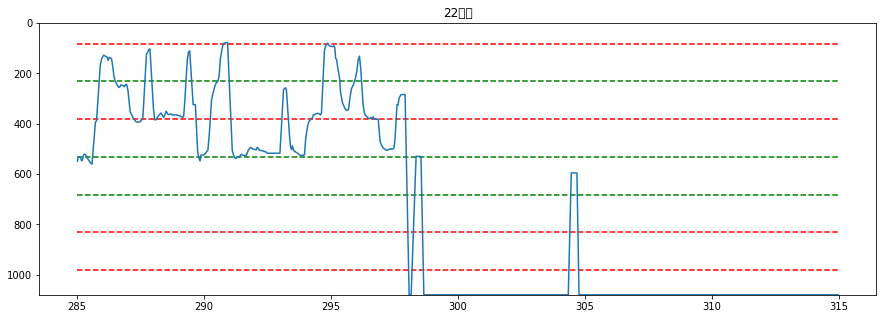

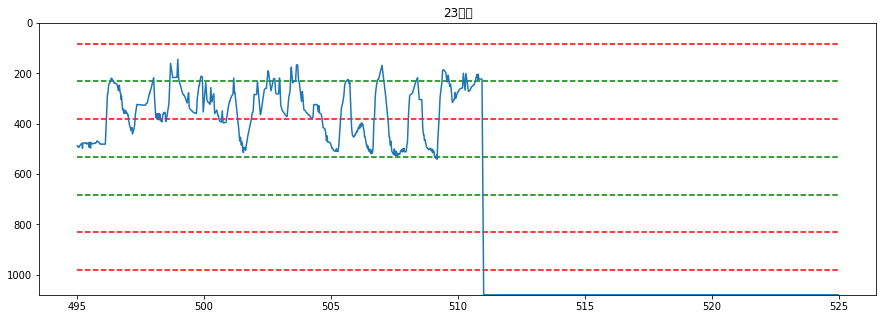

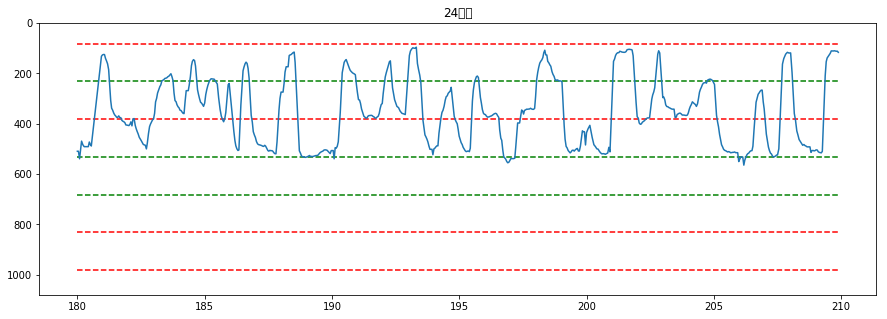

In [75]:
for i in range(1,25):
    name = str(i)+"問目"
    check_y_plot(df_5[i-1],n=name)

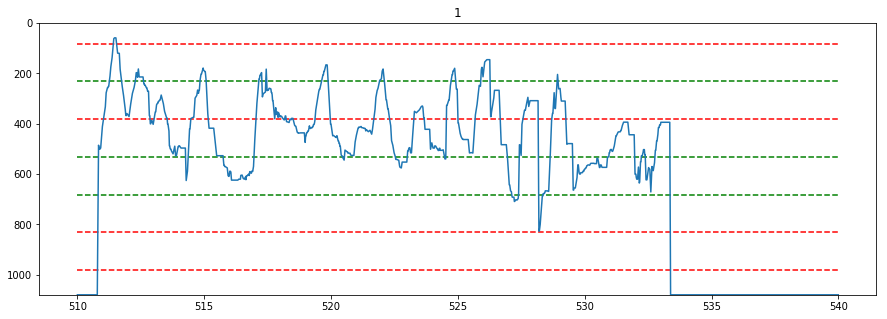

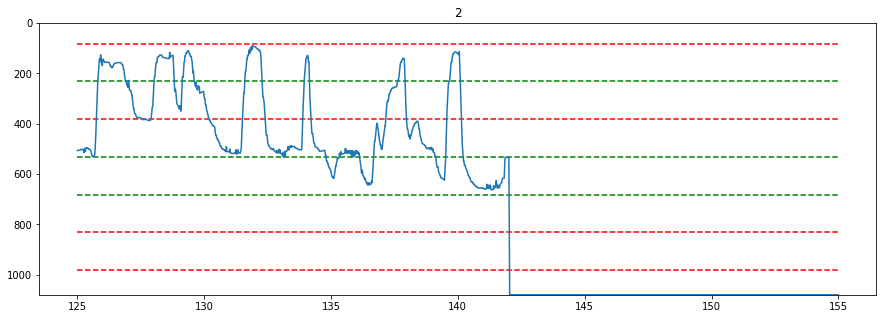

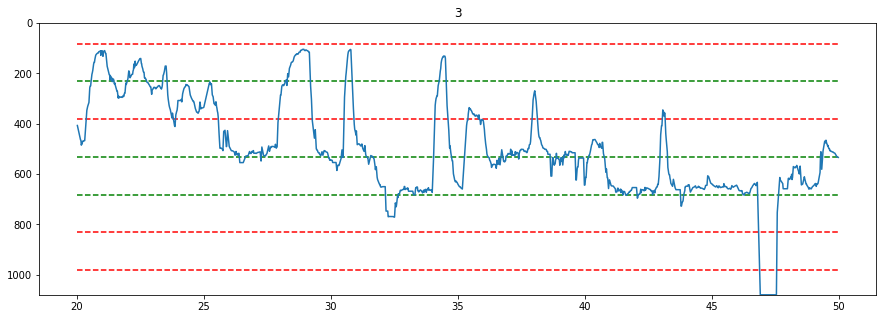

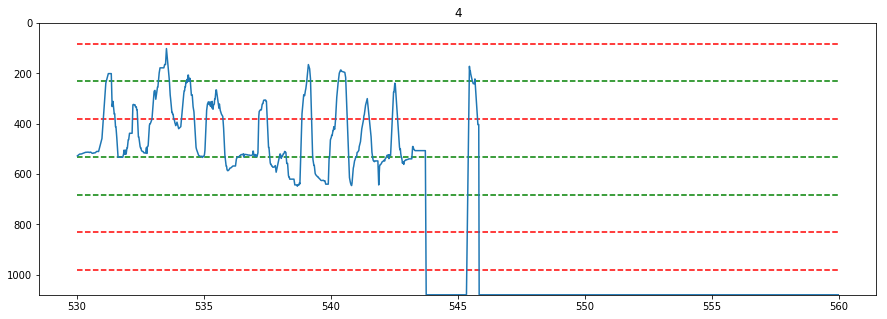

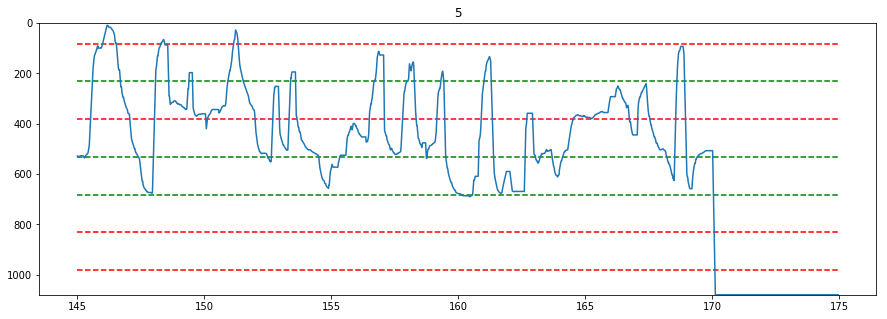

...

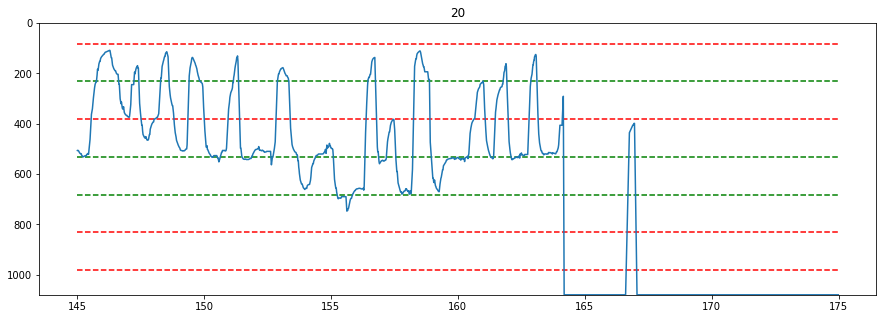

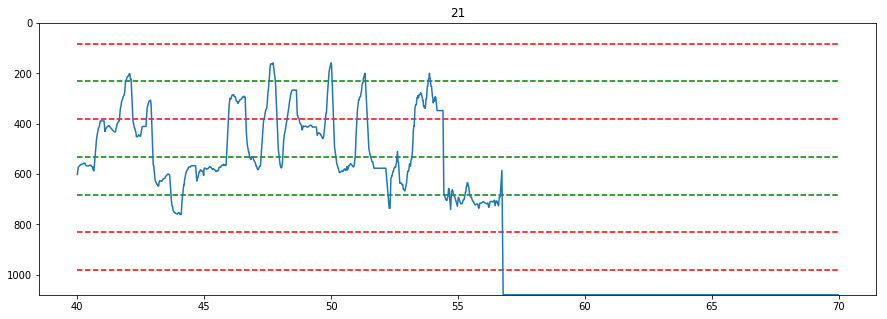

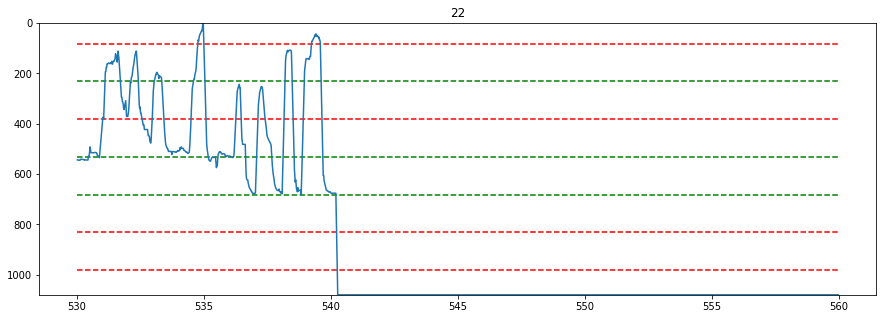

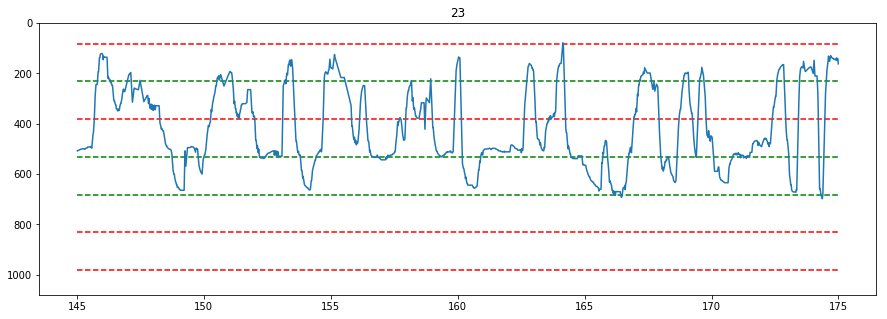

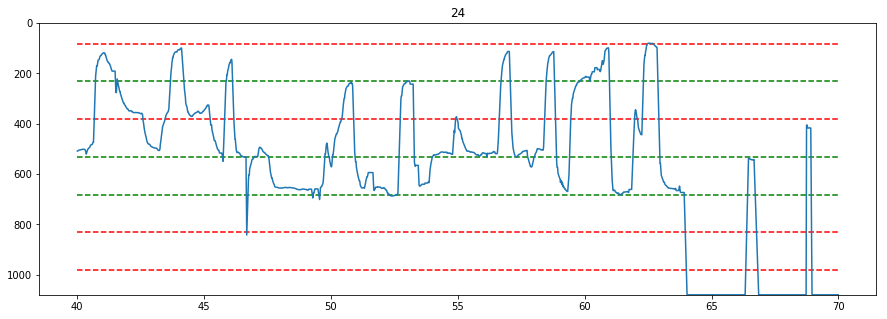

In [76]:
for i in range(1,25):
    name = str(i)
    check_y_plot(df_6[i-1],n=name)

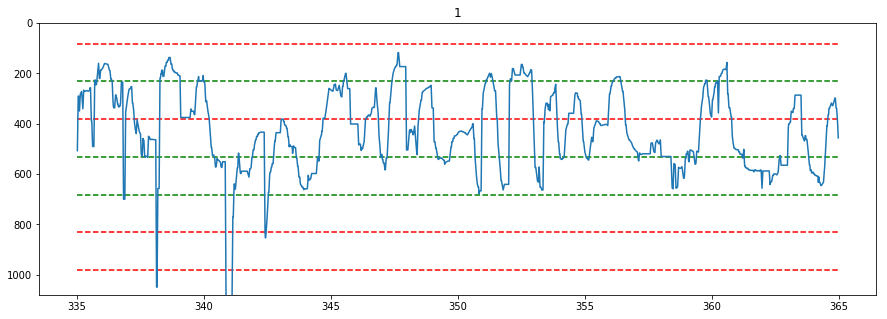

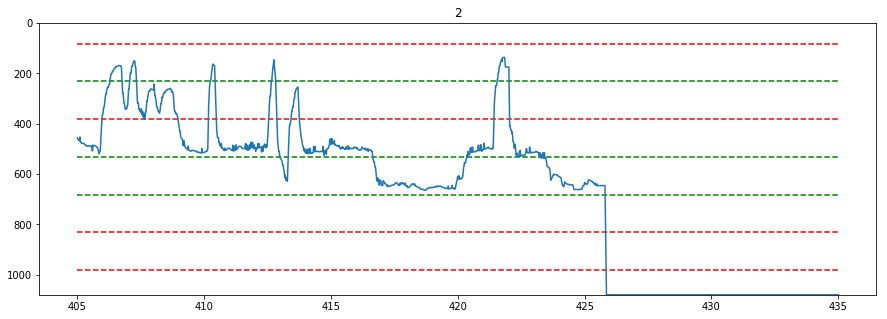

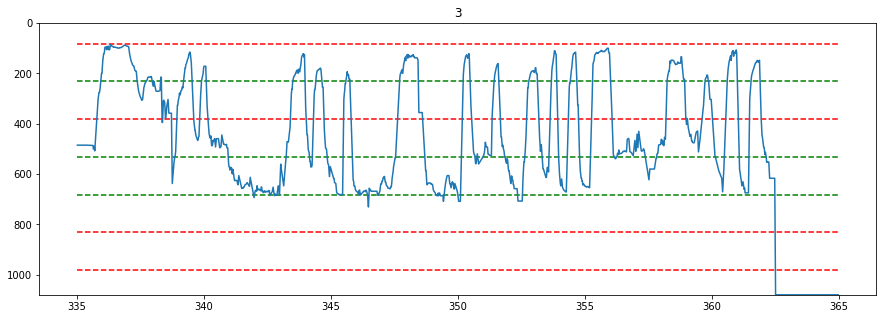

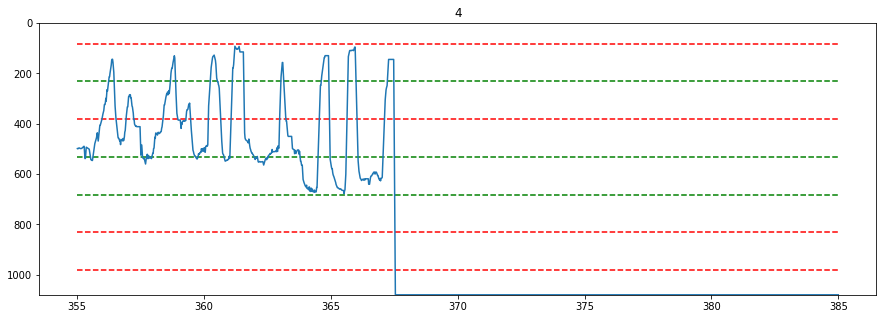

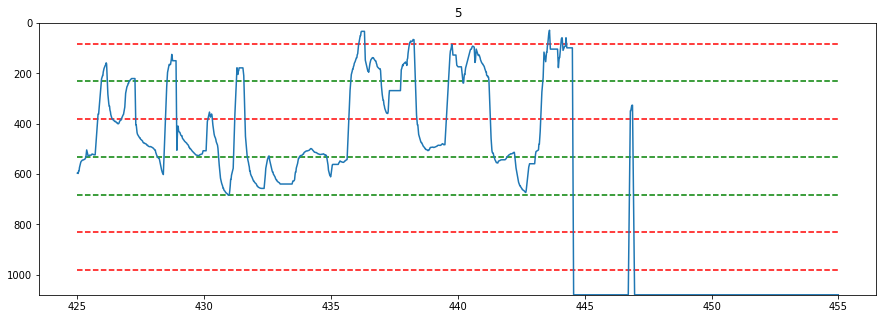

...

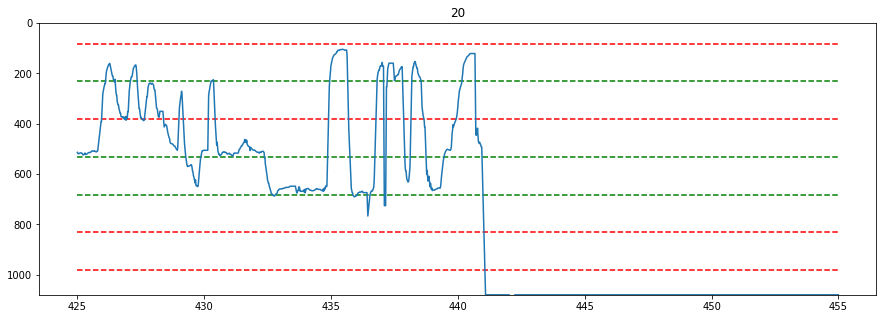

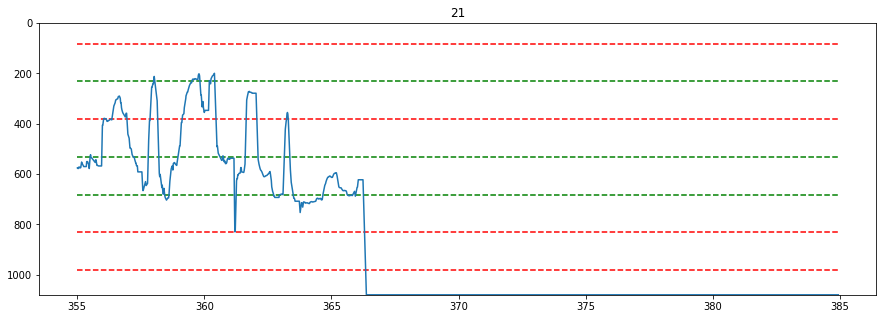

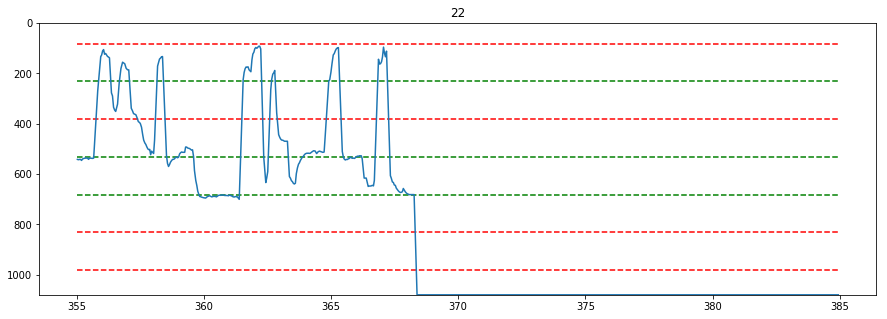

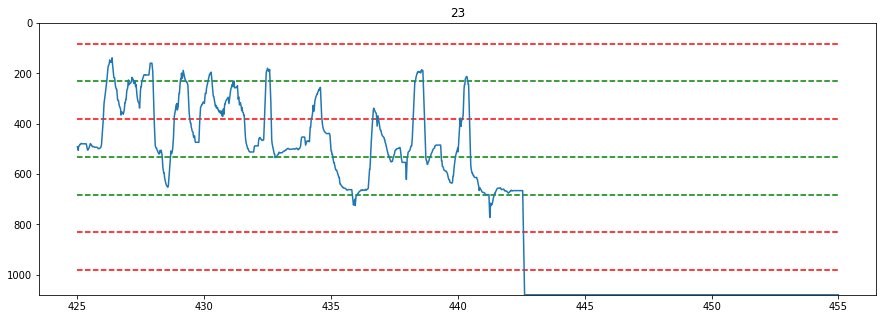

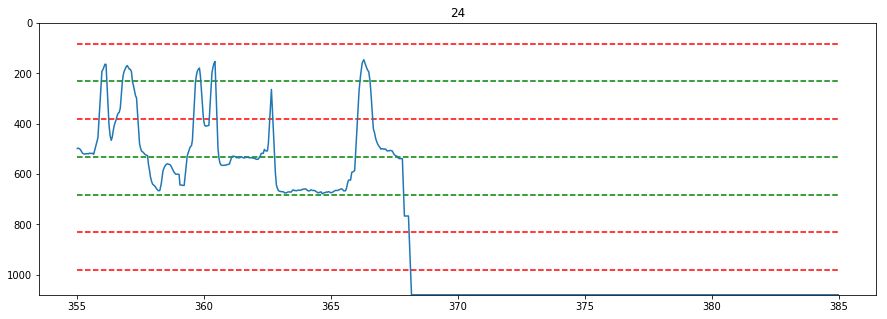

In [78]:
for i in range(1,25):
    name = str(i)
    check_y_plot(df_7[i-1],n=name)

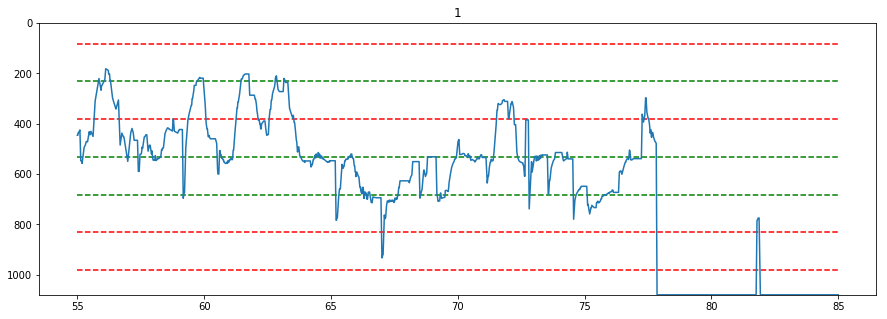

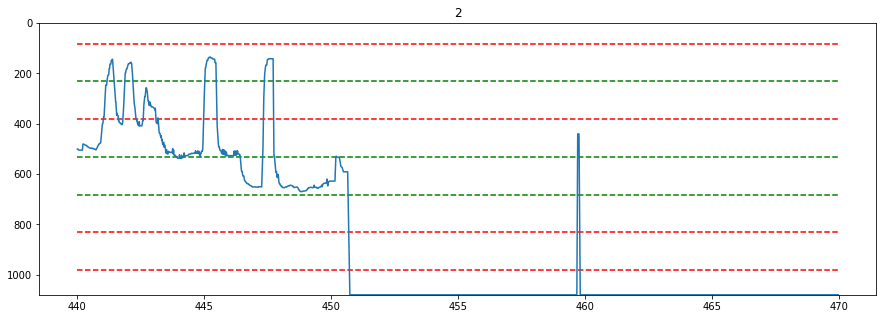

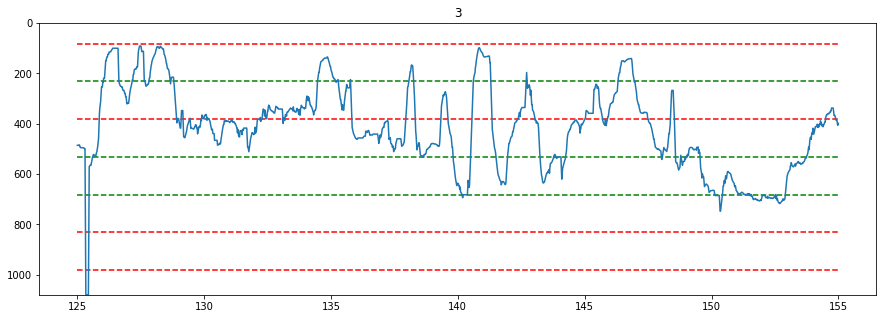

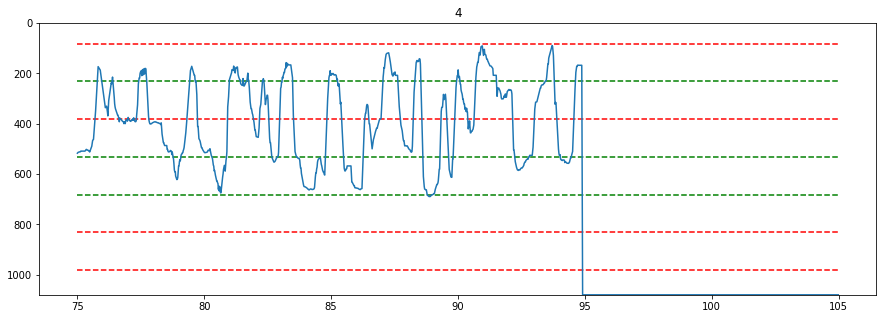

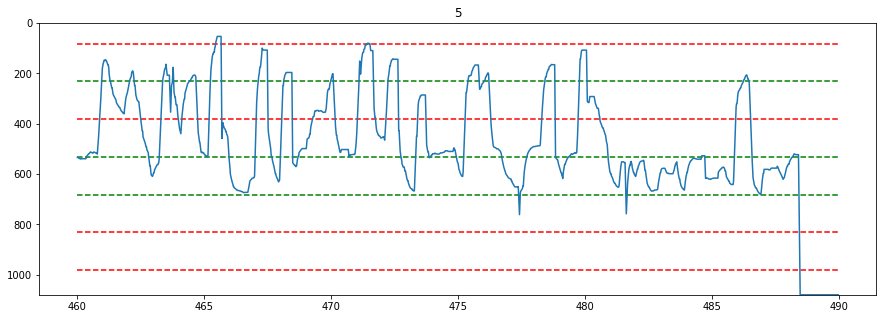

...

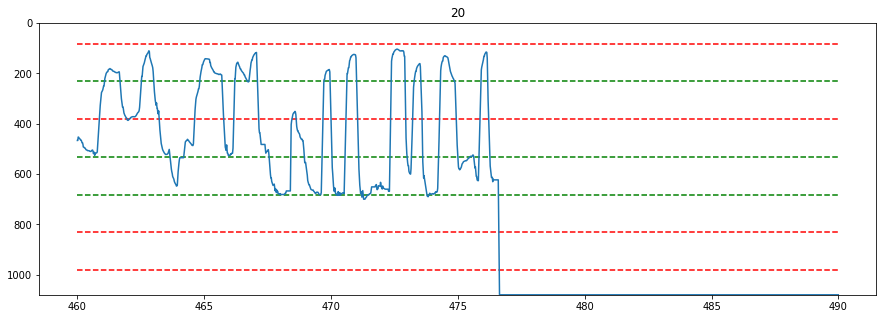

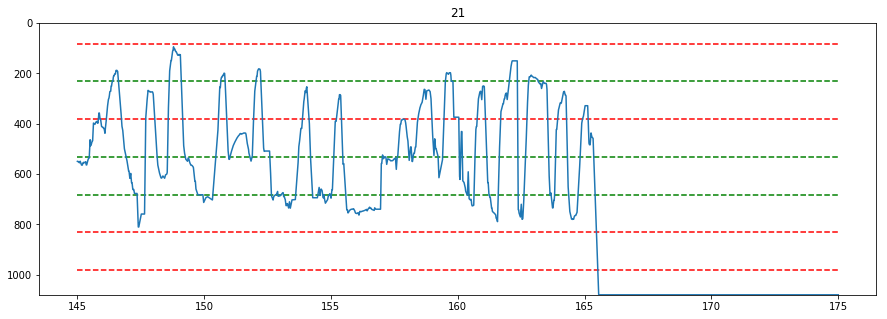

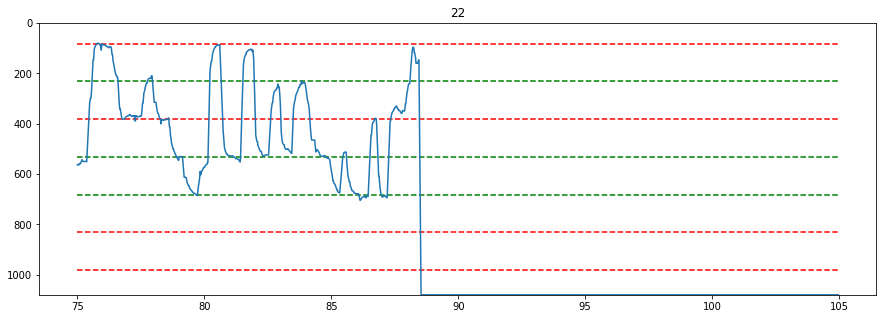

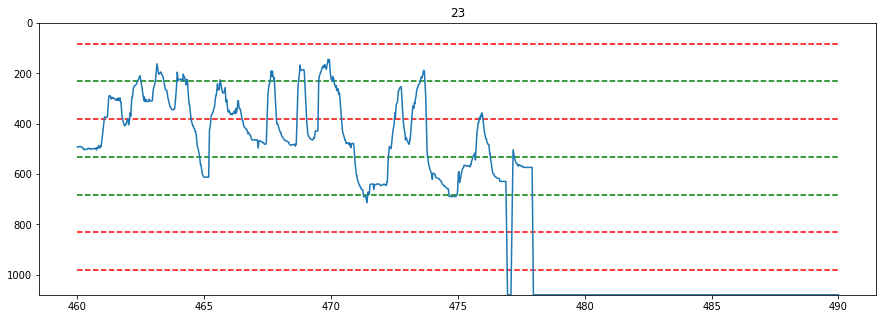

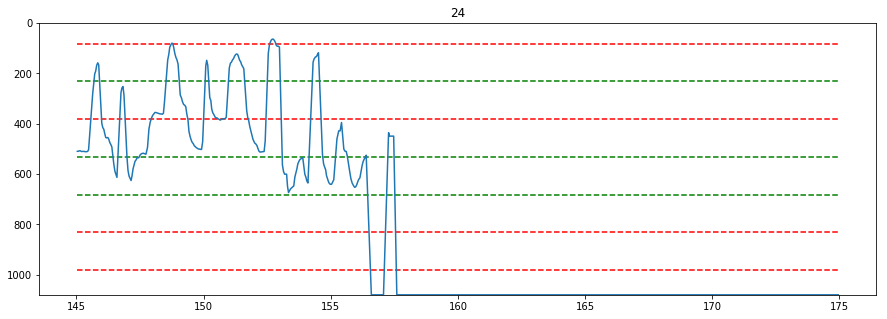

In [79]:
for i in range(1,25):
    name = str(i)
    check_y_plot(df_8[i-1],n=name)

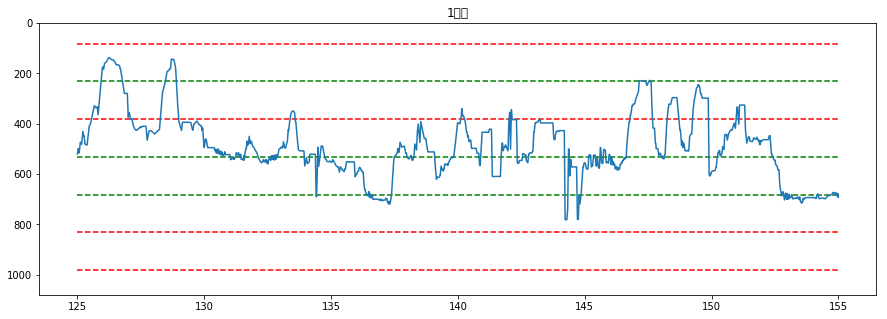

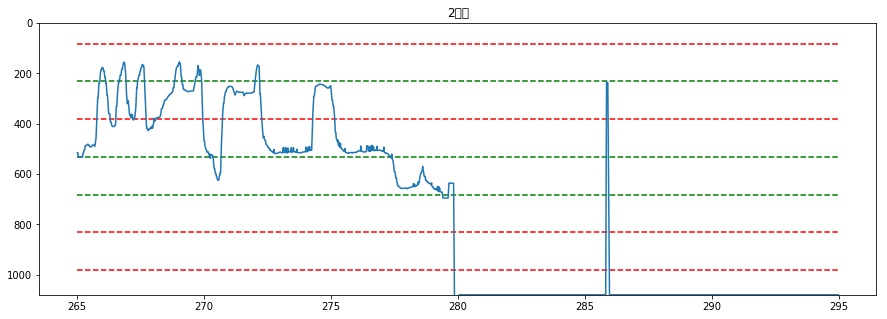

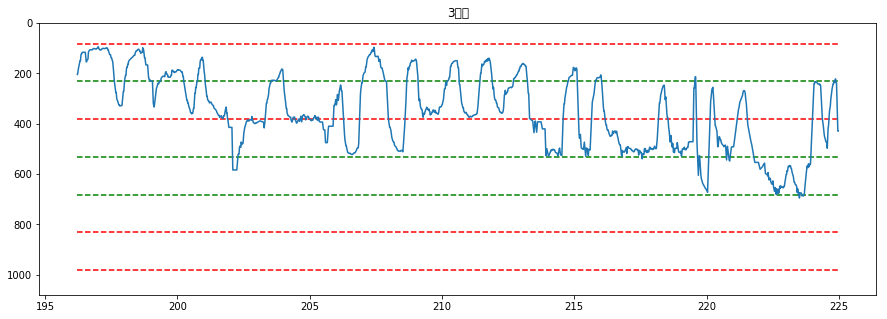

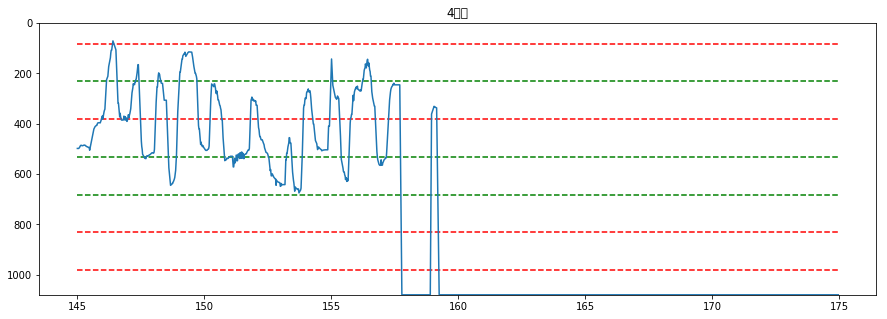

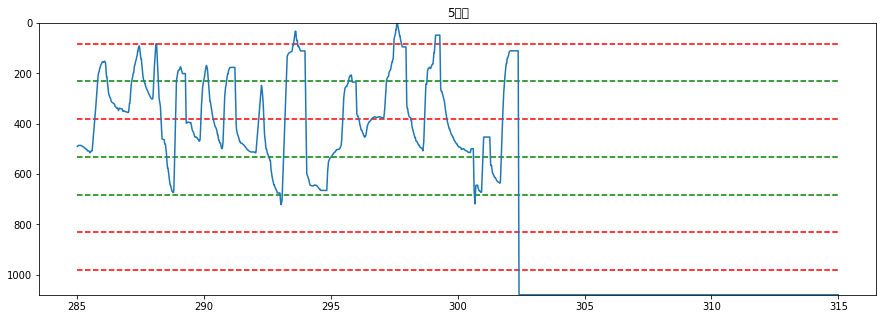

...

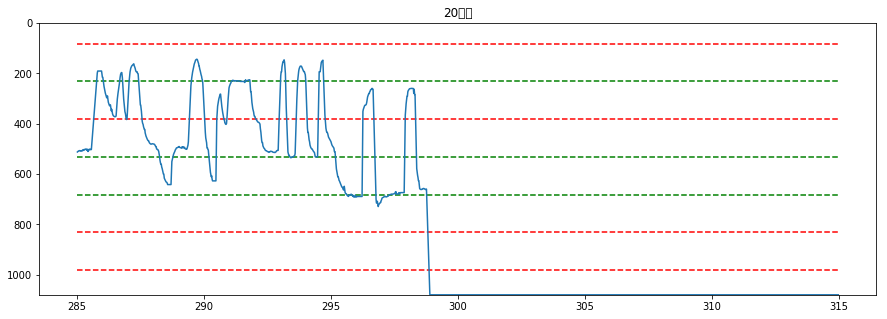

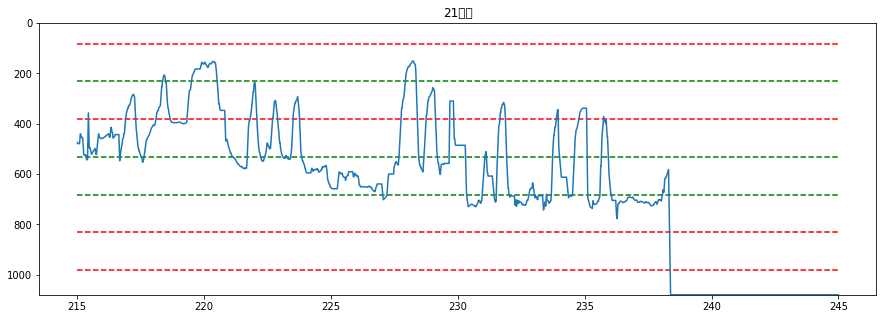

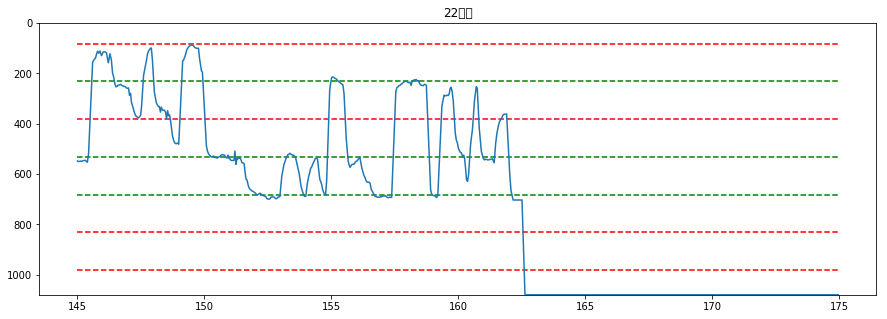

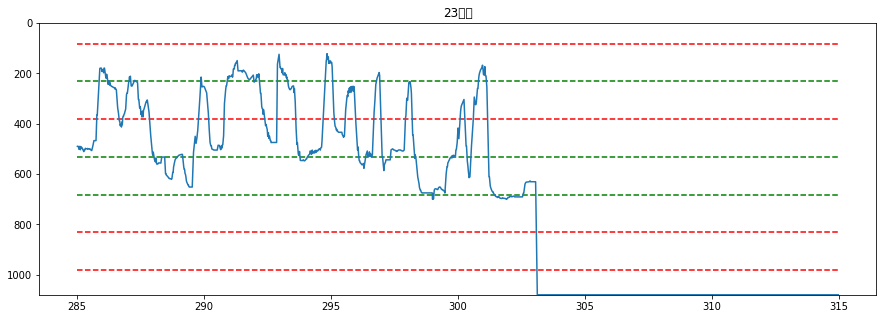

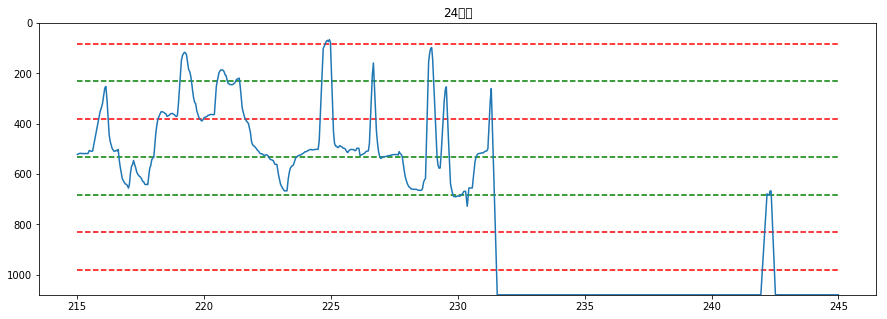

In [80]:
for i in range(1,25):
    name = str(i)
    check_y_plot(df_9[i-1],n=name)

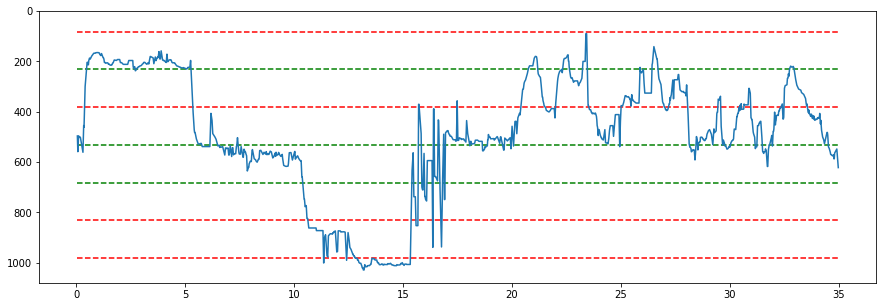

In [30]:
check_y_plot(saccade(e1_check_all))

In [447]:
df_1[0]

,time,x,y,velo
5357,90.004760,967.7116,967.7116,0
5358,90.020196,1073.4330,1073.4330,0
5359,90.037527,1074.2470,1074.2470,0
5360,90.053656,1074.2470,1074.2470,0
5361,90.071134,1082.4500,1082.4500,0
5362,90.087044,1085.9040,1085.9040,0
5363,90.104740,1085.9040,1085.9040,0
5364,90.120739,1085.9040,1085.9040,0
5365,90.138037,1098.8260,1098.8260,0
5366,90.153946,1103.4290,500.0000,0


In [450]:
saccade(df_1[0].reset_index(drop=True))

,time,x,y,velo,slow
0,90.004760,967.7116,967.7116,0.000000,True
2,90.037527,1074.2470,1074.2470,66.422586,True
3,90.053656,1074.2470,1074.2470,0.000000,True
4,90.071134,1082.4500,1082.4500,663.725525,True
5,90.087044,1085.9040,1085.9040,307.012623,True
6,90.104740,1085.9040,1085.9040,0.000000,True
7,90.120739,1085.9040,1085.9040,0.000000,True
8,90.138037,1098.8260,1098.8260,1056.455850,True
10,90.170925,1101.3280,500.0000,123.738177,True
11,90.187215,1101.3280,500.0000,0.000000,True


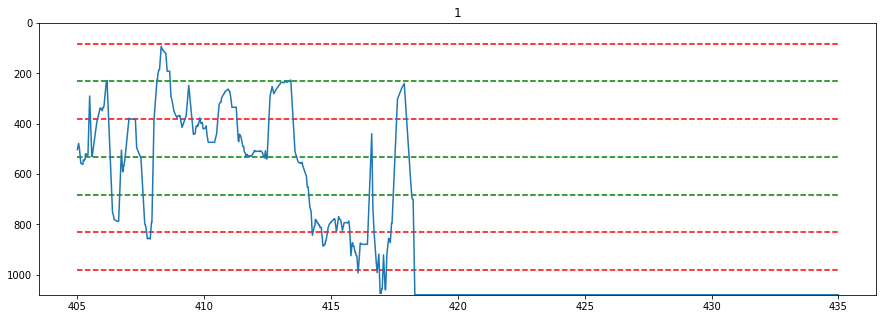

In [71]:
check_y_plot(saccade(df_15[0]),n="1")

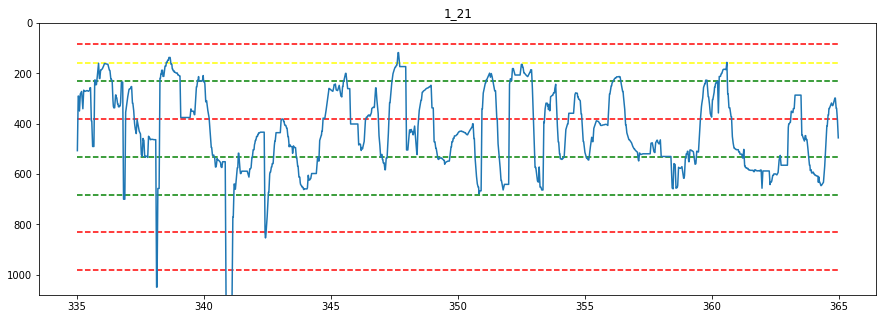

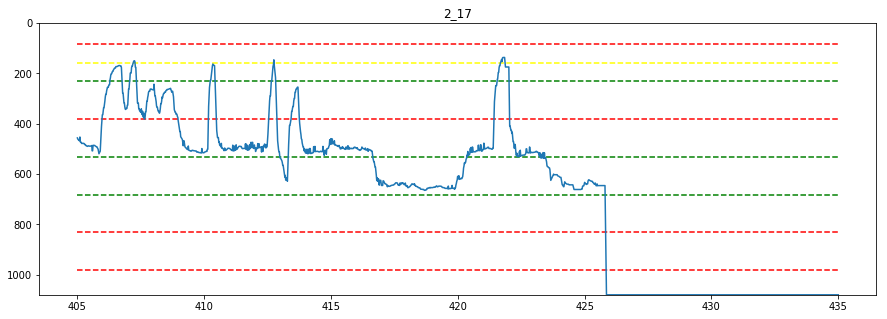

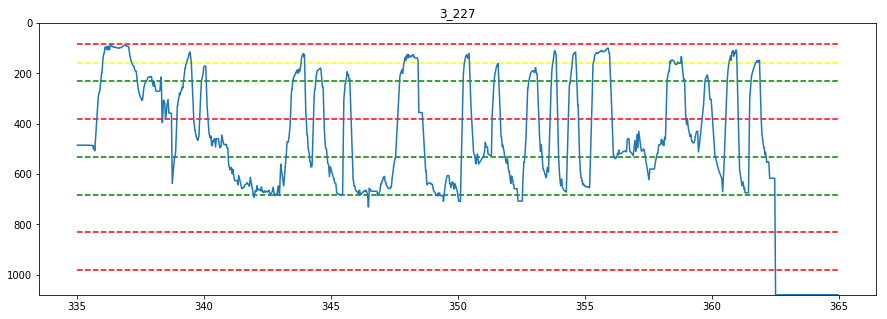

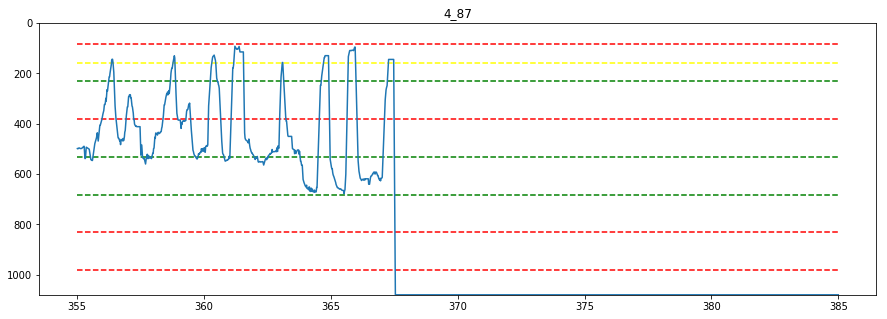

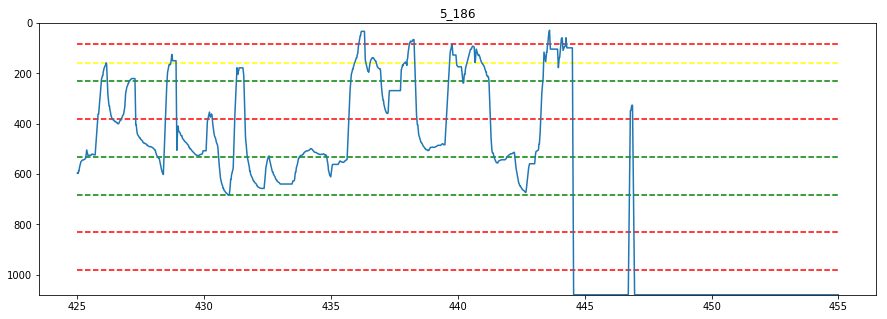

...

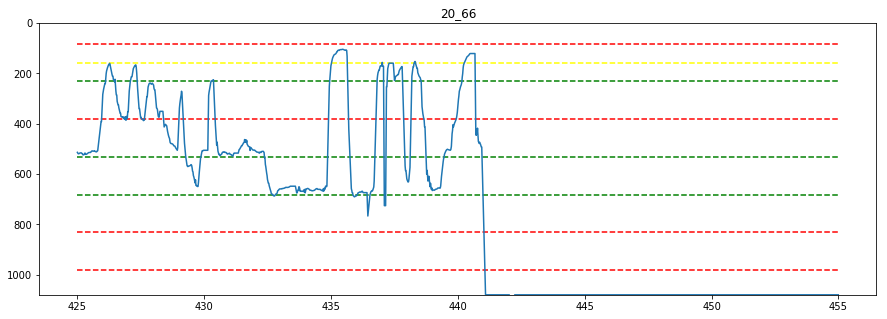

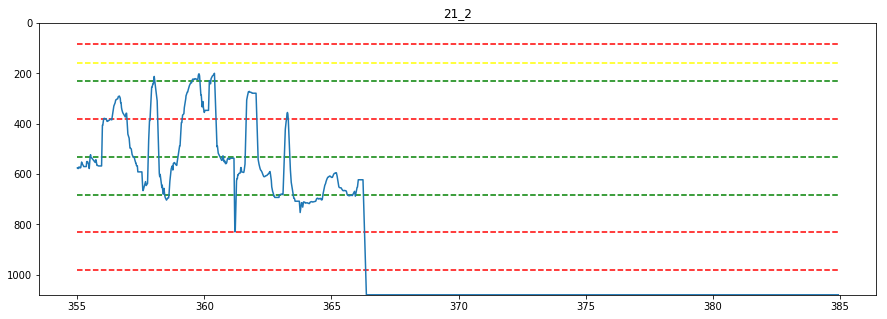

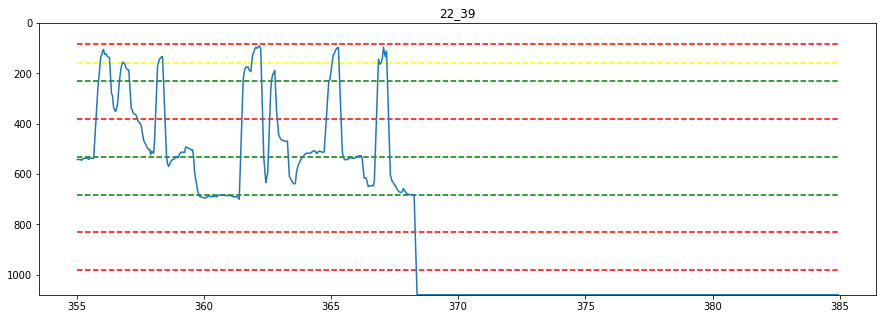

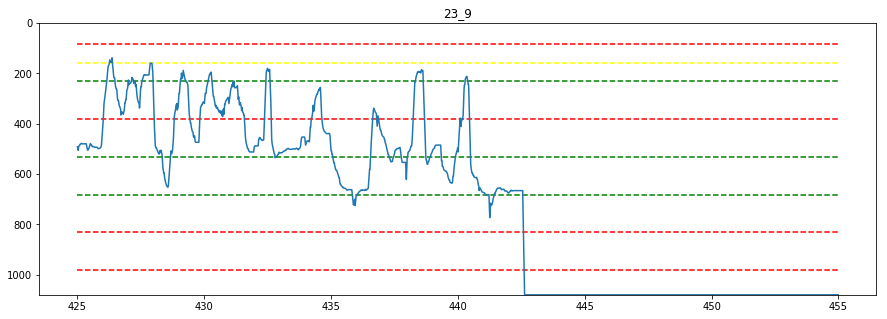

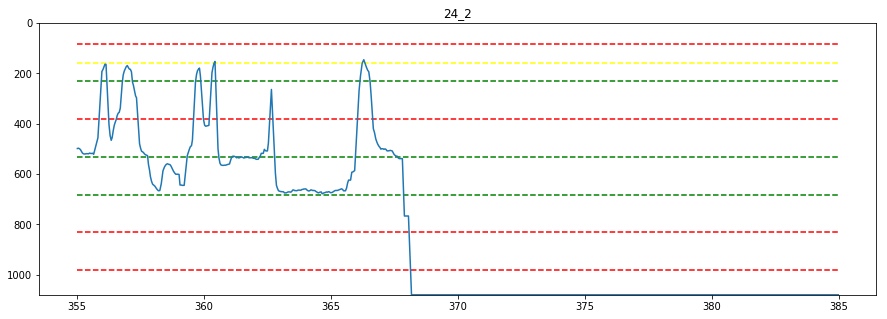

In [92]:
for i in range(1,25):
    name = str(i)
    check_y_plot(df_7[i-1],n=name)

In [16]:
for i in range(1,25):
    n = "e"+str(i)
    m = "e"+str(i)+"_check1"
    da = gl[n]
    da = da[da["time"]<5]
    gl[m]=da

In [96]:
check_line = []
for i in range(24):
    m = "e"+str(i+1)+"_check1"
    d = gl[m]
    d = d[d["time"]>2]
    check_line.append(d["y"].mean())

In [9]:
check_line1 = []
for i in range(4,25):
    name = "check_line_of_e"+str(i)
    df = gl["e"+str(i)]
    gl[name]=[]
    for j in range(1,8):
        ti1 = 5*j-3
        ti2 = 5*j
        d = df[df["time"]>ti1]
        d = d[d["time"]<ti2]
        gl[name].append(d["y"].mean())

In [560]:
def time_y_plot(df4):
    plt.figure(figsize=(15,5))
    plt.ylim(1080,0)
    name = "check_line_of_e"+str(m)
    df = gl[name]
    r = 32
    if len(df4[df4["y"]<(df[1]+2*df[0])/3])>0:
        n = str(m) + "_"+str(len(df4[df4["y"]<(df[1]+2*df[0])/3]))
    else:
        n =str(m) + "_0"
    plt.title(n)
    df4["y"] = df4.apply(finish,axis=1) 
    p = plt.hlines(df[0], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
#     p = plt.hlines((3*df[0]-df[1])/2, df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines((df[1]+2*df[0])/3, df4["time"].min(), df4["time"].max(), "yellow", linestyles='dashed')
    p = plt.hlines((2*df[0]+2*df[1])/3, df4["time"].min(), df4["time"].max(), "yellow", linestyles='dashed')
    p = plt.hlines(df[1], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[2], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[3], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[4], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[5], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[6], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
#     plt.title(titleduke(df4))

    plt.plot(df4["time"],df4["y"],color="b")

In [554]:
def check_y_plot(df4,title,fix_time):
    plt.figure(figsize=(15,5))
    plt.ylim(1080,0)
    r = 32
    if len(df4[df4["y"]<157])>0:
        title = str(title) + "_"+str(len(df4[df4["y"]<157]))
    plt.title(title)
    df4 = saccade(df4,fix_time=fix_time)
    sns.set_style("white")
    df4["y"] = df4.apply(finish,axis=1) 
    p = plt.hlines([50+r], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([125+r], df4["time"].min(), df4["time"].max(), "green", linestyles='dashed')
    p = plt.hlines([200+r], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([350+r], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([500+r], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([650+r], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([800+r], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines([950+r], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
#     plt.title(titleduke(df4))

    plt.plot(df4["time"],df4["y"],color="b")

In [774]:
def check_y_plot_revise(df4,n,m,fix_time=0.2,sac=True):   #n人目 m題目
    plt.figure(figsize=(15,5))
    plt.ylim(1080,0)
    
    name = "check_line_of_e"+str(n)
    df = gl[name]
    r = 32
    if sac == True:
        df4 = saccade(df4,fix_time=fix_time)
    if len(df4[df4["y"]<(df[1]+2*df[0])/3])>0:
        n = str(m) + "_"+str(len(df4[df4["y"]<(df[1]+2*df[0])/3]))
    else:
        n =str(m) + "_0"
    plt.title(n)
    df4["y"] = df4.apply(finish,axis=1) 
#     p = plt.hlines((3*df[0]-df[1])/2, df4["time"].min(), df4["time"].max(), "yellow", linestyles='dashed')
    p = plt.hlines(df[0], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
#     p = plt.hlines((df[0]+df[1])/2, df4["time"].min(), df4["time"].max(), "green", linestyles='dashed')
#     p = plt.hlines((3*df[0]-df[1])/2, df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
#     p = plt.hlines((df[1]+2*df[0])/3, df4["time"].min(), df4["time"].max(), "yellow", linestyles='dashed')
#     p = plt.hlines((df[0]+2*df[1])/3, df4["time"].min(), df4["time"].max(), "yellow", linestyles='dashed')
    p = plt.hlines(df[1], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[2], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[3], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[4], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[5], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
    p = plt.hlines(df[6], df4["time"].min(), df4["time"].max(), "red", linestyles='dashed')
#     plt.title(titleduke(df4))
    sns.set_style("white")

    plt.plot(df4["time"],df4["y"],color="b")

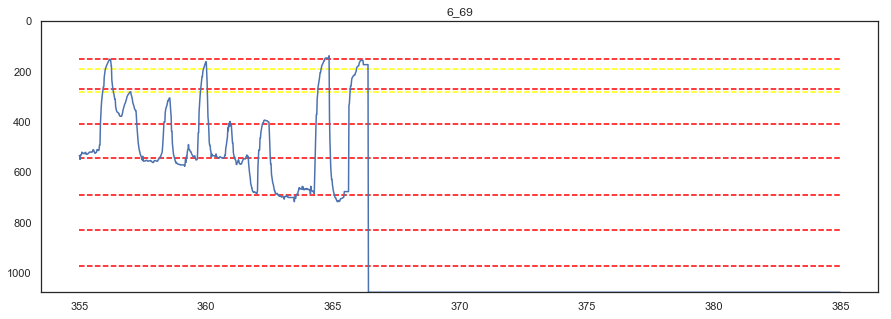

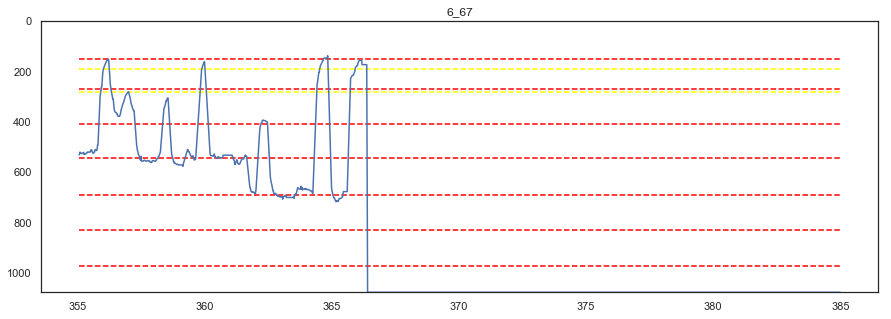

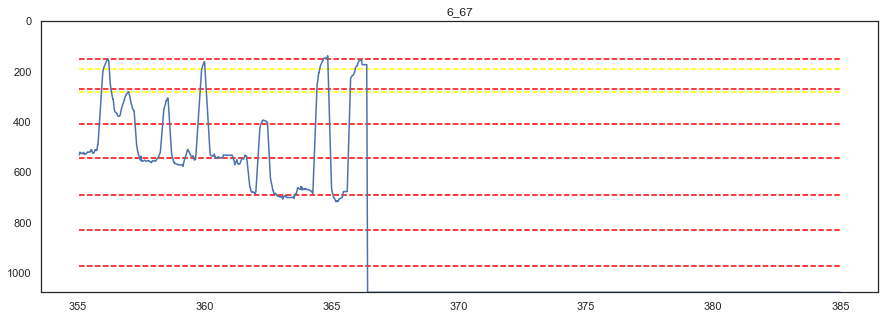

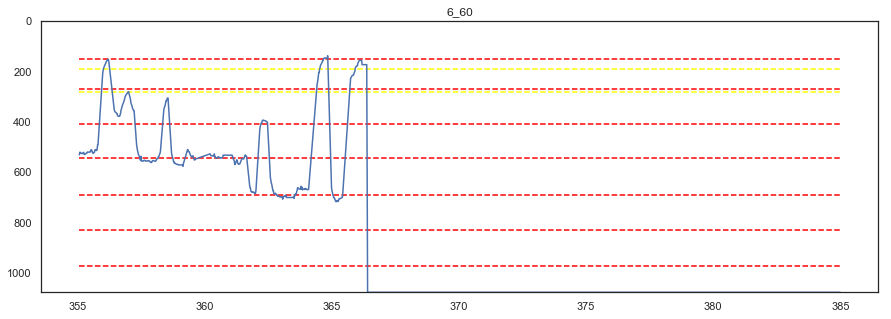

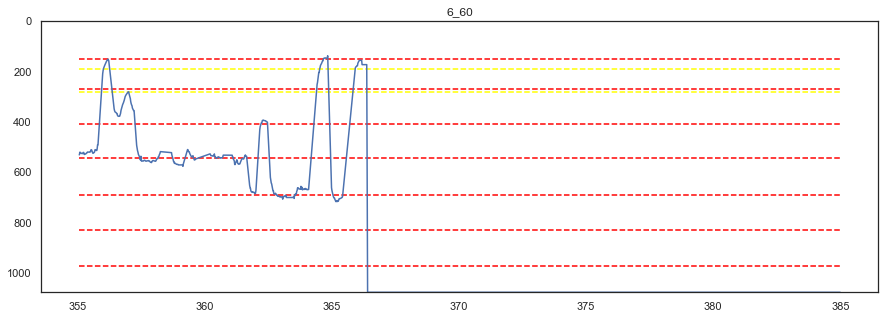

In [828]:
i = 5
check_y_plot_revise(df_7[i],i+1,sac=False)
check_y_plot_revise(df_7[i],i+1,fix_time=0.05)
check_y_plot_revise(df_7[i],i+1,fix_time=0.1)
check_y_plot_revise(df_7[i],i+1,fix_time=0.15)
check_y_plot_revise(df_7[i],i+1,fix_time=0.2)

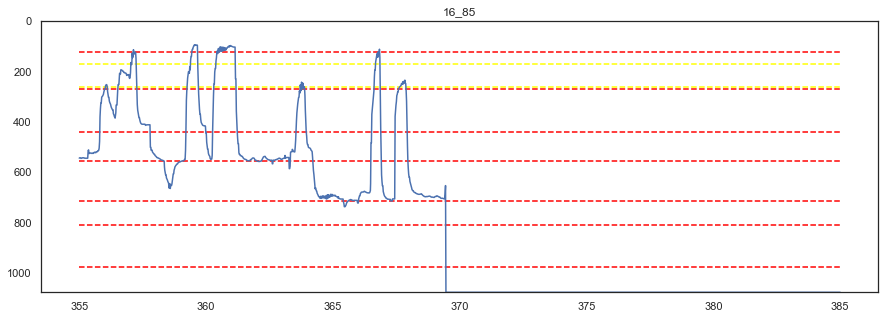

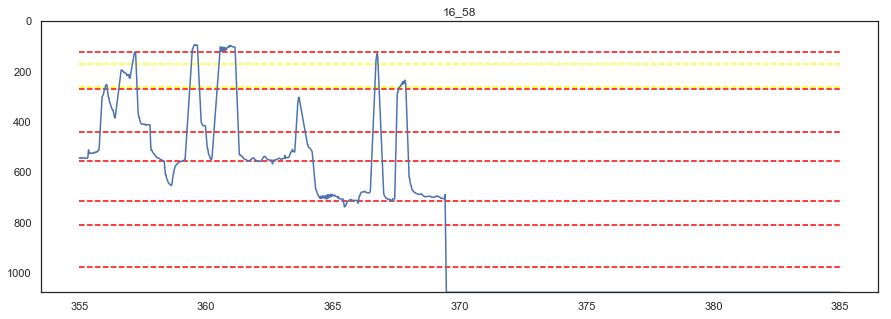

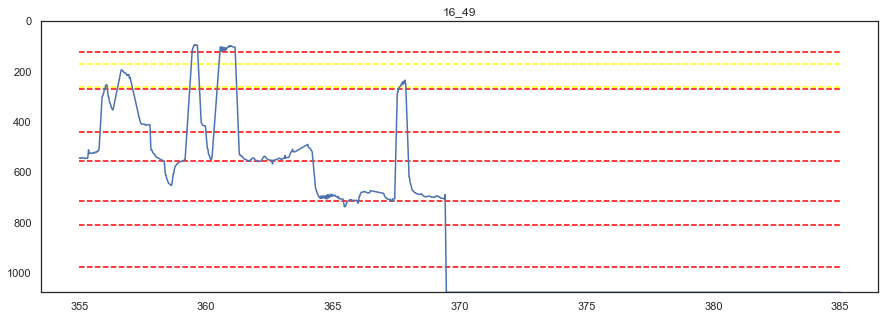

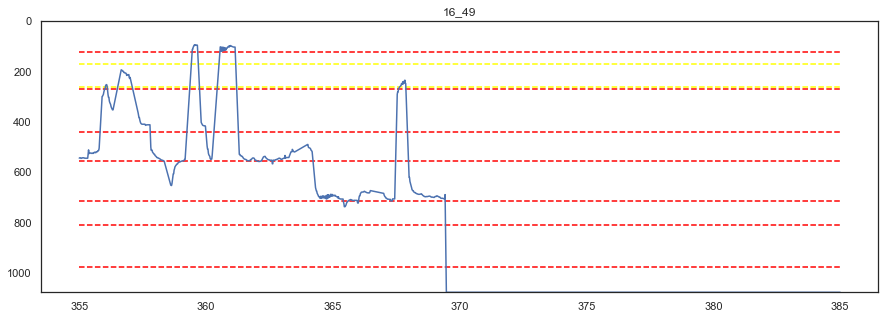

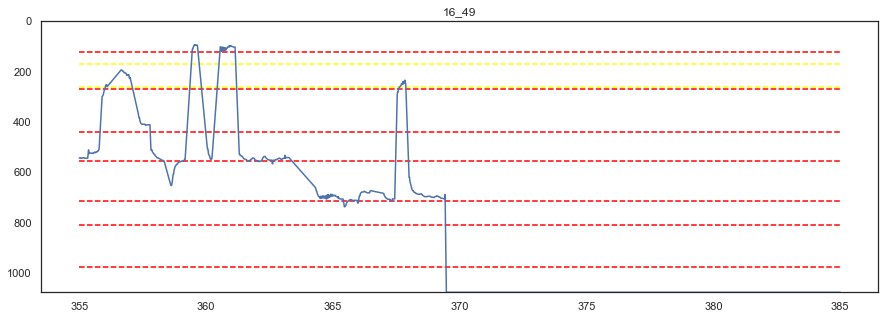

In [836]:
i = 15
check_y_plot_revise(df_7[i],i+1,sac=False)
check_y_plot_revise(df_7[i],i+1,fix_time=0.05)
check_y_plot_revise(df_7[i],i+1,fix_time=0.1)
check_y_plot_revise(df_7[i],i+1,fix_time=0.15)
check_y_plot_revise(df_7[i],i+1,fix_time=0.2)

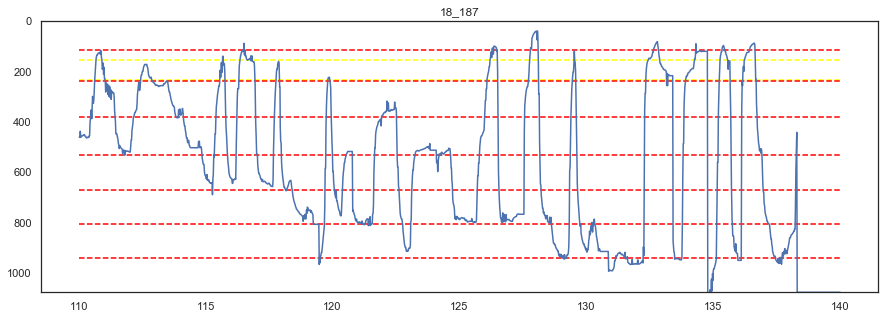

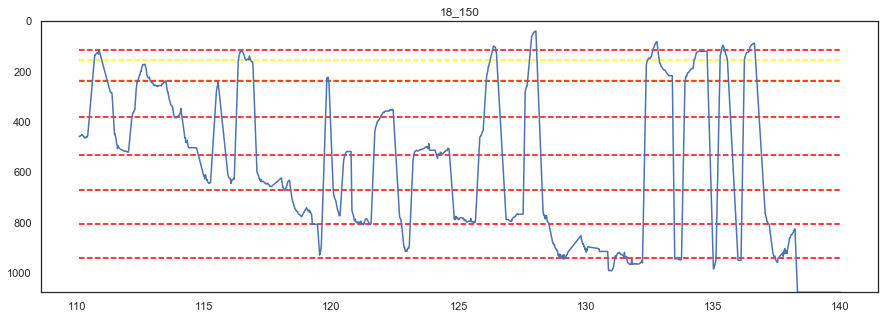

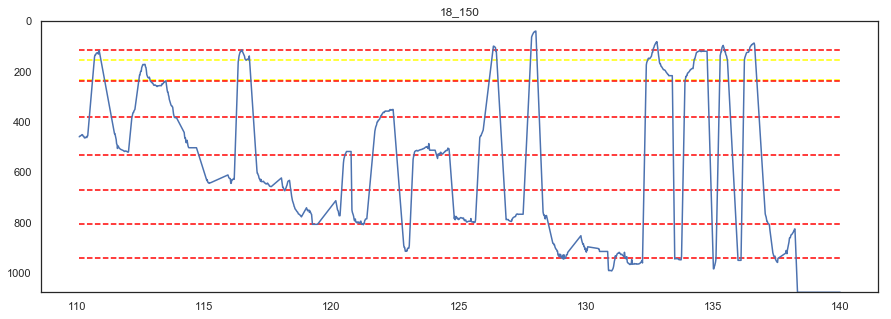

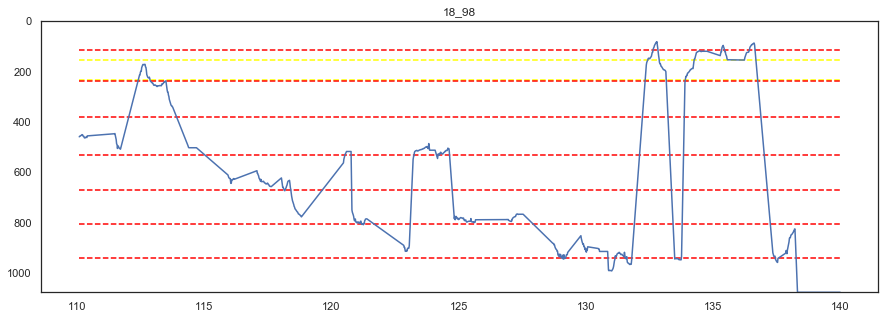

In [817]:
check_y_plot_revise(df_10[17],18,sac=False)
check_y_plot_revise(df_10[17],18,fix_time=0.05)
check_y_plot_revise(df_10[17],18,fix_time=0.1)
check_y_plot_revise(df_10[17],18,fix_time=0.2)

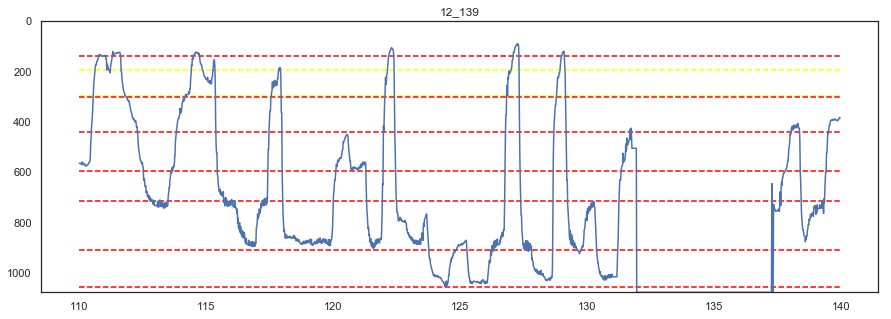

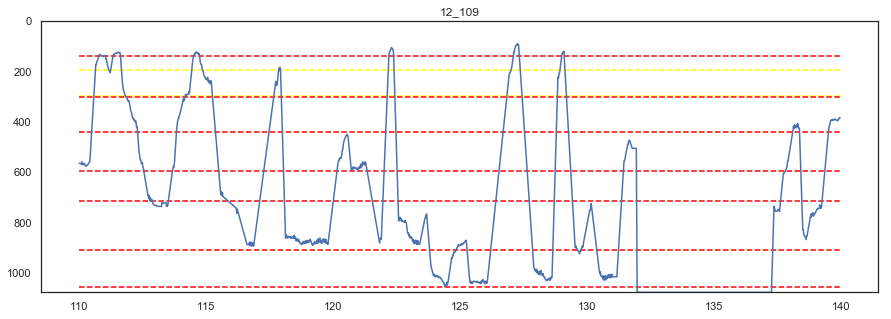

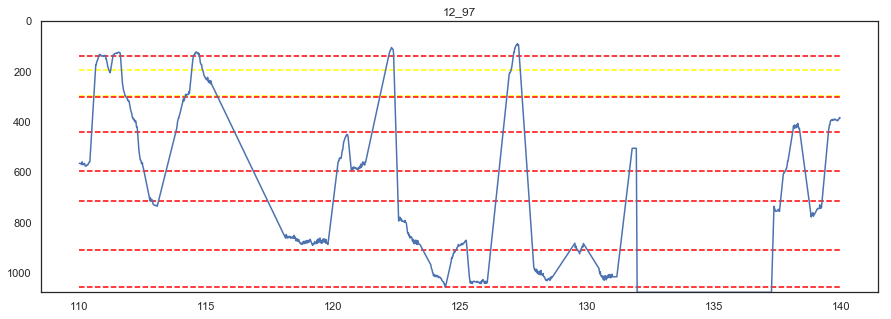

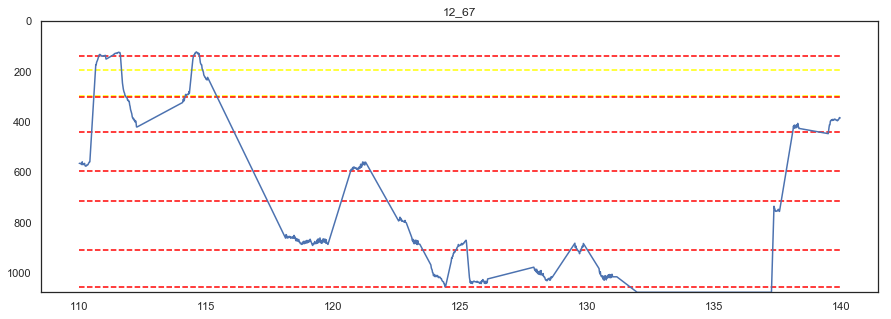

In [816]:
check_y_plot_revise(df_10[11],12,sac=False)
check_y_plot_revise(df_10[11],12,fix_time=0.05)
check_y_plot_revise(df_10[11],12,fix_time=0.1)
check_y_plot_revise(df_10[11],12,fix_time=0.2)

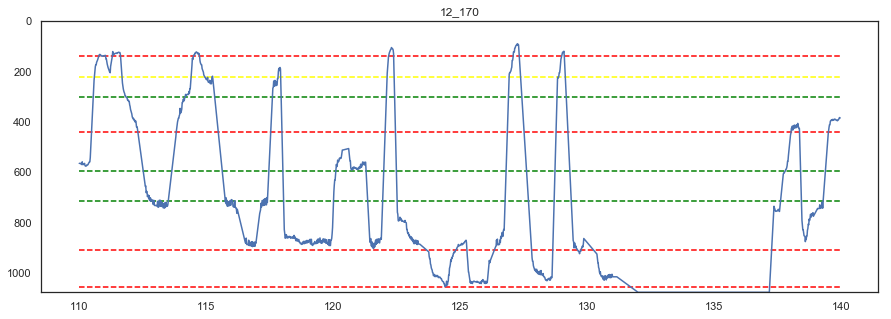

In [563]:
check_y_plot_revise(df[11],12,fix_time=0.2)

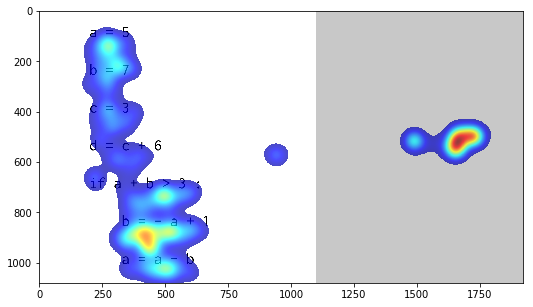

In [488]:
tf = saccade(df_10[11],fix_time=0.2)
tf = tf[["x","y","time"]].reset_index(drop=True)
ttf = tf.copy()
for i,j in tf.iterrows():
    if i !=0:
            ttf["time"].iloc[i] = tf["time"].iloc[i]-tf["time"].iloc[i-1]
ttf= np.array(ttf[1:])
heatmap = Fixpos2Densemap(ttf, 1920, 1080, img, 0.7, 10)
plt.figure(figsize=(15,5))
plt.ylim(1080,0)
# plt.title("e_"+str(k))
heat= cv2.cvtColor( heatmap, cv2.COLOR_BGR2RGB) 
plt.imshow(heat)
plt.show()

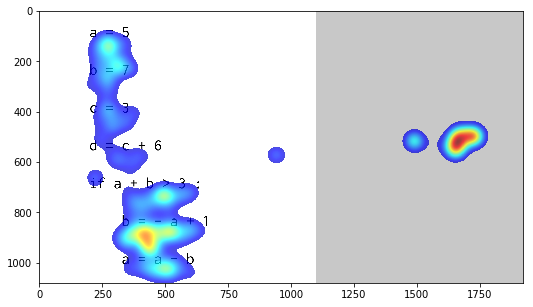

In [490]:
tf = saccade(df_10[11],fix_time=0.2)
tf = tf[["x","y","time"]].reset_index(drop=True)
ttf = tf.copy()
for i,j in tf.iterrows():
    if i !=0:
            ttf["time"].iloc[i] = tf["time"].iloc[i]-tf["time"].iloc[i-1]
ttf= np.array(ttf[1:])
heatmap = Fixpos2Densemap(ttf, 1920, 1080, img, 0.7, 20)
plt.figure(figsize=(15,5))
plt.ylim(1080,0)
# plt.title("e_"+str(k))
heat= cv2.cvtColor( heatmap, cv2.COLOR_BGR2RGB) 
plt.imshow(heat)
plt.show()

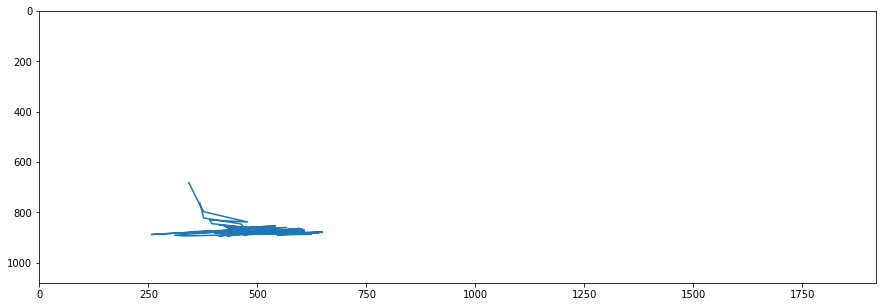

In [445]:
plt.figure(figsize=(15,5))
plt.ylim(1080,0)
plt.xlim(0,1920)
plt.plot(rf["x"],rf["y"])

In [481]:
d=df_10[11]
rf = d[d["time"]<120]
rf = rf[rf["time"]>118]
saccade(rf)

,time,x,y,r_AOI,velo,slow
0,118.011685,342.7976,681.8422,5,0.000000,False
1,118.028832,368.0532,769.9109,5,5136.009751,False
2,118.045115,377.2152,797.6826,5,1705.626935,False
3,118.062213,477.7625,838.3415,6,2377.977670,False
4,118.078513,390.6050,830.4984,6,481.177683,True
5,118.095670,396.3167,845.1395,6,853.315382,True
6,118.111816,500.3284,864.8348,6,1219.893342,True
7,118.129051,500.3284,864.8348,6,0.000000,True
8,118.145200,413.7562,850.7194,6,874.072698,True
9,118.162684,423.1208,852.2639,6,88.339425,True


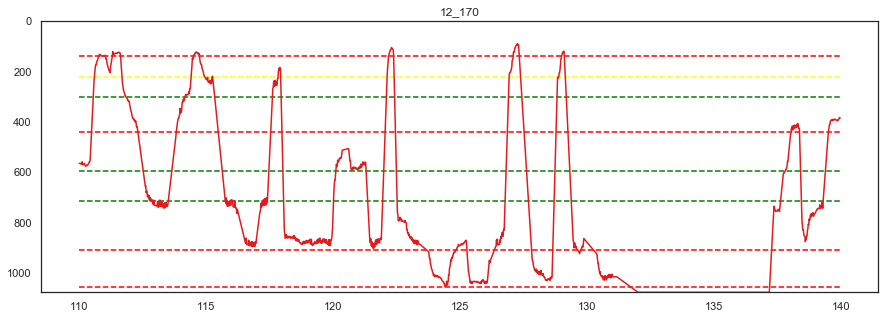

In [561]:
check_y_plot_revise(df[11],12,fix_time=0.2)

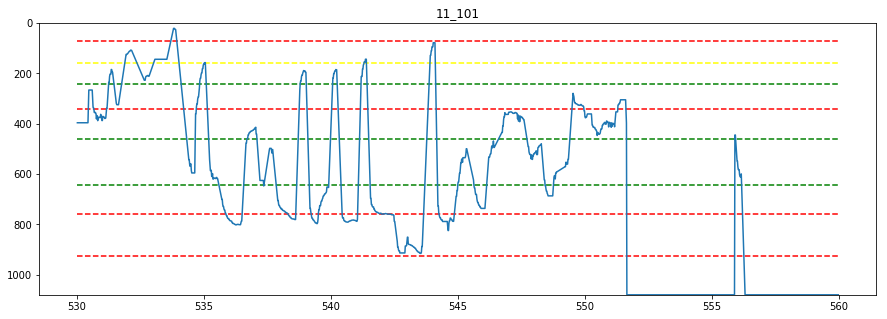

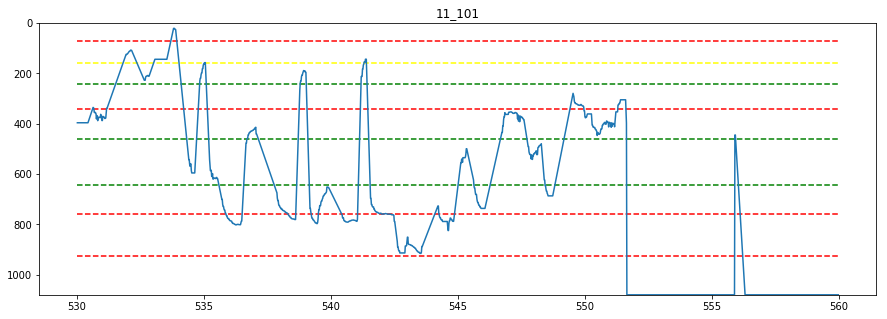

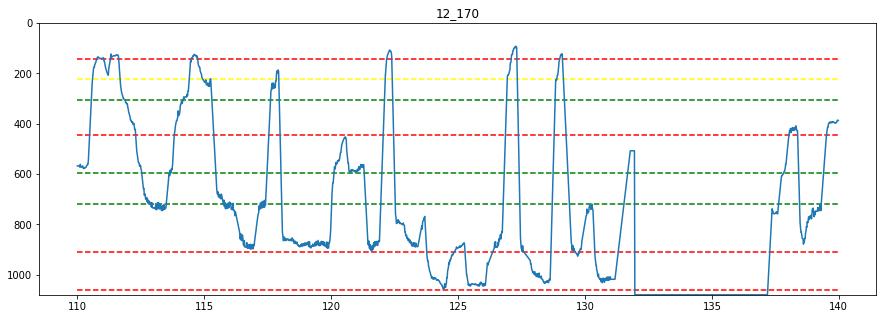

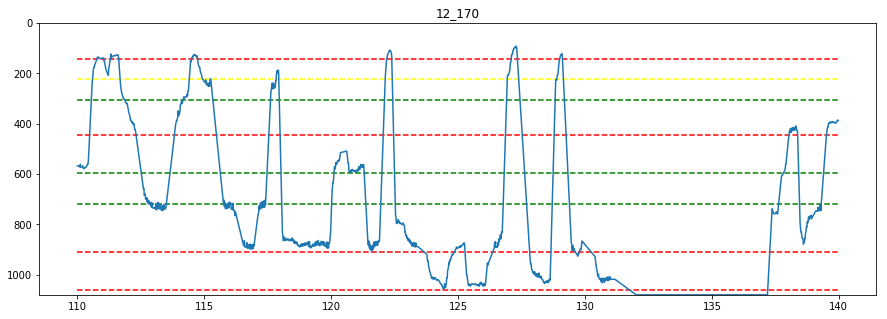

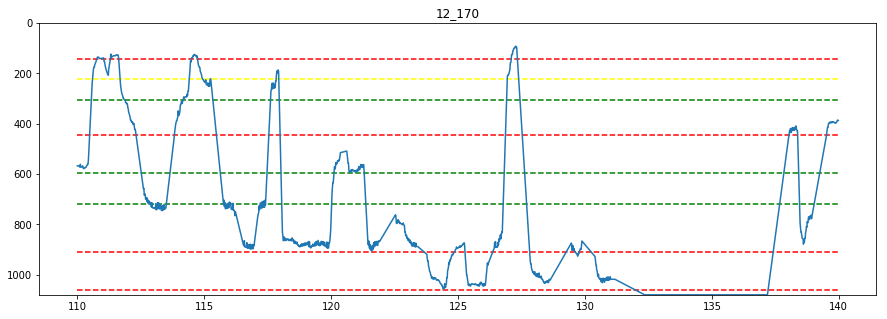

In [485]:
check_y_plot_revise(df[10],11,fix_time=0.1)
check_y_plot_revise(df[10],11,fix_time=0.2)
check_y_plot_revise(df[11],12,fix_time=0.1)
check_y_plot_revise(df[11],12,fix_time=0.2)
check_y_plot_revise(df[11],12,fix_time=0.3)

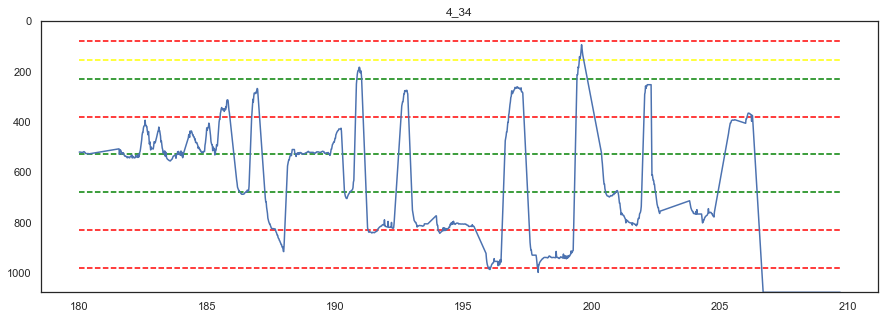

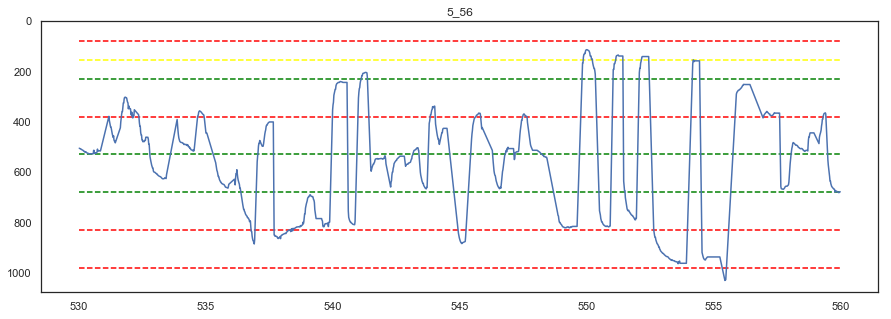

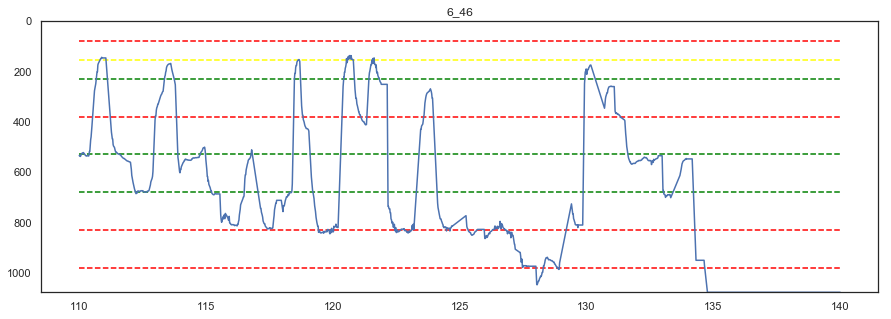

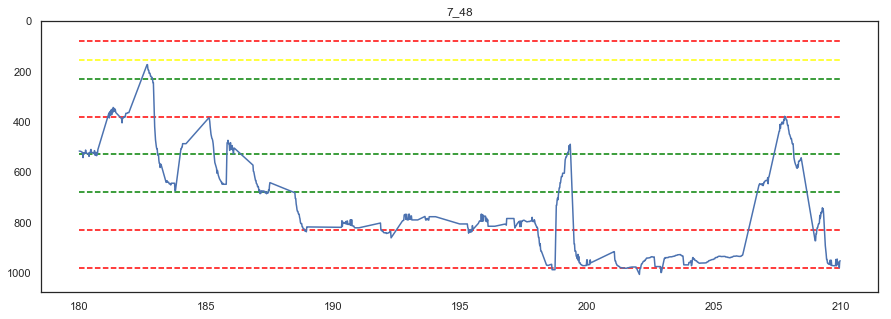

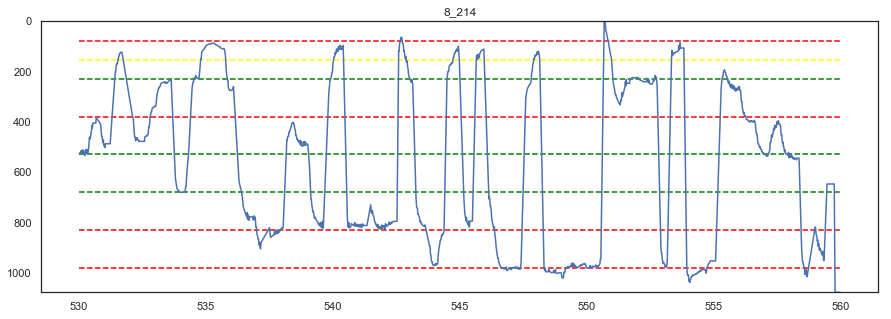

...

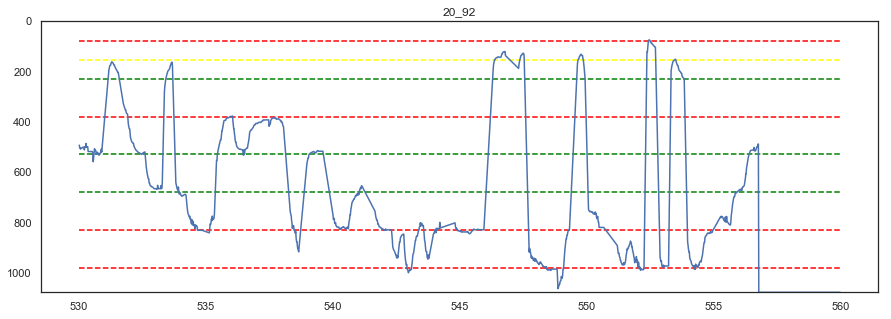

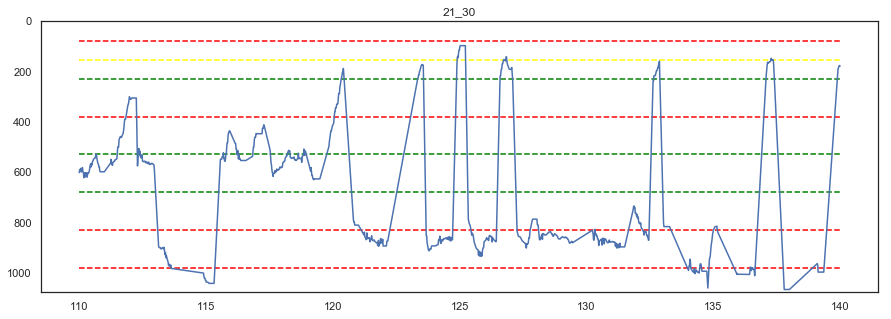

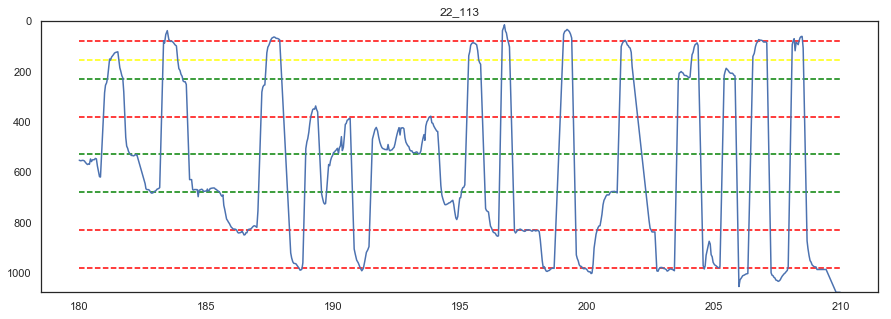

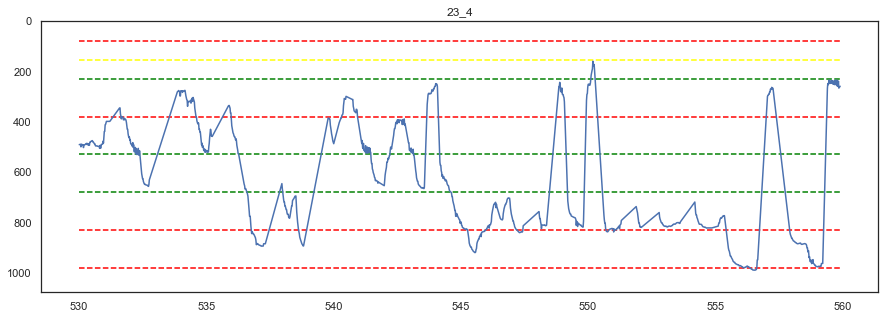

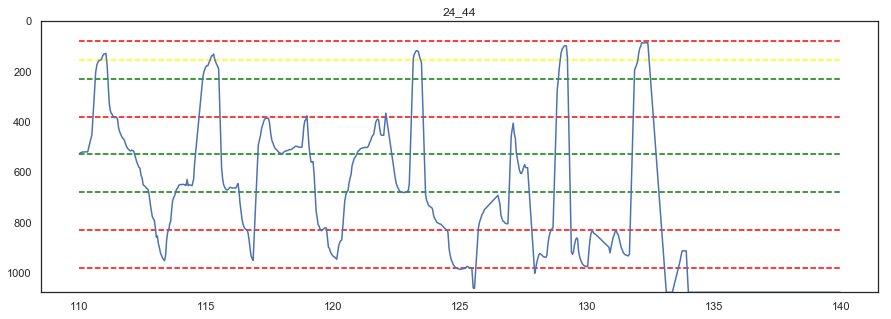

In [566]:
##あとから
for i in  range(4,25):
    df = gl["df_10"]
    check_y_plot(df[i-1],i)

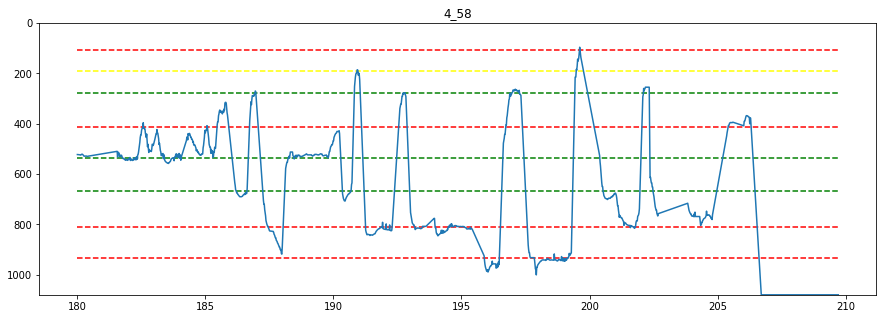

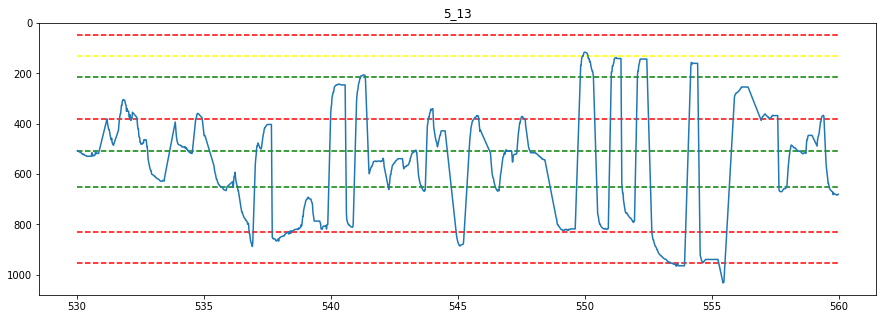

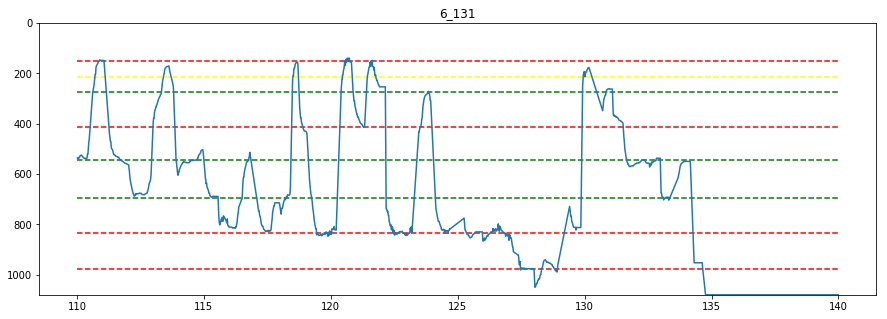

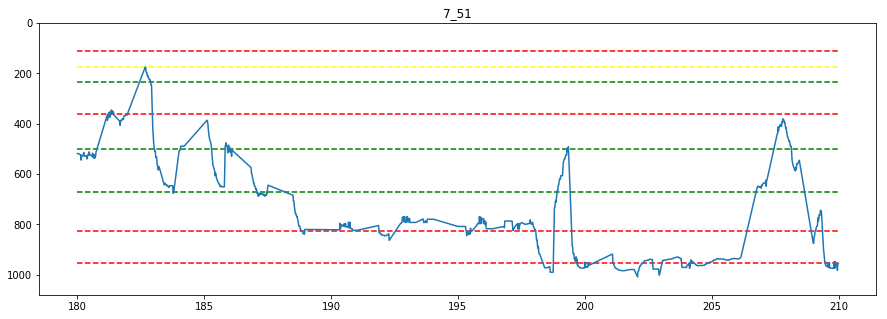

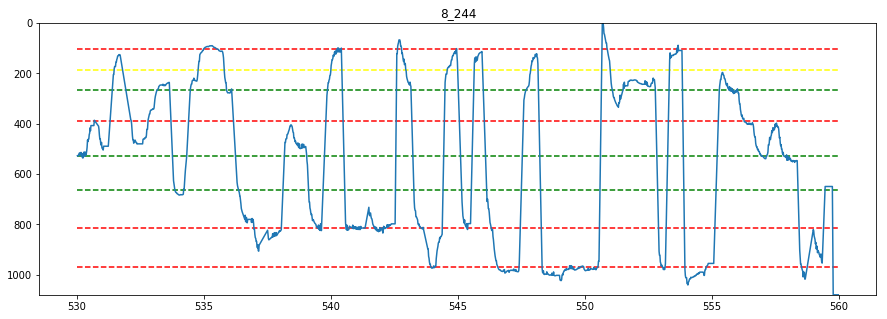

...

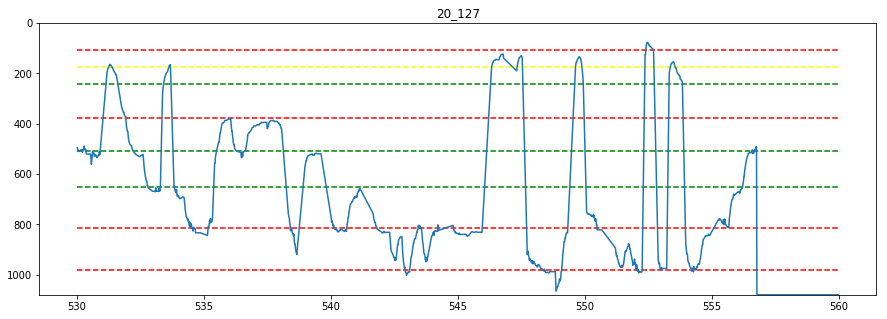

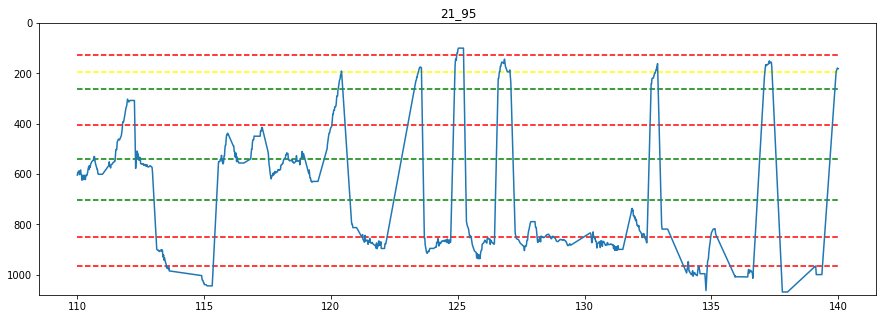

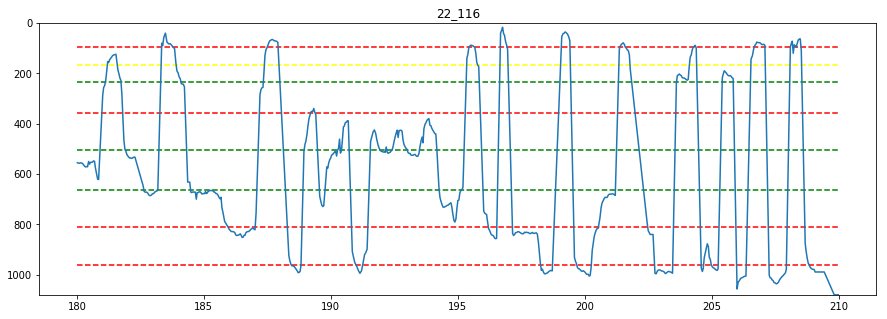

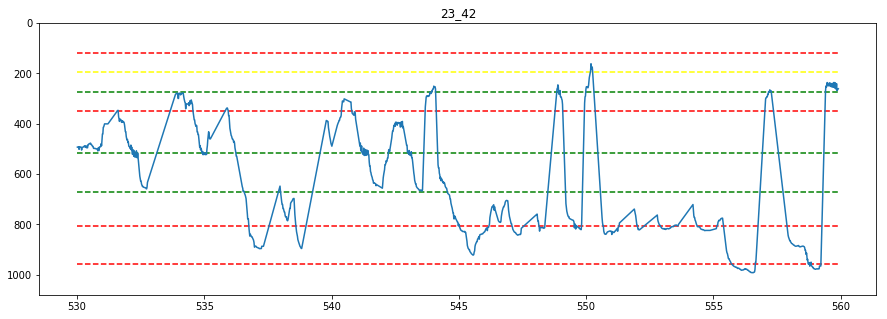

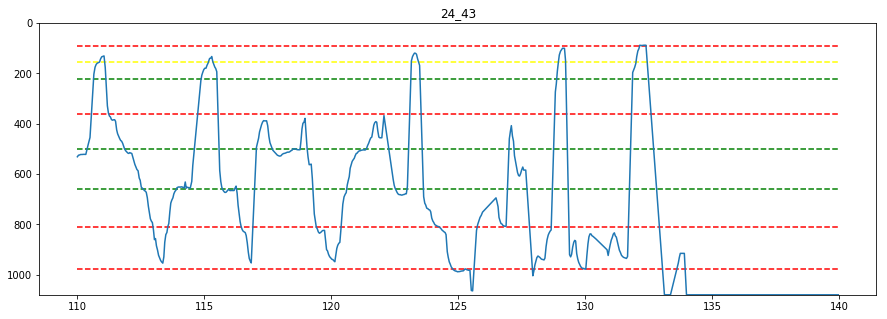

In [494]:
##あとから
for i in  range(4,25):
    df = gl["df_10"]
    check_y_plot_revise(df[i-1],i)

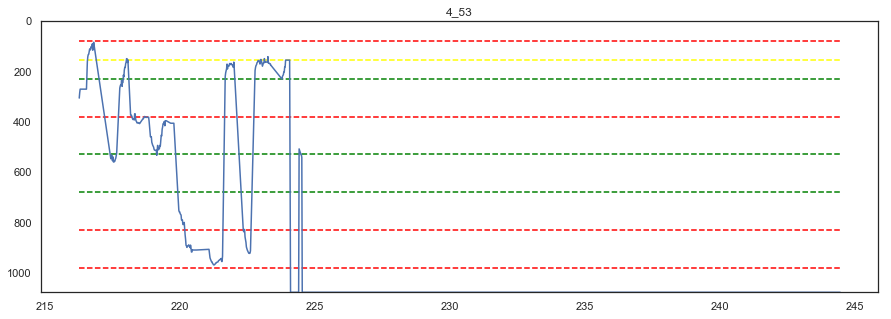

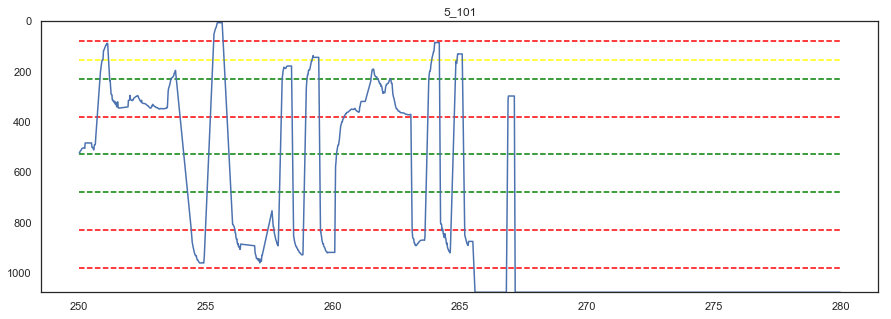

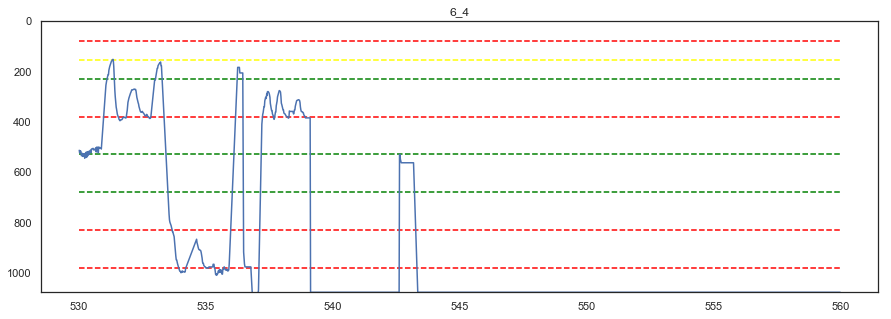

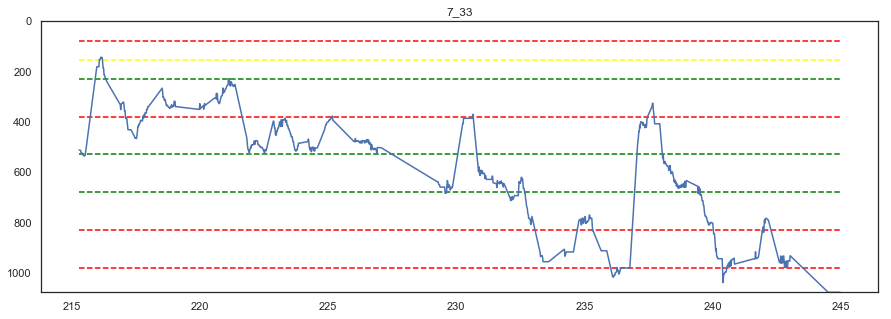

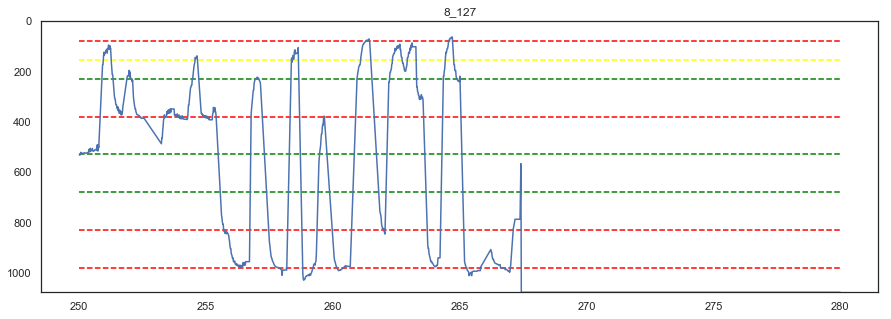

...

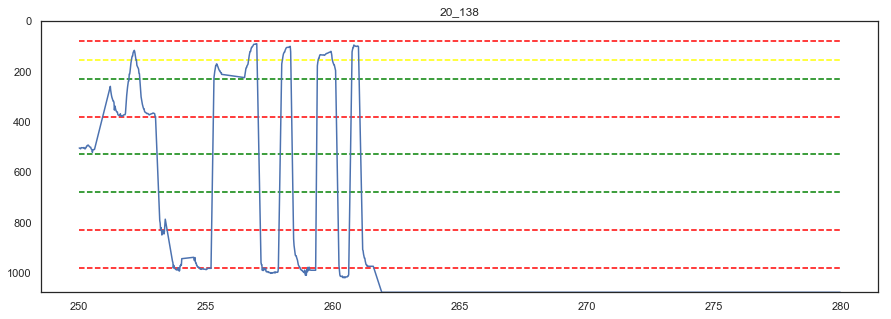

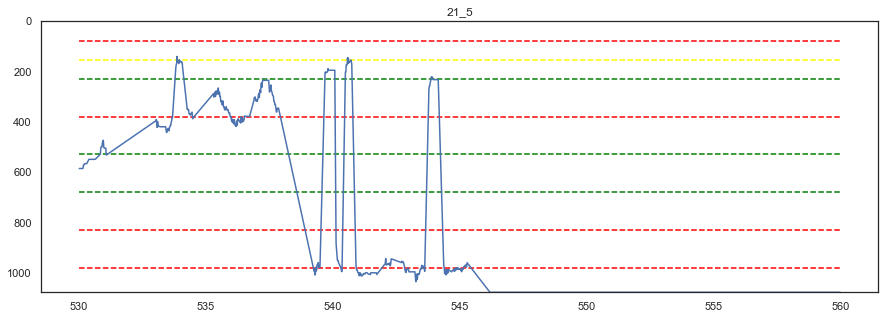

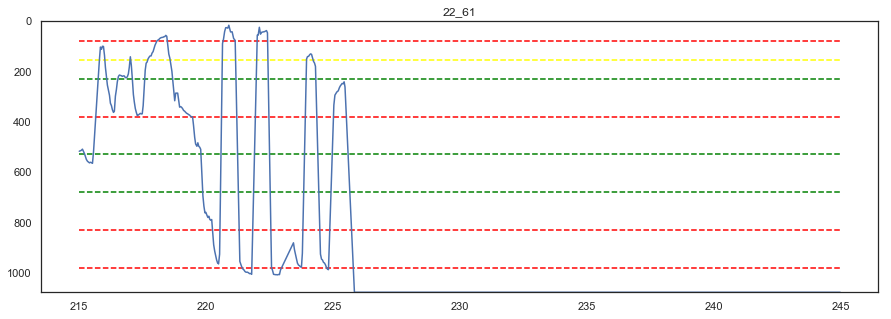

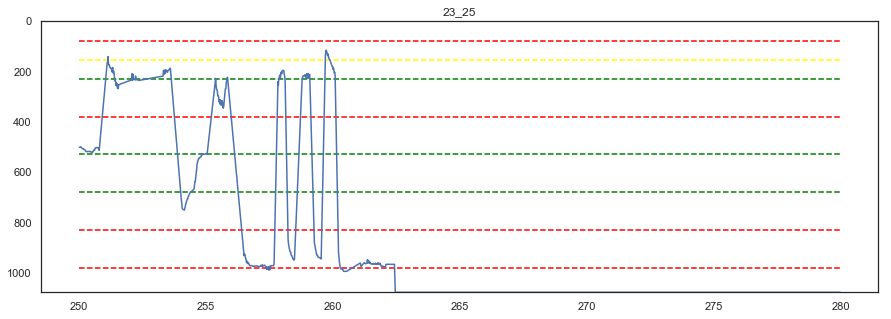

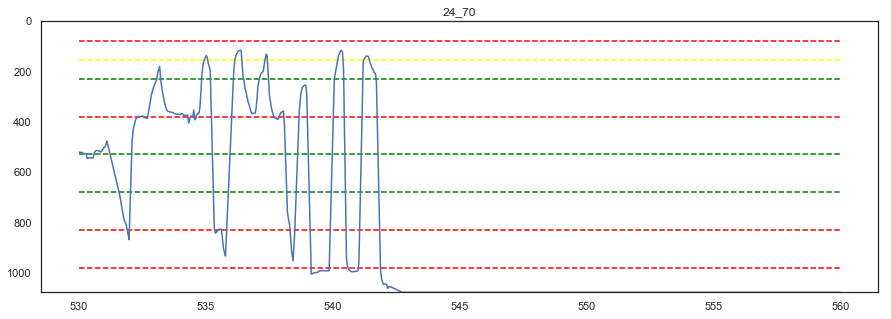

In [569]:
##あとから
for i in  range(4,25):
    df = gl["df_14"]
    check_y_plot(df[i-1],i)

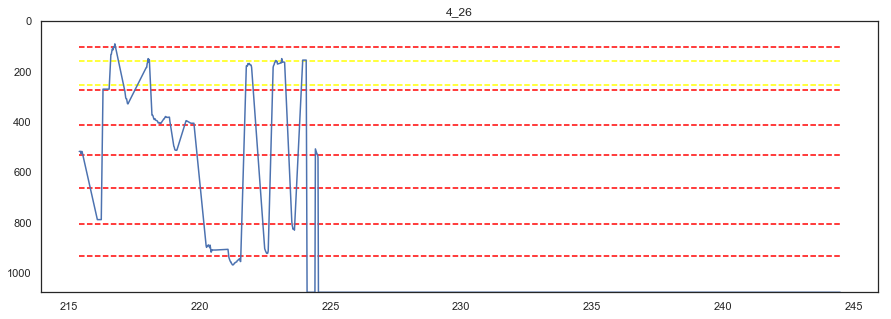

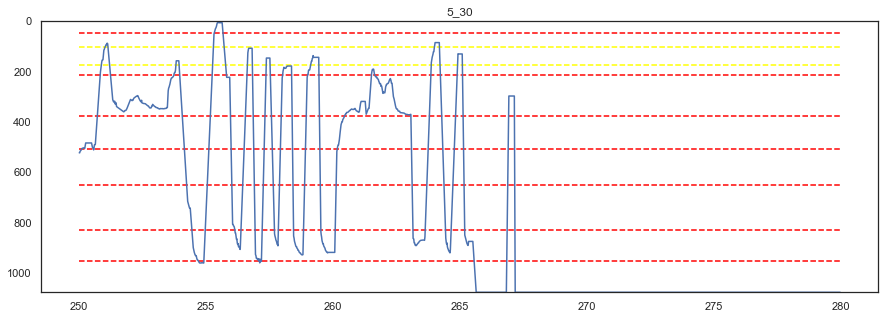

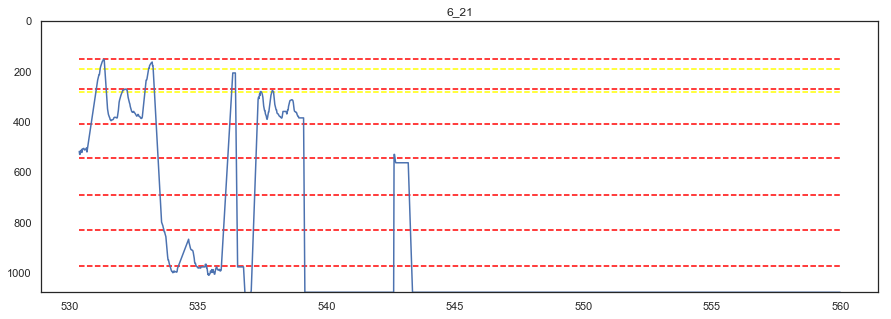

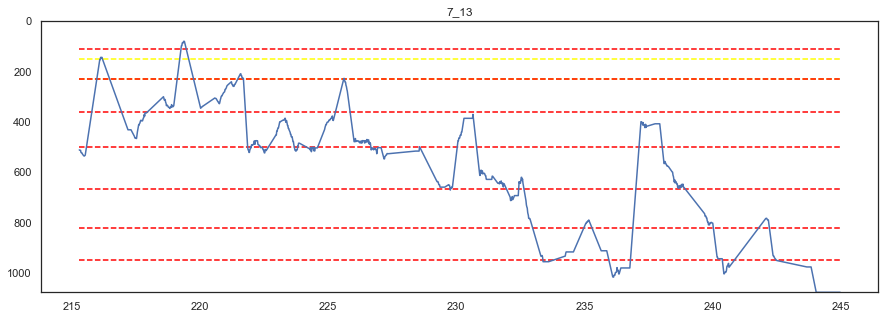

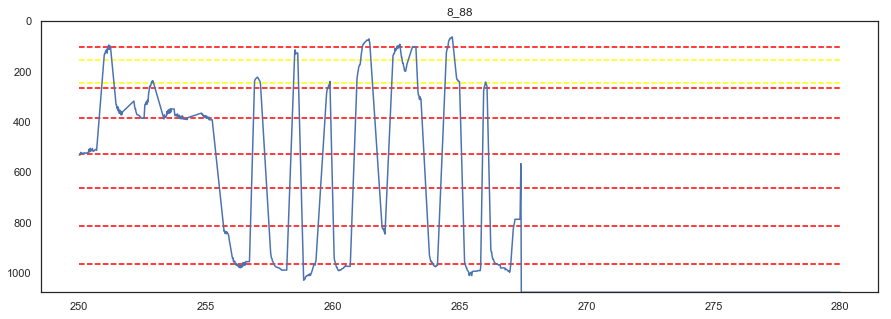

...

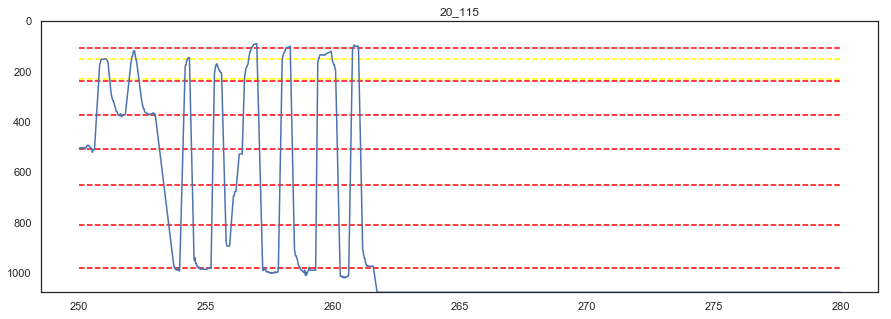

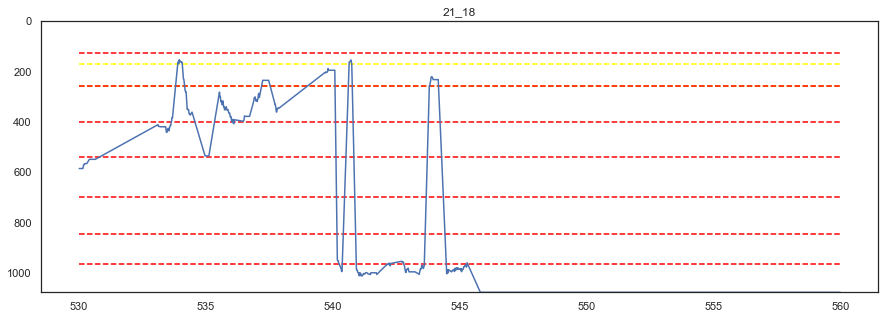

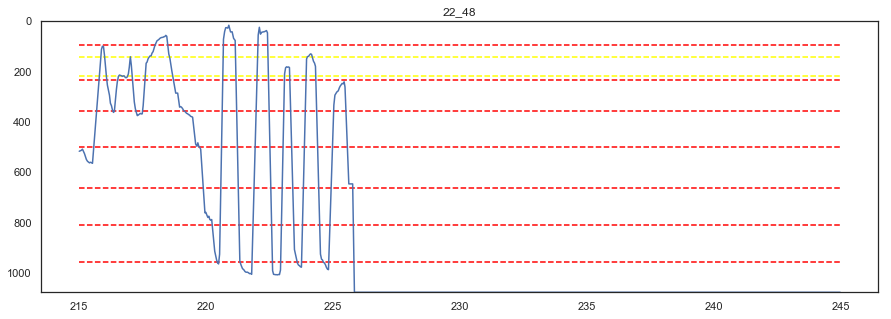

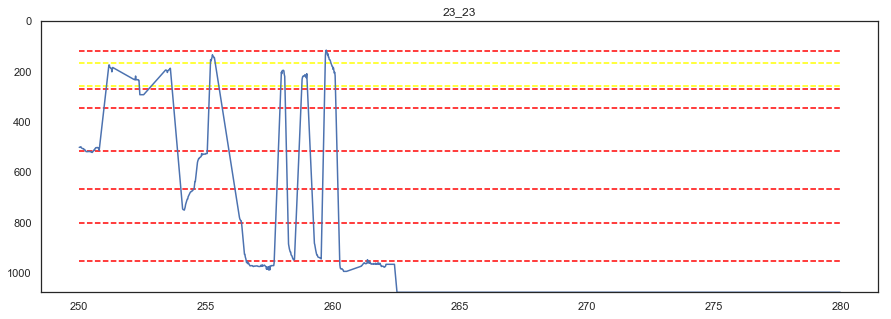

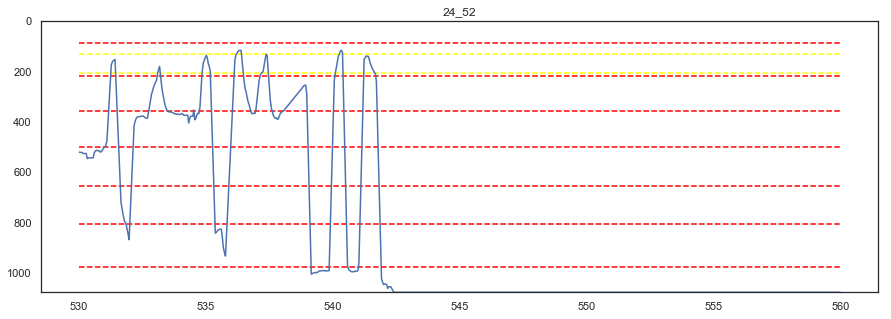

In [1151]:
##あとから
for i in  range(4,25):
    df = gl["df_14"]
    check_y_plot_revise(df[i-1],i,fix_time=0.1)

1790 1790
1785 1785
1785 1785
1797 1797
1780 1780
1792 1792
1787 1787
1791 1791
1798 1798
1797 1797
1791 1791
1760 1760
1790 1790
1789 1789
1795 1795
1787 1787
1788 1788
1774 1774
1393 1393
1777 1777
724 724


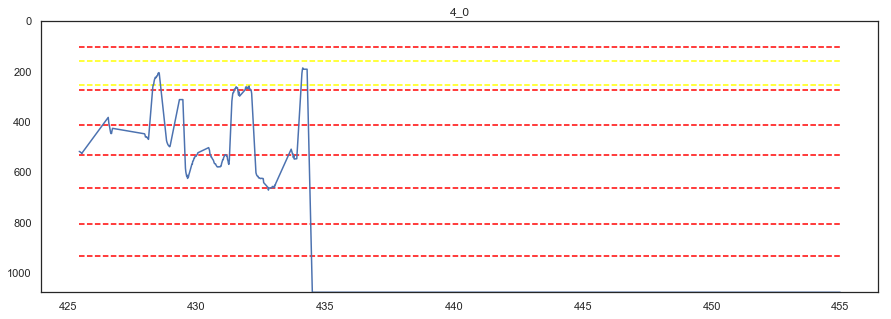

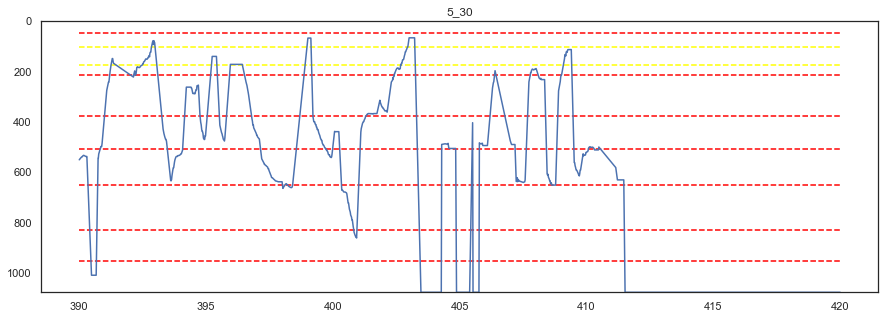

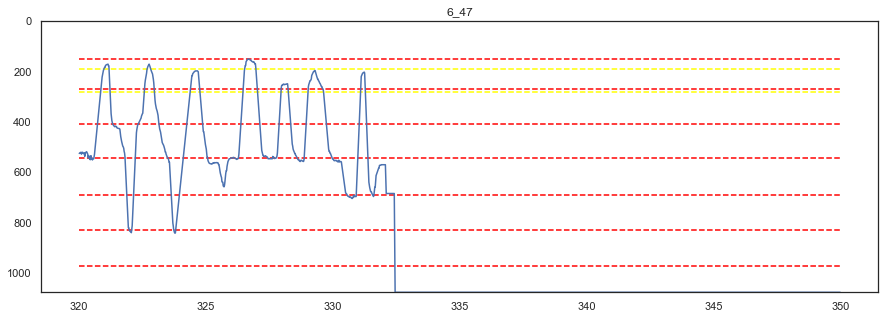

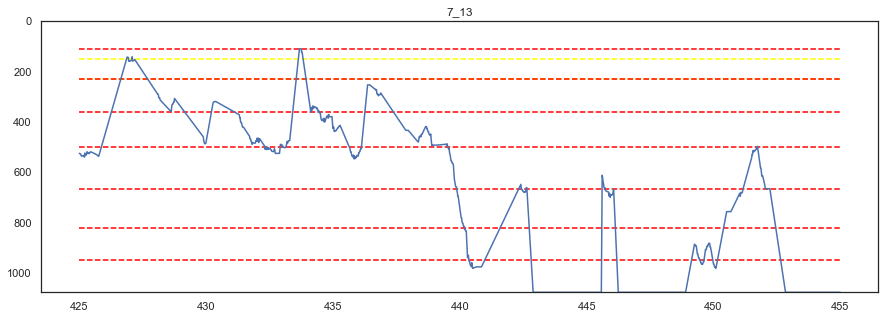

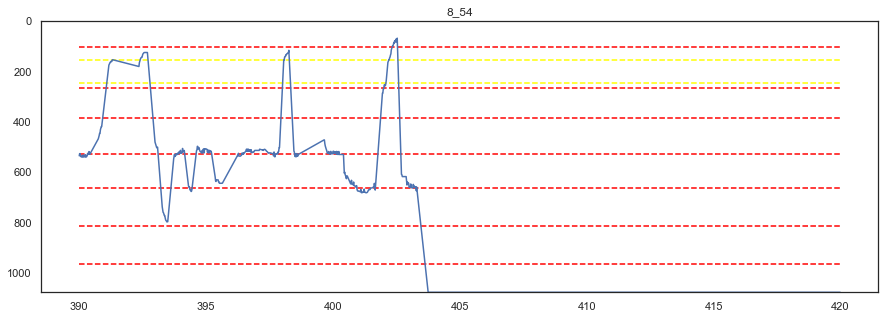

...

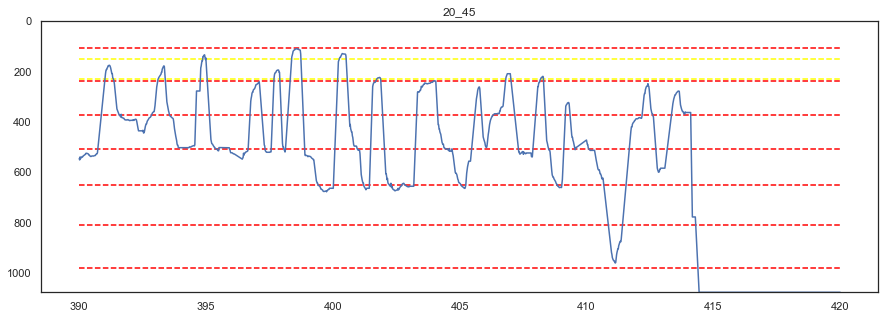

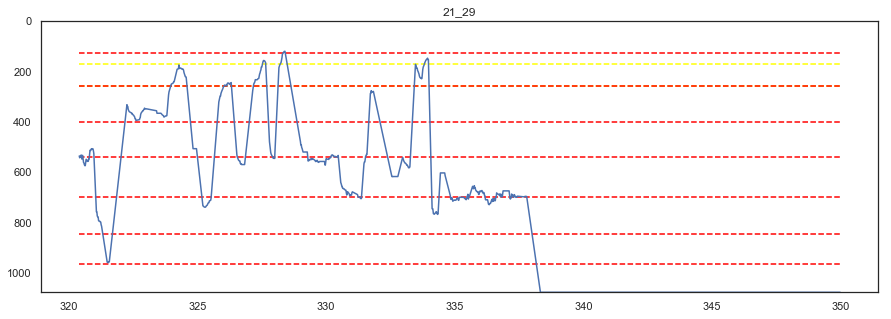

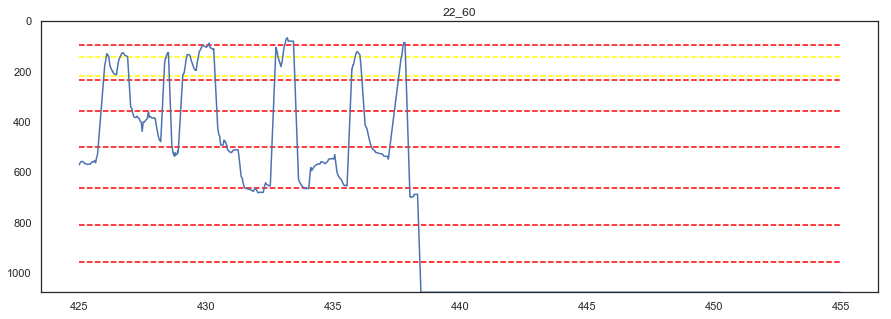

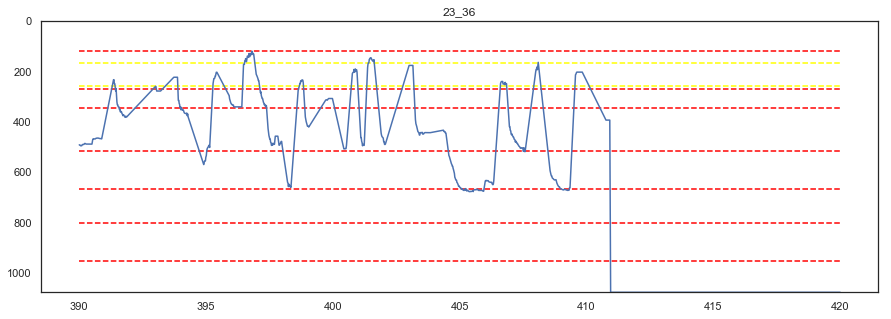

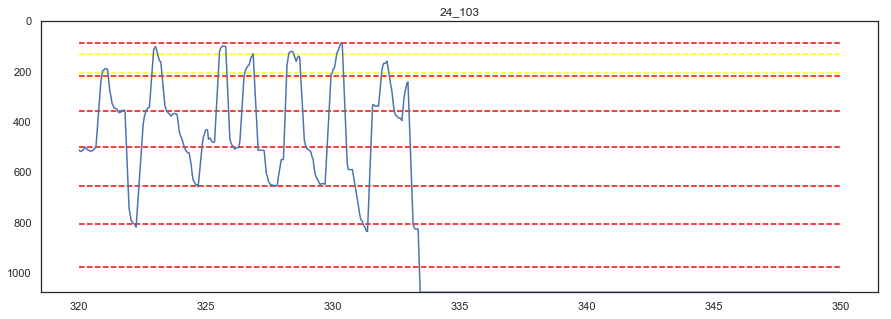

In [1076]:
##あとから
for i in  range(4,25):
    df = gl["df_15"]
    check_y_plot_revise(df[i-1],i,fix_time=0.1)

In [1331]:
for i in range(1,16):
    name = "page_rank_"+str(i)+"_add"
    df = np.array([])
    line = lines[i-1]
    for j in range(1,4):
        A,_=page_rank(j,i,fix_time=0.1)
        A = np.array(A)
        df=np.append(df,A)
    df=df.reshape(3,-1)
    gl[name]=df
    

In [110]:
page_rank_1


array([[0.339 , 0.468 , 0.1931],
       [0.2164, 0.4855, 0.2981],
       [0.2462, 0.6018, 0.152 ],
       [0.2693, 0.4634, 0.2673],
       [0.1419, 0.6103, 0.2478],
       [0.2276, 0.5502, 0.2222],
       [0.1839, 0.2824, 0.5337],
       [0.2644, 0.4781, 0.2575],
       [0.1528, 0.5245, 0.3227],
       [0.328 , 0.3846, 0.2873],
       [0.3154, 0.489 , 0.1956],
       [0.2943, 0.4263, 0.2794],
       [0.1515, 0.5275, 0.3211],
       [0.2943, 0.4384, 0.2672],
       [0.1807, 0.5755, 0.2438],
       [0.3193, 0.5066, 0.1741],
       [0.2527, 0.5017, 0.2457],
       [0.2359, 0.501 , 0.2631],
       [0.2217, 0.4617, 0.3166],
       [0.3   , 0.4003, 0.2997],
       [0.191 , 0.4377, 0.3714],
       [0.2709, 0.4075, 0.3216],
       [0.2975, 0.4417, 0.2608],
       [0.113 , 0.5927, 0.2943]])

In [1360]:
# page_rank_1 = np.vstack([page_rank_1_add,page_rank_1])
page_rank_1=page_rank_1[9:]

In [1361]:
for i in range(2,16):
    name = "page_rank_"+str(i)
    name_add = "page_rank_"+str(i)+"_add"
    gl[name] = np.vstack([gl[name_add],gl[name]])

In [1363]:
len(page_rank_4)

24

In [1339]:
page_rank_1_add[2]

array([0.246, 0.602, 0.152])

In [1346]:
x = np.array([[2,4],[3,6]])
y = np.array([[5,7],[10,17]])
np.vstack([x,y])
# z = np.array([10,17])
# np.insert((np.insert(x,0,y)),0,z)

array([[ 2,  4],
       [ 3,  6],
       [ 5,  7],
       [10, 17]])

In [1134]:
page_rank_15=np.array([])
for i in range(4,25):
    A,_=page_rank(i,15,fix_time=0.1)
    A = np.array(A)
    page_rank_15=np.append(page_rank_15,A)
page_rank15=page_rank_15.reshape(21,-1)

In [1137]:
page_rank_15=page_rank15

In [1136]:
page_rank_9=np.array([])
for i in range(4,25):
    A,_=page_rank(i,9,fix_time=0.1)
    A = np.array(A)
    page_rank_9=np.append(page_rank_9,A)
page_rank_9=page_rank_9.reshape(21,-1)
page_rank_9

array([[0.15 , 0.275, 0.089, 0.333, 0.154],
       [0.136, 0.2  , 0.221, 0.255, 0.189],
       [0.191, 0.184, 0.182, 0.224, 0.219],
       [0.1  , 0.109, 0.261, 0.354, 0.177],
       [0.225, 0.136, 0.177, 0.266, 0.196],
       [0.179, 0.168, 0.166, 0.266, 0.22 ],
       [0.214, 0.131, 0.246, 0.272, 0.137],
       [0.068, 0.264, 0.244, 0.277, 0.148],
       [0.214, 0.128, 0.271, 0.201, 0.185],
       [0.174, 0.165, 0.166, 0.303, 0.192],
       [0.177, 0.254, 0.142, 0.263, 0.163],
       [0.122, 0.231, 0.126, 0.272, 0.249],
       [0.192, 0.226, 0.162, 0.238, 0.182],
       [0.134, 0.264, 0.115, 0.291, 0.195],
       [0.14 , 0.233, 0.195, 0.266, 0.167],
       [0.16 , 0.214, 0.14 , 0.276, 0.21 ],
       [0.141, 0.285, 0.139, 0.229, 0.206],
       [0.135, 0.149, 0.211, 0.265, 0.241],
       [0.162, 0.253, 0.151, 0.214, 0.22 ],
       [0.166, 0.216, 0.053, 0.338, 0.227],
       [0.134, 0.189, 0.215, 0.295, 0.167]])

In [52]:
for i in range(1,2):
    name1 = "page_rank_"+str(i)
    df = np.array([])
    line = lines[i-1]
    for j in range(1,25):
        name2 = "seni_"+str(j)+"_"+str(i)
        A,B=page_rank(j,i,fix_time=0.1)
        gl[name2]=B
        A = np.array(A)
        df=np.append(df,A)
    df=df.reshape(24,-1)
    gl[name1]=df
    

In [121]:
for i in range(1,16):
    print(i)
    name1 = "page_rank_"+str(i)+"nofix"
    df = np.array([])
    line = lines[i-1]
    for j in range(1,25):
        name2 = "seni_"+str(j)+"_"+str(i)+"nofix"
        A,B=page_rank(j,i,fix_time=0)
        gl[name2]=B
        A = np.array(A)
        df=np.append(df,A)
    df=df.reshape(24,-1)
    gl[name1]=df
    

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15


In [75]:
i=15
if i%5==0:
        print(i)
name1 = "page_rank_"+str(i)
df = np.array([])
line = lines[i-1]
for j in range(1,25):
        print(j)
        name2 = "seni_"+str(j)+"_"+str(i)
        A,B=page_rank(j,i,fix_time=0.1)
        gl[name2]=B
        A = np.array(A)
        df=np.append(df,A)
df=df.reshape(24,-1)
gl[name1]=df
    

15
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24


In [112]:
seni_2_15

matrix([[0.5738, 0.4049, 0.0071, 0.    , 0.0142, 0.    , 0.    ],
        [0.3212, 0.6291, 0.0263, 0.    , 0.0234, 0.    , 0.    ],
        [0.0314, 0.0095, 0.915 , 0.0441, 0.    , 0.    , 0.    ],
        [0.0042, 0.0083, 0.0374, 0.9335, 0.0166, 0.    , 0.    ],
        [0.0065, 0.0128, 0.    , 0.0513, 0.9293, 0.    , 0.    ],
        [0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 0.    , 0.    , 0.    , 0.    , 0.    ]])

In [ ]:
for i in range(1,15):
    for j in range(1,25):
        name = "seni_"+str(j)+"_"+str(i)
        _,A=page_rank(j,i,fix_time=0.1)
        gl[name]=A

In [1610]:
i=15
for j in range(1,25):
        name = "seni_"+str(j)+"_"+str(i)
        _,A=page_rank(j,i,fix_time=0.1)
        gl[name]=A

In [95]:
page = [page_rank_1,page_rank_2,page_rank_3,page_rank_4,page_rank_5,
       page_rank_6,page_rank_7,page_rank_8,page_rank_9,page_rank_10,
       page_rank_11,page_rank_12,page_rank_13,page_rank_14,page_rank_15]


In [96]:
# df = [df_1,df_2,df_3,df_4,df_5,df_6,df_7,df_8,df_9,df_10,df_11,df_12,df_13,df_14,df_15]
with open('page.pickle', mode='wb') as fo:
    pickle.dump(page, fo)

In [100]:
seni = []
for i in range(1,25):
    for j in range(1,15):
        seni.append(gl["seni_"+str(i)+"_"+str(j)])

In [101]:
with open('seni.pickle', mode='wb') as fo:
    pickle.dump(seni, fo)

In [1132]:
page_rank15=(page_rank_15[:147].reshape(21,-1)).shape

In [1131]:
page_rank_9=(page_rank_15[147:].reshape(21,-1)).shape

In [113]:
page_rank_2

array([[0.2146, 0.316 , 0.313 , 0.1564],
       [0.2008, 0.205 , 0.3479, 0.2464],
       [0.3389, 0.1574, 0.2401, 0.2635],
       [0.1967, 0.339 , 0.2458, 0.2185],
       [0.1458, 0.2256, 0.3719, 0.2567],
       [0.2576, 0.2034, 0.3768, 0.1623],
       [0.1071, 0.2365, 0.3571, 0.2993],
       [0.2385, 0.2041, 0.2845, 0.2729],
       [0.2132, 0.2369, 0.3008, 0.2491],
       [0.185 , 0.2743, 0.331 , 0.2097],
       [0.19  , 0.2237, 0.2856, 0.3007],
       [0.2825, 0.242 , 0.2883, 0.1873],
       [0.149 , 0.2846, 0.3024, 0.264 ],
       [0.2096, 0.2559, 0.2788, 0.2557],
       [0.2069, 0.17  , 0.4523, 0.1708],
       [0.2555, 0.2051, 0.29  , 0.2493],
       [0.1401, 0.2853, 0.3914, 0.1832],
       [0.2124, 0.2742, 0.3494, 0.164 ],
       [0.1546, 0.1916, 0.3769, 0.2769],
       [0.1615, 0.3047, 0.2831, 0.2507],
       [0.142 , 0.2295, 0.2935, 0.335 ],
       [0.1785, 0.2955, 0.2944, 0.2315],
       [0.2122, 0.2029, 0.3336, 0.2513],
       [0.1511, 0.258 , 0.3473, 0.2436]])

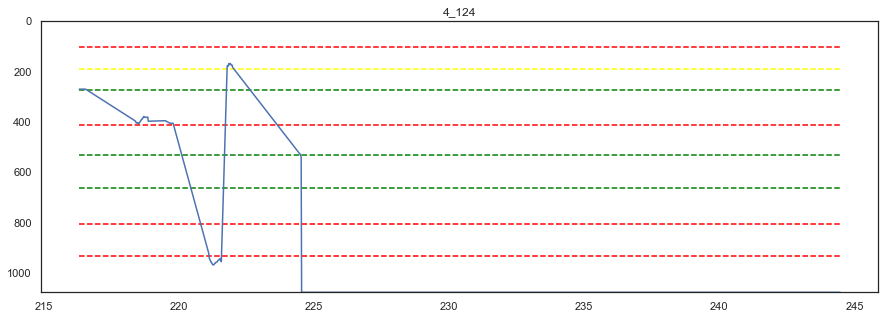

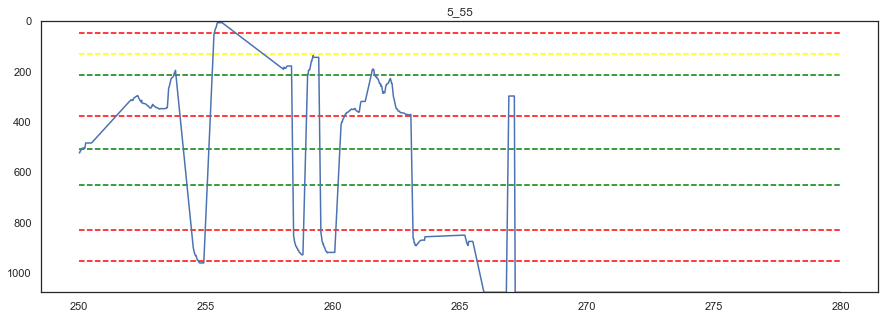

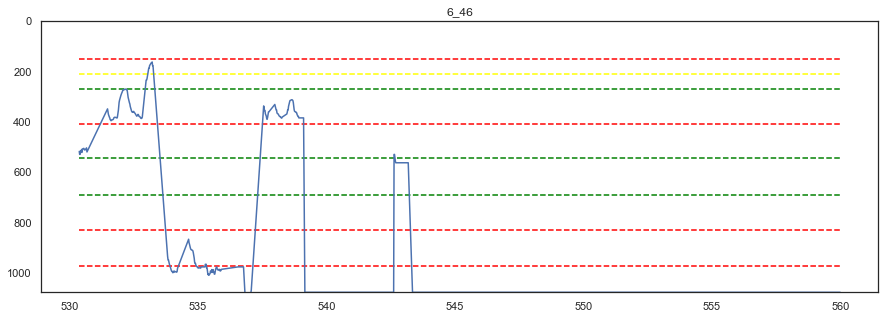

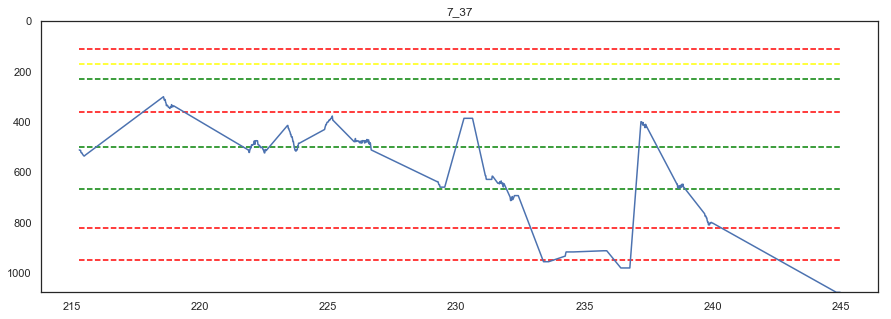

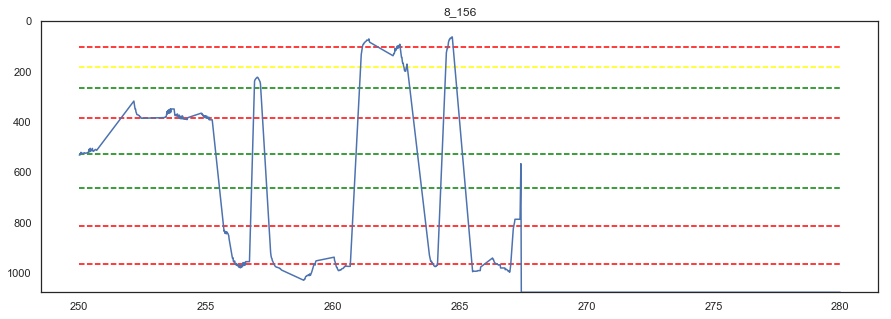

...

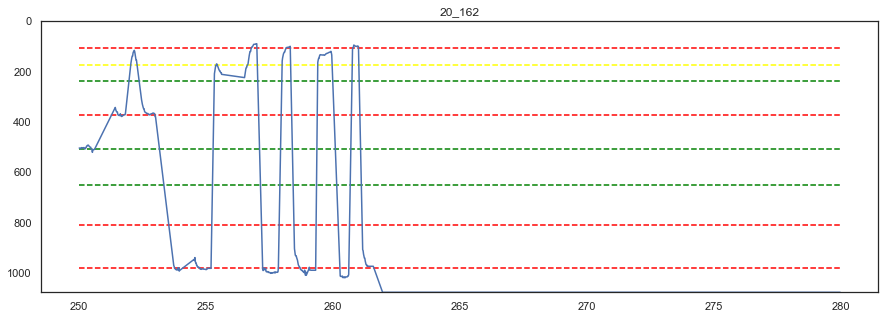

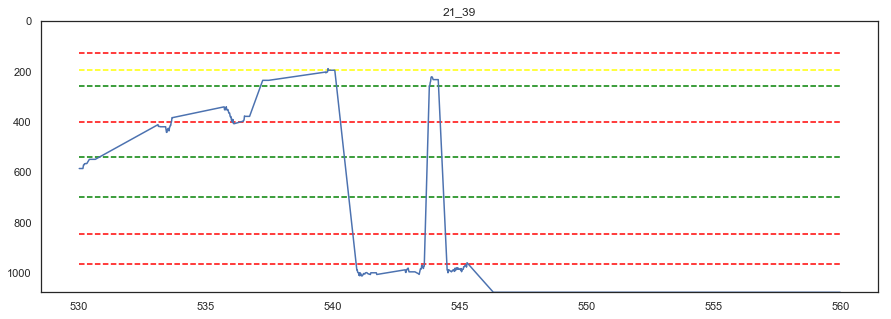

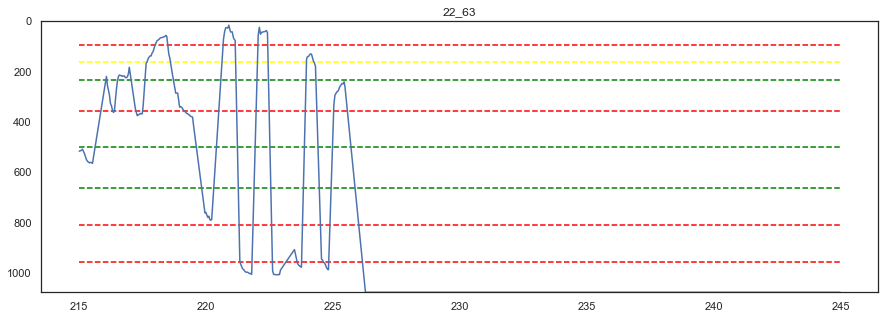

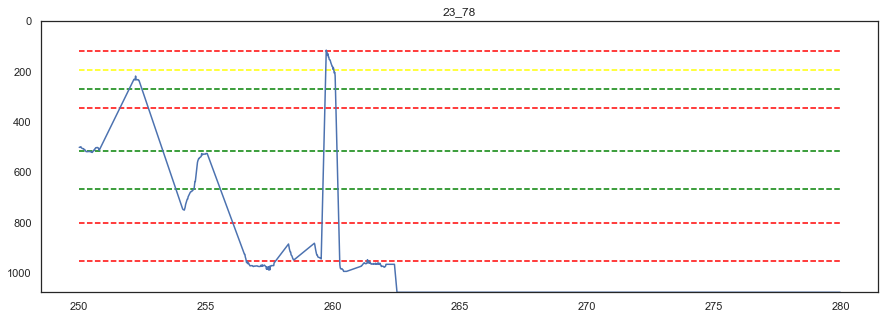

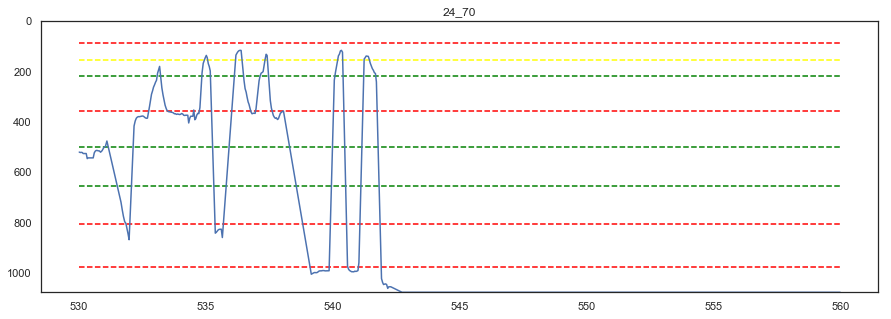

In [633]:
##あとから
for i in  range(4,25):
    df = gl["df_14"]
    check_y_plot_revise(df[i-1],i,fix_time=0.2)

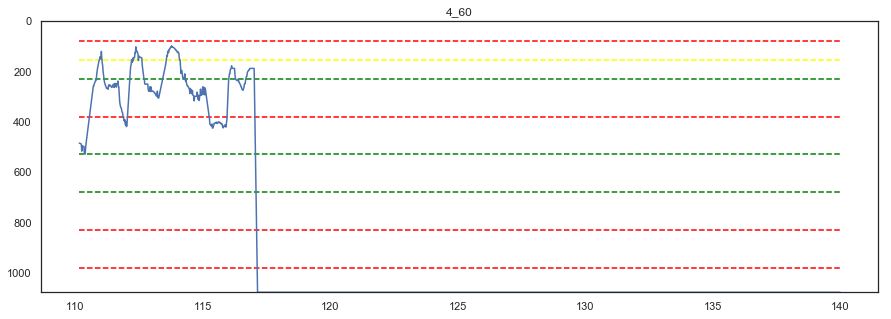

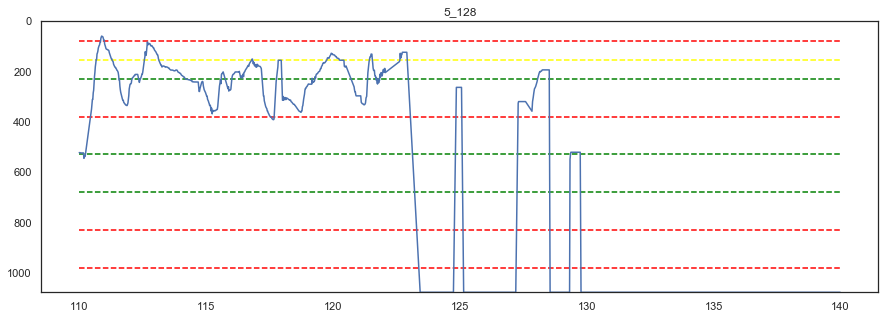

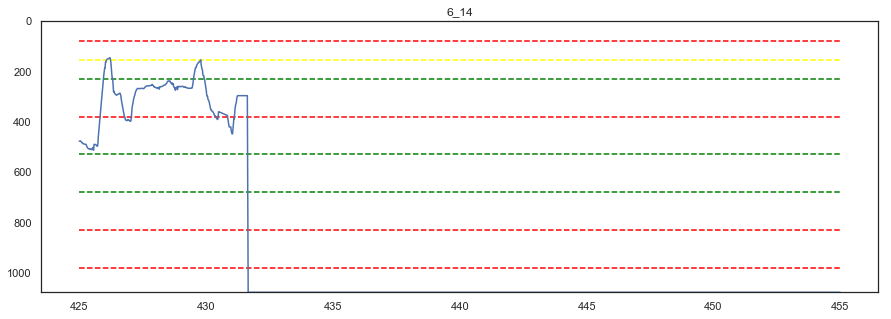

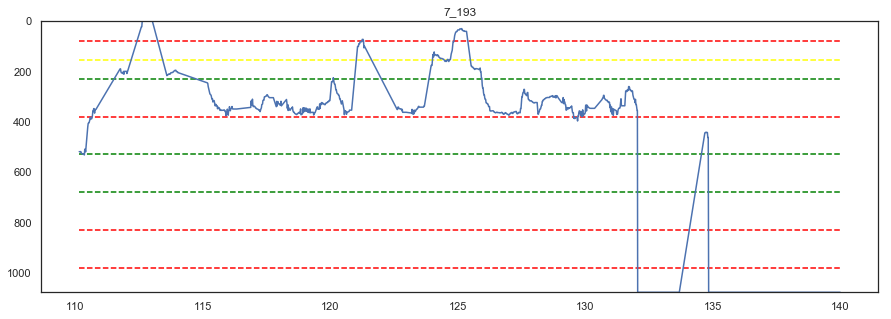

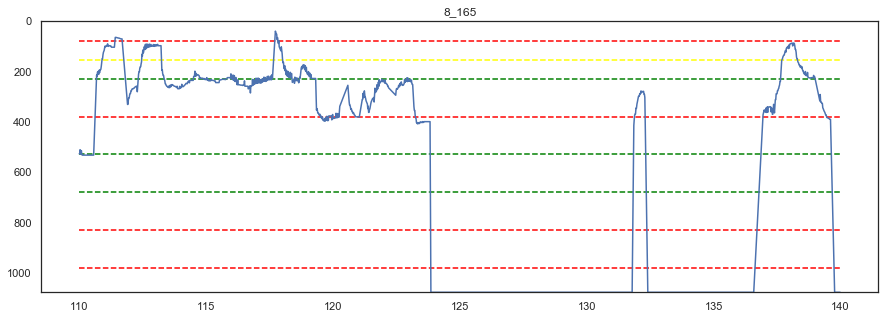

...

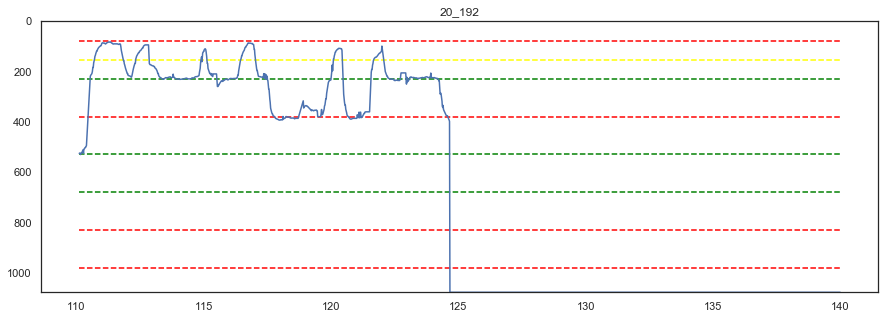

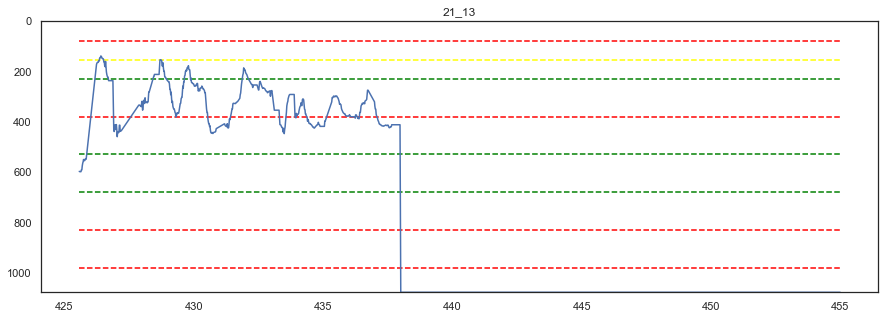

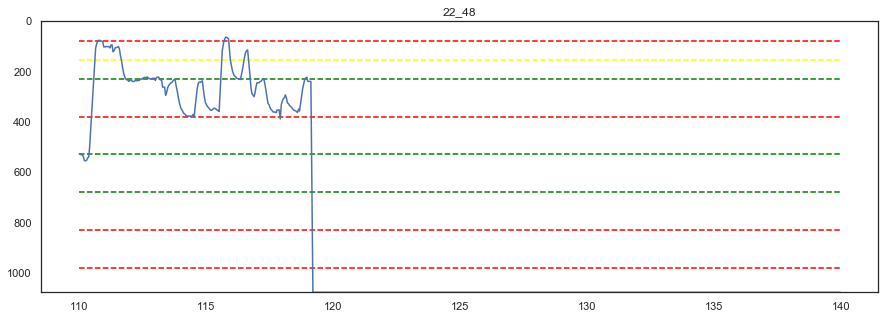

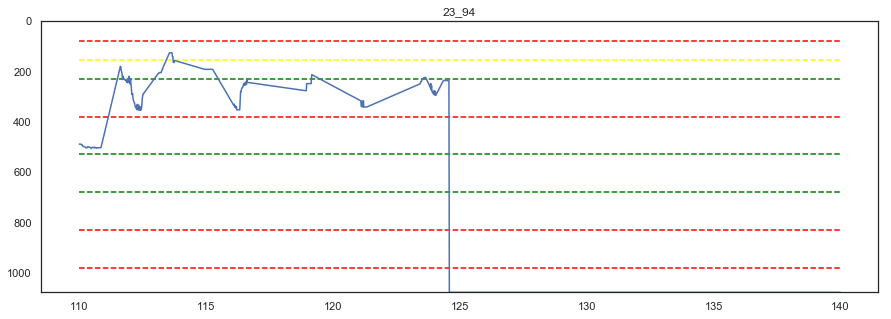

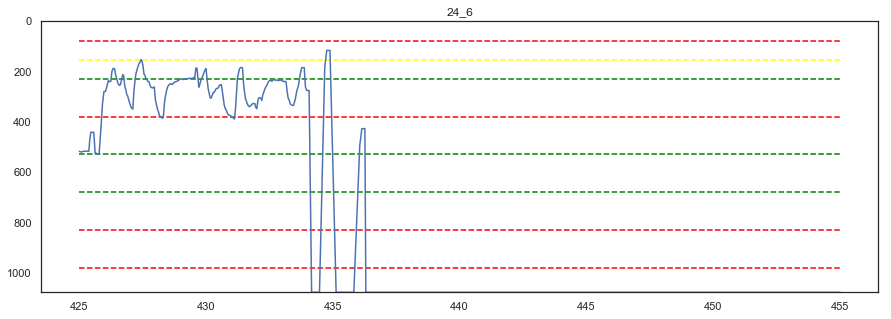

In [580]:
##あとから
for i in  range(4,25):
    df = gl["df_1"]
    check_y_plot(df[i-1],i)

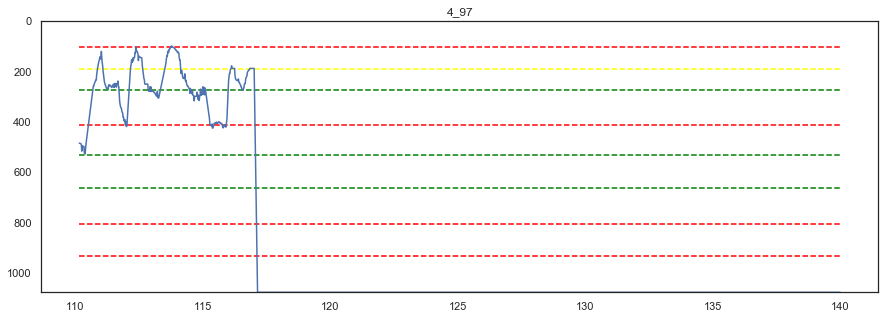

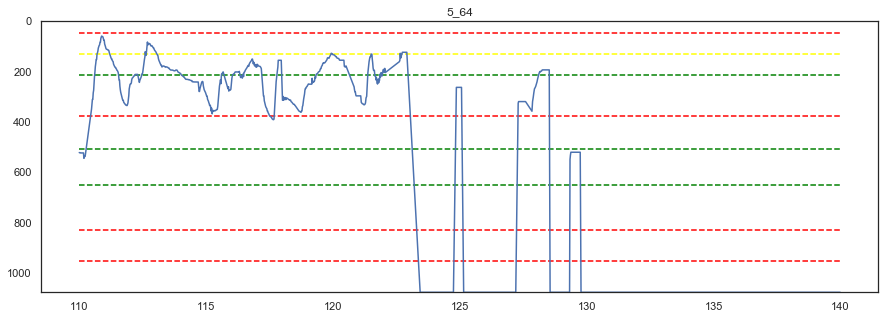

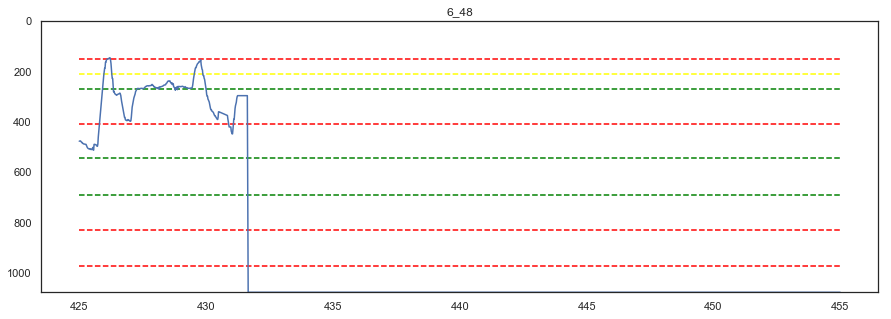

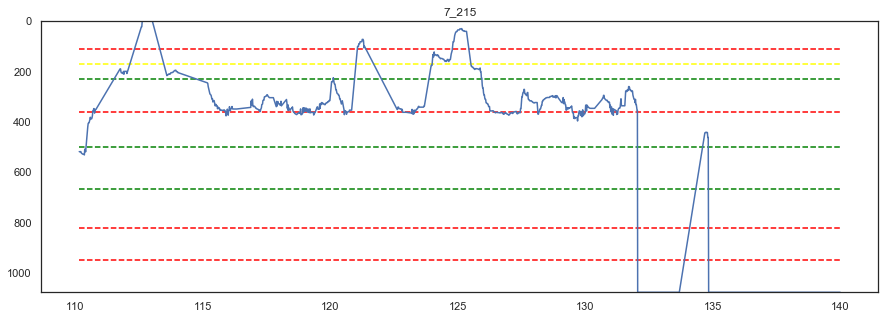

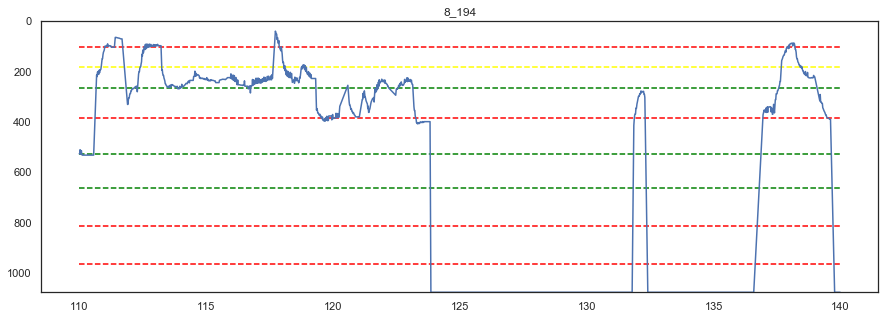

...

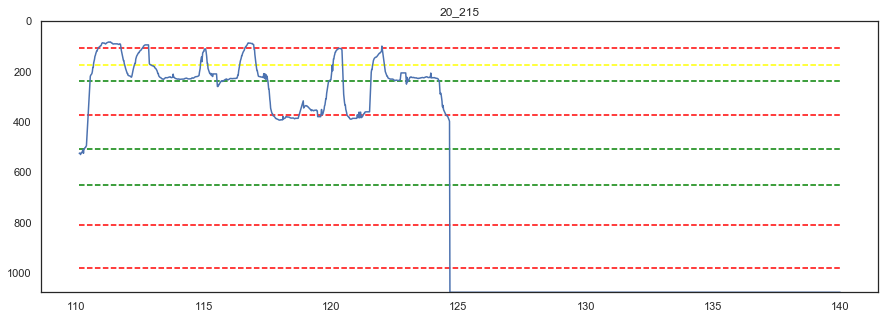

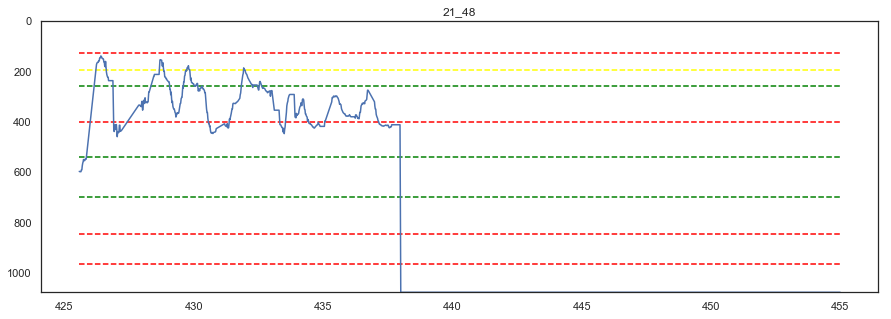

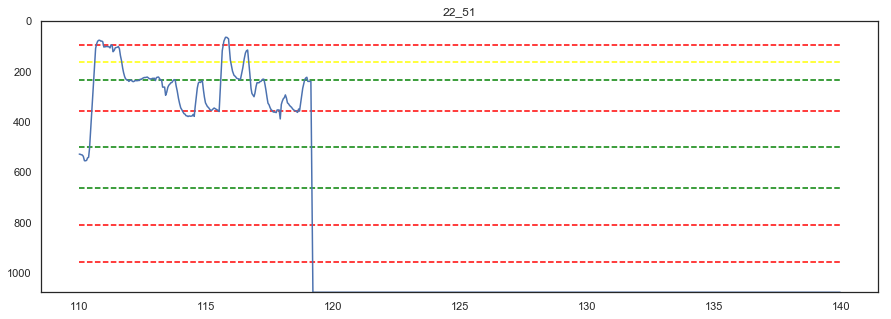

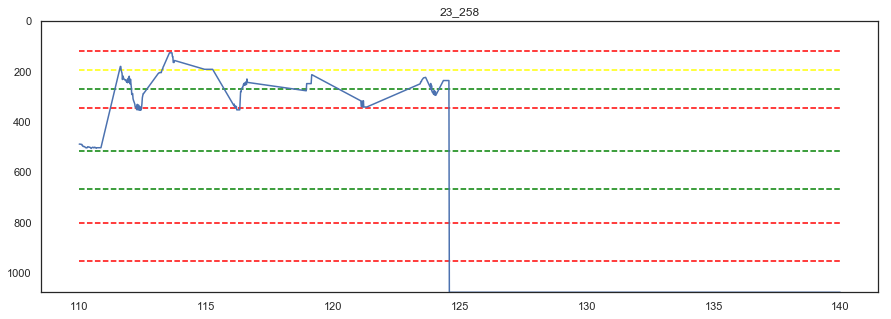

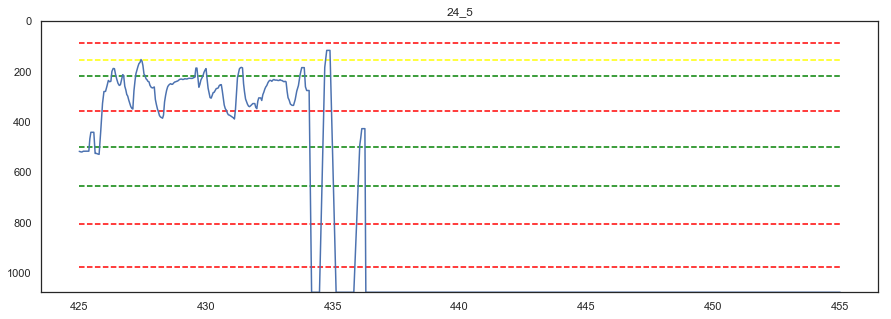

In [577]:
##あとから
for i in  range(4,25):
    df = gl["df_1"]
    check_y_plot_revise(df[i-1],i)

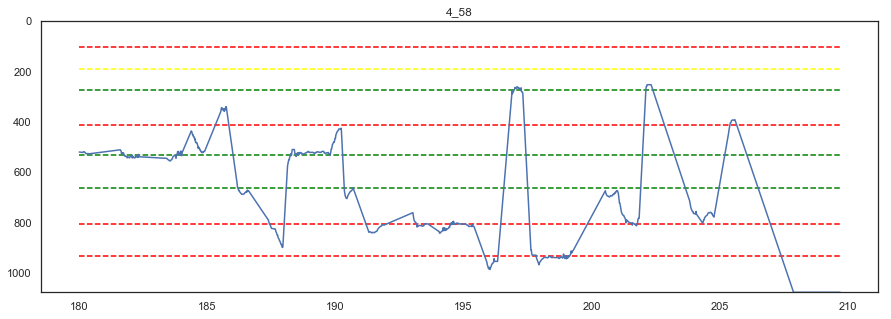

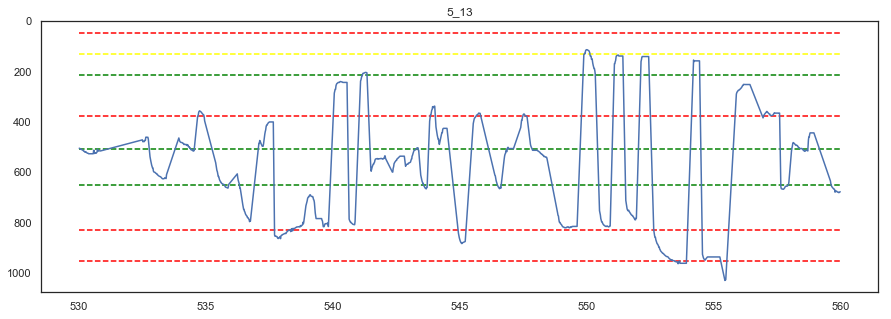

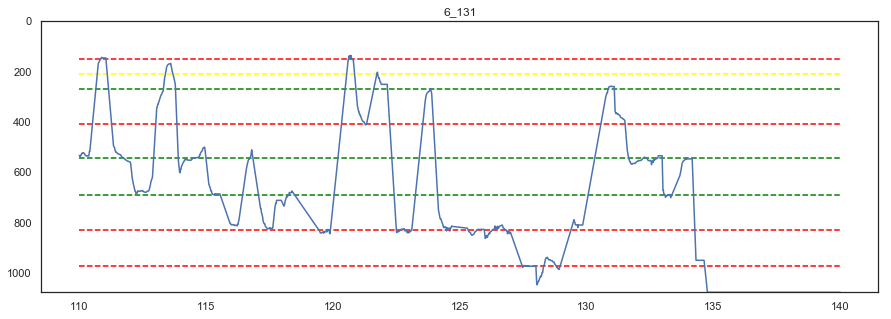

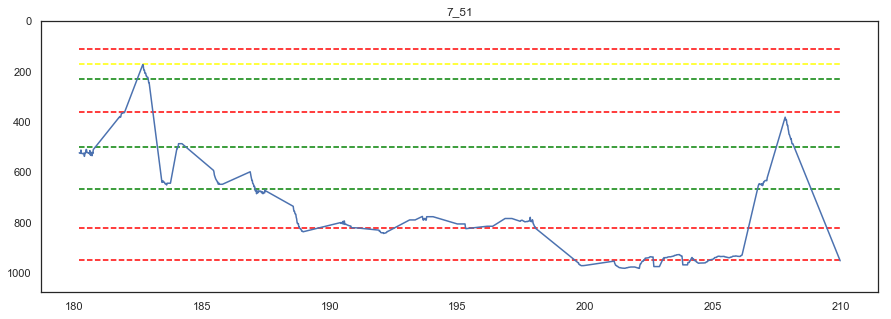

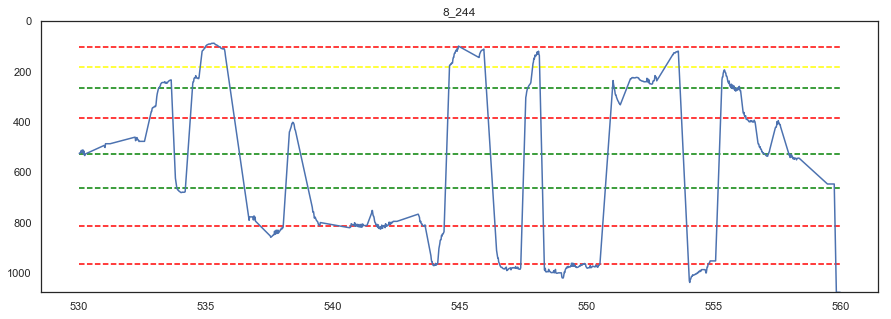

...

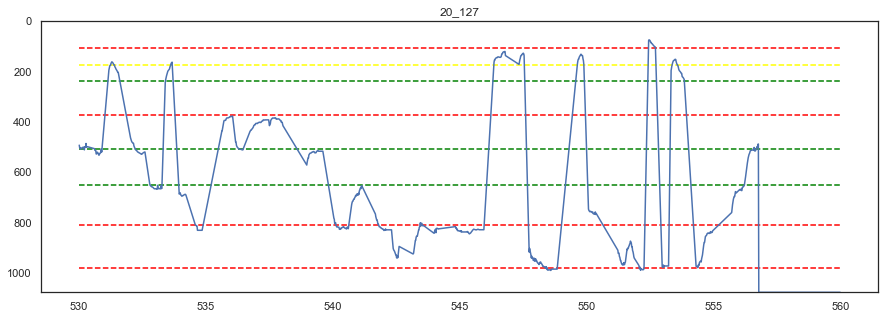

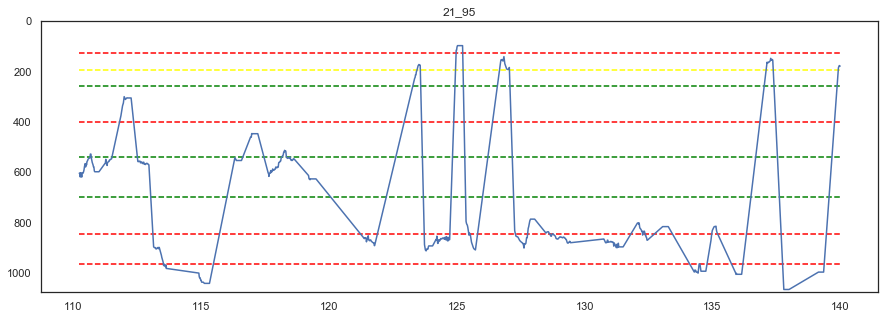

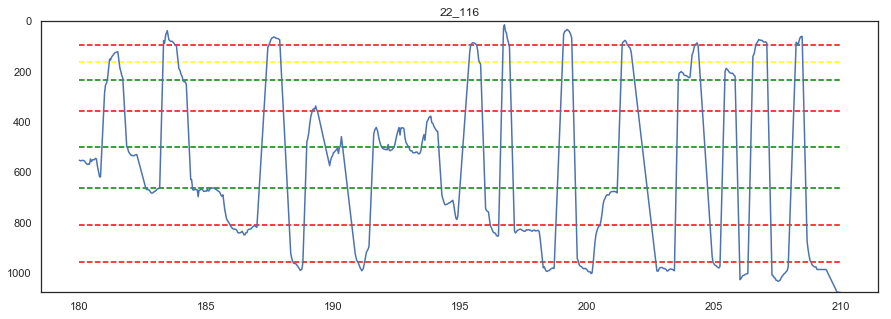

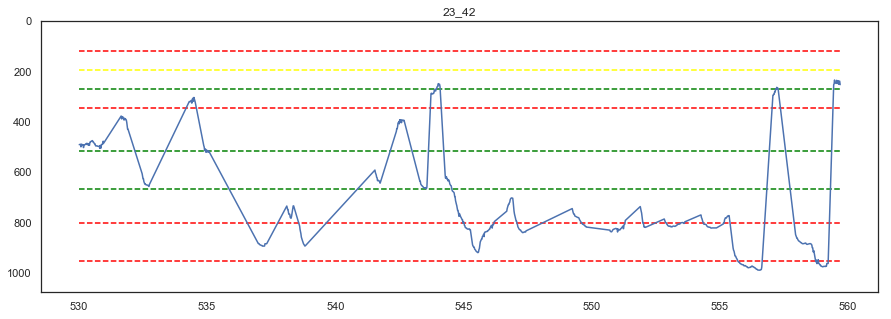

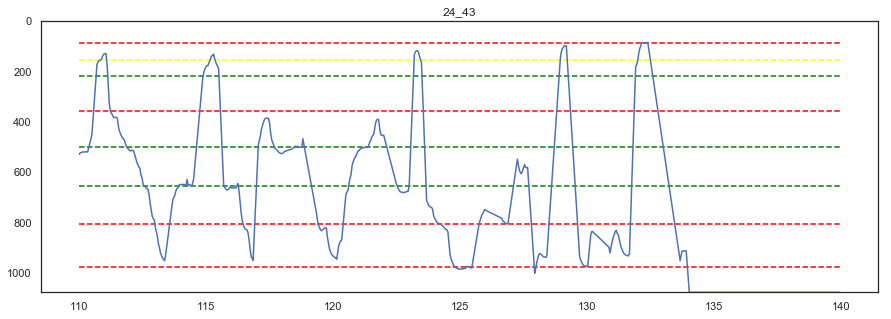

In [609]:
for i in  range(4,25):
    df = gl["df_10"]
    check_y_plot_revise(df[i-1],i)

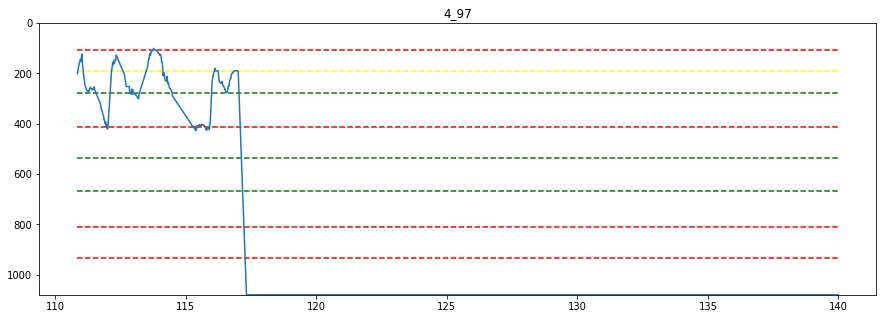

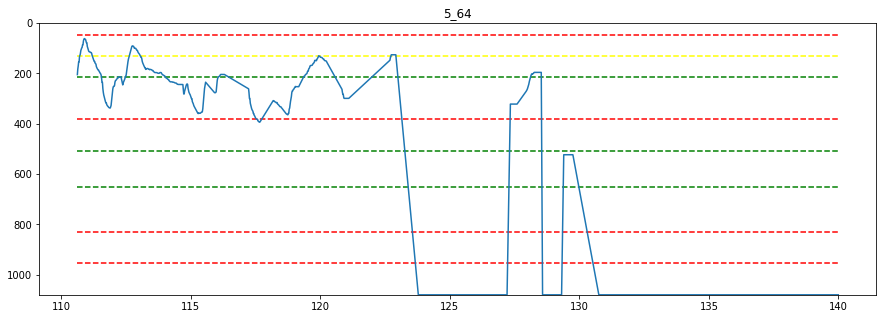

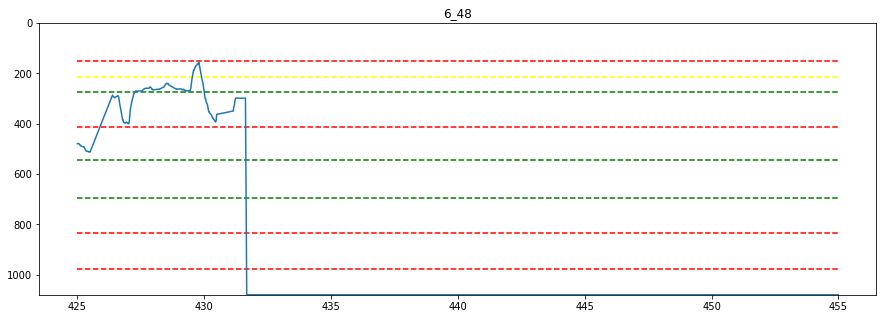

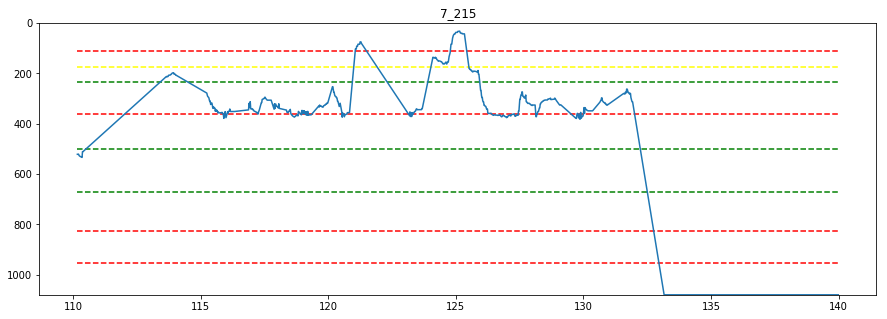

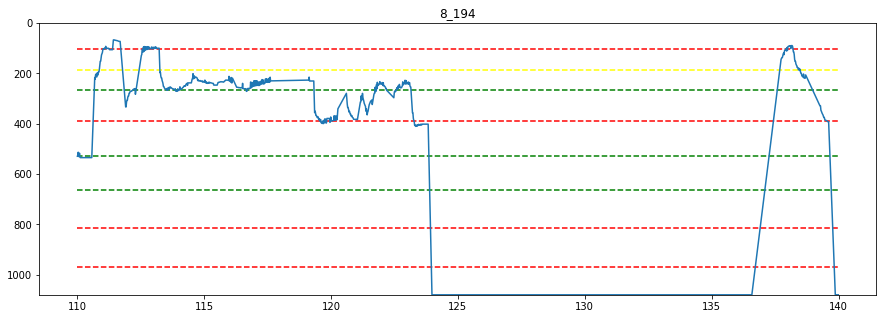

...

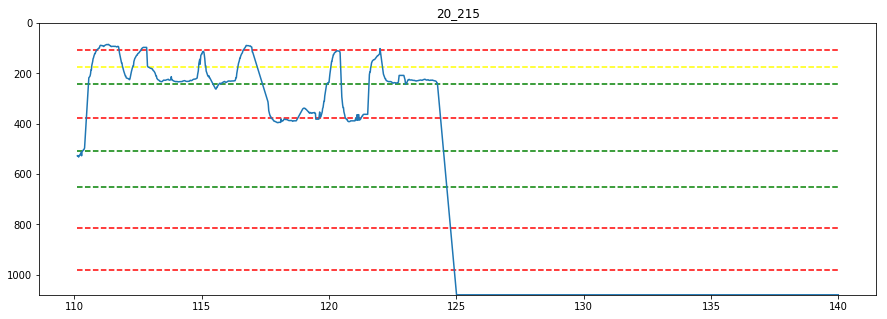

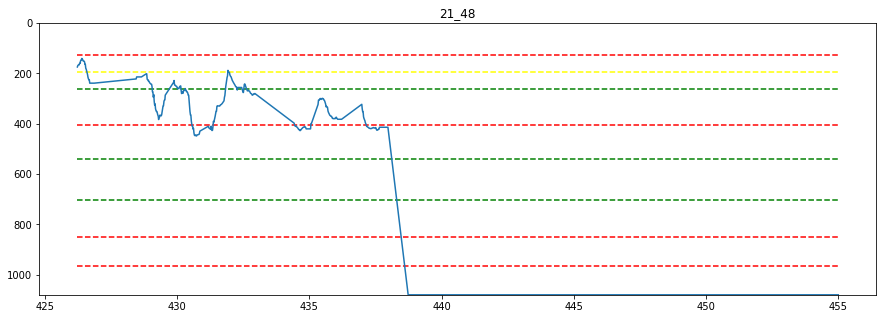

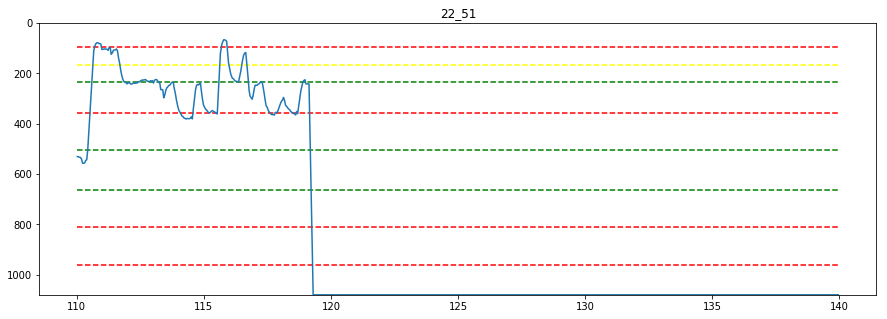

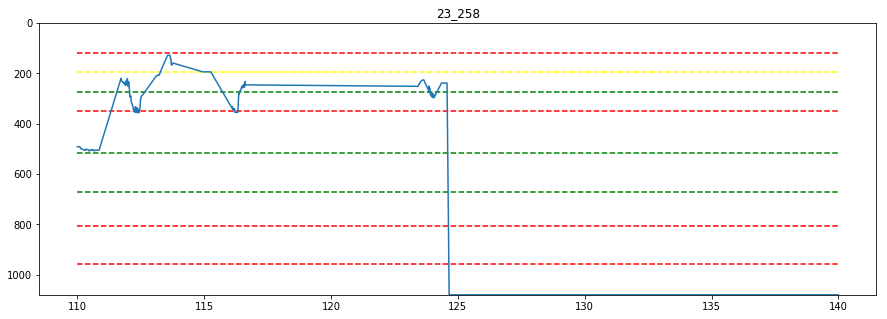

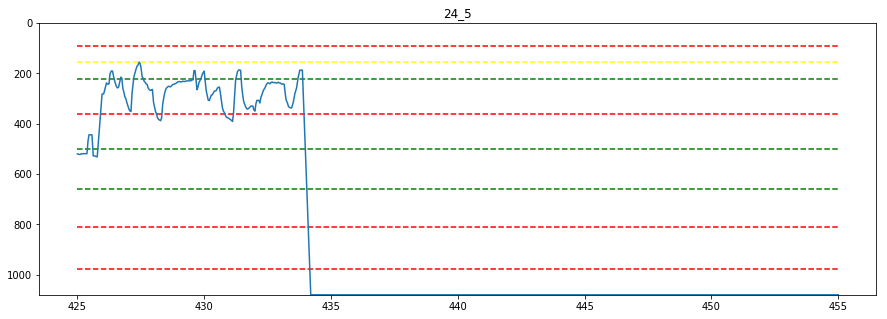

In [415]:
for i in  range(4,25):
    df = gl["df_1"]
    check_y_plot_revise(df[i-1],i)

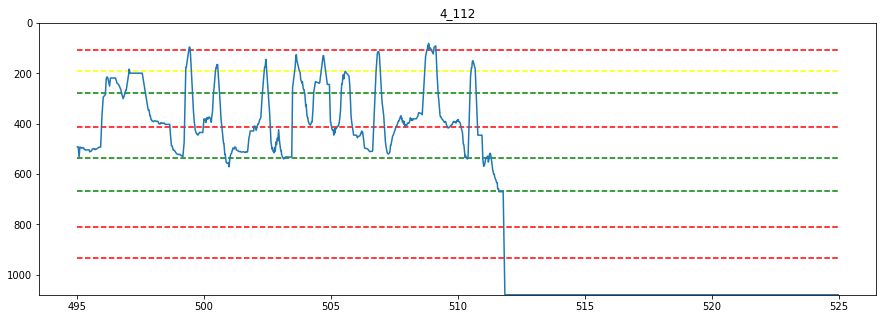

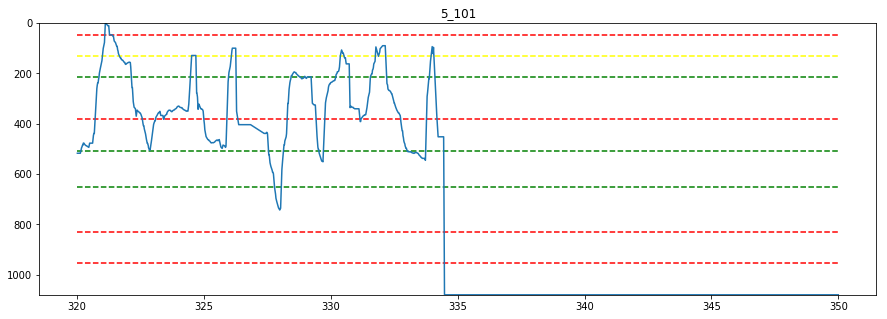

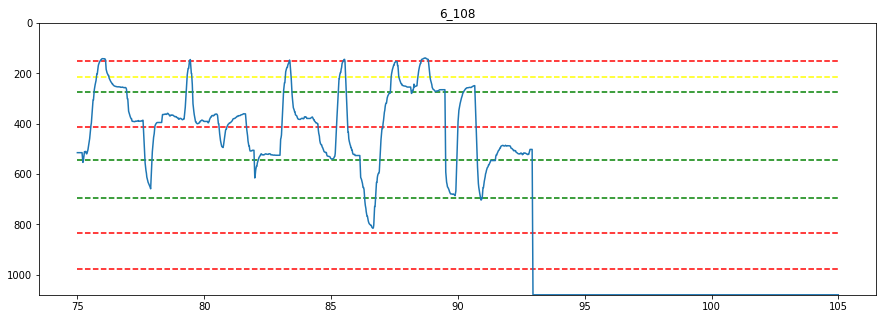

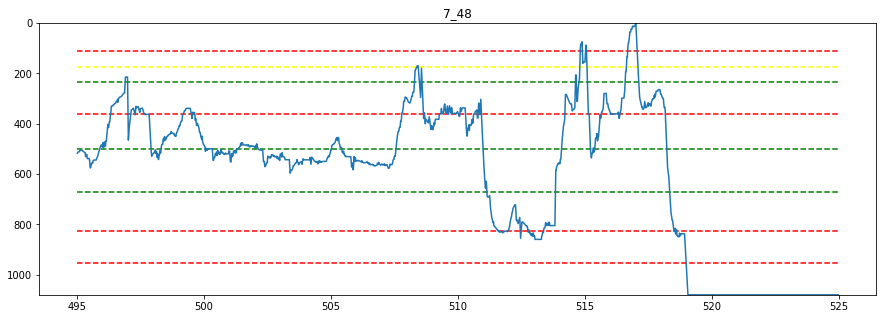

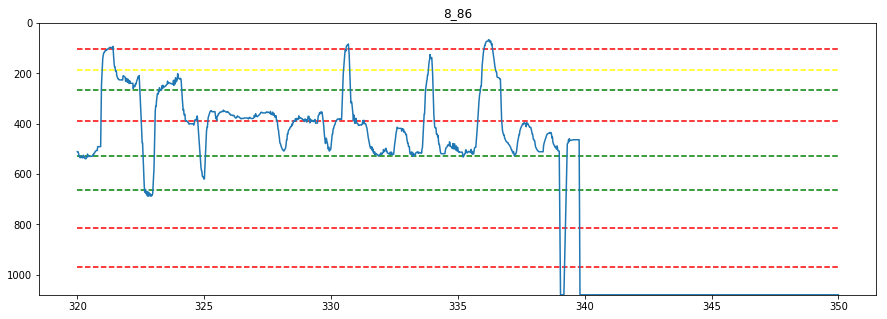

...

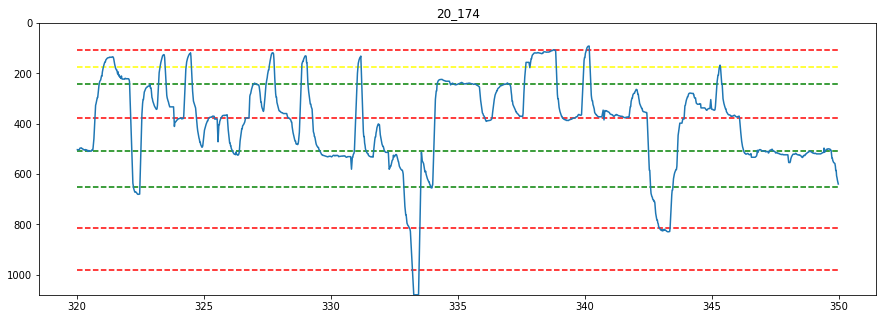

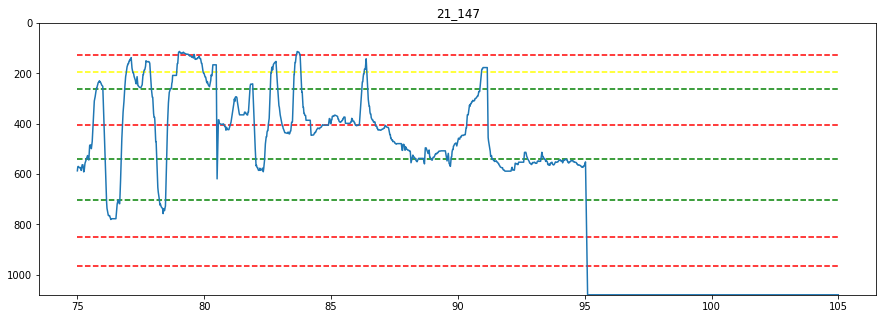

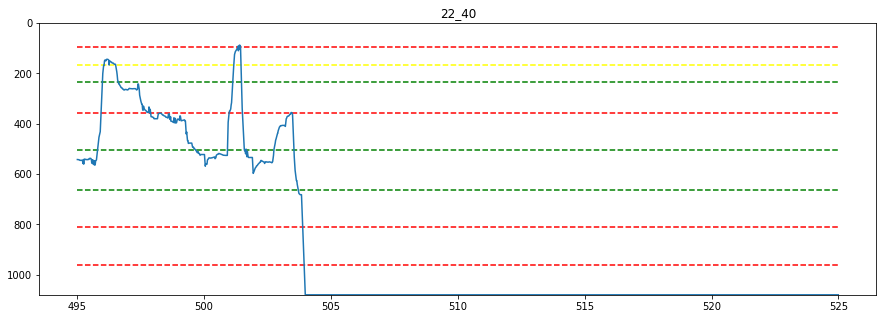

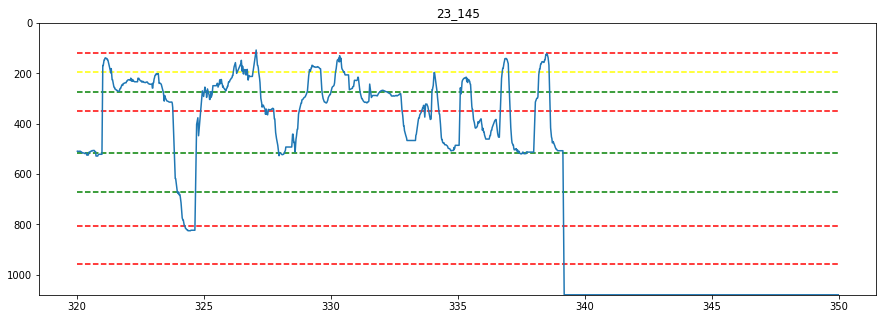

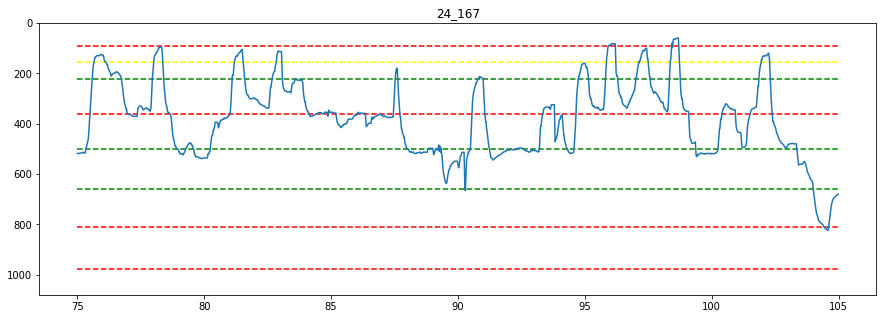

In [153]:
for i in  range(4,25):
    df = gl["df_3"]
    check_y_plot_revise(df[i-1],i)

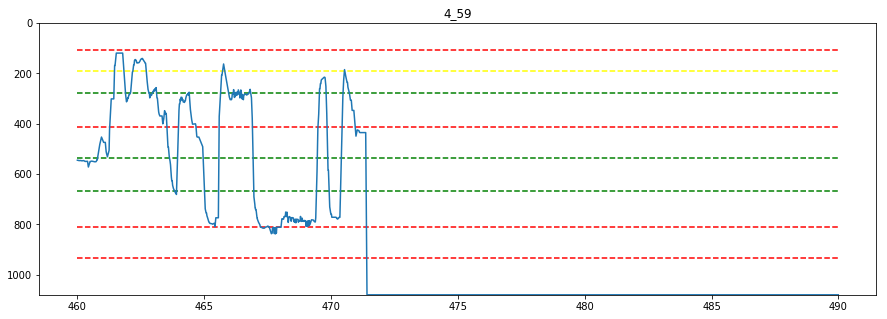

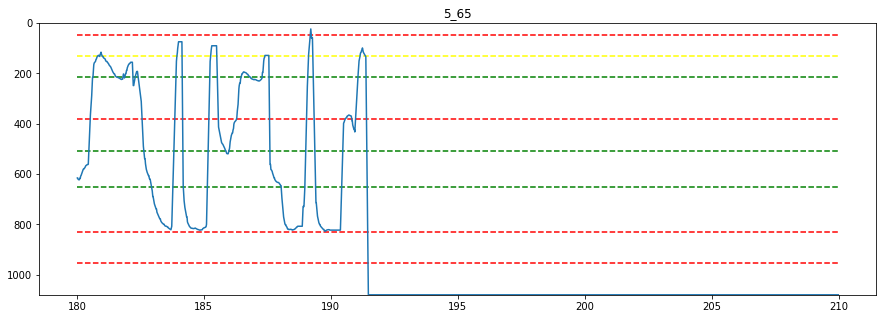

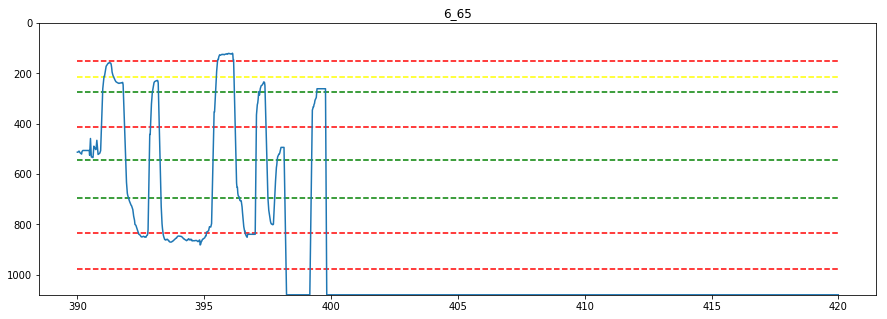

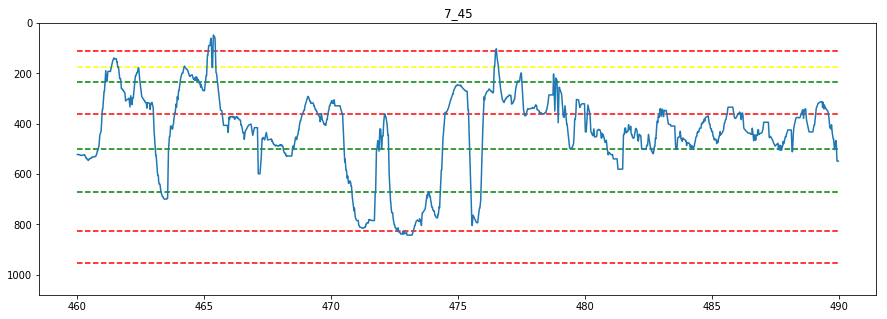

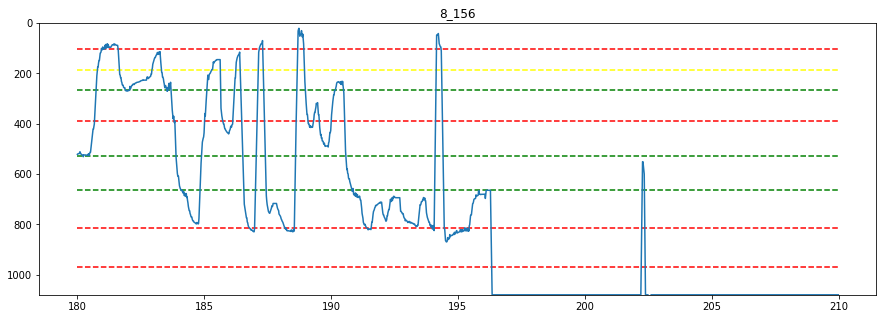

...

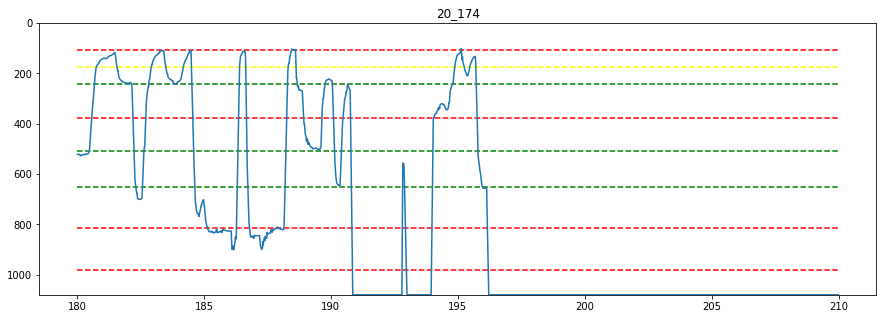

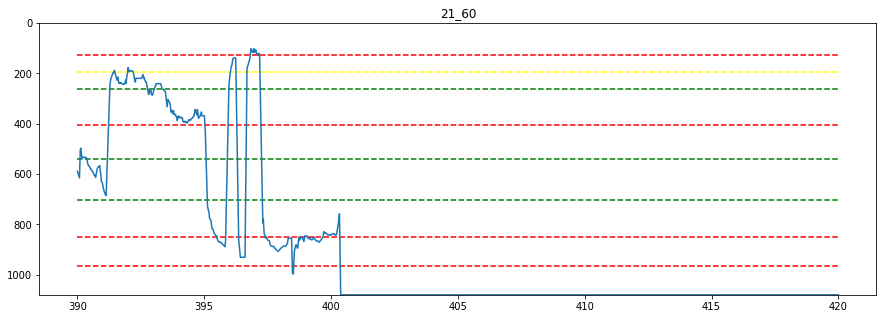

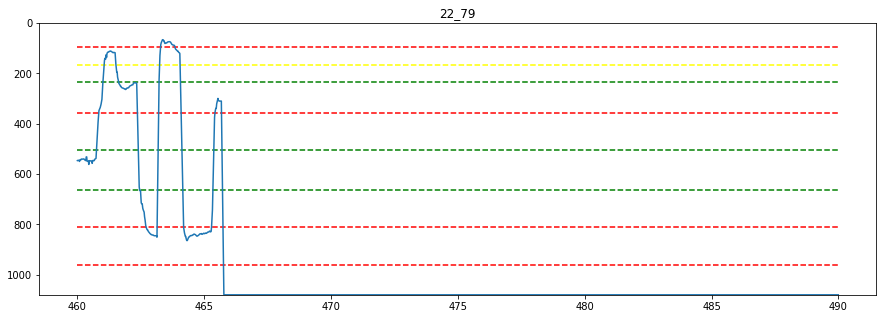

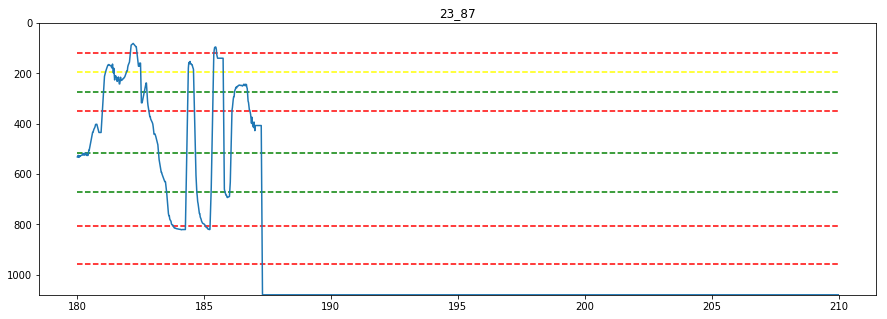

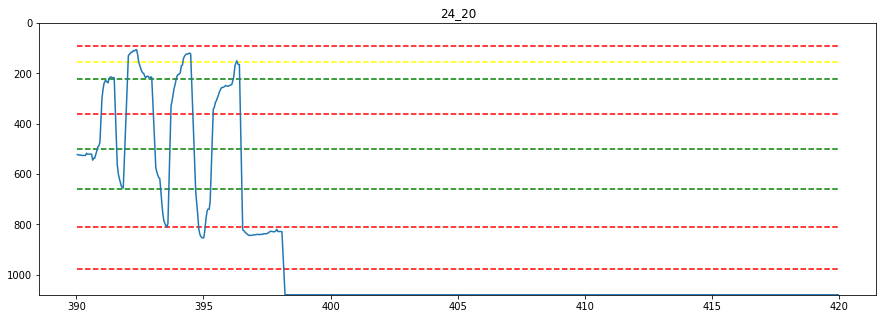

In [154]:
for i in  range(4,25):
    df = gl["df_4"]
    check_y_plot_revise(df[i-1],i)

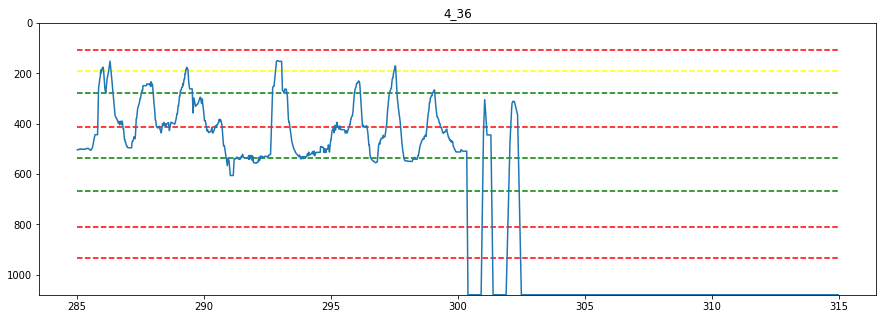

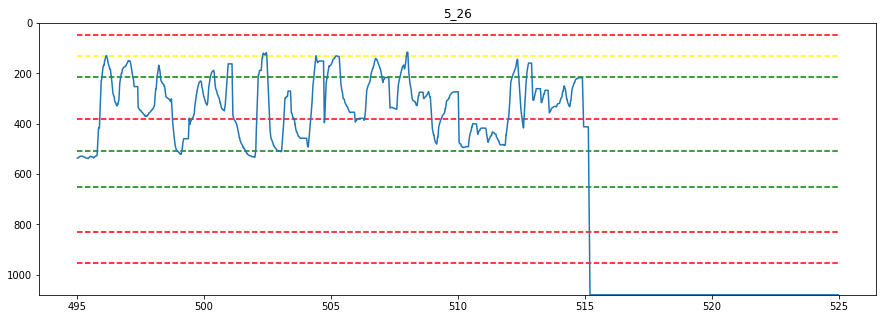

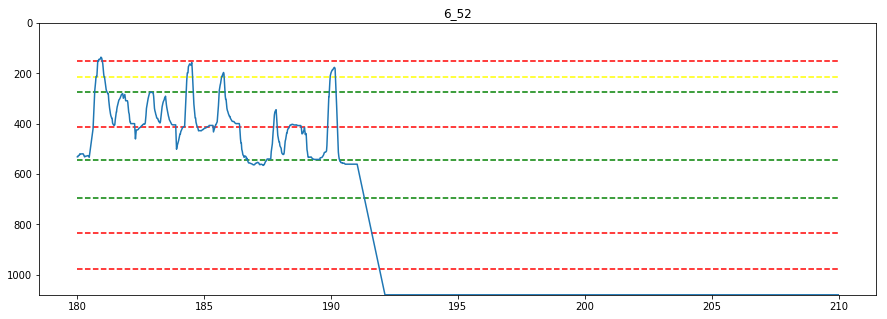

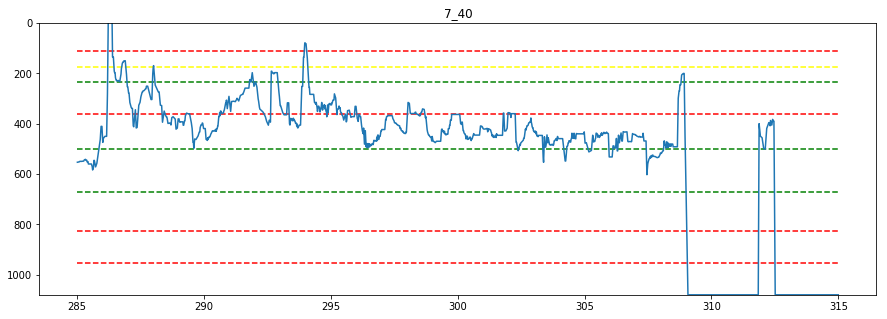

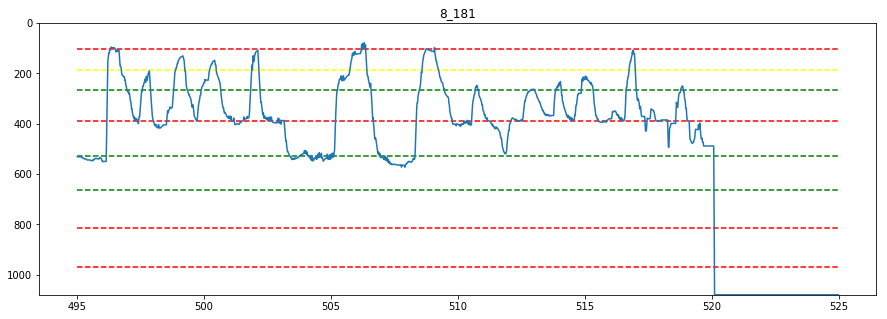

...

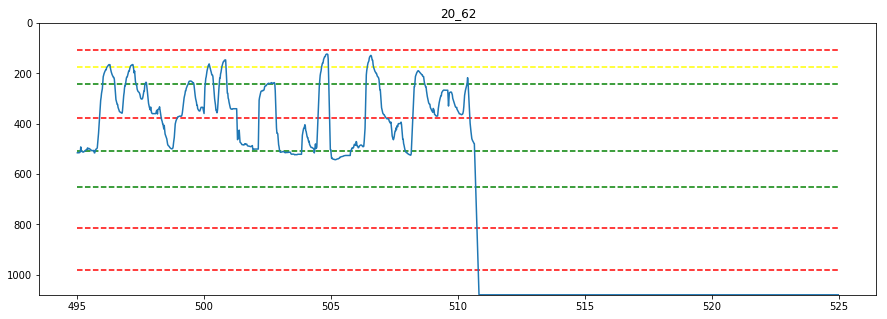

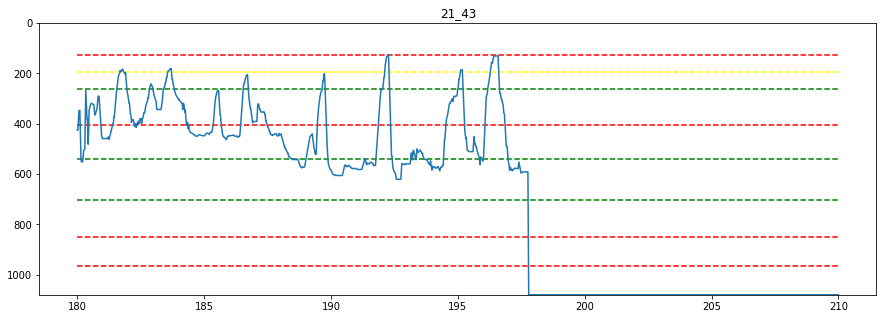

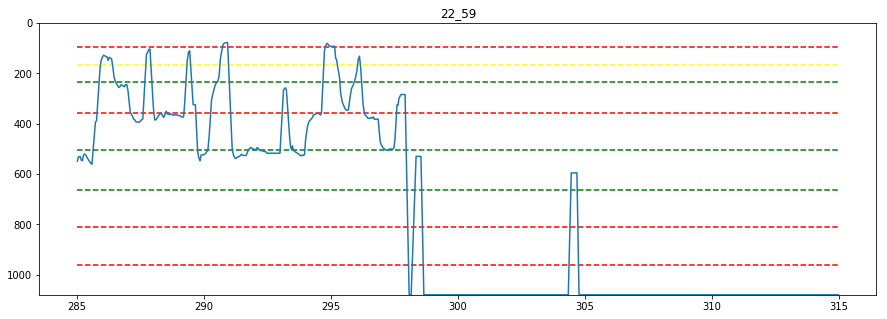

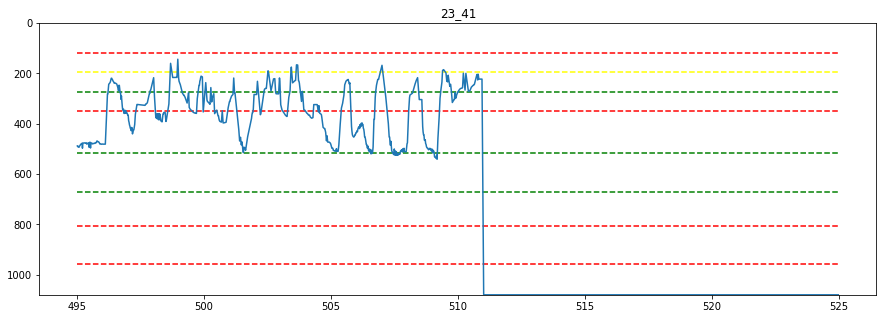

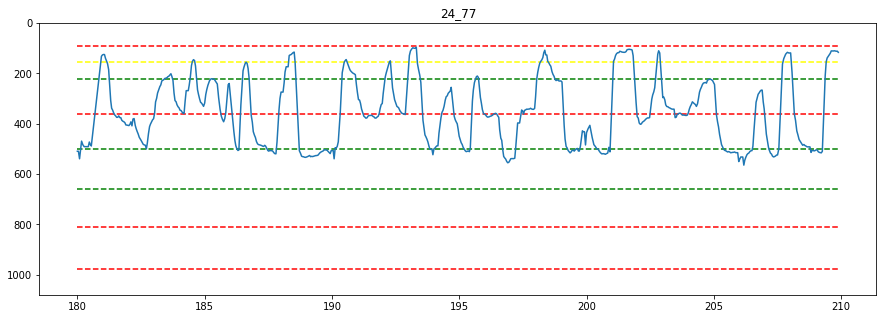

In [156]:
for i in  range(4,25):
    df = gl["df_5"]
    check_y_plot_revise(df[i-1],i)

In [16]:
import warnings
warnings.filterwarnings('ignore')

In [544]:
for i in range(1,25):
    n = "e"+str(i)
    m = "e"+str(i)+"_check_all"
    da = gl[n]
    da = da[da["time"]<35]
    gl[m]=da

In [17]:
distance = np.tan(np.deg2rad(2.5))*70
pixel_cm = ((29.7/1080)+(47.2/1920))/2
v_ = distance/pixel_cm*2
v_

234.7212290761608

In [18]:
distance = np.tan(np.deg2rad(10))*75
pixel_cm = ((29.7/1080)+(47.2/1920))/2
v = distance/pixel_cm*2
v

1015.6434088807582

In [120]:
def saccade(df,fix_time=0.2):    
    abb = np.array([0])
    df["velo"]=0
    df = df.reset_index(drop=True)
    for i , j in df.iterrows():
#         print(i)
#         if i !=0:
#             a1 = np.array([j["x"],j["y"]])
#             a2 = np.array([df.iloc[i-1]["x"],df.iloc[i-1]["y"]])
#             dist = np.linalg.norm(a1-a2)
#             tt1 = j["time"]
#             tt2 = df.iloc[i-1]["time"]
#             tt3 = tt1-tt2
#             abb = np.append(abb,dist/tt3)
        if i !=0:
            a1 = np.array(j["y"])
            a2 = np.array(df.iloc[i-1]["y"])
            dist = np.abs(a1-a2)
            tt1 = j["time"]
            tt2 = df.iloc[i-1]["time"]
            tt3 = tt1-tt2
            abb = np.append(abb,dist/tt3)
#     print(len(df),len(abb))
    df["velo"]=abb
    df["slow"]=True
    df.loc[df["velo"]>v,"slow"]=False
#      状態用 0なら注視中、１ならサッケード中
    if fix_time !=0:
        c=0
        t = df["time"].iloc[0]
        k = 0  #index
        for i , j in df.iterrows():
            if i!=0:
                if c == 0:
                    if (not j["slow"])&(df.iloc[i-1]["slow"]):
                        c = 1
                        if (df.iloc[i-1]["time"]-t)<fix_time:
                            df["slow"].iloc[k:i]=False
                else:
                    if ( j["slow"])&(not df.iloc[i-1]["slow"]):
                        c = 0
                        t = j["time"]
                        k = i
    df=df[df["slow"]==True]
    return df

In [412]:
b = df_1[6]
# for i , j in b.iterrows():
#         print("A")
b = saccade(b)
b=b[b["time"]>114]
b[b["time"]<115]
# b[b["slow"]=="TT"]


,time,x,y,velo,r_AOI,slow
239,114.004555,451.0135,203.76560,441.406154,2,True
240,114.021725,445.2862,207.58950,401.076369,2,True
241,114.037829,445.2862,207.58950,0.000000,2,True
242,114.055229,300.3526,131.20040,9415.653018,1,False
243,114.071235,389.4598,220.56960,7884.915104,2,False
244,114.088619,389.4598,220.56960,0.000000,2,TT
245,114.104697,355.5528,224.37320,2122.107703,2,False
246,114.121786,355.5528,224.37320,0.000000,2,TT
247,114.138329,256.6790,134.42130,8079.892393,1,False
248,114.155128,327.9161,229.20230,7058.070923,2,False


In [410]:
def titleduke(df):    
    for (symbol, value) in globals().items():
        if id(value) == id(df):
            return symbol

In [26]:
titleduke(e10_check1)

'e10_check1'

In [38]:
lines = [3,4,6,6,4,5,5,5,5,7,5,5,5,7,7]



課題１　　1,7：再定義(3行目無視)

課題２　　1：if文わからず　, 3,7：再定義(4行目無視)

課題３　　3：ifwhile勘違い　6,15：4行目+-ミス　10,11：実行部ミス　1,7：不明

課題4　　 7：不明

課題5　　 ３,6：4行目でa,bの代入逆、４：3行目で代入違い、17：4行目で代入違い(3行目無視)、1,7：不明

課題6　　 3：ifwhile勘違い、4：4,5代入ミス、11：4代入ミス、14：4,5代入ミス&答え逆　　、1,7：不明

課題7　　 11,12：4-なし5a,b逆、７：再定義なし(5無視)、20,21：代入ミス、1,6：不明

課題8　　 9,15,21：4行目結果無視、1,3,7：不明

課題9　　 ３：ifwhile間違い、6,8,11,14：4代入ミス、15：b答え忘れ、1,7：不明

課題10     　３：ifwhile間違い、9,21：時間切れ、10,12：c,d答え忘れ、22：6+-ミス、1,7,15：不明

課題11  　4,21：5無視、11,15：4代入ミス、6：5代入ミス、2：時間切れ、1,7,20：不明

課題12　 　 4,15：５行目無視、1,7,20：不明

課題13　 　11：if以外定義されない、20：時間切れ、1,7,12：不明

課題14    　1,7：不明

課題15    　　2,4,15：5代入ミス、1,7：不明

In [750]:
df_1_maru = [2,1,1,1,1,1,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]
df_2_maru = [8,1,1,2,1,1,2,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]
df_3_maru = [8,1,5,1,1,3,8,1,1,4,4,1,1,1,3,1,1,1,1,1,1,1,1,1]
df_4_maru = [1,1,1,1,1,1,8,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]
df_5_maru = [8,1,3,0,1,3,8,1,1,1,1,1,1,1,1,1,1,7,1,1,1,1,1,1]
df_6_maru = [8,1,5,10,1,1,8,1,1,1,0,1,1,10,1,1,1,1,1,1,1,1,1,1]
df_7_maru = [8,1,1,1,1,1,2,1,1,1,10,10,1,1,1,10,1,1,1,0,0,1,1,1]
df_8_maru = [8,1,5,1,1,1,8,1,7,1,1,1,1,1,7,1,1,1,1,1,7,1,1,1]
df_9_maru = [8,1,5,1,1,0,8,0,1,1,0,1,1,0,9,1,1,1,1,1,1,1,1,1]
df_9_maru_74=[0,0,0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0]
df_10_maru=[8,1,5,1,1,9,8,1,6,9,1,9,1,1,8,1,1,1,1,1,6,3,1,1] #10,12番目c,d答え忘れ
df_11_maru=[8,6,1,11,1,0,8,1,1,1,0,1,1,1,0,1,1,1,1,8,10,1,1,1]
df_12_maru=[8,1,1,11,1,1,8,1,1,1,1,1,1,1,8,1,1,1,1,6,1,1,1,1]
df_13_maru=[8,1,1,1,1,1,8,1,1,1,8,10,1,1,1,1,1,1,1,8,1,1,1,1]
df_14_maru=[8,1,1,1,1,1,8,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]
df_15_maru=[8,0,1,0,1,1,8,1,1,1,1,1,1,1,0,1,1,1,1,1,1,1,1,1] 

AOI_1_x = [[2+200,156+200],[2+200,348+200],[2+200,294+200]]
AOI_2_x = [[2+200,156+200],[2+200,307+200],[131+200,412+200],[131+200,412+200]]
AOI_3_x = [[2+200,156+200],[2+200,307+200],[131+200,412+200],[131+200,476+200],[2+200,179+200],[131+200,412+200]]
AOI_4_x = [[2+200,156+200],[2+200,307+200],[131+200,412+200],[131+200,412+200],[2+200,179+200],[131+200,412+200]]
AOI_5_x = [[2+200,156+200],[2+200,156+200],[2+200,294+200],[2+200,348+200]]
AOI_6_x = [[2+200,156+200],[2+200,156+200],[2+200,307+200],[131+200,476+200],[131+200,412+200]]
AOI_7_x = [[2+200,156+200],[2+200,156+200],[2+200,307+200],[131+200,476+200],[131+200,476+200]]
AOI_8_x = [[2+200,156+200],[2+200,156+200],[2+200,435+200],[131+200,412+200],[131+200,412+200]]
AOI_9_x = [[2+200,156+200],[2+200,156+200],[2+200,435+200],[131+200,412+200],[131+200,412+200]]
AOI_10_x = [[2+200,156+200],[2+200,156+200],[2+200,156+200],[2+200,294+200],[2+200,435+200],[131+200,476+200],[131+200,412+200]]
AOI_11_x = [[2+200,156+200],[2+200,156+200],[2+200,435+200],[131+200,412+200],[2+200,294+200]]
AOI_12_x = [[2+200,156+200],[2+200,156+200],[2+200,435+200],[131+200,412+200],[2+200,348+200]]
AOI_13_x = [[2+200,156+200],[2+200,156+200],[2+200,435+200],[131+200,412+200],[131+200,412+200]]
AOI_14_x = [[2+200,156+200],[2+200,156+200],[2+200,435+200],[131+200,412+200],[131+200,412+200],[2+200,179+200],[131+200,476+200]]
AOI_15_x = [[2+200,156+200],[2+200,156+200],[2+200,435+200],[131+200,412+200],[131+200,412+200],[2+200,179+200],[131+200,476+200]]

e1_time=[8,21,26,8,23,20,30,20,30,18,19,16,6,26,13]
e2_time=[10,13,11,6,13,15,18,9,14,19,30,9,13,15,11]
e3_time=[8,12,30,5,19,30,15,30,30,30,22,9,8,10,14]
e4_time=[6,10,16,11,15,11,12,19,12,24,5,18,6,9,9]
e5_time=[6,9,6,5,9,17,8,8,9,24,14,9,19,9,9]
e6_time=[7,7,11,7,10,12,11,7,17,20,17,6,11,8,12]
e7_time=[5,22,15,30,21,30,17,30,17,25,7,30,13,25,14]
e8_time=[11,22,16,14,23,22,18,12,13,28,23,12,4,15,12]
e9_time=[6,10,20,7,8,13,12,10,14,30,19,9,9,9,12]
e10_time=[16,17,5,6,11,9,15,19,19,25,17,7,8,11,10]
e11_time=[8,9,4,10,13,10,14,12,7,20,17,9,12,14,12]
e12_time=[11,9,17,9,11,14,16,13,16,20,25,9,8,12,12]
e13_time=[8,12,8,5,12,11,12,16,14,26,16,14,9,11,12]
e14_time=[9,10,18,7,12,12,19,9,11,10,20,9,3,13,9]
e15_time=[11,18,16,7,15,23,13,17,16,25,15,8,16,10,14]
e16_time=[14,9,15,12,13,16,13,13,19,24,22,11,9,11,16]
e17_time=[10,13,14,5,11,14,13,8,9,15,16,6,9,14,9]
e18_time=[16,10,20,9,16,21,15,14,20,27,21,15,11,13,18]
e19_time=[9,16,12,6,11,8,9,18,14,20,14,8,10,11,10]
e20_time=[12,20,12,8,11,14,15,13,13,22,19,30,30,10,20]
e21_time=[12,11,19,9,16,15,10,19,22,30,30,15,11,14,17]
e22_time=[8,13,8,5,11,9,12,11,16,28,14,9,4,9,13]
e23_time=[13,22,18,7,14,30,17,16,17,29,28,12,5,12,19]
e24_time=[7,12,28,8,16,22,10,10,15,23,20,12,11,11,12]



In [81]:
ex = saccade(df_15[4],fix_time=0.1)

In [82]:
example = split_AOI(5,15,dx=30,df=ex)

In [1079]:
print(len(example[example["r_AOI_1"]!=0]),
      len(example[example["r_AOI_2"]!=0]),
      len(example[example["r_AOI_3"]!=0]),
      len(example[example["r_AOI_4"]!=0]),
      len(example[example["r_AOI_5"]!=0]),
      len(example[example["r_AOI_6"]!=0]),
      len(example[example["r_AOI_7"]!=0]))

45 140 136 208 179 13 0


In [1080]:
example[example["r_AOI_4"]!=0]

,time,x,y,velo,slow,r_AOI_-1,r_AOI_0,r_AOI_1,r_AOI_2,r_AOI_3,r_AOI_4,r_AOI_5,r_AOI_6,r_AOI_7
108,393.308628,417.0744,431.1454,702.269085,True,NaN,0,0.0,0.0,0.497589,0.502411,0.000000,0.0,0
109,393.324839,417.3621,441.1674,618.226008,True,NaN,0,0.0,0.0,0.499545,0.500455,0.000000,0.0,0
110,393.342095,417.7932,449.2541,468.644780,True,NaN,0,0.0,0.0,0.501123,0.498877,0.000000,0.0,0
111,393.358364,417.8878,456.1866,426.106679,True,NaN,0,0.0,0.0,0.502475,0.497525,0.000000,0.0,0
112,393.375653,417.7298,462.3900,358.797876,True,NaN,0,0.0,0.0,0.503686,0.496314,0.000000,0.0,0
113,393.392019,418.1033,467.7631,328.322732,True,NaN,0,0.0,0.0,0.000000,1.000000,0.000000,0.0,0
114,393.409071,418.4393,472.5842,282.732615,True,NaN,0,0.0,0.0,0.000000,1.000000,0.000000,0.0,0
115,393.425261,418.4393,472.5842,0.000000,True,NaN,0,0.0,0.0,0.000000,1.000000,0.000000,0.0,0
116,393.442541,418.8197,479.8295,419.305180,True,NaN,0,0.0,0.0,0.000000,1.000000,0.000000,0.0,0
117,393.458416,418.7394,493.9796,891.328038,True,NaN,0,0.0,0.0,0.000000,1.000000,0.000000,0.0,0


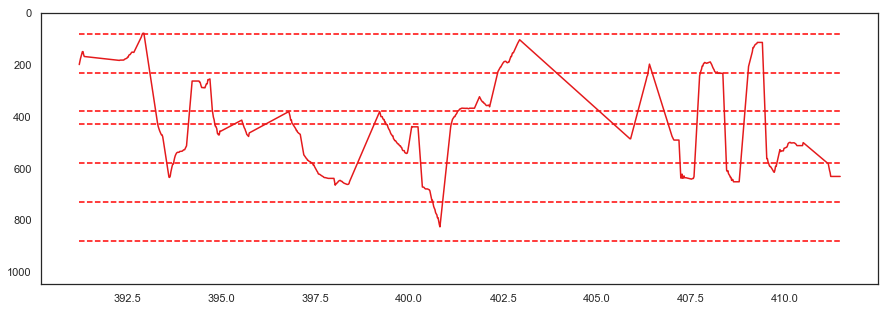

In [1081]:
time_y_plot_sub(example[example["r_AOI_0"]==0])

In [1083]:
for i in s:
    for j in i:
        ma = i.sum()
        if ma!=0:
            j /= i.sum()
s.T

matrix([[0.471, 0.095, 0.005, 0.008, 0.002, 0.   , 0.   ],
        [0.529, 0.838, 0.041, 0.011, 0.008, 0.   , 0.   ],
        [0.   , 0.035, 0.802, 0.096, 0.003, 0.   , 0.   ],
        [0.   , 0.016, 0.138, 0.822, 0.081, 0.   , 0.   ],
        [0.   , 0.016, 0.01 , 0.06 , 0.899, 0.225, 0.   ],
        [0.   , 0.   , 0.005, 0.003, 0.008, 0.775, 0.   ],
        [0.   , 0.   , 0.   , 0.   , 0.   , 0.   , 0.   ]])

In [85]:
def page_rank(n,m,fix_time = 0.1):  #自己遷移あり
    df = gl["df_"+str(m)]
    df = df[n-1]
    df = saccade(df,fix_time=fix_time)
    df = split_AOI(n,m,dx=30,df=df)
    s,df = seni_plot3(n=n,m=m,df=df)
    A = s
    line_ = lines[m-1]
    for i in s:
        for j in i:
            ma = i.sum()
            if ma!=0:
                j /= i.sum()
    ve  = np.full((1,line_),1/line_)
    for i in range(line_-1):
        z =np.full((1,line_),1/line_)
        ve = np.concatenate([ve,z])
    A_ = 0.9*s.T+0.1*ve
    B = A_.T
    for i in B:
        for j in i:
            j /= i.sum()
    vs = np.full((1,line_),1/line_)
    for i in range(10000):
        vs = vs *(B)
    return vs,A
    

In [86]:
def page_rank2(n,m,fix_time = 0.1):  #自己遷移なし
    df = gl["df_"+str(m)]
    df = df[n-1]
    df = saccade(df,fix_time=fix_time)
    df = split_AOI(n,m,dx=30,df=df)
    s,df = seni_plot3(n=n,m=m,df=df)
    line_ = lines[m-1]
    for i in range(line_):
        s[i,i]=0
    A=s
    for i in s:
        for j in i:
            ma = i.sum()
            if ma!=0:
                j /= i.sum()
    ve  = np.full((1,line_),1/line_)
    for i in range(line_-1):
        z =np.full((1,line_),1/line_)
        ve = np.concatenate([ve,z])
    A_ = 0.9*s.T+0.1*ve
    B = A_.T
    for i in B:
        for j in i:
            j /= i.sum()
    vs = np.full((1,line_),1/line_)
    for i in range(10000):
        vs = vs *(B)
    return vs,A
    

In [87]:
def seni_plot3(n,m,df):     ##page_rankの計算用、推移行列と前処理済みのデータを返す
    df=df[df["x"]<1100]
    line = lines[m-1]
    df = df[df["r_AOI_0"]!=1]
    df = df.reset_index(drop=True)
    A = np.zeros((1,line))
    for i in range(line-1):
        z = np.zeros((1,line))
        A=np.concatenate([A,z])
    A = np.matrix(A)
#     print("a")
    for i,j in df.iterrows():
        if i <= len(df)-2:
            AOIs1= np.array([])
            AOIs2= np.array([])
#             print("a")
            for k in range(line):
                name = "r_AOI_"+str(k+1)
                name1 = j[name]
#                 print(name1)
                name2 = df[name].iloc[i+1]
                AOIs1 = np.append(AOIs1,name1)
#                 print(AOIs1)
                AOIs2 = np.append(AOIs2,name2)
#                 print(AOIs2)
            for n in range(line):
                for m in range(line):
#                     print("ここまできた")
                    if (AOIs1[n]!=0)&(AOIs2[m]!=0):
                        A[m,n]+=AOIs1[n]*AOIs2[m]
    return A,df

In [88]:
def split_AOI(n,m,df,dx=30):    #n人目の被験者でm番目の課題
#     df = df.drop("r_AOI",axis=1)
    df.loc[df["x"]>1100,"r_AOI_-1"]= -1
    df = df.reset_index(drop=True)
    line = lines[m-1]
#     print(line)
    for w in range(line+1):
        name = "r_AOI_"+str(w)
        df[name]=0
    d = gl["check_line_of_e"+str(n)]
    x = gl["AOI_"+str(m)+"_x"]
    for i in range(line):
        x1 = x[i][0]-dx
        x2 = x[i][1]+dx
#         print(i)
        if i == 0:
            y1 = int((3*d[i]-d[i+1])/2)
            y2 = int((2*d[i]+d[i+1])/3)
            y3 = int((2*d[i]+2*d[i+1])/3)
        elif i == line-1:
            y1 = int((d[i-1]+2*d[i])/3)
            y2 = int((3*d[i]-d[i-1])/2)
            y3 =0
        else:
            y1 = int((d[i-1]+2*d[i])/3)
            y2 = int((2*d[i]+d[i+1])/3)
            y3 = int((d[i]+2*d[i+1])/3)

        for k,j in df.iterrows():
#             print(k)
            if (j["x"]>x1)&(j["x"]<x2)&(j["y"]>y1)&(j["y"]<y2):
                df["r_AOI_"+str(i+1)].iloc[k]=1
            elif  (j["x"]>x1)&(j["x"]<x2)&(j["y"]>y2)&(j["y"]<y3):
#                 print(i)
                g1 = np.exp((j["y"]-y2)**2/(2*(v_**2)))
                g2 = np.exp((j["y"]-y3)**2/(2*(v_**2)))
                h1 = g1/(g1+g2)
                h2 = g2/(g1+g2)
#                 print(k)
                df["r_AOI_"+str(i+1)].iloc[k]=h1     
#                 print(g1)
                df["r_AOI_"+str(i+2)].iloc[k]=h2
#                 print("r_AOI_"+str(i+1),"r_AOI_"+str(i+2))
            
    df["r_AOI_0"]=1
    for i in range(line):
        df.loc[df["r_AOI_"+str(i+1)]!=0,"r_AOI_0"]=0
             
    return df
        
        
        

In [1401]:
np.zeros(4)

array([0., 0., 0., 0.])

In [92]:
for i in range(1,25):
    print(i)
    for j in range(1,16):
            name="fix_time_"+str(i)+"_"+str(j)
            gl[name]=sum_of_time(i,j)

1
2
3


In [125]:
#各行の合計注視時間測定(時間×AOI値の合計)
def sum_of_time(n,m,fix_time=0.1):                             #n人目,m題目
    df = gl["df_"+str(m)]
    df = df[n-1]
    df=df[df["x"]<1100]
    df = saccade(df,fix_time=fix_time)
    df = split_AOI(n,m,dx=30,df=df)
    line = lines[m-1]
    df = df[df["r_AOI_0"]!=1]
    df = df.reset_index(drop=True)
#     print(len(df))
    times = np.zeros(line)
    for i,j in df.iterrows():
        if i <=len(df)-2:
            AOI_stock=np.array([])       #AOIのstock(1~7)
            AOI_stock2 = np.array([])   #AOIの値のstock(0~1)
            for k in range(line):
                name = "r_AOI_"+str(k+1)
                if j[name]!=0:
                    AOI_stock = np.append(AOI_stock,k+1)
                    AOI_stock2=np.append(AOI_stock2,j[name])
#             print(AOI_stock,AOI_stock2)
            for l,w in enumerate(AOI_stock):
                if (df["time"].iloc[i+1]-j["time"])<0.2:
                    if df["r_AOI_"+str(int(w))].iloc[i+1]!=0:
#                         print((df["time"].iloc[i+1]-j["time"])*AOI_stock2[l])
                        times[int(w-1)]+=(df["time"].iloc[i+1]-j["time"])*AOI_stock2[l]
    return times

                
            
        
        
    


In [118]:
fix_time_1_1

array([3.5597, 4.4625, 1.7007])

In [119]:
for i in range(1,25):
    name1 = "fix_time"+str(i)
    name2 = name1+".pickle"
    df = []
    for j in range(1,16):
        df.append(gl["fix_time_"+str(i)+"_"+str(j)])
    with open(name2, mode='wb') as fo:
        pickle.dump(df, fo)

In [203]:
#遷移棒グラフ関数(自己推移なし)
def seni_plot(df,line=6):
    a = write_grah_y(df)
    c=np.array([])
    d=np.array([])
    for i in range(1,line+1):                        #iから
        for j in range(1,line+1):                #jへの遷移確率
            if i!=j:
                a_sum = a.count(i)
                l=0
                if a_sum !=0:
                    for k in range(len(a)-1):
                            if (a[k]==i)&(a[k+1]==j):
                                l = l+1
                    c= np.append(c,str(i)+"->"+str(j))
                    d = np.append(d,l/a_sum)
                    print(str(i)+"->"+str(j)+"："+str(l/a_sum))
                else:
                    c= np.append(c,str(i)+"->"+str(j))
                    d = np.append(d,0)
#                     print(str(i)+"->"+str(j)+"："+str(0))
    plt.figure(figsize=(15,5))
    plt.bar(c,d)
    
#遷移棒グラフ作るようの関数
def write_grah_y(df):
    df_aoi = df[df["r_AOI"]!=0]
    df_aoi = df_aoi[df_aoi["r_AOI"]!=-1]
    df_aoi = df_aoi.reset_index(drop=True)
#     print(df_aoi)
    ao = df_aoi["r_AOI"].iloc[0]
    aoi = np.array(df_aoi["r_AOI"].iloc[0])
    times = np.array(df_aoi["time"].iloc[0])
    for i , j in df_aoi.iterrows():
        if i <=len(df_aoi)-2:
            if (j["r_AOI"]==ao)&(df_aoi.iloc[i+1]["r_AOI"]!=ao):
                    aoi=np.append(aoi,(j["r_AOI"]))
                    aoi=np.append(aoi,(df_aoi.iloc[i+1]["r_AOI"]))

                    times = np.append(times, j["time"])
                    times = np.append(times, df_aoi.iloc[i+1]["time"])
                    ao = df_aoi.iloc[i+1]["r_AOI"]
    a = []
    for i in range(len(aoi)):
        if i %2==0:
            a.append(aoi[i])
    return a

In [127]:
from tqdm import tqdm

def GaussianMask(sizex,sizey, sigma=33, center=None,fix=1):
    """
    sizex  : mask width
    sizey  : mask height
    sigma  : gaussian Sd
    center : gaussian mean
    fix    : gaussian max
    return gaussian mask
    """
    x = np.arange(0, sizex, 1, float)
    y = np.arange(0, sizey, 1, float)
    x, y = np.meshgrid(x,y)
    
    if center is None:
        x0 = sizex // 2
        y0 = sizey // 2
    else:
        if np.isnan(center[0])==False and np.isnan(center[1])==False:            
            x0 = center[0]
            y0 = center[1]        
        else:
            return np.zeros((sizey,sizex))

    return fix*np.exp(-4*np.log(2) * ((x-x0)**2 + (y-y0)**2) / sigma**2)

def Fixpos2Densemap(fix_arr, width, height, imgfile, alpha=0.5, threshold=10):
    """
    fix_arr   : fixation array number of subjects x 3(x,y,fixation)
    width     : output image width
    height    : output image height
    imgfile   : image file (optional)
    alpha     : marge rate imgfile and heatmap (optional)
    threshold : heatmap threshold(0~255)
    return heatmap 
    """
    
    heatmap = np.zeros((H,W), np.float32)
    for n_subject in range(fix_arr.shape[0]):
        heatmap += GaussianMask(W, H, 65, (fix_arr[n_subject,0],fix_arr[n_subject,1]),
                                fix_arr[n_subject,2])

    # Normalization
    heatmap = heatmap/np.amax(heatmap)
    heatmap = heatmap*255
    heatmap = heatmap.astype("uint8")
    
    if imgfile.any():
        # Resize heatmap to imgfile shape 
        h, w, _ = imgfile.shape
        heatmap = cv2.resize(heatmap, (w, h))
        heatmap_color = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        
        # Create mask
        mask = np.where(heatmap<=threshold, 1, 0)
        mask = np.reshape(mask, (h, w, 1))
        mask = np.repeat(mask, 3, axis=2)

        # Marge images
        marge = imgfile*mask + heatmap_color*(1-mask)
        marge = marge.astype("uint8")
        marge = cv2.addWeighted(imgfile, 1-alpha, marge,alpha,0)
        return marge

    else:
        heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
        return heatmap


100%|██████████| 1791/1791 [02:11<00:00, 13.59it/s]


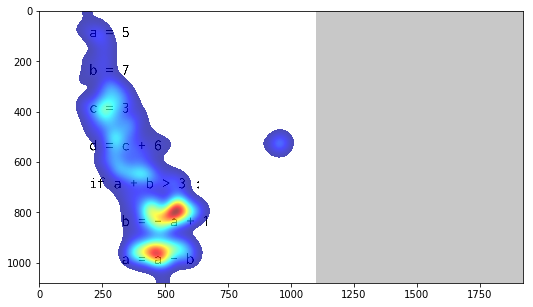

In [304]:

# Load image file
img = cv2.imread('img10.png')
    
    # Generate toy fixation data
    # when you use, replace here with your data
num_subjects = 40
# H, W, _ = img.shape
    
fix_arr = ttf

    
    # Create heatmap
heatmap = Fixpos2Densemap(fix_arr, 1920, 1080, img, 0.7, 5)
# cv2.imwrite("output5.png",heatmap)
plt.figure(figsize=(15,5))
plt.ylim(1080,0)
heat= cv2.cvtColor( heatmap, cv2.COLOR_BGR2RGB) 
plt.imshow(heat)
plt.show()

In [302]:
tf = df_10[6][["x","y","time"]].reset_index(drop=True)
ttf = tf.copy()
for i,j in tf.iterrows():
    if i !=0:
        ttf["time"].iloc[i] = tf["time"].iloc[i]-tf["time"].iloc[i-1]
# ttf["time"]*=100
# ttf

In [303]:
ttf= np.array(ttf[1:])

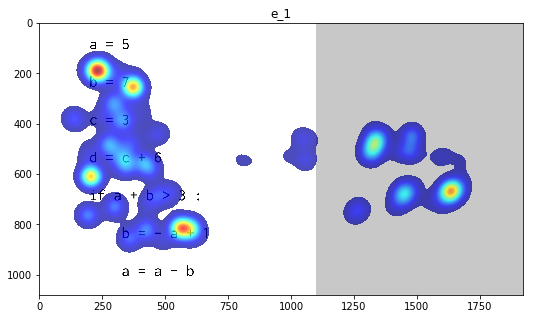

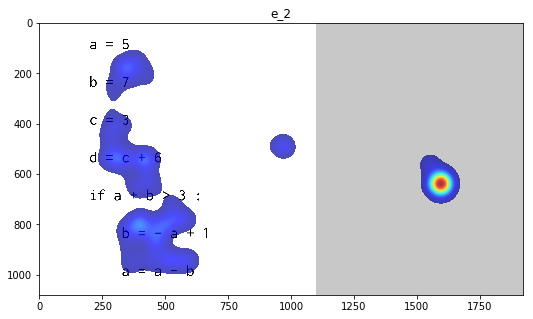

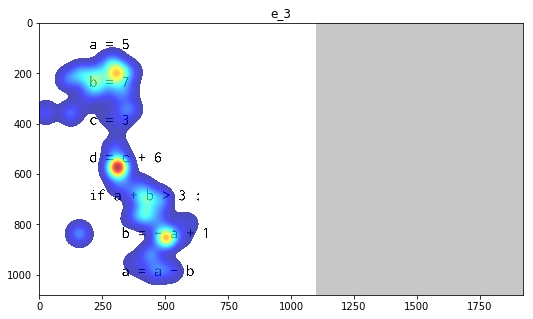

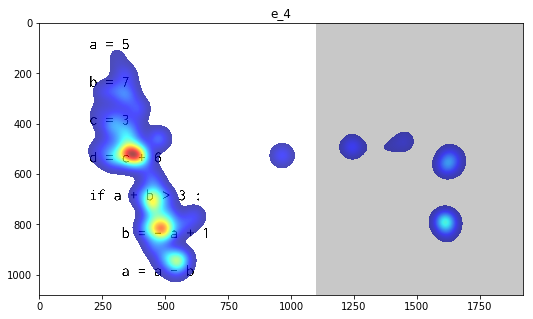

In [493]:
for k in range(1,5):
    tf = saccade(df_10[k-1])
    tf = tf[["x","y","time"]].reset_index(drop=True)
    ttf = tf.copy()
    for i,j in tf.iterrows():
        if i !=0:
            ttf["time"].iloc[i] = tf["time"].iloc[i]-tf["time"].iloc[i-1]
    ttf= np.array(ttf[1:])
    heatmap = Fixpos2Densemap(ttf, 1920, 1080, img, 0.7, 5)
    plt.figure(figsize=(15,5))
    plt.ylim(1080,0)
    plt.title("e_"+str(k))
    heat= cv2.cvtColor( heatmap, cv2.COLOR_BGR2RGB) 
    plt.imshow(heat)
    plt.show()

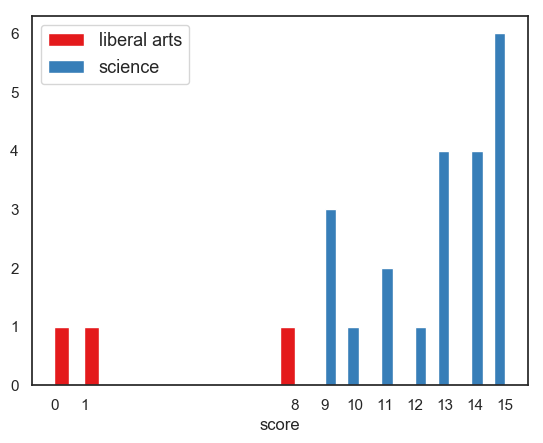

In [575]:
score=np.array([1,13,9,9,15,10,0,14,13,13,9,12,15,13,8,14,15,14,15,11,11,14,15,15])
rikei=np.array([13,9,9,15,10,14,13,13,9,12,15,13,14,15,14,15,11,11,14,15,15])
bunkei = np.array([1,0,8])

# sns.set()
sns.set_style('white')
sns.set_palette('Set1')
plt.xticks([0,1,8,9,10,11,12,13,14,15]) 
plt.hist(bunkei,bins=16,rwidth=10,label="liberal arts")
plt.hist(rikei,bins=16,rwidth=100,label="science")
plt.legend(loc="upper left", fontsize=13) # (5)凡例表示
# fig = plt.figure()
# ax = fig.add_subplot(1,1,1)

# ax.hist([rikei, bunkei], bins=10, color=['red', 'blue', ], label=['x1', 'x2'])
plt.xlabel('score')
# plt.ylabel("number")
# import seaborn as sns

plt.show()

In [555]:
average_time=np.array([18.933,13.733,18.133,12.2,10.733,10.866,20.066,16.333,12.533,13,11.4,13.466,12.4,11.4,14.933,14.466,11.066,16.4,11.733,16.6,15.2,11.333,17.266,14.466])
rikei_time = np.array([18.933,13.733,18.133,12.2,10.733,10.866,16.333,12.533,13,11.4,13.466,12.4,11.4,14.466,11.066,16.4,11.733,16.6,15.2,11.333,17.266,14.466])
# len(average_time)

In [556]:
s1=pd.Series(rikei)
s2=pd.Series(rikei_time)

# pandasを使用してPearson's rを計算
res=s1.corr(s2)   # numpy.float64 に格納される

# 結果
print(res)

-0.05218748038865021


In [763]:
#9課題目の正解者と不正解者の1行目の重要度の箱ひげ図
# df_1_maru_ = df_1_maru[3:]
# df_2_maru_ = df_2_maru[3:]
# df_3_maru_ = df_3_maru[3:]
# df_4_maru_ = df_4_maru[3:]
# df_5_maru_ = df_5_maru[3:]
# df_6_maru_ = df_6_maru[3:]
# df_7_maru_ = df_7_maru[3:]
# df_8_maru_ = df_8_maru[3:]
# df_9_maru_ = df_9_maru[3:]
# df_10_maru_ = df_10_maru[3:]
# df_11_maru_ = df_11_maru[3:]
# df_12_maru_ = df_12_maru[3:]
# df_13_maru_ = df_13_maru[3:]
# df_14_maru_ = df_14_maru[3:]
# df_15_maru_ = df_15_maru[3:]

for k in range(1,16):                                                             ##１と７人目は除く！！
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "maru_"+str(k)+"_"+str(i+1)
        name2 = "batu_"+str(k)+"_"+str(i+1)
        name3 ="aho_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        d3 = np.array([])
        for j in range(24):
#             if (j!=0)&(j!=6):
                if df[j]==1:
                    
                    d1= np.append(d1,gl["page_rank_"+str(k)][j,i])
#                 else:
                elif (df[j]==5):
                    d2 = np.append(d2,gl["page_rank_"+str(k)][j,i])
#                 elif (df[j]==2)&(j==6):
#                     d3 = np.append(d3,gl["page_rank_"+str(k)][j,i])
        gl[name1]=d1
        gl[name2]=d2
#         gl[name3]=d3

In [735]:
aho_8_3

array([], dtype=float64)

In [752]:
for k in range(1,16):                                                             ##１と７人目は除く！！
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "fix_maru_"+str(k)+"_"+str(i+1)
        name2 = "fix_batu_"+str(k)+"_"+str(i+1)
        name3 =  "aho_fix_batu_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        d3 = np.array([])
        for j in range(24):
#             if (j!=0)&(j!=6):
                if df[j]==1:
#                     print(j)
                    d1= np.append(d1,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
#                 else:
                elif (df[j]==11):
                    d2 = np.append(d2,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
#                 elif (df[j]==2)&(j==6):
#                     d3 = np.append(d3,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
        gl[name1]=d1
        gl[name2]=d2
#         gl[name3]=d3

In [764]:
for k in range(1,16):                                                             ##１と７人目は除く！！
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "ratio_fix_maru_"+str(k)+"_"+str(i+1)
        name2 = "ratio_fix_batu_"+str(k)+"_"+str(i+1)
        name3 = "aho_ratio_fix_batu_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        d3 = np.array([])
        for j in range(24):
#             if (j!=0)&(j!=6):
                if df[j]==1:
#                     print(j)
                    d1= np.append(d1,gl["ratio_fix_time_"+str(j+1)+"_"+str(k)][i])
#                 else:
                elif (df[j]==5):
                    d2 = np.append(d2,gl["ratio_fix_time_"+str(j+1)+"_"+str(k)][i])
#                 elif (df[j]==4)&(j==6):
#                     d3 = np.append(d3,gl["ratio_fix_time_"+str(j+1)+"_"+str(k)][i])
        gl[name1]=d1
        gl[name2]=d2
#         gl[name3]=d3

In [144]:
maru_1_1

array([0.2164, 0.2462, 0.2693, 0.1419, 0.2276, 0.2644, 0.1528, 0.328 ,
       0.3154, 0.2943, 0.1515, 0.2943, 0.1807, 0.3193, 0.2527, 0.2359,
       0.2217, 0.3   , 0.191 , 0.2709, 0.2975, 0.113 ])

In [1555]:
fix_time_1_1/fix_time_1_1.sum()

array([0.366, 0.459, 0.175])

In [223]:
for i in range(1,16):
    for j in range(1,25):
        b_name = "fix_time_"+str(j)+"_"+str(i)
        a_name = "ratio_fix_time_"+str(j)+"_"+str(i)
        df = gl[b_name]
        df = df/df.sum()
        gl[a_name]=df

In [1568]:
ratio_fix_time_15_1

array([0.127, 0.66 , 0.213])

In [640]:
for k in range(1,16):    
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "ratio_time<10_maru_"+str(k)+"_"+str(i+1)                   #k題目のi+1行目
        name2 = "ratio_time10<20_maru_"+str(k)+"_"+str(i+1)
#         name3 = "ratio_time20<30_maru_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        d3 = np.array([])
        for j in range(24):
                if df[j]==1:
                    if gl["e"+str(j+1)+"_time"][k-1]<14.2:
                        d1= np.append(d1,gl["ratio_fix_time_"+str(j+1)+"_"+str(k)][i])
#                     elif (gl["e"+str(j+1)+"_time"][k-1]>=10)&(gl["e"+str(j+1)+"_time"][k-1]<20):
#                         d2= np.append(d2,gl["ratio_fix_time_"+str(j+1)+"_"+str(k)][i])
                    else: 
                        d2= np.append(d2,gl["ratio_fix_time_"+str(j+1)+"_"+str(k)][i])
        gl[name1]=d1
        gl[name2]=d2
#         gl[name3]=d3

In [1592]:
    k=9                                                            ##１と７人目は除く！！
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
#         name1 = "maru_"+str(k)+"_"+str(i+1)
        name2 = "batu_"+str(k)+"_74_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        for j in range(24):
                if df[j]==0:
                    if df_9_maru_74[j]==1:
                        d2= np.append(d2,gl["page_rank_"+str(k)][j,i])
#                 else:
#                     d1 = np.append(d1,gl["page_rank_"+str(k)][j,i])
#         gl[name1]=d1
        gl[name2]=d2

In [1593]:
batu_9_74_1

array([0.191, 0.225, 0.068, 0.177])

In [634]:
for k in range(1,16):                                                             ##１と７人目は除く！！
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "time<10_maru_"+str(k)+"_"+str(i+1)                   #k題目のi+1行目
        name2 = "time10<20_maru_"+str(k)+"_"+str(i+1)
#         name3 = "time20<30_maru_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        d3 = np.array([])
        for j in range(24):
                if df[j]==1:
                    if gl["e"+str(j+1)+"_time"][k-1]<14.2:
                        d1= np.append(d1,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
#                     elif (gl["e"+str(j+1)+"_time"][k-1]>=10)&(gl["e"+str(j+1)+"_time"][k-1]<20):
#                         d2= np.append(d2,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
                    else: 
                        d2= np.append(d2,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
        gl[name1]=d1
        gl[name2]=d2
#         gl[name3]=d3

In [627]:
for k in range(1,16):                                                           
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "answer_time<15_maru_"+str(k)+"_"+str(i+1)                   #k題目のi+1行目
        name2 = "answer_time<30_maru_"+str(k)+"_"+str(i+1)
#         name3 = "p_time20<30_maru_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        d3 = np.array([])
        for j in range(24):
                if df[j]==1:
                    if gl["e"+str(j+1)+"_time"][k-1]<14.2:
                        d1= np.append(d1,gl["page_rank_"+str(k)][j,i])
#                     elif (gl["e"+str(j+1)+"_time"][k-1]>=10)&(gl["e"+str(j+1)+"_time"][k-1]<20):
#                         d2= np.append(d2,gl["page_rank_"+str(k)][j,i])
                    else: 
                        d2= np.append(d2,gl["page_rank_"+str(k)][j,i])
        gl[name1]=d1
        gl[name2]=d2
#         gl[name3]=d3

In [1480]:
for k in range(1,16):                                                             ##１と７人目は除く！！
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "fix_maru_"+str(k)+"_"+str(i+1)                   #k題目のi+1行目
        name2 = "fix_batu_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        d2 = np.array([])
        for j in range(24):
                if df[j]==0:
                    if (j!=0)&(j!=6):
                        d2= np.append(d2,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
                else:
                    d1 = np.append(d1,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
        gl[name1]=d1
        gl[name2]=d2
                                         
for k in range(1,16):                                                             ##１と７人目
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "fix_e07_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        for j in range(7):
            if (j==0)|(j==6):
                if df[j]==0:
                    d1 = np.append(d1,gl["fix_time_"+str(j+1)+"_"+str(k)][i])
        gl[name1]=d1

In [131]:
for k in range(1,16):                                                             ##１と７人目は除く！！
    line = lines[k-1]
    df = gl["df_"+str(k)+"_maru"]
    for i in range(line):
        name1 = "e07_"+str(k)+"_"+str(i+1)
        d1 = np.array([])
        for j in range(7):
            if (j==0)|(j==6):
                if df[j]==0:
                    d1 = np.append(d1,gl["page_rank_"+str(k)][j,i])
        gl[name1]=d1

In [1366]:
e07_1_1

array([0.339, 0.184])

In [765]:
def page_rank_plot3(m):#重要度の行ごとの比較
    fig = plt.figure(figsize=(10,5))
    line = lines[m-1]
    for i in range(line):
        name1 = "d"+str(i+1)
        name2 = "e_"+str(i+1)
        name3 = "f"+str(i+1)
        gl[name1]=gl["maru_"+str(m)+"_"+str(i+1)]
        gl[name2]=gl["batu_"+str(m)+"_"+str(i+1)]
        gl[name3]=gl["aho_"+str(m)+"_"+str(i+1)]
#     print(f1)
    name = "page_rank_"+str(m)

    plt.style.use('default')
    sns.set()
    sns.set_style('whitegrid')
    flatui = ["black", "red", "green", "#e74c3c", "#34495e", "#2ecc71"]
    sns.set_palette(flatui)


    if line == 3:
        df_batu = pd.DataFrame({
            '1': e_1,'2': e_2,'3':e_3})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3})
    elif line == 4:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4})
    elif line == 5:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5})
    elif line == 6:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6})
    elif line == 7:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6,'7':e_7})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6,'7':d7})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6,'7':f7})
   

    # merge the two data frames to one data frame
    dfTa_melt = pd.melt(df_batu)
    dfTa_melt['species'] = 'e3'
    dfAt_melt = pd.melt(df_maru)
    dfAt_melt['species'] = "●"
    dfe7_melt = pd.melt(df_e7)
    dfe7_melt['species'] = 'e7'
    df = pd.concat([dfAt_melt, dfTa_melt], axis=0)
#     df = pd.concat([df, dfe7_melt], axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    sns.boxplot(x='variable', y='value', data=df, hue='species', palette='Dark2', ax=ax)
    sns.stripplot(x='variable', y='value', data=df, hue='species', dodge=True, jitter=True,  ax=ax)

    ax.set_xlabel('line')
    ax.set_ylabel('PageRank')
    ax.set_ylim(0, 0.7)
    ax.legend()
    plt.title("question"+str(m))
    plt.show()

<Figure size 1000x500 with 0 Axes>

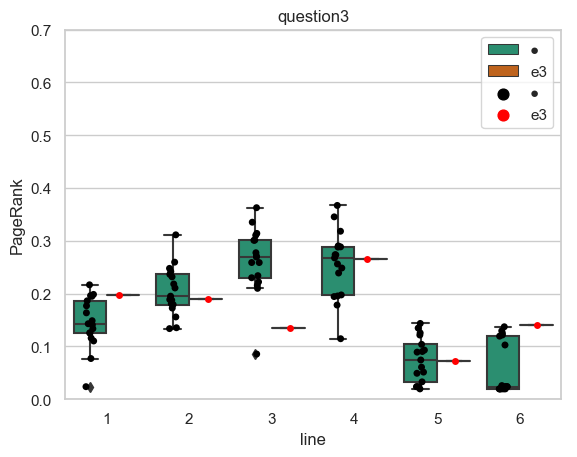

<Figure size 1000x500 with 0 Axes>

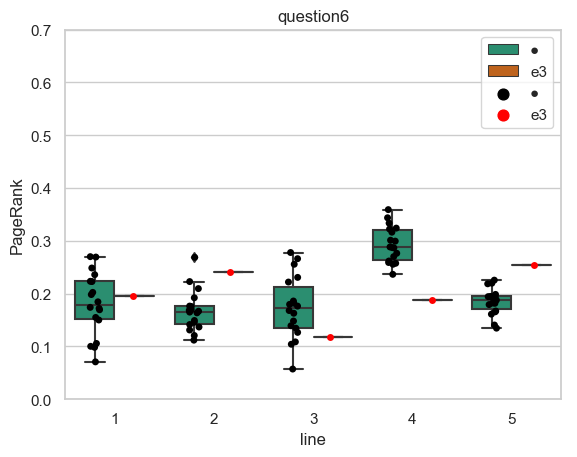

<Figure size 1000x500 with 0 Axes>

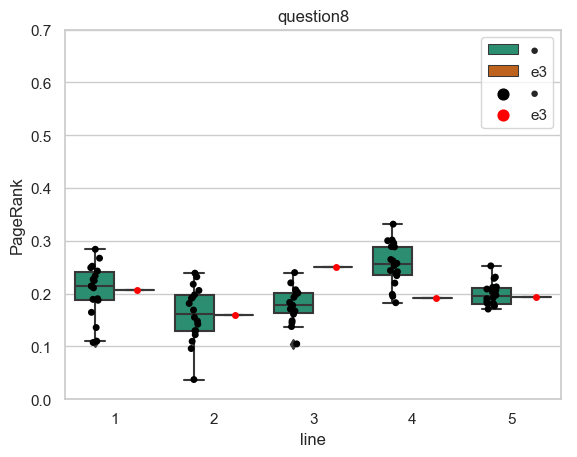

<Figure size 1000x500 with 0 Axes>

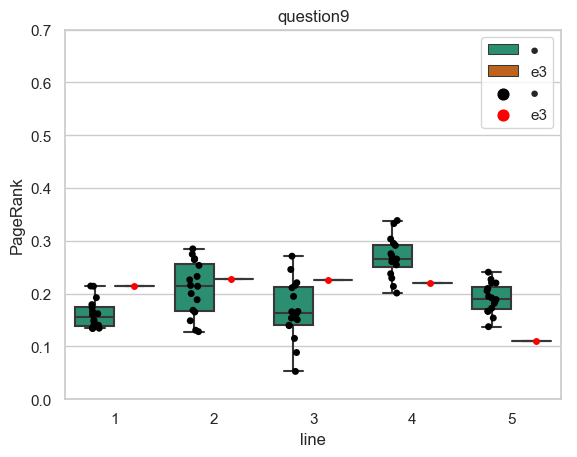

<Figure size 1000x500 with 0 Axes>

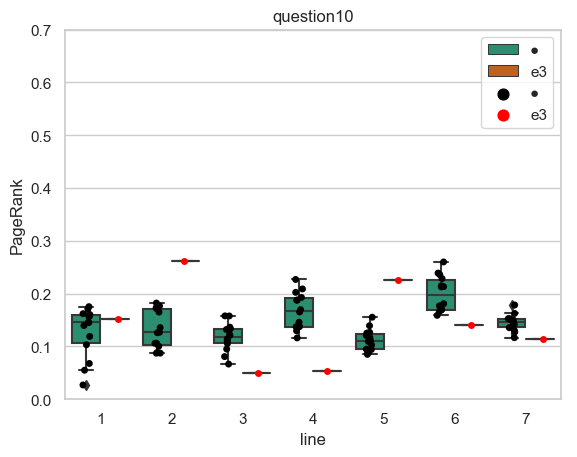

In [766]:
# for i in range(3,11):
page_rank_plot3(3)
page_rank_plot3(6)
page_rank_plot3(8)
page_rank_plot3(9)
page_rank_plot3(10)

<Figure size 1000x500 with 0 Axes>

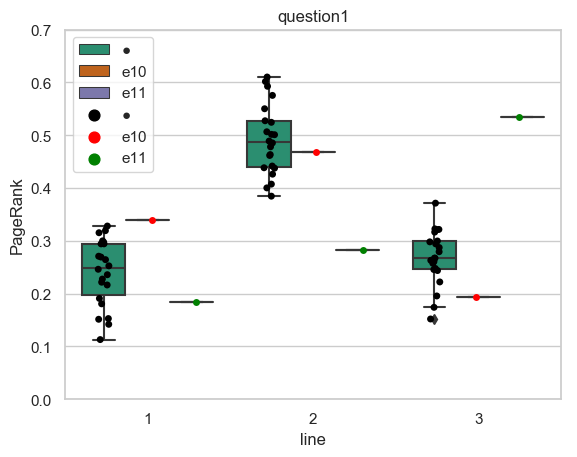

In [699]:
page_rank_plot3(1)

<Figure size 1000x500 with 0 Axes>

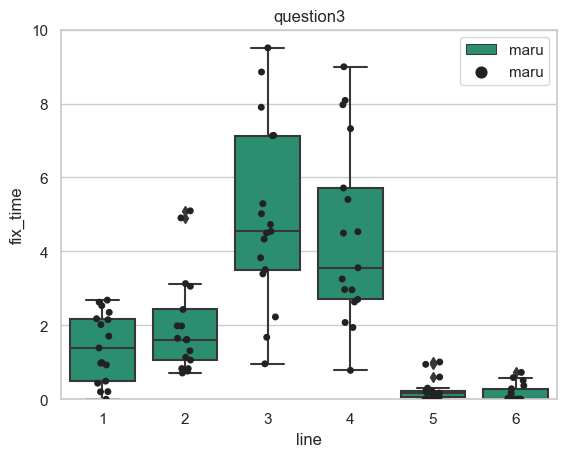

<Figure size 1000x500 with 0 Axes>

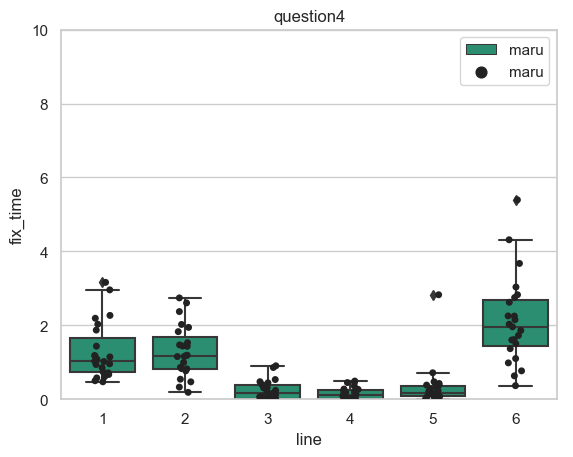

<Figure size 1000x500 with 0 Axes>

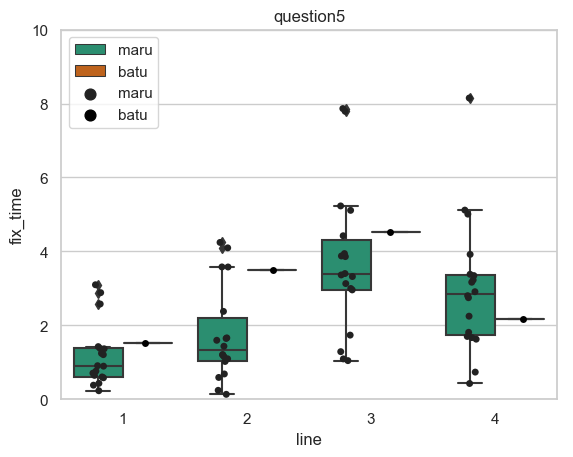

<Figure size 1000x500 with 0 Axes>

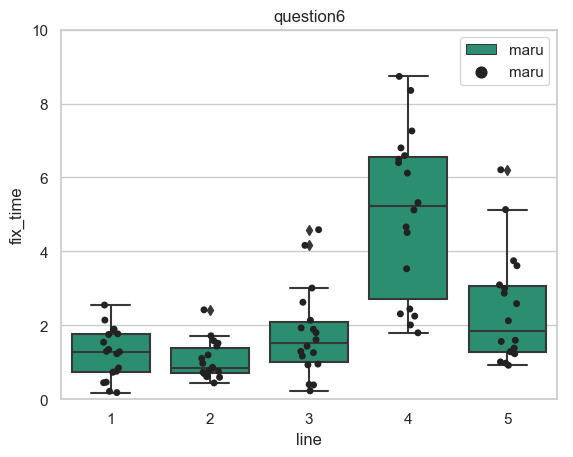

<Figure size 1000x500 with 0 Axes>

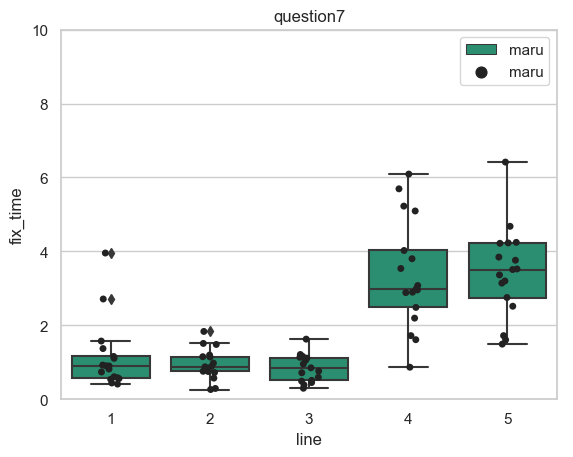

<Figure size 1000x500 with 0 Axes>

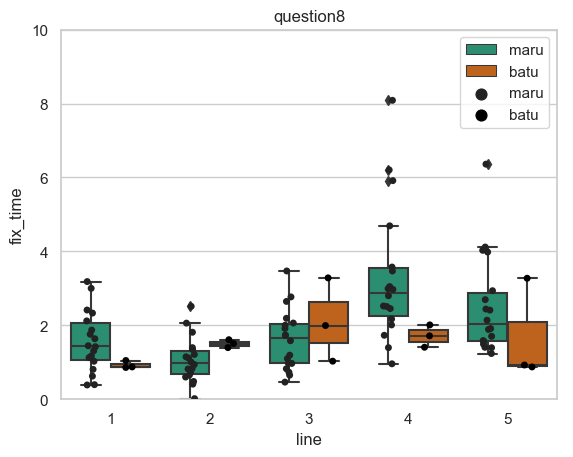

<Figure size 1000x500 with 0 Axes>

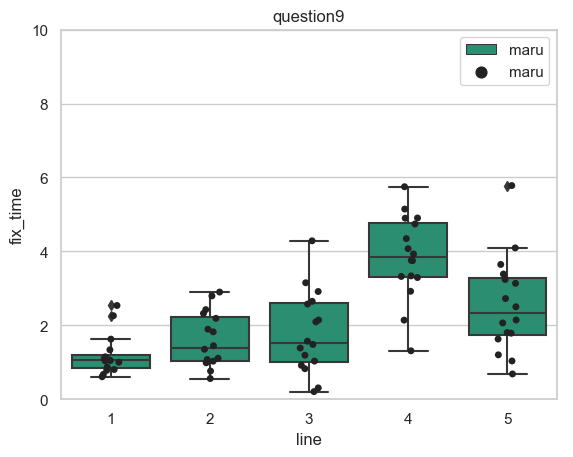

<Figure size 1000x500 with 0 Axes>

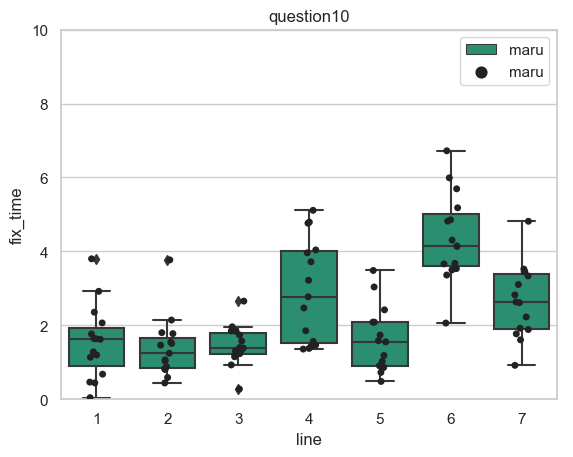

In [458]:
for i in range(3,11):
    fix_plot3(i)

<Figure size 1000x500 with 0 Axes>

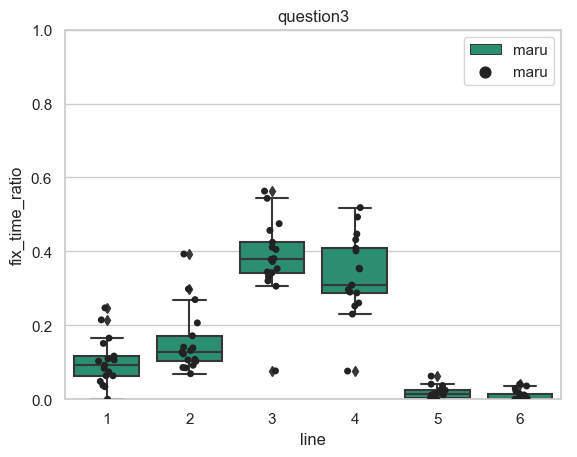

<Figure size 1000x500 with 0 Axes>

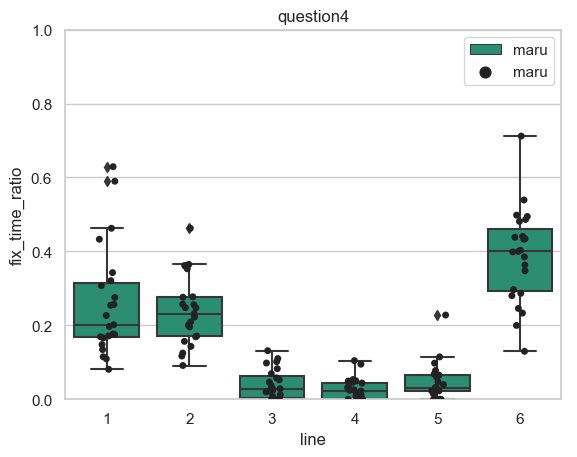

<Figure size 1000x500 with 0 Axes>

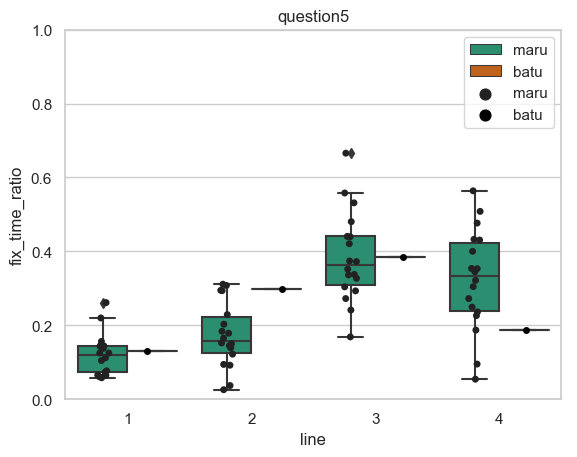

<Figure size 1000x500 with 0 Axes>

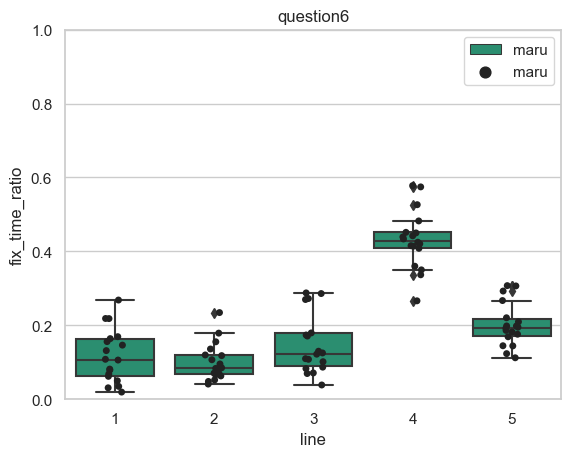

<Figure size 1000x500 with 0 Axes>

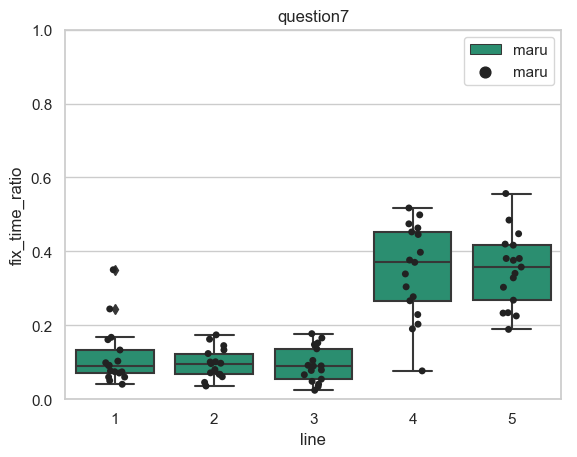

<Figure size 1000x500 with 0 Axes>

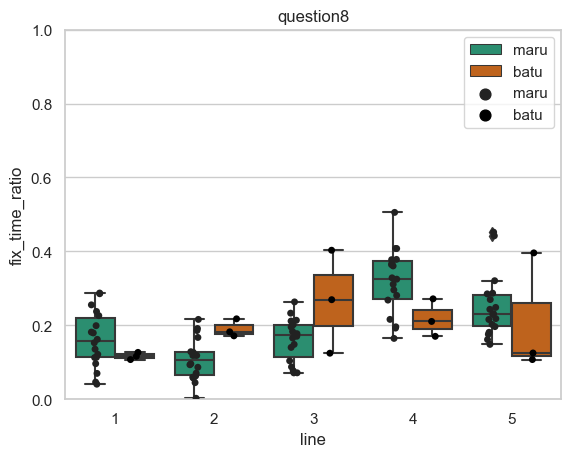

<Figure size 1000x500 with 0 Axes>

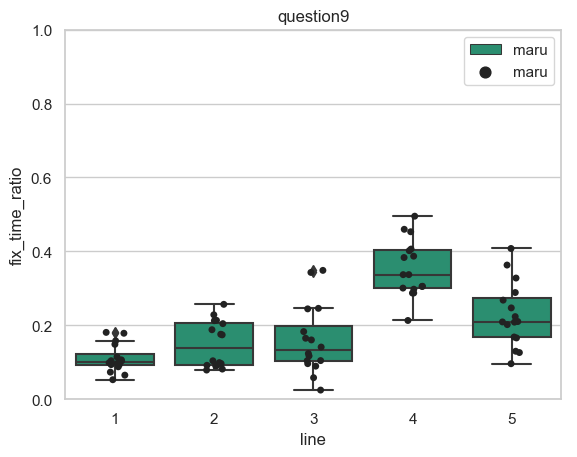

<Figure size 1000x500 with 0 Axes>

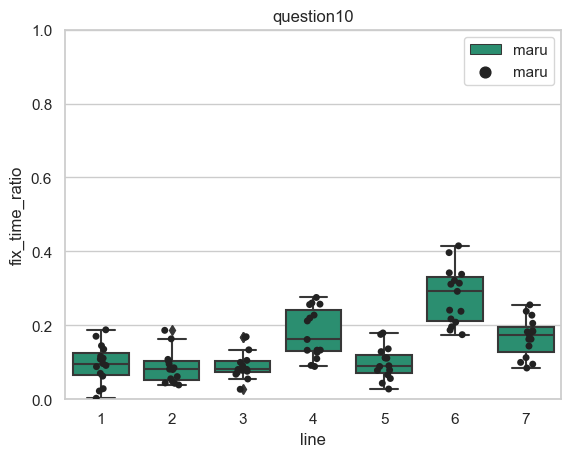

In [459]:
for i in range(3,11):
    fix_plot_ratio(i)

2


<Figure size 1000x500 with 0 Axes>

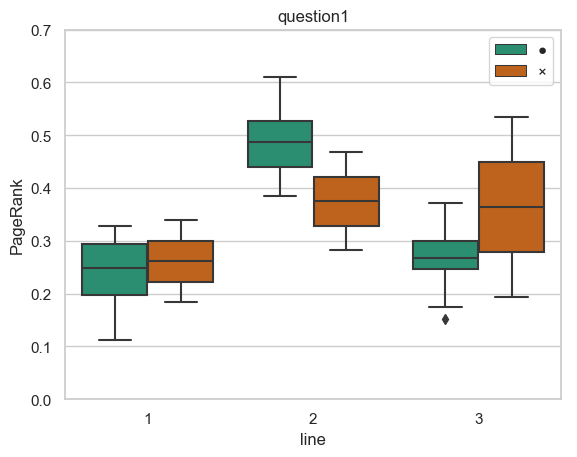

3


<Figure size 1000x500 with 0 Axes>

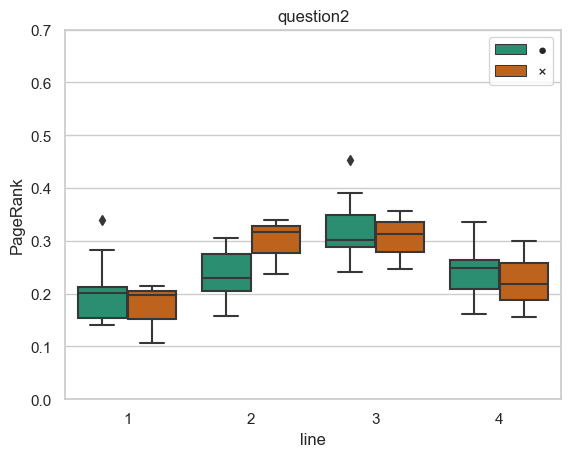

7


<Figure size 1000x500 with 0 Axes>

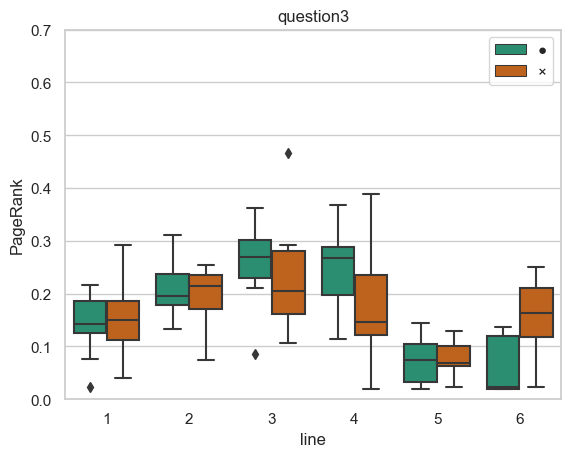

1


<Figure size 1000x500 with 0 Axes>

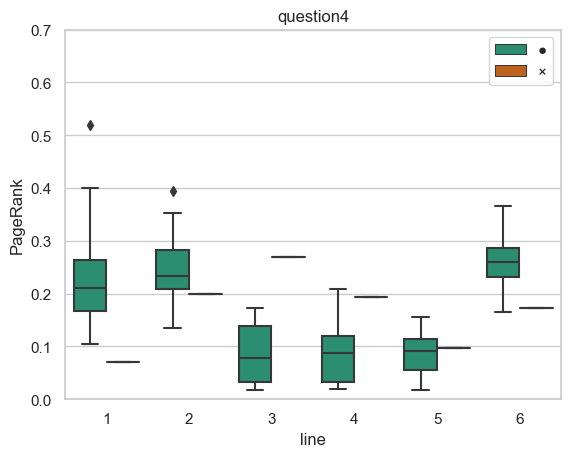

6


<Figure size 1000x500 with 0 Axes>

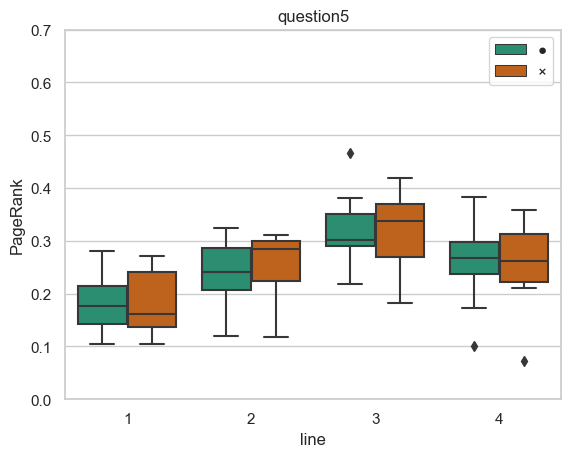

6


<Figure size 1000x500 with 0 Axes>

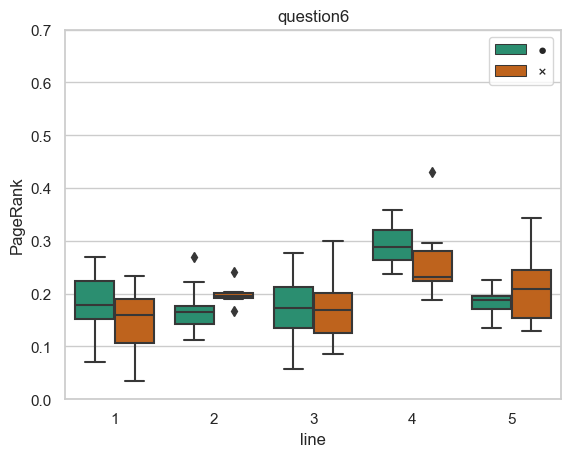

7


<Figure size 1000x500 with 0 Axes>

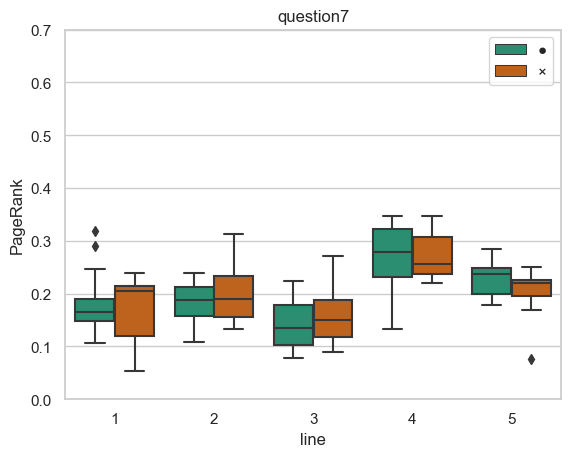

6


<Figure size 1000x500 with 0 Axes>

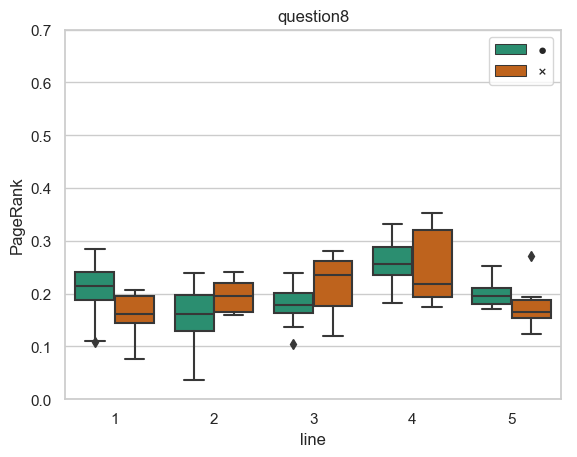

8


<Figure size 1000x500 with 0 Axes>

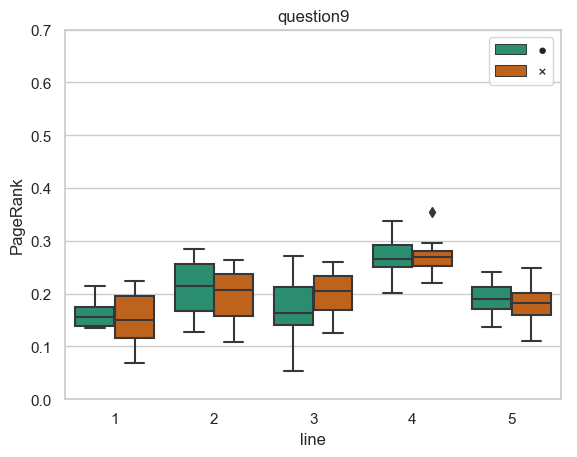

10


<Figure size 1000x500 with 0 Axes>

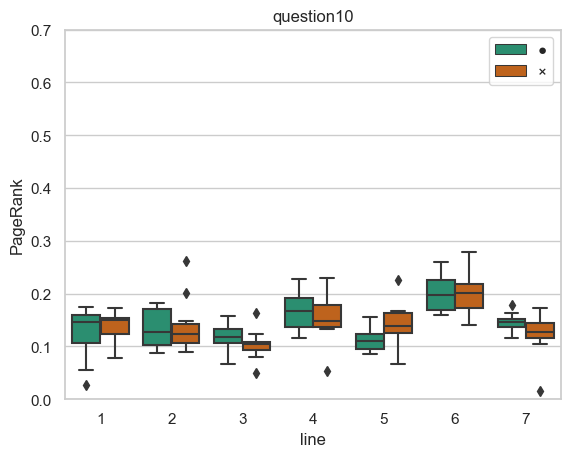

9


<Figure size 1000x500 with 0 Axes>

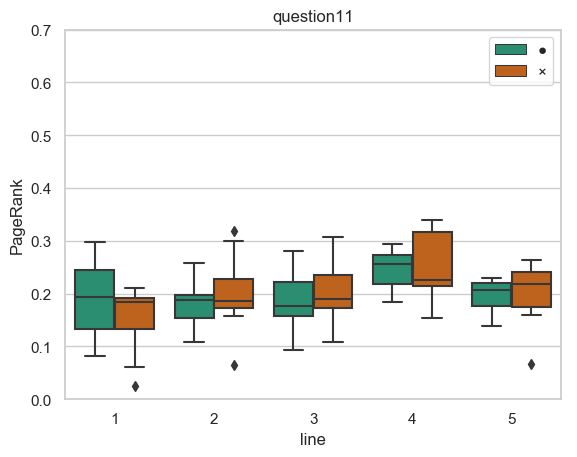

5


<Figure size 1000x500 with 0 Axes>

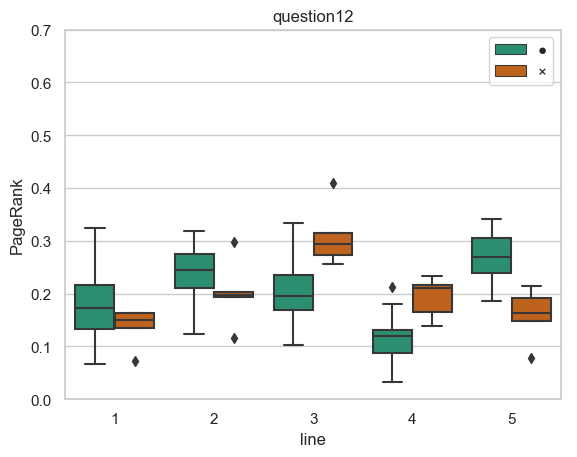

5


<Figure size 1000x500 with 0 Axes>

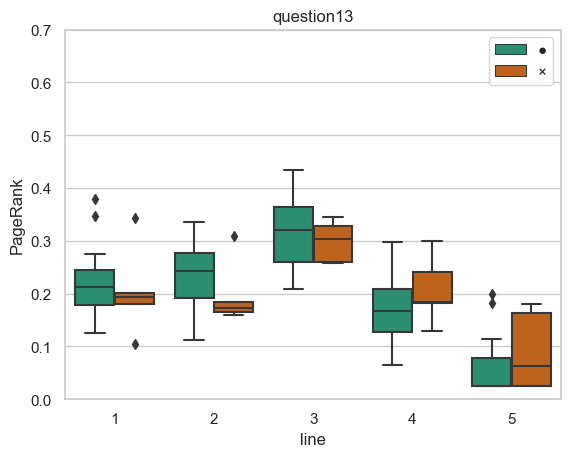

2


<Figure size 1000x500 with 0 Axes>

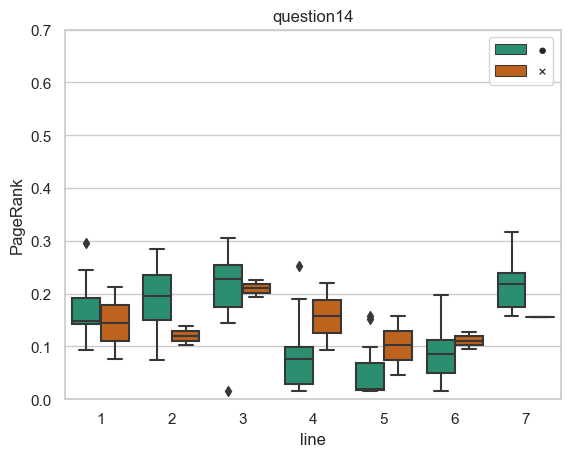

5


<Figure size 1000x500 with 0 Axes>

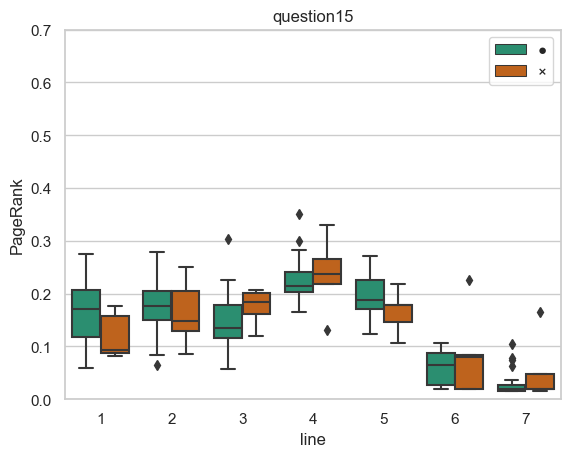

In [599]:
#全部込みver
for i in range(1,16):
    print(len(gl["batu_"+str(i)+"_"+str(1)]))
    page_rank_plot3(i)

In [591]:
#全部込みver
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差あり(等分散)、p値は 0.035545152113955
1の3行目は有意差なし(等分散ではない)
2の1行目は有意差なし(等分散)
2の2行目は有意差あり(等分散)、p値は 0.027813912590114547
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差なし(等分散)
3の2行目は有意差なし(等分散)
3の3行目は有意差なし(等分散ではない)
3の4行目は有意差なし(等分散ではない)
3の5行目は有意差なし(等分散)
3の6行目は有意差あり(等分散)、p値は 0.0011178862041625944
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差なし(等分散)
6の4行目は有意差なし(等分散ではない)
6の5行目は有意差なし(等分散ではない)
7の1行目は有意差なし(等分散)
7の2行目は有意差なし(等分散)
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差なし(等分散)
8の3行目は有意差なし(等分散ではない)
8の4行目は有意差なし(等分散ではない)
8の5行目は有意差なし(等分散ではない)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散)
10の3行目は有意差なし(等分散)
10の4行目は有意差なし(等分散)
10の5行目は有意差なし(等分散ではない)
10の6行目は有意差なし(等分散)
10の7行目は有意差なし(等分散ではない)
11の1行目は有意差なし(等分散)
11の2行目は有

<Figure size 1000x500 with 0 Axes>

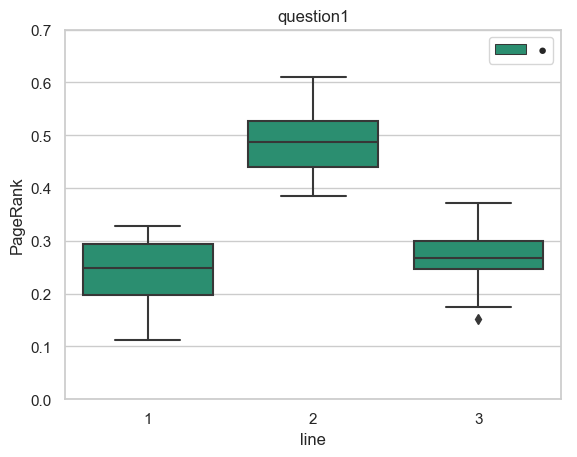

<Figure size 1000x500 with 0 Axes>

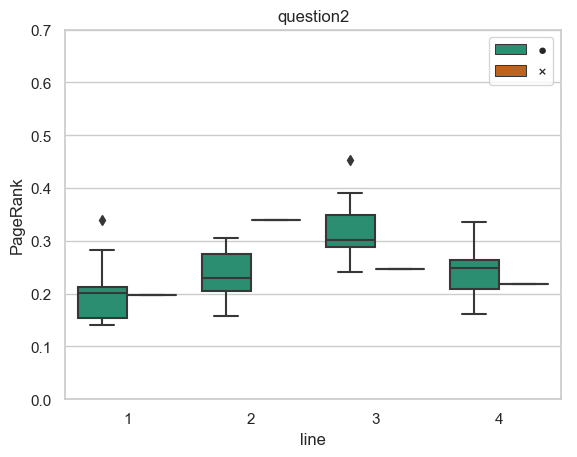

<Figure size 1000x500 with 0 Axes>

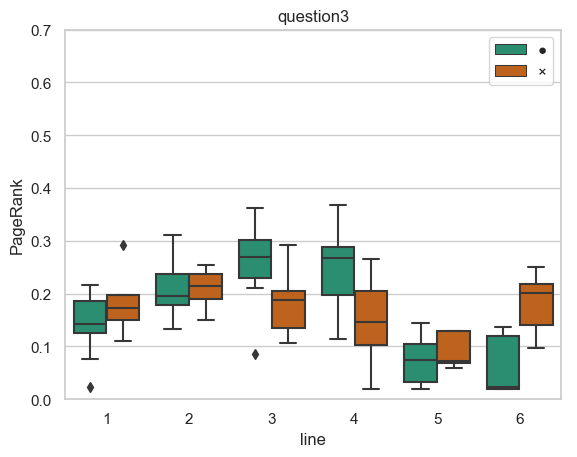

<Figure size 1000x500 with 0 Axes>

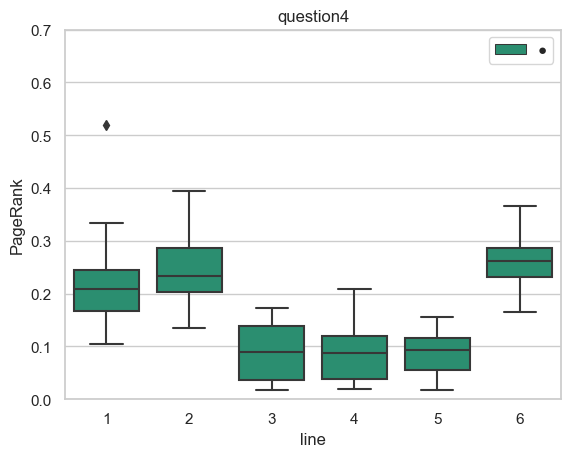

<Figure size 1000x500 with 0 Axes>

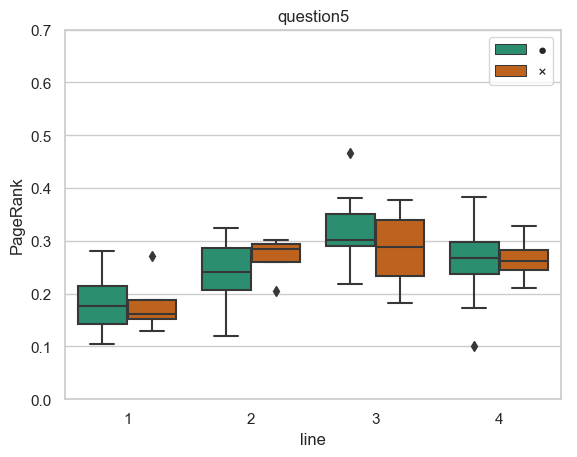

<Figure size 1000x500 with 0 Axes>

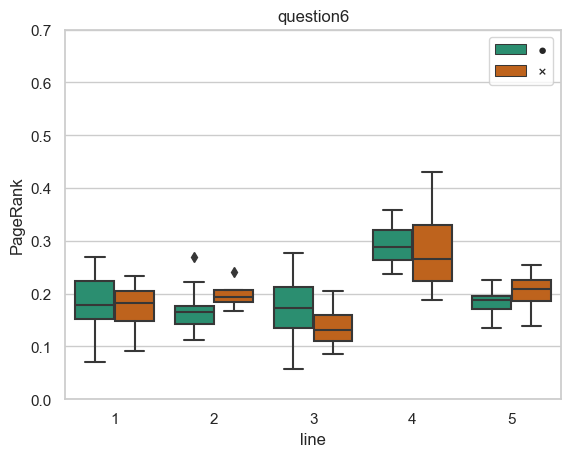

<Figure size 1000x500 with 0 Axes>

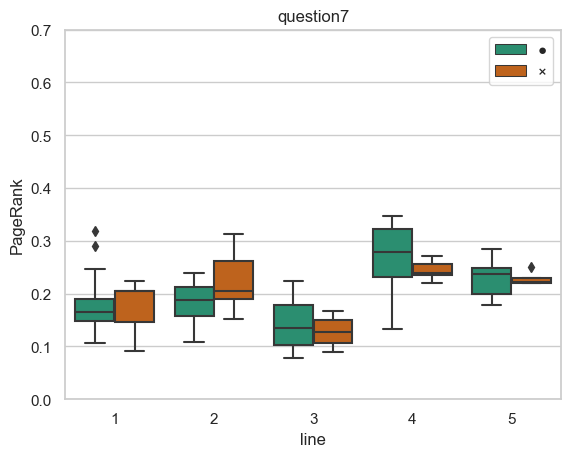

<Figure size 1000x500 with 0 Axes>

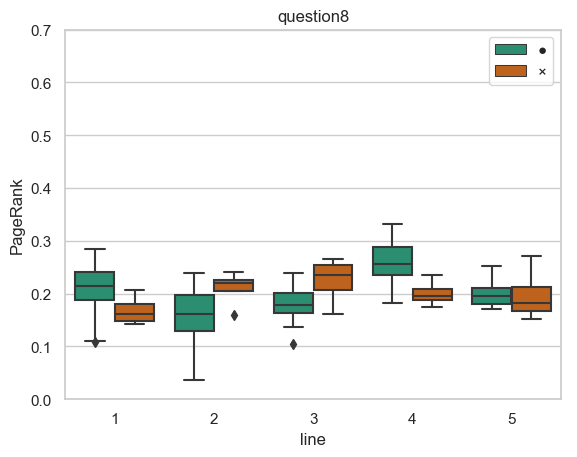

<Figure size 1000x500 with 0 Axes>

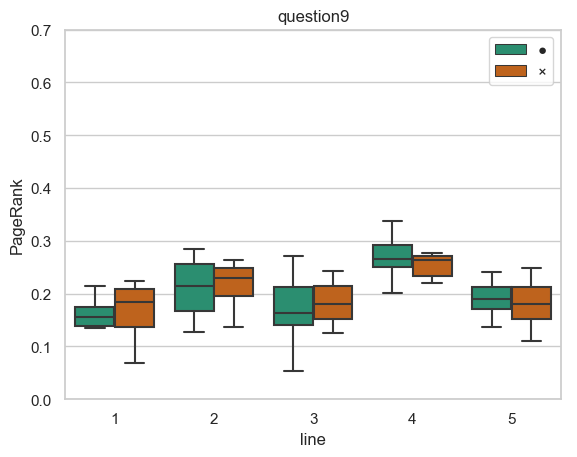

<Figure size 1000x500 with 0 Axes>

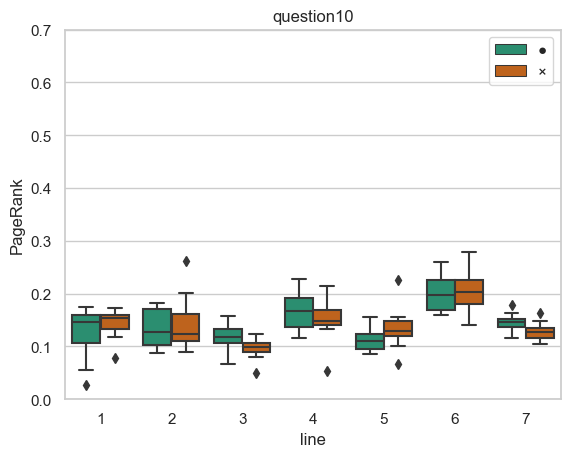

<Figure size 1000x500 with 0 Axes>

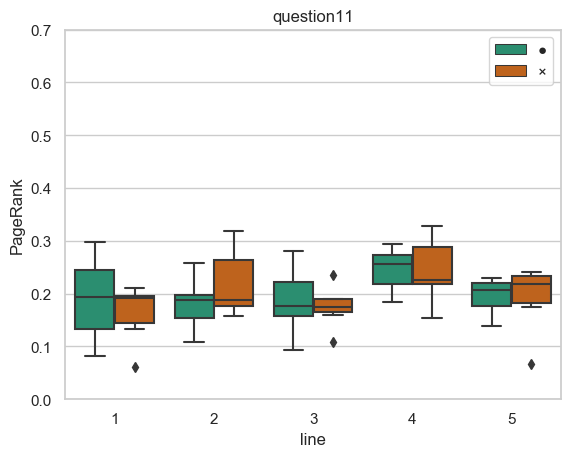

<Figure size 1000x500 with 0 Axes>

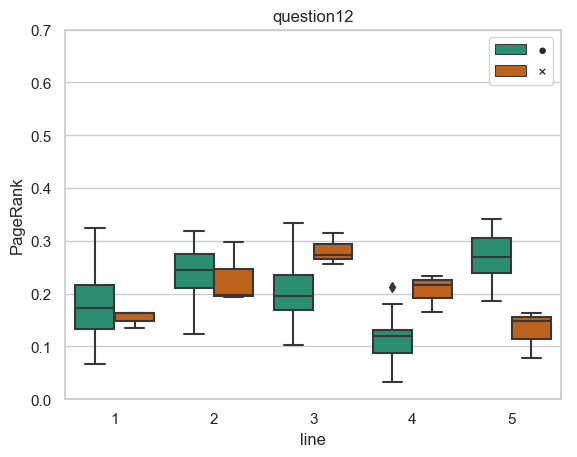

<Figure size 1000x500 with 0 Axes>

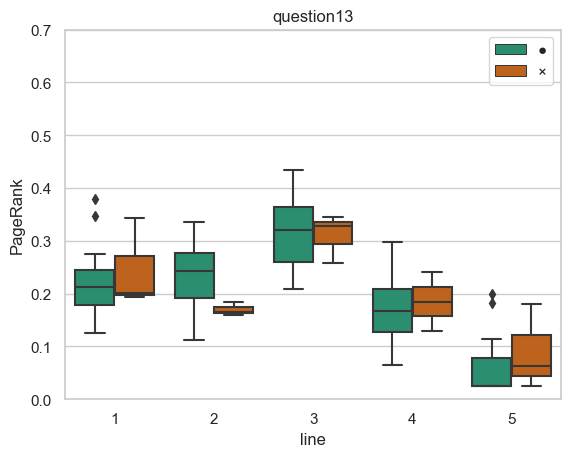

<Figure size 1000x500 with 0 Axes>

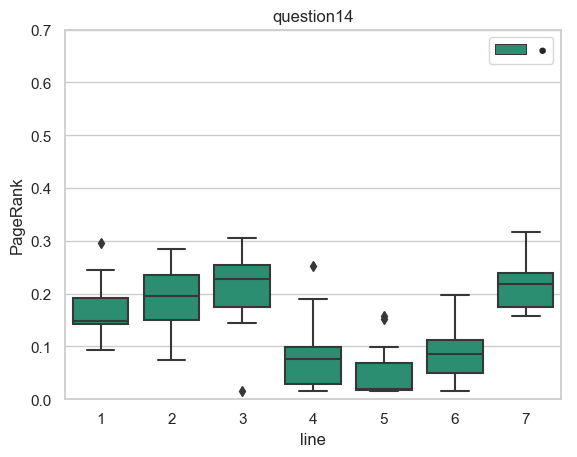

<Figure size 1000x500 with 0 Axes>

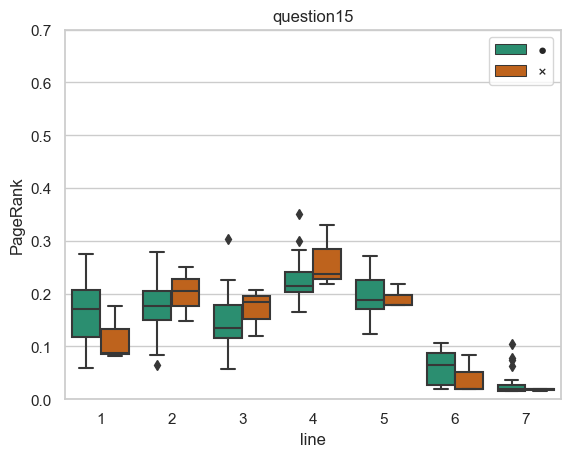

In [616]:
#1,7除いたver
for i in range(1,16):
    page_rank_plot3(i)


In [617]:
#1,7除いたver
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散)
2の1行目は有意差なし(等分散)
2の2行目は有意差なし(等分散)
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差なし(等分散)
3の2行目は有意差なし(等分散)
3の3行目は有意差あり(等分散)、p値は 0.030398414277509497
3の4行目は有意差あり(等分散)、p値は 0.007554906498093097
3の5行目は有意差なし(等分散)
3の6行目は有意差あり(等分散)、p値は 0.00016251540029556163
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差なし(等分散)
6の4行目は有意差なし(等分散ではない)
6の5行目は有意差なし(等分散)
7の1行目は有意差なし(等分散)
7の2行目は有意差なし(等分散)
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散ではない)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差なし(等分散)
8の3行目は有意差あり(等分散)、p値は 0.026958358434935138
8の4行目は有意差あり(等分散)、p値は 0.01924100522659608
8の5行目は有意差なし(等分散ではない)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散)
10の3行目は有意差なし(等分散)
10の4行目は有意差なし(等分散)
10の5行目は有意差なし(等分散ではない)
10の6行目は有意差なし(等分散)
10の7行目は有意差あり(等分

In [207]:
len(batu_15_1)

3

In [1183]:
def page_rank_plot2(m,k):　
    fig, ax = plt.subplots()
    name1 = "maru_"+str(m)+"_"+str(k)
    name2 = "batu_"+str(m)+"_"+str(k)
    points = (gl[name1],gl[name2])
    bp = ax.boxplot(points)
    ax.set_xticklabels(['maru', 'batu'])

    plt.title('Box plot')
    plt.xlabel('exams')
    plt.ylabel('point')
    # Y軸のメモリのrange
    plt.ylim([0,0.6])
    plt.title("line"+str(k))
    plt.grid()

    # 描画
    plt.show()

In [632]:
def page_rank_plot_answer_time(m):  #丸とバツの比較　m題目
    lfig = plt.figure(figsize=(10,5))
    line = lines[m-1]
    for i in range(line):
        name1 = "d"+str(i+1)
        name2 = "e_"+str(i+1)
#         name3 = "f"+str(i+1)
        gl[name1]=gl["answer_time<15_maru_"+str(m)+"_"+str(i+1)]
        gl[name2]=gl["answer_time<30_maru_"+str(m)+"_"+str(i+1)]
#         gl[name3]=gl["p_time20<30_maru_"+str(m)+"_"+str(i+1)]
#     print(f1)
#     name = "page_rank_"+str(m)
    print(len(e_1),len(d1))
    
    plt.style.use('default')
    sns.set()
    sns.set_style('whitegrid')
    sns.set_palette('Set3')
#     print(e_1)
#     print(e_2)


    if line == 3:
        df_batu = pd.DataFrame({
            '1': e_1,'2': e_2,'3':e_3})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3})
    elif line == 4:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4})
    elif line == 5:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5})
    elif line == 6:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6})
    elif line == 7:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6,'7':e_7})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6,'7':d7})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6,'7':f7})
   

    # merge the two data frames to one data frame
    dfTa_melt = pd.melt(df_batu)
    dfTa_melt['species'] = '14.2~30s'
    dfAt_melt = pd.melt(df_maru)
    dfAt_melt['species'] = '~14.2s'
#     dfe7_melt = pd.melt(df_e7)
#     dfe7_melt['species'] = '10~30s'
    df = pd.concat([dfAt_melt, dfTa_melt], axis=0)
#     df = pd.concat([df, dfe7_melt], axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    sns.boxplot(x='variable', y='value', data=df, hue='species', palette='Dark2', ax=ax)
#     sns.stripplot(x='variable', y='value', data=df, hue='species', dodge=True, jitter=True, color='black', ax=ax)

    ax.set_xlabel('line')
    ax.set_ylabel('page_rank')
    ax.set_ylim(0, 0.7)
    ax.legend()
    plt.title("question"+str(m))
    plt.show()

In [639]:
def fix_plot_answer_time(m):#注視時間の行ごとの比較
    fig = plt.figure(figsize=(10,5))
    line = lines[m-1]
    for i in range(line):
        name1 = "d"+str(i+1)
        name2 = "e_"+str(i+1)
#         name3 = "f"+str(i+1)
        gl[name1]=gl["time<10_maru_"+str(m)+"_"+str(i+1)]
        gl[name2]=gl["time10<20_maru_"+str(m)+"_"+str(i+1)]
#         gl[name3]=gl["time20<30_maru_"+str(m)+"_"+str(i+1)]
#     print(f1)
#     name = "page_rank_"+str(m)

    plt.style.use('default')
    sns.set()
    sns.set_style('whitegrid')
    sns.set_palette('Set3')
#     print(e_1)
#     print(e_2)


    if line == 3:
        df_batu = pd.DataFrame({
            '1': e_1,'2': e_2,'3':e_3})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3})
    elif line == 4:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4})
    elif line == 5:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5})
    elif line == 6:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6})
    elif line == 7:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6,'7':e_7})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6,'7':d7})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6,'7':f7})
   

    # merge the two data frames to one data frame
    dfTa_melt = pd.melt(df_batu)
    dfTa_melt['species'] = '14.2s~30s'
    dfAt_melt = pd.melt(df_maru)
    dfAt_melt['species'] = '~30s'
#     dfe7_melt = pd.melt(df_e7)
#     dfe7_melt['species'] = '20~30s'
    df = pd.concat([dfAt_melt, dfTa_melt], axis=0)
#     df = pd.concat([df, dfe7_melt], axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    sns.boxplot(x='variable', y='value', data=df, hue='species', palette='Dark2', ax=ax)
#     sns.stripplot(x='variable', y='value', data=df, hue='species', dodge=True, jitter=True, color='black', ax=ax)

    ax.set_xlabel('line')
    ax.set_ylabel('fix_time')
    ax.set_ylim(0, 10)
    ax.legend()
    plt.title("question"+str(m))
    plt.show()

In [641]:
def fix_plot_answer_time_ratio(m):#注視時間の行ごとの比較(割合)
    fig = plt.figure(figsize=(10,5))
    line = lines[m-1]
    for i in range(line):
        name1 = "d"+str(i+1)
        name2 = "e_"+str(i+1)
#         name3 = "f"+str(i+1)
        gl[name1]=gl["ratio_time<10_maru_"+str(m)+"_"+str(i+1)]
        gl[name2]=gl["ratio_time10<20_maru_"+str(m)+"_"+str(i+1)]
#         gl[name3]=gl["ratio_time20<30_maru_"+str(m)+"_"+str(i+1)]
#     print(f1)
#     name = "page_rank_"+str(m)

    plt.style.use('default')
    sns.set()
    sns.set_style('whitegrid')
    sns.set_palette('Set3')
#     print(e_1)
#     print(e_2)


    if line == 3:
        df_batu = pd.DataFrame({
            '1': e_1,'2': e_2,'3':e_3})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3})
    elif line == 4:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4})
    elif line == 5:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5})
    elif line == 6:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6})
    elif line == 7:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6,'7':e_7})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6,'7':d7})
#         df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6,'7':f7})
   

    # merge the two data frames to one data frame
    dfTa_melt = pd.melt(df_batu)
    dfTa_melt['species'] = '14.2s~30s'
    dfAt_melt = pd.melt(df_maru)
    dfAt_melt['species'] = '~14.2s'
#     dfe7_melt = pd.melt(df_e7)
#     dfe7_melt['species'] = '20~30s'
    df = pd.concat([dfAt_melt, dfTa_melt], axis=0)
#     df = pd.concat([df, dfe7_melt], axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    sns.boxplot(x='variable', y='value', data=df, hue='species', palette='Dark2', ax=ax)
#     sns.stripplot(x='variable', y='value', data=df, hue='species', dodge=True, jitter=True, color='black', ax=ax)

    ax.set_xlabel('line')
    ax.set_ylabel('fix_time_ratio')
    ax.set_ylim(0, 0.8)
    ax.legend()
    plt.title("question"+str(m))
    plt.show()

In [757]:
def fix_plot3(m):#注視時間の行ごとの比較
    fig = plt.figure(figsize=(10,5))
    line = lines[m-1]
    for i in range(line):
        name1 = "d"+str(i+1)
        name2 = "e_"+str(i+1)
        name3 = "f"+str(i+1)
        gl[name1]=gl["fix_maru_"+str(m)+"_"+str(i+1)]
        gl[name2]=gl["fix_batu_"+str(m)+"_"+str(i+1)]
        gl[name3]=gl["aho_fix_batu_"+str(m)+"_"+str(i+1)]
#     print(f1)
#     name = "page_rank_"+str(m)

    plt.style.use('default')
    sns.set()
    sns.set_style('whitegrid')
    flatui = ["black", "red", "green", "#e74c3c", "#34495e", "#2ecc71"]
    sns.set_palette(flatui)
#     print(d1)
#     print(d2)


    if line == 3:
        df_batu = pd.DataFrame({
            '1': e_1,'2': e_2,'3':e_3})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3})
    elif line == 4:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4})
    elif line == 5:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5})
    elif line == 6:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6})
    elif line == 7:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6,'7':e_7})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6,'7':d7})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6,'7':f7})
   

    # merge the two data frames to one data frame
    dfTa_melt = pd.melt(df_batu)
    dfTa_melt['species'] = 'e4'
    dfAt_melt = pd.melt(df_maru)
    dfAt_melt['species'] = '●'
    dfe7_melt = pd.melt(df_e7)
    dfe7_melt['species'] = 'e7'
    df = pd.concat([dfAt_melt, dfTa_melt], axis=0)
#     df = pd.concat([df, dfe7_melt], axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    sns.boxplot(x='variable', y='value', data=df, hue='species', palette='Dark2', ax=ax)
    sns.stripplot(x='variable', y='value', data=df, hue='species', dodge=True, jitter=True,  ax=ax)


    ax.set_xlabel('line')
    ax.set_ylabel('fix_time')
    ax.set_ylim(0, 10)
    ax.legend()
    plt.title("question"+str(m))
    plt.show()

<Figure size 1000x500 with 0 Axes>

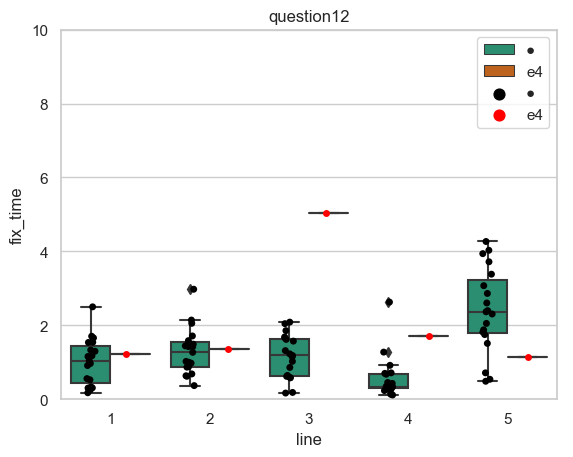

In [759]:
fix_plot3(12)

<Figure size 1000x500 with 0 Axes>

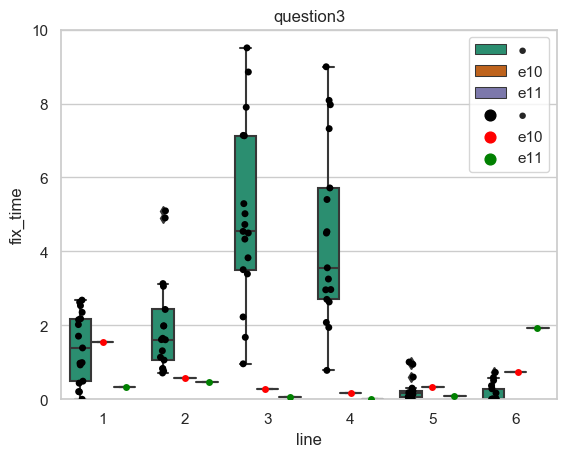

In [693]:
fix_plot3(3)

In [760]:
def fix_plot_ratio(m):#注視時間の行ごとの比較
    fig = plt.figure(figsize=(10,5))
    line = lines[m-1]
    for i in range(line):
        name1 = "d"+str(i+1)
        name2 = "e_"+str(i+1)
        name3 = "f"+str(i+1)
        gl[name1]=gl["ratio_fix_maru_"+str(m)+"_"+str(i+1)]
        gl[name2]=gl["ratio_fix_batu_"+str(m)+"_"+str(i+1)]
        gl[name3]=gl["aho_ratio_fix_batu_"+str(m)+"_"+str(i+1)]
#     print(f1)
#     name = "page_rank_"+str(m)

    plt.style.use('default')
    sns.set()
    sns.set_style('whitegrid')
    flatui = ["black", "red", "green", "#e74c3c", "#34495e", "#2ecc71"]
    sns.set_palette(flatui)
#     print(d1)
#     print(d2)


    if line == 3:
        df_batu = pd.DataFrame({
            '1': e_1,'2': e_2,'3':e_3})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3})
    elif line == 4:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4})
    elif line == 5:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5})
    elif line == 6:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6})
    elif line == 7:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6,'7':e_7})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6,'7':d7})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6,'7':f7})
   

    # merge the two data frames to one data frame
    dfTa_melt = pd.melt(df_batu)
    dfTa_melt['species'] = 'e3'
    dfAt_melt = pd.melt(df_maru)
    dfAt_melt['species'] = '●'
    dfe7_melt = pd.melt(df_e7)
    dfe7_melt['species'] = 'e7'
    df = pd.concat([dfAt_melt, dfTa_melt], axis=0)
#     df = pd.concat([df, dfe7_melt], axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    sns.boxplot(x='variable', y='value', data=df, hue='species', palette='Dark2', ax=ax)
    sns.stripplot(x='variable', y='value', data=df, hue='species', dodge=True, jitter=True,  ax=ax)


    ax.set_xlabel('line')
    ax.set_ylabel('fix_time_ratio')
    ax.set_ylim(0, 1)
    ax.legend()
    plt.title("question"+str(m))
    plt.show()

<Figure size 1000x500 with 0 Axes>

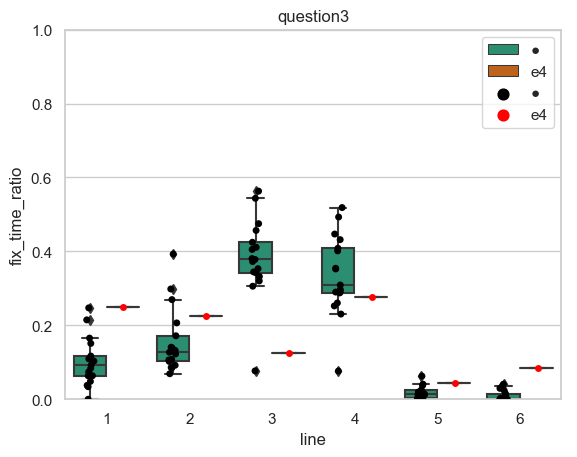

<Figure size 1000x500 with 0 Axes>

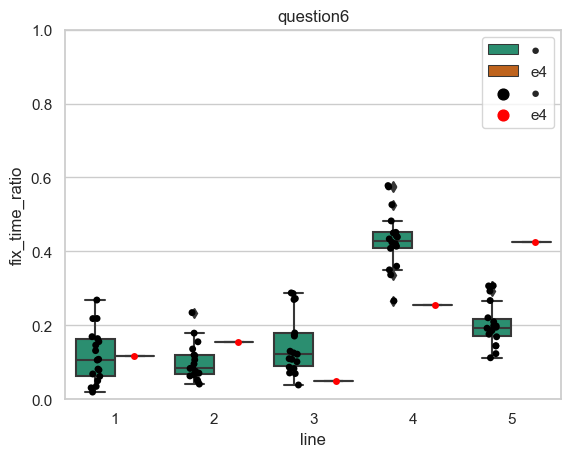

<Figure size 1000x500 with 0 Axes>

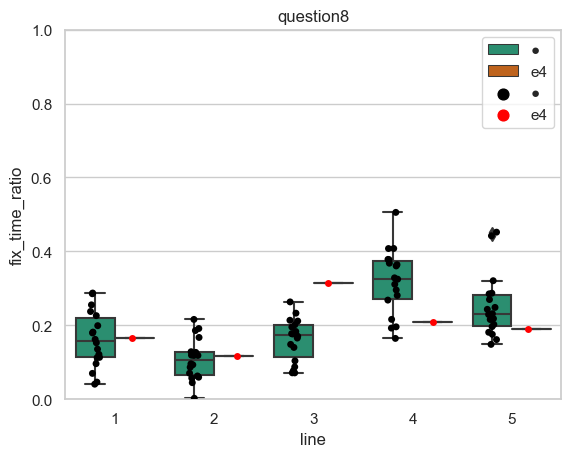

<Figure size 1000x500 with 0 Axes>

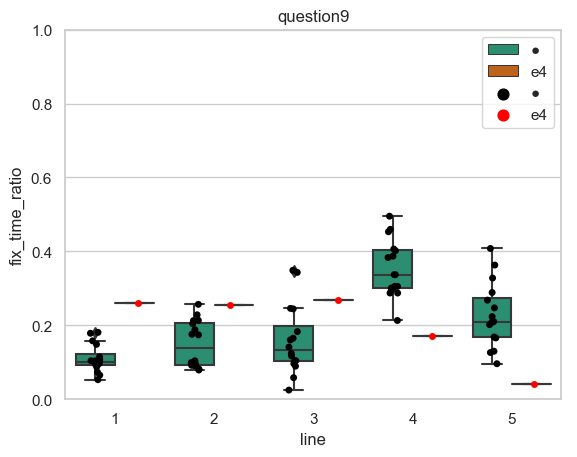

<Figure size 1000x500 with 0 Axes>

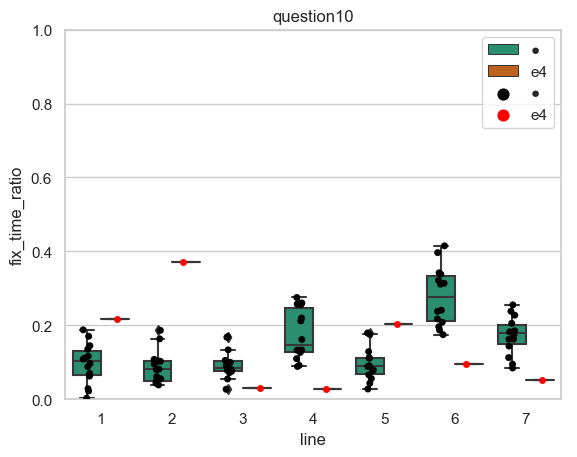

In [767]:
fix_plot_ratio(3)
fix_plot_ratio(6)
fix_plot_ratio(8)
fix_plot_ratio(9)
fix_plot_ratio(10)

<Figure size 1000x500 with 0 Axes>

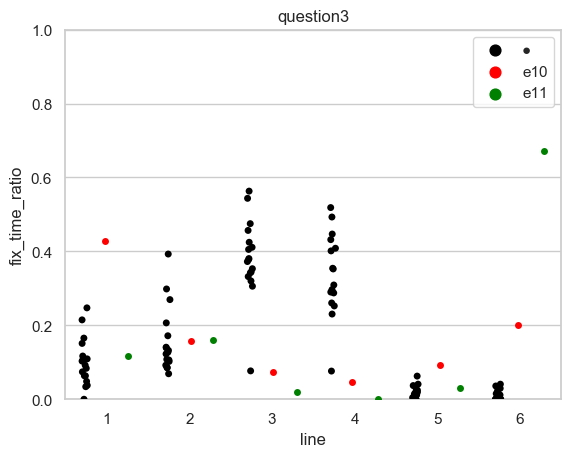

In [691]:
fix_plot_ratio(3)

<Figure size 1000x500 with 0 Axes>

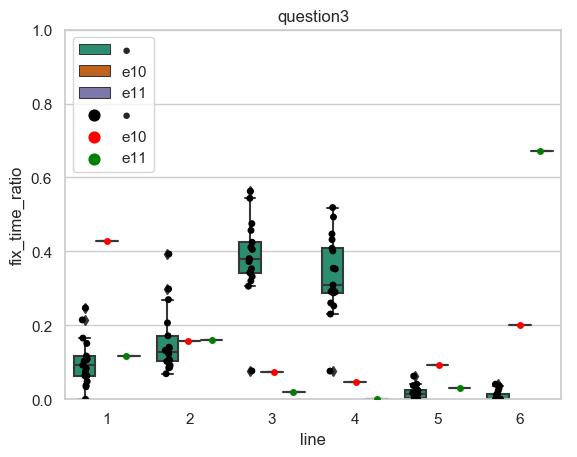

In [695]:
fix_plot_ratio(3)

In [122]:
from scipy import stats

In [156]:
def kentei_fix_marubatu(m,k):   #fix_timeのの検定
    A = gl["fix_maru_"+str(m)+"_"+str(k)]
    B = gl["fix_batu_"+str(m)+"_"+str(k)]
    A_var = np.var(A, ddof=1)  # Aの不偏分散
    B_var = np.var(B, ddof=1)  # Bの不偏分散
    A_df = len(A) - 1  # Aの自由度
    B_df = len(B) - 1  # Bの自由度
    f = A_var / B_var  # F比の値
    one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
    one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
    two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

#     print('F:       ', round(f, 3))
#     print('p-value: ', round(two_sided_pval, 3))
    if round(two_sided_pval, 3)<0.05:
        x,y=stats.ttest_ind(A, B, equal_var=False)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散ではない)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散ではない)")
    else:
        x,y=stats.ttest_ind(A, B)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散)")

In [172]:
def kentei_fix_marubatu_ratio(m,k):   #fix_timeのの検定
    A = gl["ratio_fix_maru_"+str(m)+"_"+str(k)]
    B = gl["ratio_fix_batu_"+str(m)+"_"+str(k)]
    A_var = np.var(A, ddof=1)  # Aの不偏分散
    B_var = np.var(B, ddof=1)  # Bの不偏分散
    A_df = len(A) - 1  # Aの自由度
    B_df = len(B) - 1  # Bの自由度
    f = A_var / B_var  # F比の値
    one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
    one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
    two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

#     print('F:       ', round(f, 3))
#     print('p-value: ', round(two_sided_pval, 3))
    if round(two_sided_pval, 3)<0.05:
        x,y=stats.ttest_ind(A, B, equal_var=False)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散ではない)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散ではない)")
    else:
        x,y=stats.ttest_ind(A, B)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散)")

In [1847]:
def kentei_tioari(A,B):
    x,y=stats.ttest_rel(A, B)
    if y<0.05:
            print("有意差あり、p値は",y)
    else:
            print("有意差なし")

In [630]:
def kentei_page_rank_answer_time(m,k):   #page_rankのまるばつ用の検定
    A = gl["answer_time<15_maru_"+str(m)+"_"+str(k)]
    B = gl["answer_time<30_maru_"+str(m)+"_"+str(k)]
    A_var = np.var(A, ddof=1)  # Aの不偏分散
    B_var = np.var(B, ddof=1)  # Bの不偏分散
    A_df = len(A) - 1  # Aの自由度
    B_df = len(B) - 1  # Bの自由度
    f = A_var / B_var  # F比の値
    one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
    one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
    two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

#     print('F:       ', round(f, 3))
#     print('p-value: ', round(two_sided_pval, 3))
    if round(two_sided_pval, 3)<0.05:
        x,y=stats.ttest_ind(A, B, equal_var=False)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散ではない)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散ではない)")
    else:
        x,y=stats.ttest_ind(A, B)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散)")

In [637]:
def kentei_fix_answer_time(m,k):   #page_rankのまるばつ用の検定
    A = gl["time<10_maru_"+str(m)+"_"+str(k)]
    B = gl["time10<20_maru_"+str(m)+"_"+str(k)]
    A_var = np.var(A, ddof=1)  # Aの不偏分散
    B_var = np.var(B, ddof=1)  # Bの不偏分散
    A_df = len(A) - 1  # Aの自由度
    B_df = len(B) - 1  # Bの自由度
    f = A_var / B_var  # F比の値
    one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
    one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
    two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

#     print('F:       ', round(f, 3))
#     print('p-value: ', round(two_sided_pval, 3))
    if round(two_sided_pval, 3)<0.05:
        x,y=stats.ttest_ind(A, B, equal_var=False)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散ではない)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散ではない)")
    else:
        x,y=stats.ttest_ind(A, B)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散)")

In [643]:
def kentei_fix_ratio_answer_time(m,k):   #page_rankのまるばつ用の検定
    A = gl["ratio_time<10_maru_"+str(m)+"_"+str(k)]
    B = gl["ratio_time10<20_maru_"+str(m)+"_"+str(k)]
    A_var = np.var(A, ddof=1)  # Aの不偏分散
    B_var = np.var(B, ddof=1)  # Bの不偏分散
    A_df = len(A) - 1  # Aの自由度
    B_df = len(B) - 1  # Bの自由度
    f = A_var / B_var  # F比の値
    one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
    one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
    two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

#     print('F:       ', round(f, 3))
#     print('p-value: ', round(two_sided_pval, 3))
    if round(two_sided_pval, 3)<0.05:
        x,y=stats.ttest_ind(A, B, equal_var=False)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散ではない)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散ではない)")
    else:
        x,y=stats.ttest_ind(A, B)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散)")

In [147]:
def kentei(m,k):   #page_rankのまるばつ用の検定
    A = gl["maru_"+str(m)+"_"+str(k)]
    B = gl["batu_"+str(m)+"_"+str(k)]
    A_var = np.var(A, ddof=1)  # Aの不偏分散
    B_var = np.var(B, ddof=1)  # Bの不偏分散
    A_df = len(A) - 1  # Aの自由度
    B_df = len(B) - 1  # Bの自由度
    f = A_var / B_var  # F比の値
    one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
    one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
    two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

#     print('F:       ', round(f, 3))
#     print('p-value: ', round(two_sided_pval, 3))
    if round(two_sided_pval, 3)<0.05:
        x,y=stats.ttest_ind(A, B, equal_var=False)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散ではない)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散ではない)")
    else:
        x,y=stats.ttest_ind(A, B)
        if y<0.05:
            print(str(m)+"の"+str(k)+"行目は有意差あり(等分散)、p値は",y)
        else:
            print(str(m)+"の"+str(k)+"行目は有意差なし(等分散)")

In [1698]:
def kentei_r(m,k):   #page_rankのまるばつ用の検定   自分でデータ指定
    A =m
    B = k
    A_var = np.var(A, ddof=1)  # Aの不偏分散
    B_var = np.var(B, ddof=1)  # Bの不偏分散
    A_df = len(A) - 1  # Aの自由度
    B_df = len(B) - 1  # Bの自由度
    f = A_var / B_var  # F比の値
    one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
    one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
    two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

#     print('F:       ', round(f, 3))
#     print('p-value: ', round(two_sided_pval, 3))
    if round(two_sided_pval, 3)<0.05:
        x,y=stats.ttest_ind(A, B, equal_var=False)
        if y<0.05:
            print("有意差あり(等分散ではない)、p値は",y)
        else:
            print("有意差なし(等分散ではない)")
    else:
        x,y=stats.ttest_ind(A, B)
        if y<0.05:
            print("有意差あり(等分散)、p値は",y)
        else:
            print("有意差なし(等分散)")

In [1829]:
# np.std(maru_3_3)
print(str(np.mean(a))+"±"+str(np.std(a)))
print(str(np.mean(b))+"±"+str(np.std(b)))

3.0759915604859276±1.2834534169690357
2.1108972440189535±2.010121900021533


In [1828]:
a = fix_maru_11_5
b = [fix_batu_11_5[1],fix_batu_11_5[4]]
kentei_r(a,b)
# kentei_fix_marubatu(a,b)

有意差なし(等分散)


In [631]:
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei_page_rank_answer_time(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散)
2の1行目は有意差なし(等分散)
2の2行目は有意差なし(等分散)
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差あり(等分散)、p値は 0.015269513120117846
3の2行目は有意差なし(等分散)
3の3行目は有意差なし(等分散)
3の4行目は有意差なし(等分散ではない)
3の5行目は有意差なし(等分散)
3の6行目は有意差なし(等分散)
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差なし(等分散)
6の4行目は有意差なし(等分散)
6の5行目は有意差なし(等分散)
7の1行目は有意差なし(等分散)
7の2行目は有意差なし(等分散)
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差なし(等分散)
8の3行目は有意差なし(等分散)
8の4行目は有意差なし(等分散)
8の5行目は有意差なし(等分散)
9の1行目は有意差なし(等分散)
9の2行目は有意差なし(等分散)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散)
10の3行目は有意差なし(等分散)
10の4行目は有意差なし(等分散)
10の5行目は有意差なし(等分散)
10の6行目は有意差なし(等分散)
10の7行目は有意差なし(等分散)
11の1行目は有意差なし(等分散)
11の2行目は有意差なし(等分散ではない)
11の3行目は有意差なし(等分散)
11の4行目は有意差なし(等分散)
11の5行目は有意差なし(等分散)
12の1行目は有意差なし(等分散)
12

In [638]:
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei_fix_answer_time(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散)
2の1行目は有意差あり(等分散)、p値は 0.04898937139084544
2の2行目は有意差なし(等分散ではない)
2の3行目は有意差あり(等分散)、p値は 0.0033311153073061605
2の4行目は有意差あり(等分散)、p値は 0.03593923113782708
3の1行目は有意差あり(等分散)、p値は 0.014264476868932435
3の2行目は有意差なし(等分散)
3の3行目は有意差なし(等分散)
3の4行目は有意差なし(等分散)
3の5行目は有意差なし(等分散)
3の6行目は有意差なし(等分散)
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散)
5の2行目は有意差なし(等分散)
5の3行目は有意差あり(等分散)、p値は 0.003855047992028154
5の4行目は有意差なし(等分散ではない)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差あり(等分散)、p値は 0.0082716182115327
6の4行目は有意差あり(等分散)、p値は 0.00039110679350065256
6の5行目は有意差あり(等分散)、p値は 0.018493186540887774
7の1行目は有意差なし(等分散ではない)
7の2行目は有意差なし(等分散)
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散)
7の5行目は有意差あり(等分散)、p値は 0.01489668109343345
8の1行目は有意差なし(等分散)
8の2行目は有意差なし(等分散)
8の3行目は有意差なし(等分散)
8の4行目は有意差なし(等分散)
8の5行目は有意差なし(等分散)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散)
9の3行目は有意差あり(等分散)、p値は 0.03857253145811114
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目

In [644]:
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei_fix_ratio_answer_time(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散)
2の1行目は有意差なし(等分散)
2の2行目は有意差なし(等分散)
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差あり(等分散)、p値は 0.020491601135234936
3の2行目は有意差なし(等分散)
3の3行目は有意差なし(等分散)
3の4行目は有意差なし(等分散)
3の5行目は有意差なし(等分散ではない)
3の6行目は有意差なし(等分散)
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差なし(等分散)
6の4行目は有意差なし(等分散)
6の5行目は有意差なし(等分散)
7の1行目は有意差なし(等分散ではない)
7の2行目は有意差なし(等分散)
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差なし(等分散)
8の3行目は有意差なし(等分散)
8の4行目は有意差なし(等分散)
8の5行目は有意差なし(等分散)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散)
10の3行目は有意差なし(等分散)
10の4行目は有意差なし(等分散)
10の5行目は有意差なし(等分散)
10の6行目は有意差なし(等分散)
10の7行目は有意差なし(等分散)
11の1行目は有意差なし(等分散)
11の2行目は有意差なし(等分散)
11の3行目は有意差なし(等分散)
11の4行目は有意差なし(等分散)
11の5行目は有意差なし(等分散)
12の1行目は有意差なし(等分散

In [1718]:
batu_3_4[1],batu_3_4[4]

(0.20444100285521066, 0.14568972556525364)

<Figure size 1000x500 with 0 Axes>

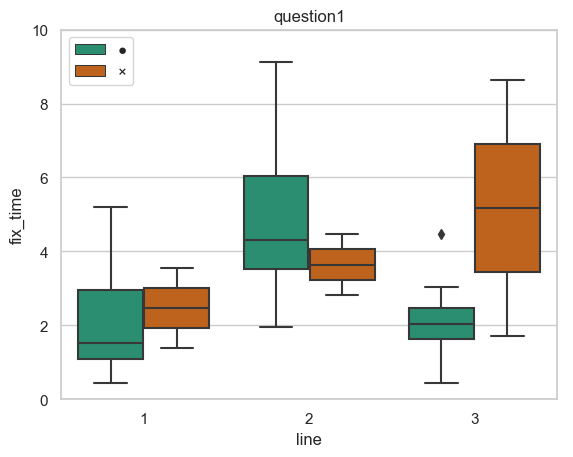

<Figure size 1000x500 with 0 Axes>

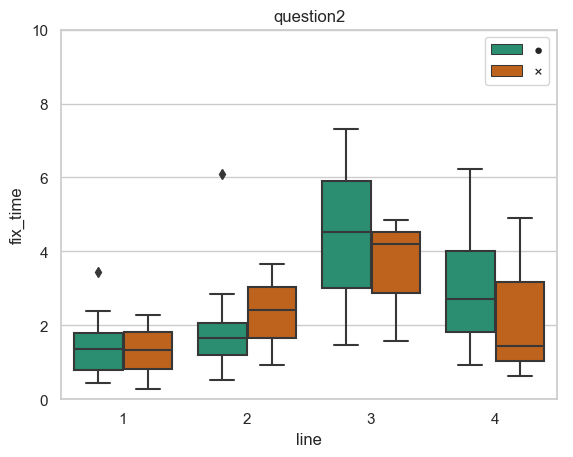

<Figure size 1000x500 with 0 Axes>

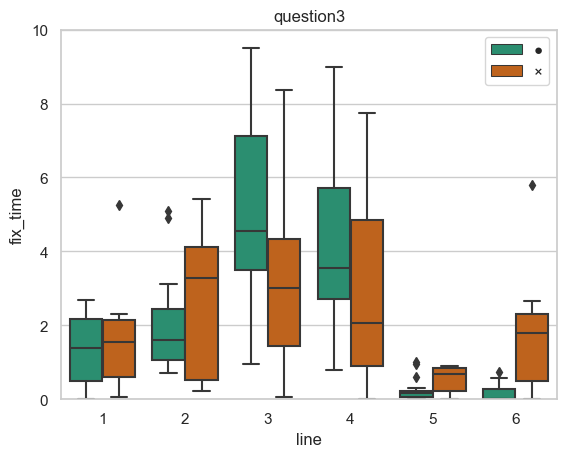

<Figure size 1000x500 with 0 Axes>

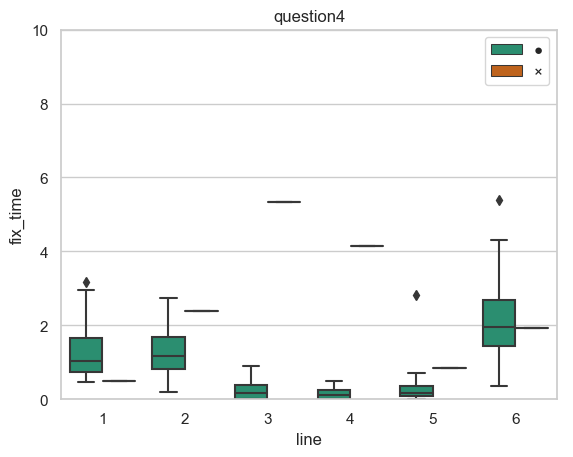

<Figure size 1000x500 with 0 Axes>

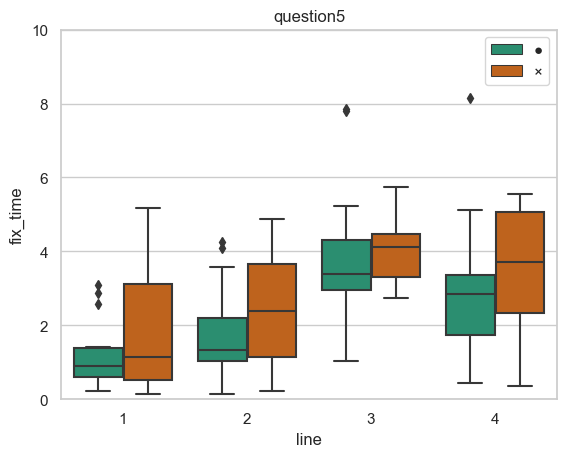

<Figure size 1000x500 with 0 Axes>

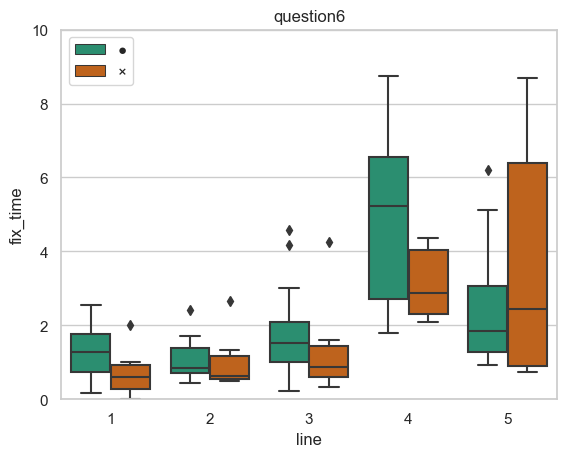

<Figure size 1000x500 with 0 Axes>

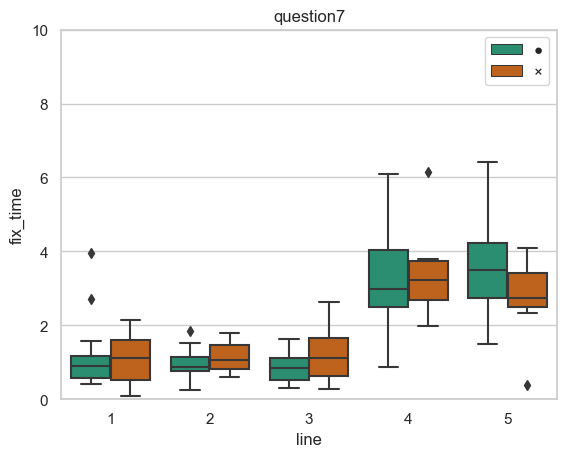

<Figure size 1000x500 with 0 Axes>

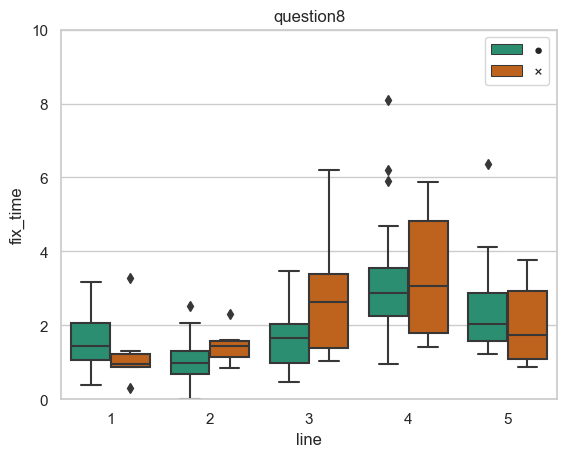

<Figure size 1000x500 with 0 Axes>

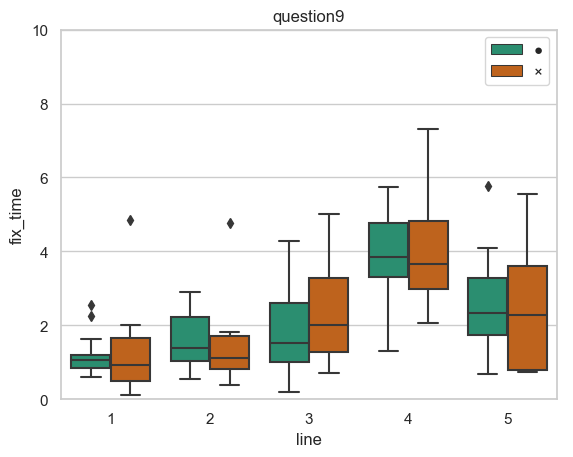

<Figure size 1000x500 with 0 Axes>

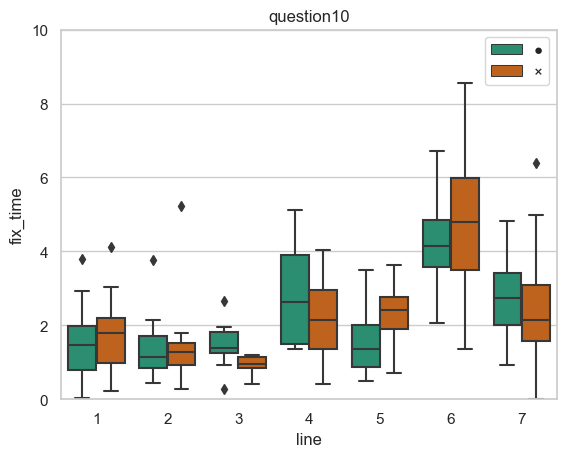

<Figure size 1000x500 with 0 Axes>

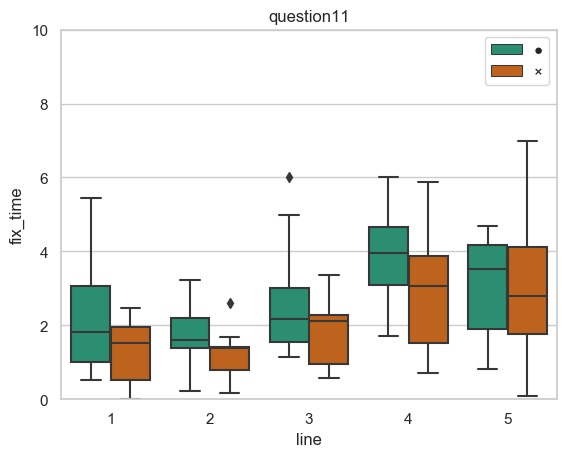

<Figure size 1000x500 with 0 Axes>

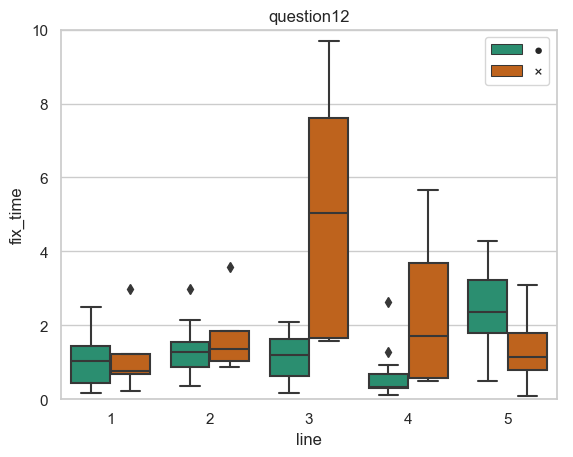

<Figure size 1000x500 with 0 Axes>

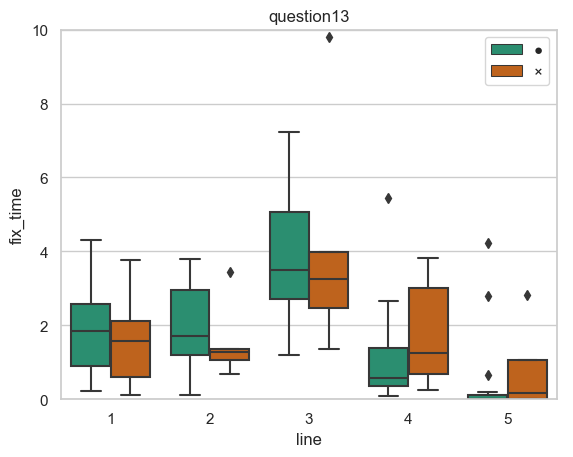

<Figure size 1000x500 with 0 Axes>

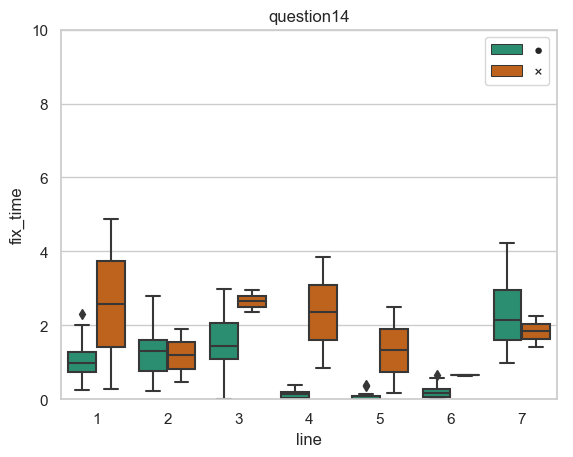

<Figure size 1000x500 with 0 Axes>

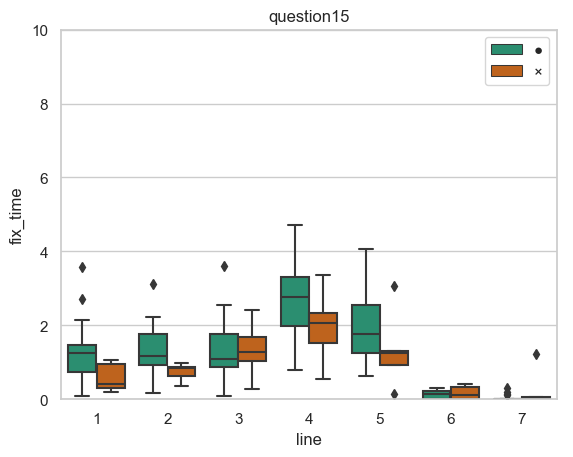

In [609]:
#注視時間の正解不正解分類
#全部込みver
for i in range(1,16):
    fix_plot3(i)

In [610]:
#全部込みver
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei_fix_marubatu(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散ではない)
2の1行目は有意差なし(等分散)
2の2行目は有意差なし(等分散)
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差なし(等分散ではない)
3の2行目は有意差なし(等分散)
3の3行目は有意差なし(等分散)
3の4行目は有意差なし(等分散)
3の5行目は有意差なし(等分散)
3の6行目は有意差なし(等分散ではない)
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散ではない)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差なし(等分散)
6の4行目は有意差なし(等分散)
6の5行目は有意差なし(等分散ではない)
7の1行目は有意差なし(等分散)
7の2行目は有意差なし(等分散)
7の3行目は有意差なし(等分散ではない)
7の4行目は有意差なし(等分散)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差なし(等分散)
8の3行目は有意差なし(等分散ではない)
8の4行目は有意差なし(等分散)
8の5行目は有意差なし(等分散)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散ではない)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散)
10の3行目は有意差あり(等分散ではない)、p値は 0.00458075959568901
10の4行目は有意差なし(等分散)
10の5行目は有意差なし(等分散)
10の6行目は有意差なし(等分散ではない)
10の7行目は有意差なし(等分散ではない)
11の1行目は有意差なし(等分散)
11の2行目は有意差なし(等分散)
11の3行目は有意差なし(等分散)
11の4行目は有意差なし(等分散)

<Figure size 1000x500 with 0 Axes>

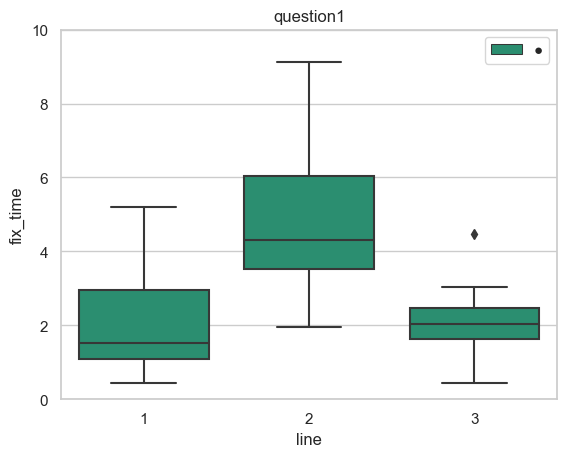

<Figure size 1000x500 with 0 Axes>

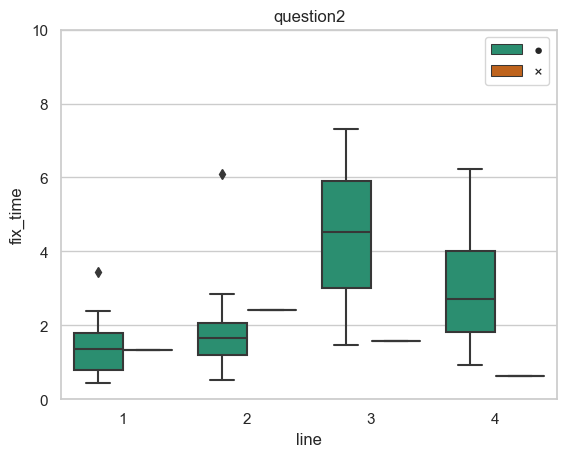

<Figure size 1000x500 with 0 Axes>

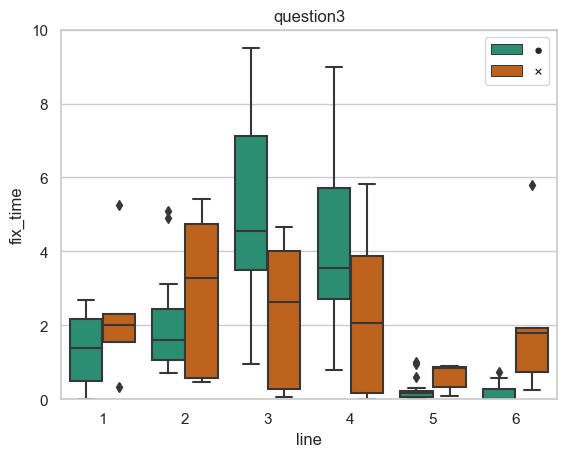

<Figure size 1000x500 with 0 Axes>

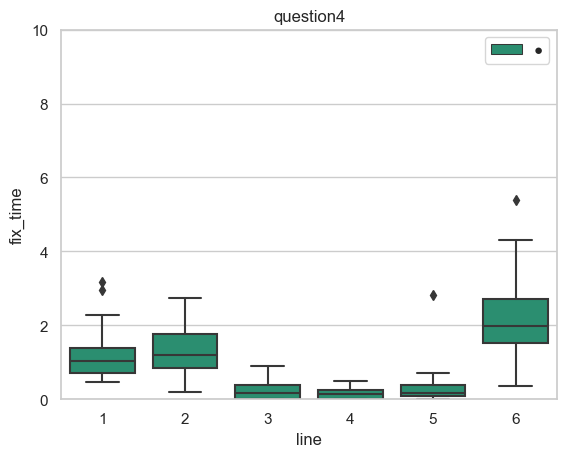

<Figure size 1000x500 with 0 Axes>

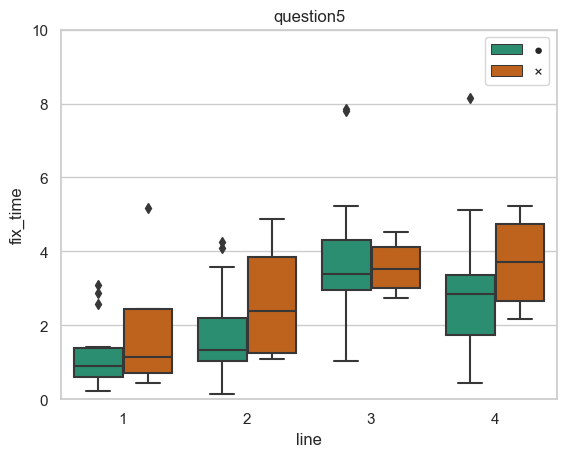

<Figure size 1000x500 with 0 Axes>

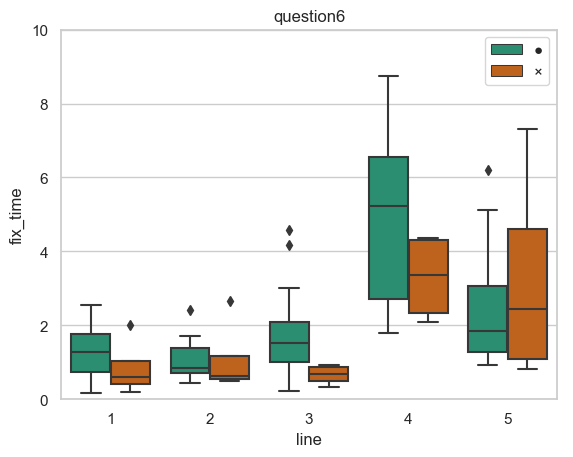

<Figure size 1000x500 with 0 Axes>

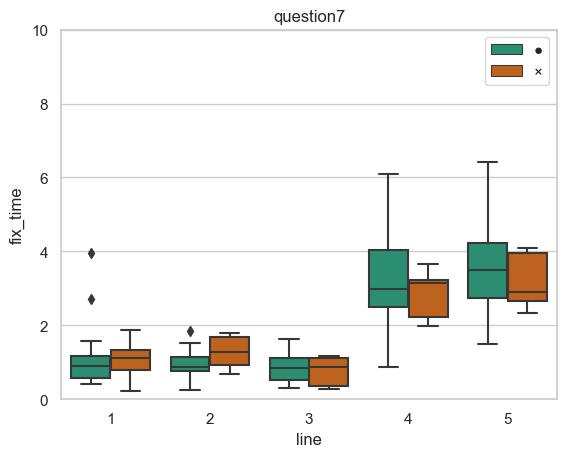

<Figure size 1000x500 with 0 Axes>

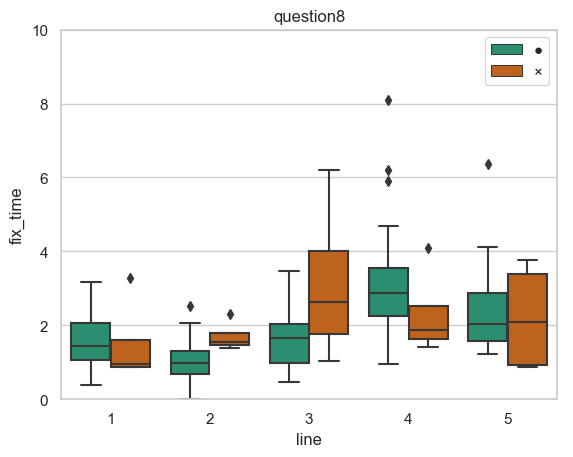

<Figure size 1000x500 with 0 Axes>

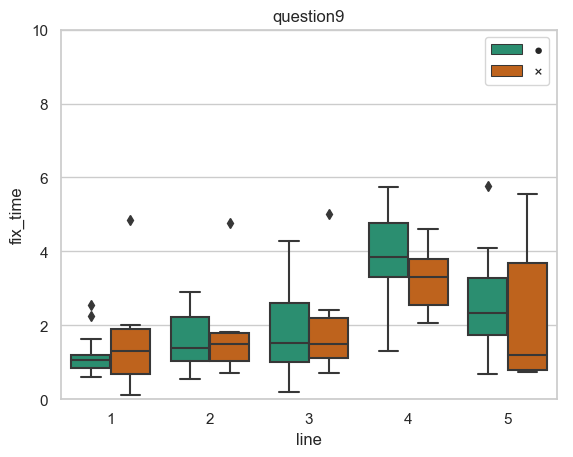

<Figure size 1000x500 with 0 Axes>

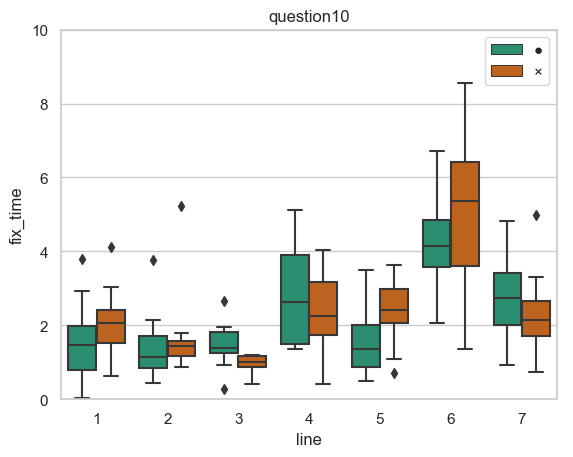

<Figure size 1000x500 with 0 Axes>

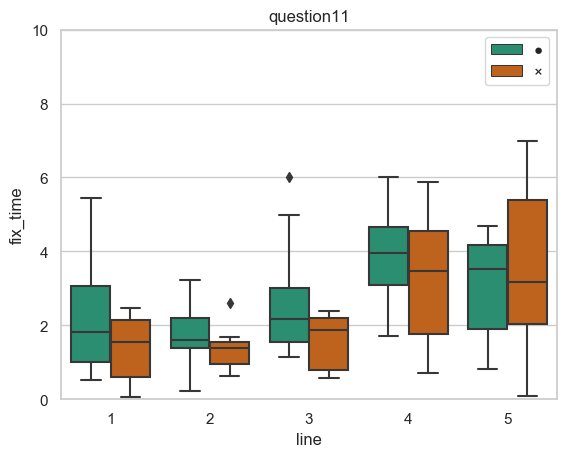

<Figure size 1000x500 with 0 Axes>

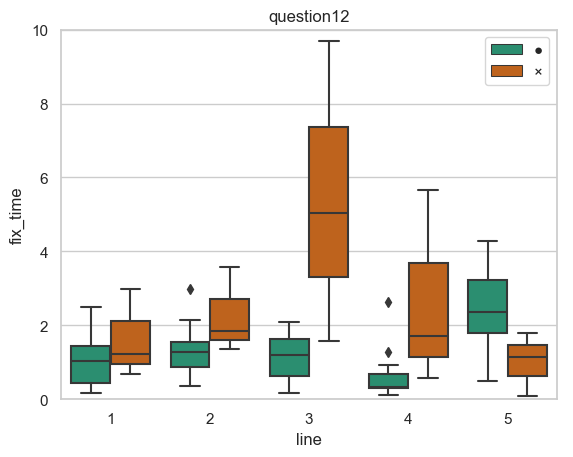

<Figure size 1000x500 with 0 Axes>

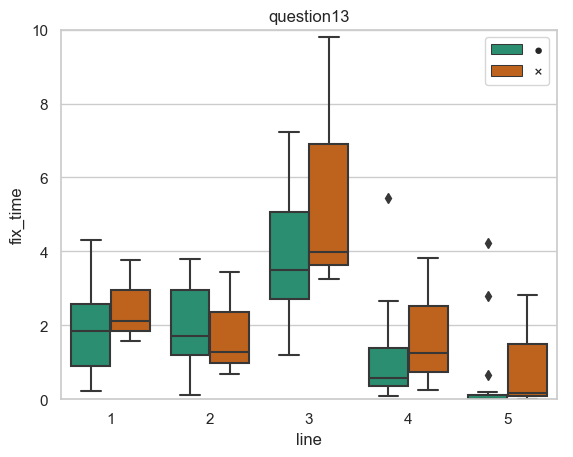

<Figure size 1000x500 with 0 Axes>

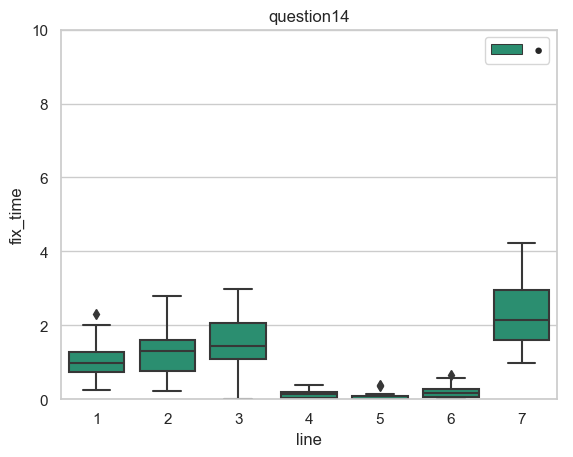

<Figure size 1000x500 with 0 Axes>

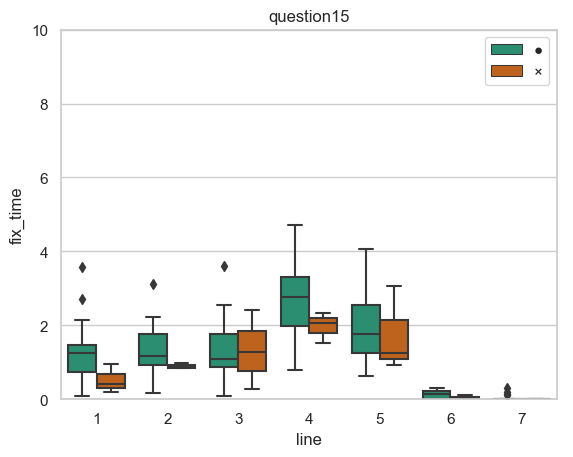

<Figure size 1000x500 with 0 Axes>

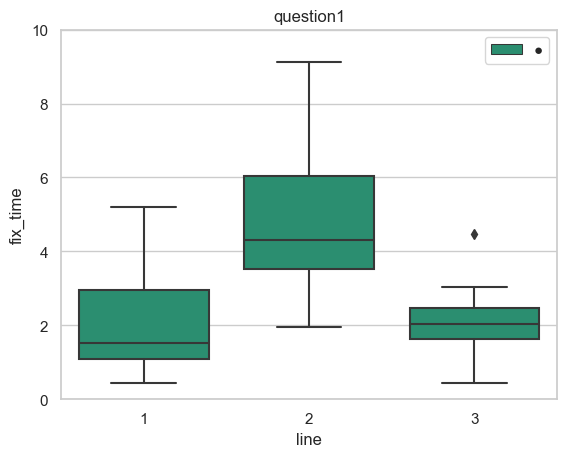

<Figure size 1000x500 with 0 Axes>

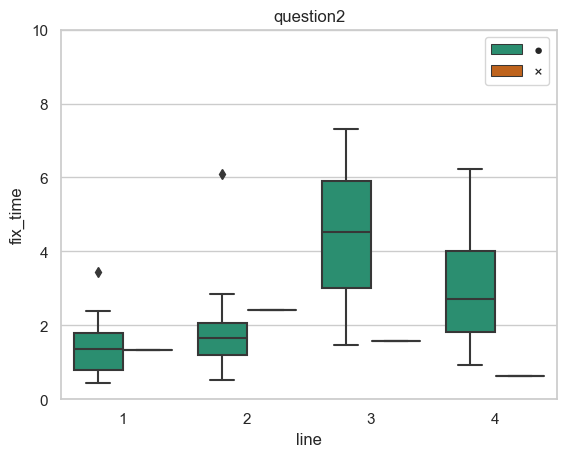

<Figure size 1000x500 with 0 Axes>

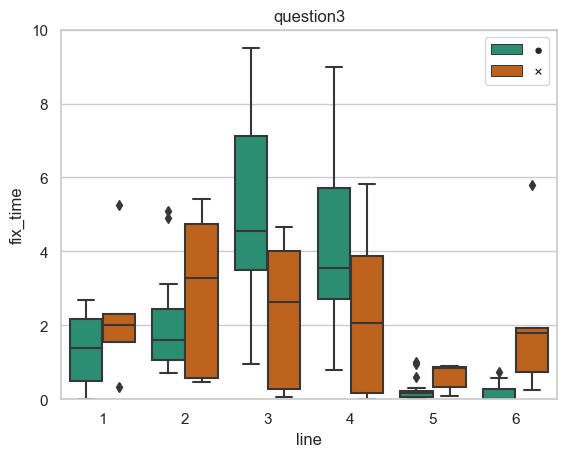

<Figure size 1000x500 with 0 Axes>

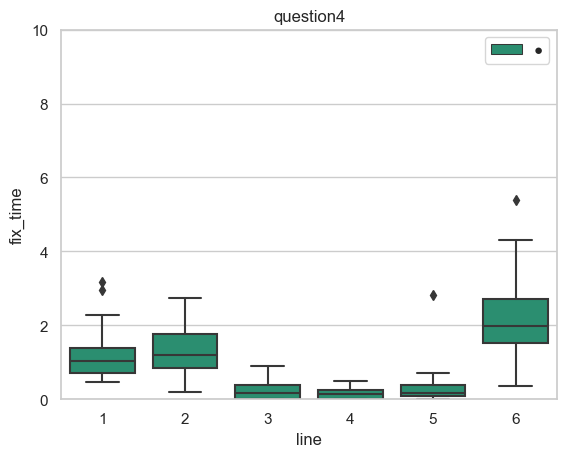

<Figure size 1000x500 with 0 Axes>

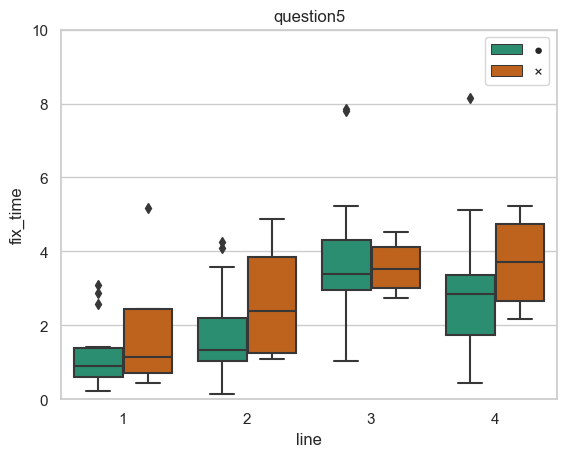

<Figure size 1000x500 with 0 Axes>

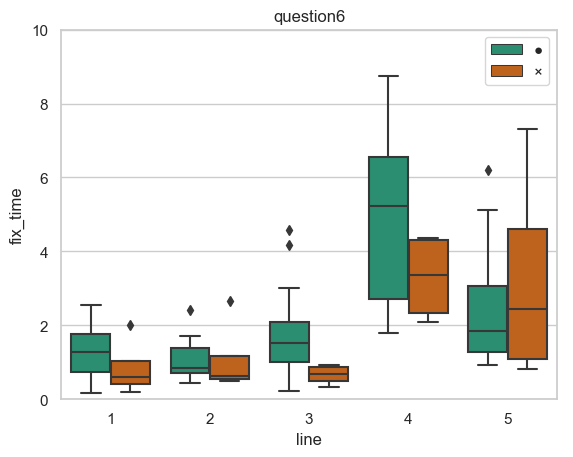

<Figure size 1000x500 with 0 Axes>

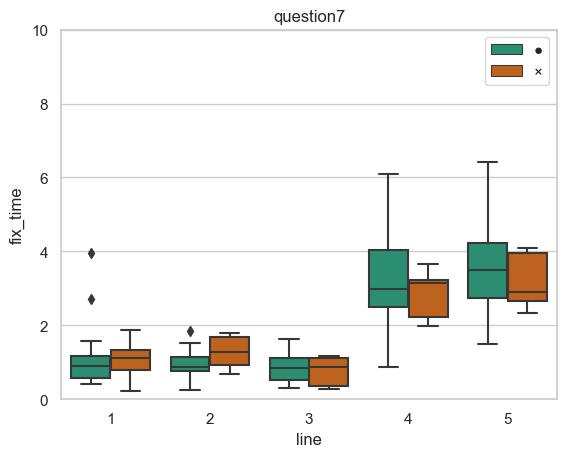

<Figure size 1000x500 with 0 Axes>

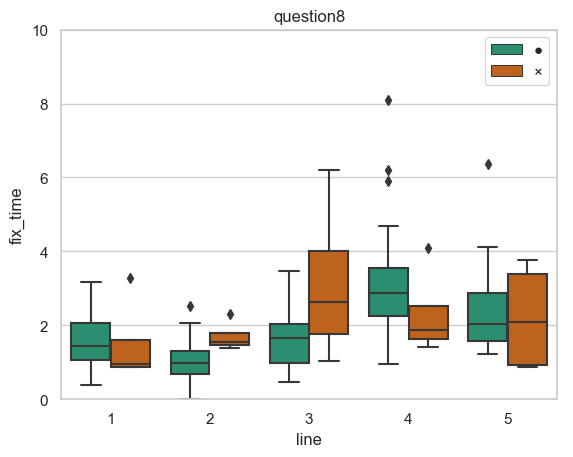

<Figure size 1000x500 with 0 Axes>

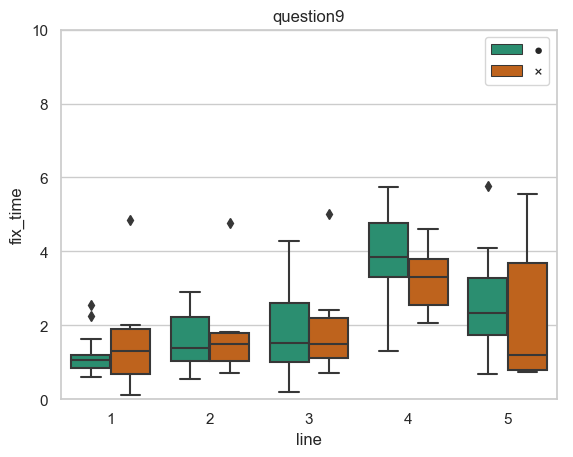

<Figure size 1000x500 with 0 Axes>

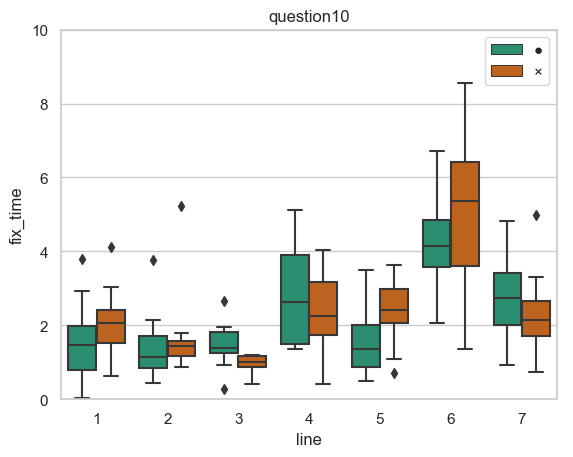

<Figure size 1000x500 with 0 Axes>

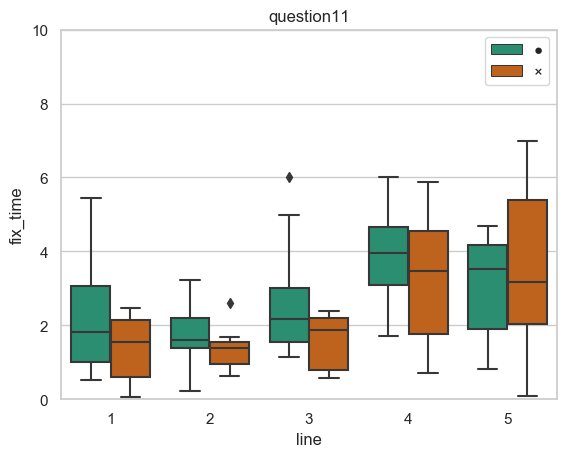

<Figure size 1000x500 with 0 Axes>

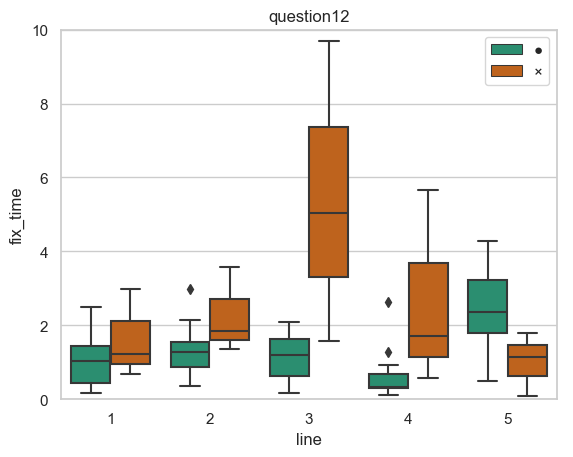

<Figure size 1000x500 with 0 Axes>

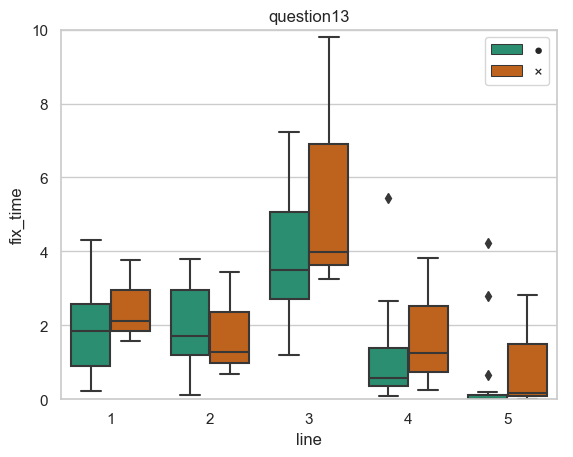

<Figure size 1000x500 with 0 Axes>

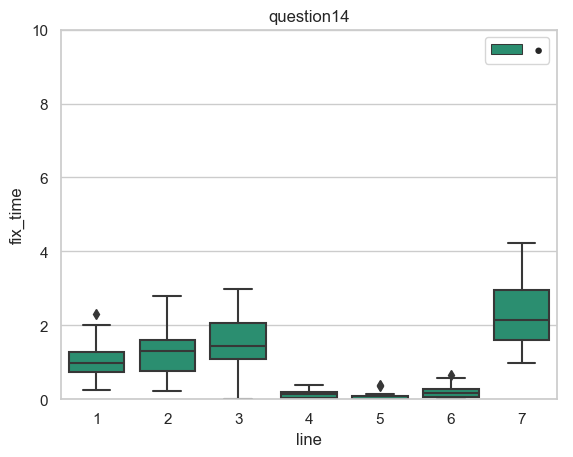

<Figure size 1000x500 with 0 Axes>

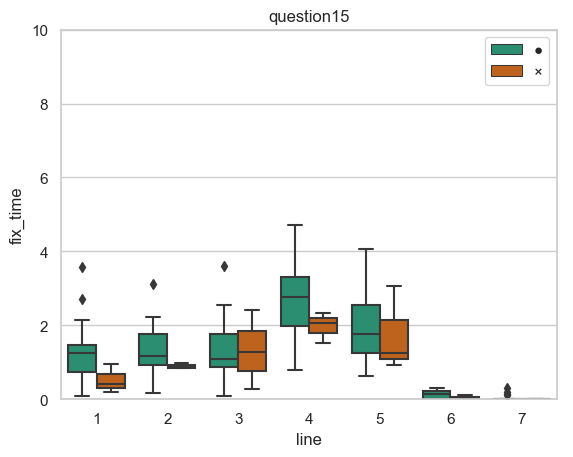

In [618]:
#注視時間の正解不正解分類
#1,#注視時間の正解不正解分類
#1,7除くver
for i in range(1,16):
    fix_plot3(i)
for i in range(1,16):
    fix_plot3(i)

In [619]:
#1,7除くver
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei_fix_marubatu(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散)
2の1行目は有意差なし(等分散)
2の2行目は有意差なし(等分散)
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差なし(等分散)
3の2行目は有意差なし(等分散)
3の3行目は有意差あり(等分散)、p値は 0.04026207618383031
3の4行目は有意差なし(等分散)
3の5行目は有意差あり(等分散)、p値は 0.04293212517180297
3の6行目は有意差なし(等分散ではない)
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散ではない)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散ではない)
6の3行目は有意差あり(等分散ではない)、p値は 0.0021476286800489086
6の4行目は有意差なし(等分散)
6の5行目は有意差なし(等分散)
7の1行目は有意差なし(等分散)
7の2行目は有意差なし(等分散)
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差なし(等分散)
8の3行目は有意差なし(等分散ではない)
8の4行目は有意差なし(等分散)
8の5行目は有意差なし(等分散)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散ではない)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散)
10の3行目は有意差あり(等分散)、p値は 0.02543959946776213
10の4行目は有意差なし(等分散)
10の5行目は有意差なし(等分散)
10の6行目は有意差なし(等分散ではない)
10の7行目は有意差なし(等分散)
11の1行目は有意差なし(

<Figure size 1000x500 with 0 Axes>

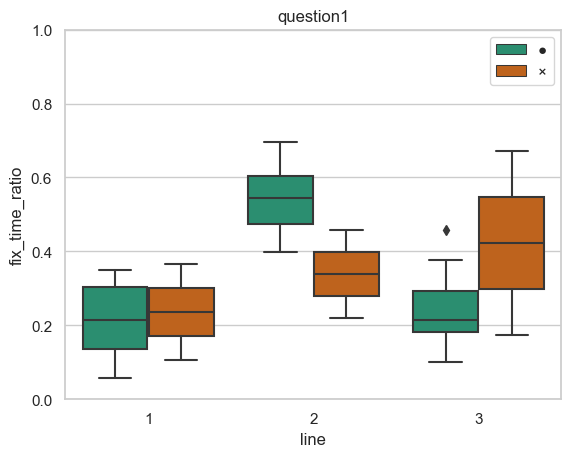

<Figure size 1000x500 with 0 Axes>

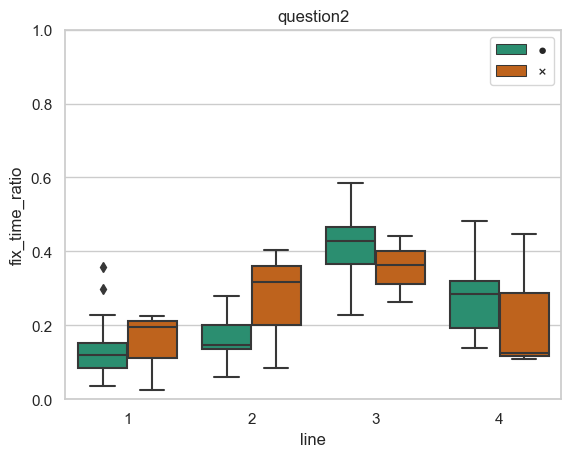

<Figure size 1000x500 with 0 Axes>

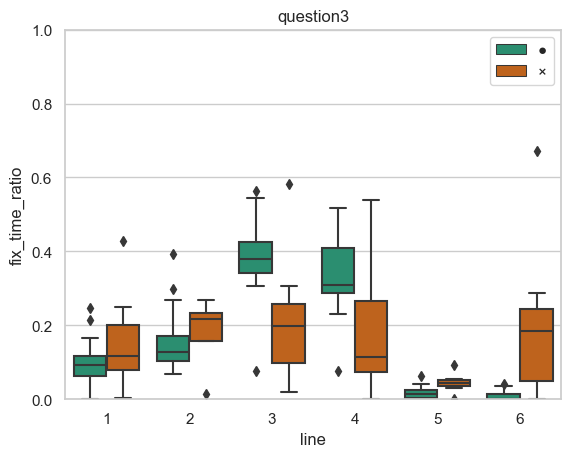

<Figure size 1000x500 with 0 Axes>

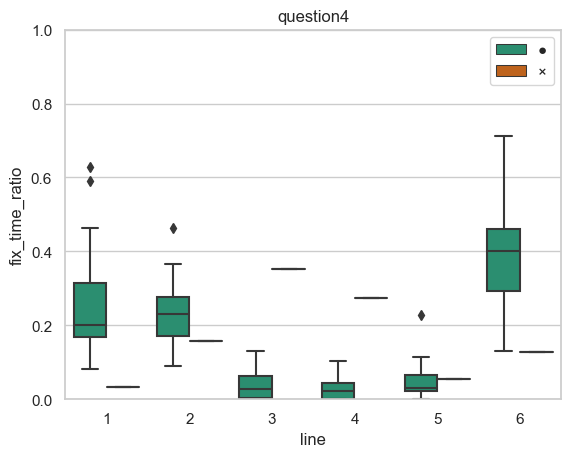

<Figure size 1000x500 with 0 Axes>

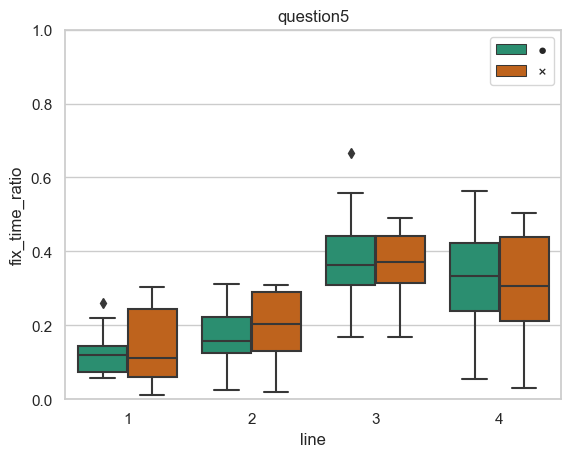

<Figure size 1000x500 with 0 Axes>

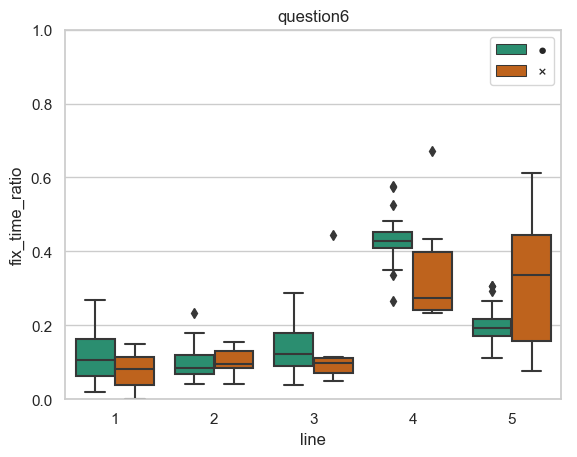

<Figure size 1000x500 with 0 Axes>

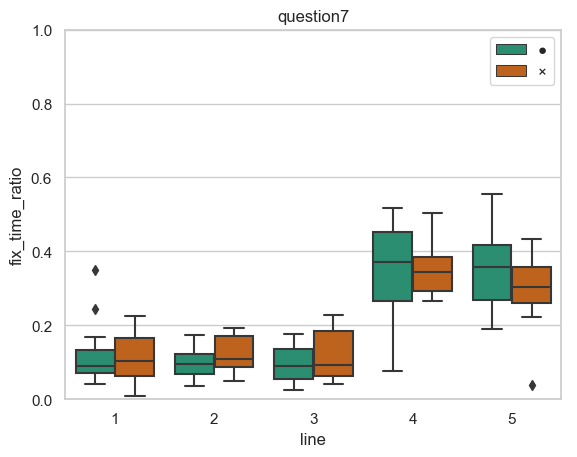

<Figure size 1000x500 with 0 Axes>

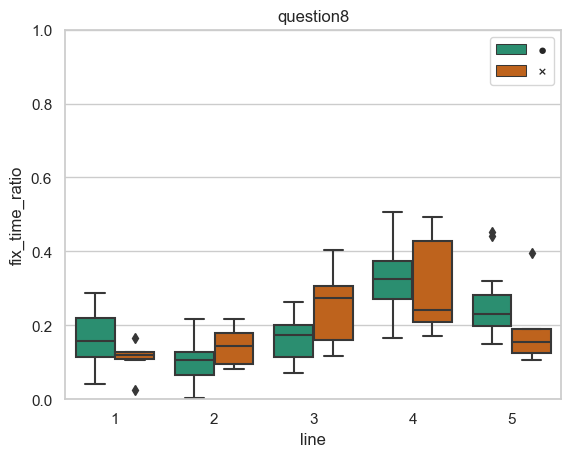

<Figure size 1000x500 with 0 Axes>

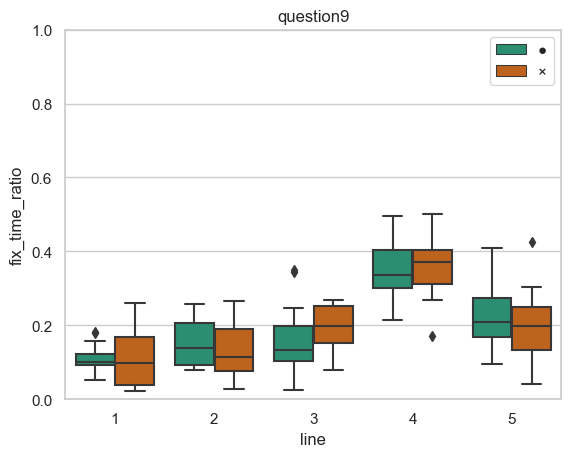

<Figure size 1000x500 with 0 Axes>

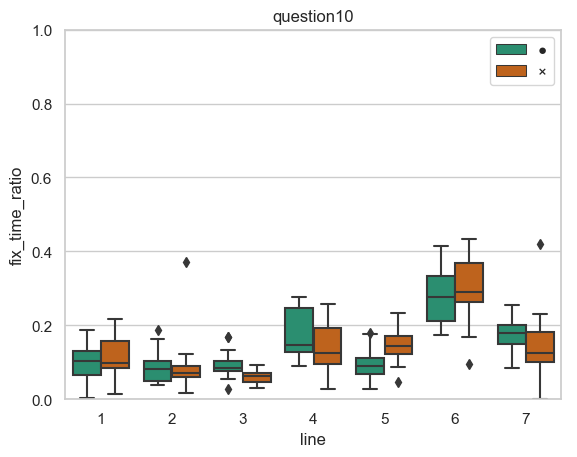

<Figure size 1000x500 with 0 Axes>

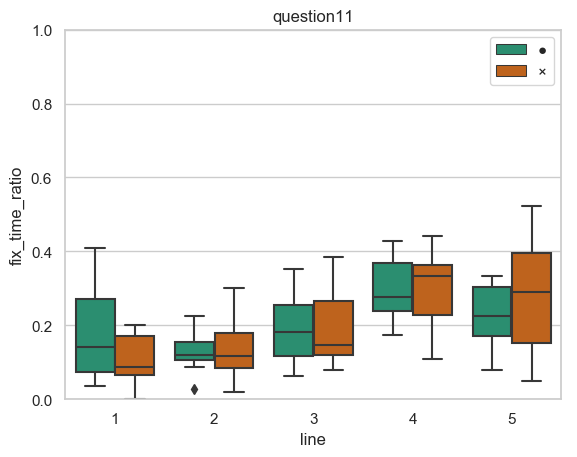

<Figure size 1000x500 with 0 Axes>

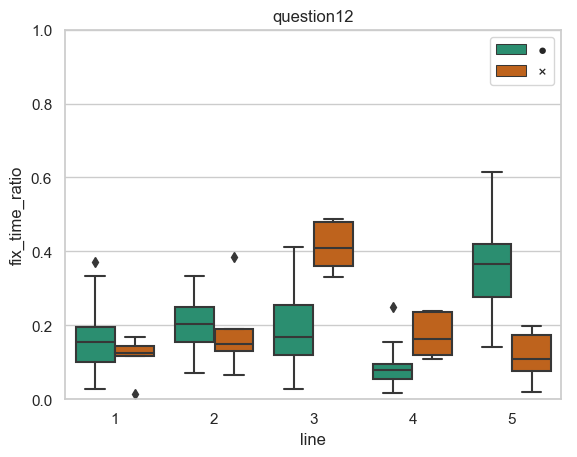

<Figure size 1000x500 with 0 Axes>

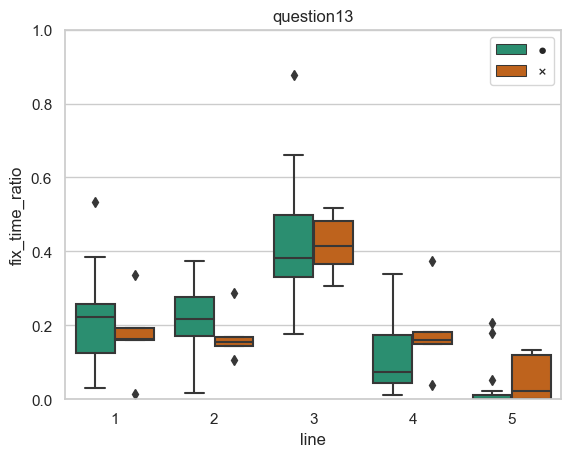

<Figure size 1000x500 with 0 Axes>

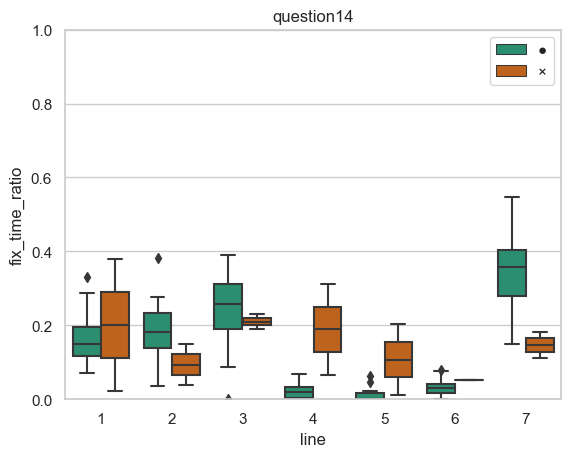

<Figure size 1000x500 with 0 Axes>

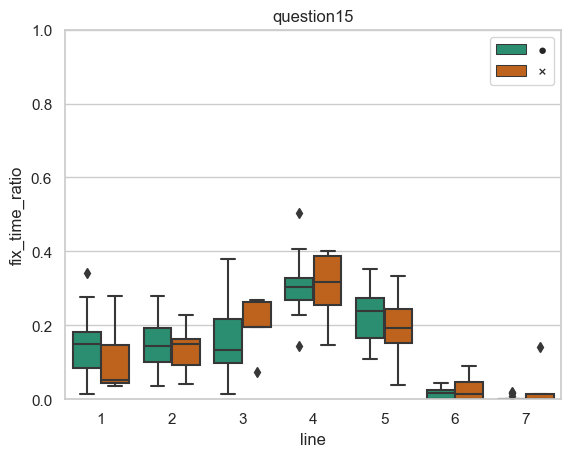

In [612]:
#注視時間の正解不正解分類
#全部込みver
for i in range(1,16):
    fix_plot_ratio(i)

In [621]:
#全部込みver
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei_fix_marubatu_ratio(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散)
2の1行目は有意差なし(等分散)
2の2行目は有意差なし(等分散)
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差なし(等分散ではない)
3の2行目は有意差なし(等分散)
3の3行目は有意差あり(等分散)、p値は 0.000356817964020658
3の4行目は有意差あり(等分散)、p値は 0.0022491834960494464
3の5行目は有意差あり(等分散)、p値は 0.0010984358182264732
3の6行目は有意差なし(等分散ではない)
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差なし(等分散)
6の4行目は有意差なし(等分散ではない)
6の5行目は有意差なし(等分散ではない)
7の1行目は有意差なし(等分散)
7の2行目は有意差あり(等分散)、p値は 0.04891466482781361
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差あり(等分散)、p値は 0.044261526671310045
8の3行目は有意差なし(等分散ではない)
8の4行目は有意差あり(等分散)、p値は 0.035501596941136124
8の5行目は有意差なし(等分散)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散ではない)
10の3行目は有意差あり(等分散)、p値は 0.02501228505760974
10の4行目は有意差なし

<Figure size 1000x500 with 0 Axes>

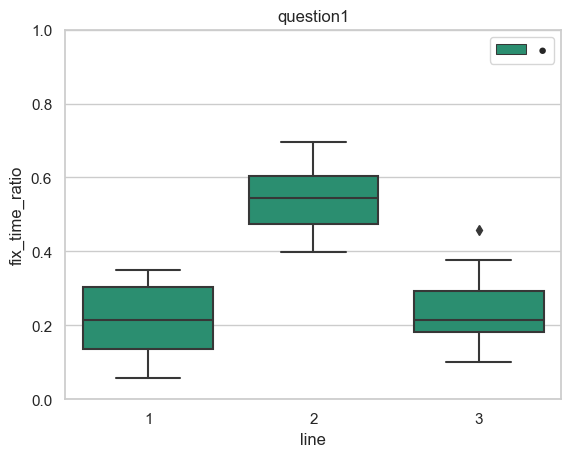

<Figure size 1000x500 with 0 Axes>

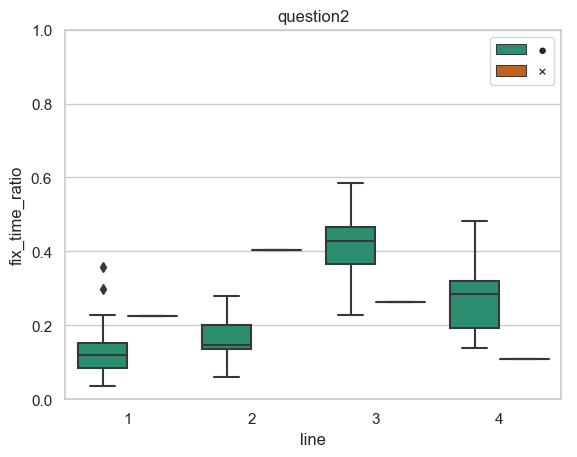

<Figure size 1000x500 with 0 Axes>

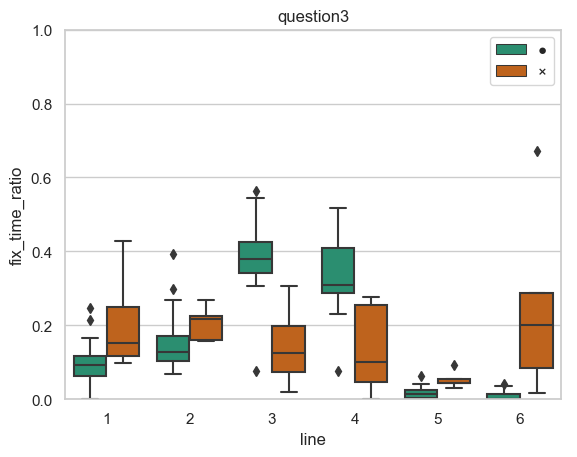

<Figure size 1000x500 with 0 Axes>

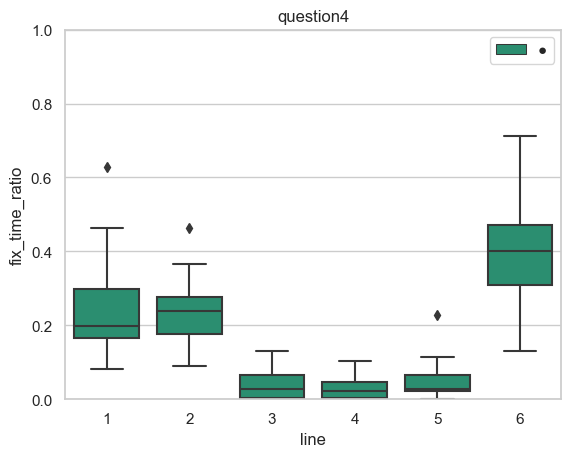

<Figure size 1000x500 with 0 Axes>

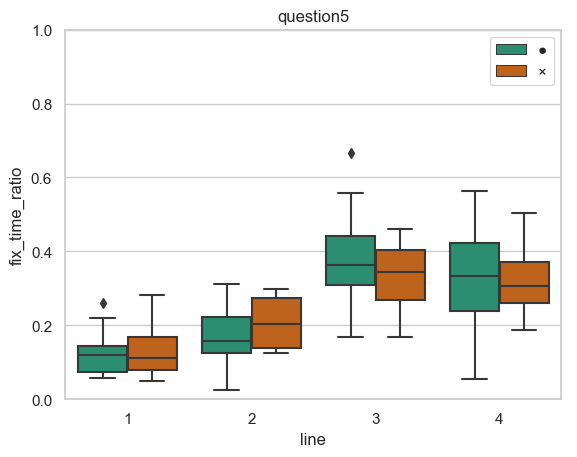

<Figure size 1000x500 with 0 Axes>

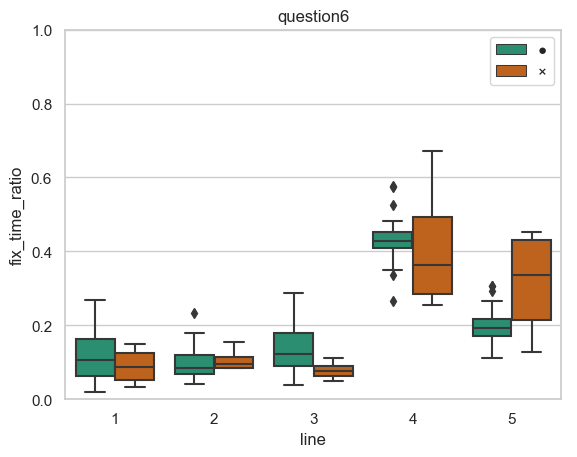

<Figure size 1000x500 with 0 Axes>

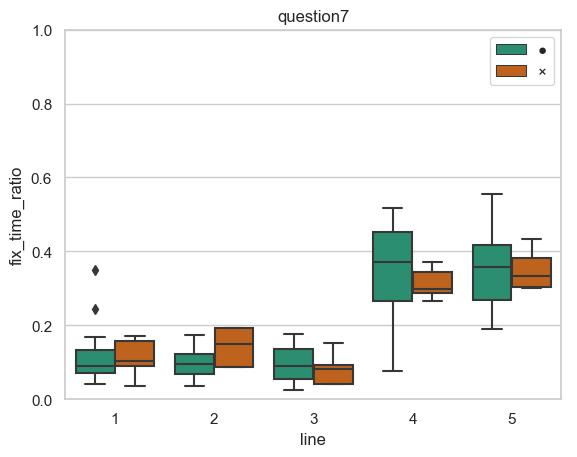

<Figure size 1000x500 with 0 Axes>

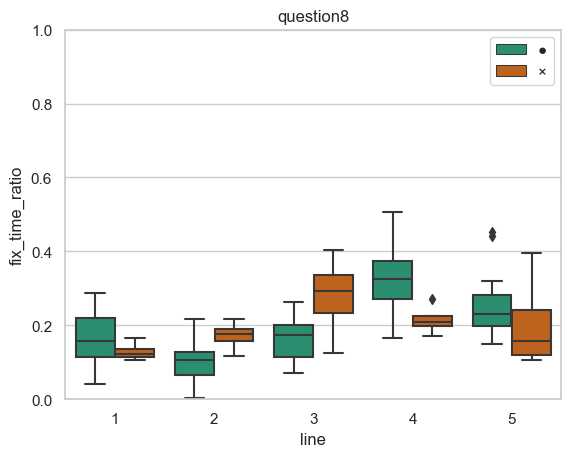

<Figure size 1000x500 with 0 Axes>

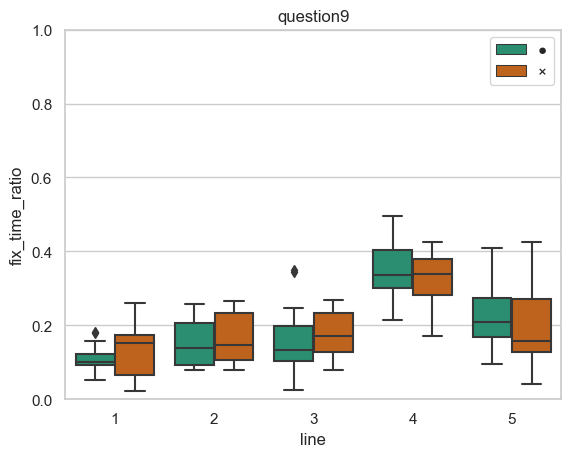

<Figure size 1000x500 with 0 Axes>

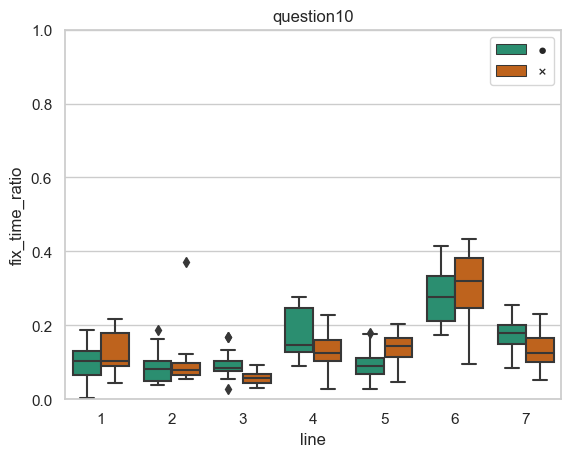

<Figure size 1000x500 with 0 Axes>

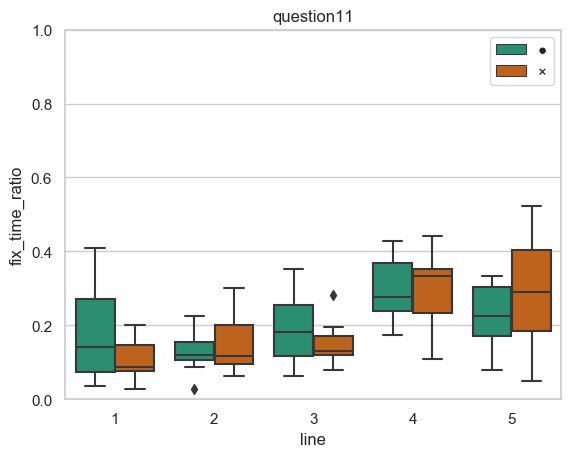

<Figure size 1000x500 with 0 Axes>

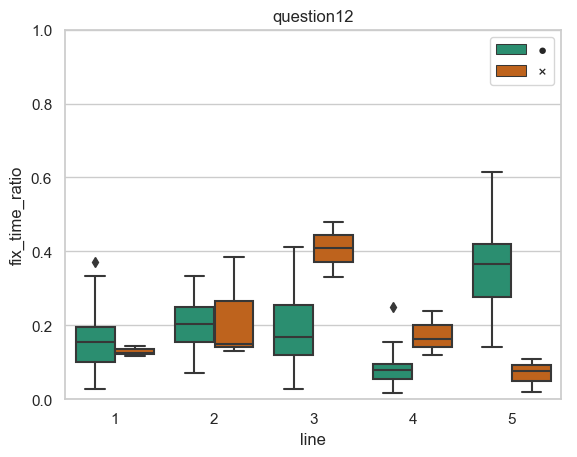

<Figure size 1000x500 with 0 Axes>

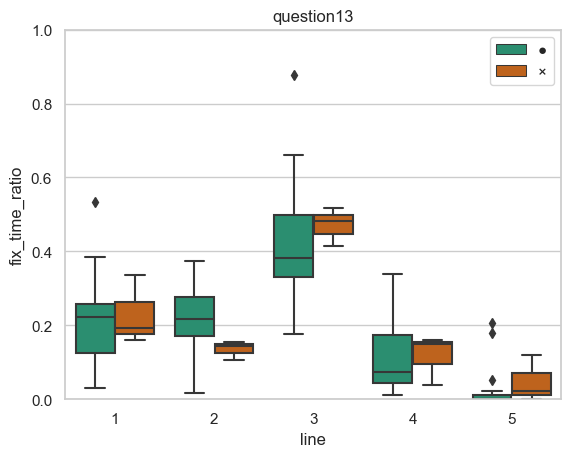

<Figure size 1000x500 with 0 Axes>

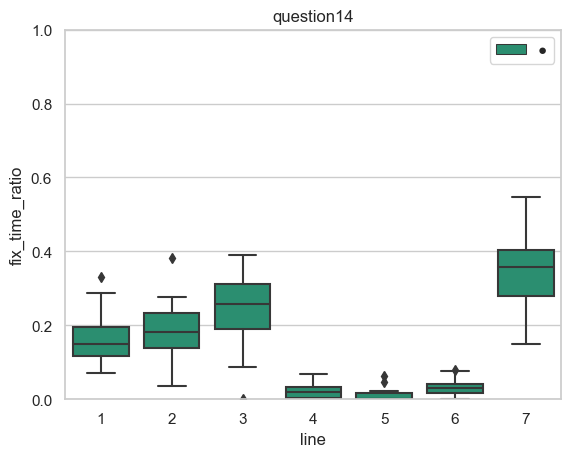

<Figure size 1000x500 with 0 Axes>

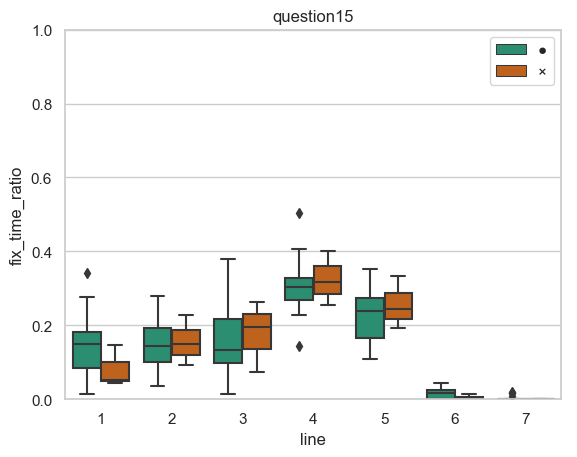

In [620]:
#注視時間の正解不正解分類
#1,7除くver
for i in range(1,16):
    fix_plot_ratio(i)

In [308]:
len(fix_batu_15_1)

3

In [230]:
#1,7除くver
for i in range(1,16):
    line=lines[i-1]
    for j in range(1,line+1):
        kentei_fix_marubatu_ratio(i,j)

1の1行目は有意差なし(等分散)
1の2行目は有意差なし(等分散)
1の3行目は有意差なし(等分散)
2の1行目は有意差なし(等分散)
2の2行目は有意差なし(等分散)
2の3行目は有意差なし(等分散)
2の4行目は有意差なし(等分散)
3の1行目は有意差なし(等分散ではない)
3の2行目は有意差なし(等分散)
3の3行目は有意差あり(等分散)、p値は 0.000356817964020658
3の4行目は有意差あり(等分散)、p値は 0.0022491834960494464
3の5行目は有意差あり(等分散)、p値は 0.0010984358182264732
3の6行目は有意差なし(等分散ではない)
4の1行目は有意差なし(等分散)
4の2行目は有意差なし(等分散)
4の3行目は有意差なし(等分散)
4の4行目は有意差なし(等分散)
4の5行目は有意差なし(等分散)
4の6行目は有意差なし(等分散)
5の1行目は有意差なし(等分散)
5の2行目は有意差なし(等分散)
5の3行目は有意差なし(等分散)
5の4行目は有意差なし(等分散)
6の1行目は有意差なし(等分散)
6の2行目は有意差なし(等分散)
6の3行目は有意差なし(等分散)
6の4行目は有意差なし(等分散ではない)
6の5行目は有意差なし(等分散ではない)
7の1行目は有意差なし(等分散)
7の2行目は有意差あり(等分散)、p値は 0.04891466482781361
7の3行目は有意差なし(等分散)
7の4行目は有意差なし(等分散)
7の5行目は有意差なし(等分散)
8の1行目は有意差なし(等分散)
8の2行目は有意差あり(等分散)、p値は 0.044261526671310045
8の3行目は有意差なし(等分散ではない)
8の4行目は有意差あり(等分散)、p値は 0.035501596941136124
8の5行目は有意差なし(等分散)
9の1行目は有意差なし(等分散ではない)
9の2行目は有意差なし(等分散)
9の3行目は有意差なし(等分散)
9の4行目は有意差なし(等分散)
9の5行目は有意差なし(等分散)
10の1行目は有意差なし(等分散)
10の2行目は有意差なし(等分散ではない)
10の3行目は有意差あり(等分散)、p値は 0.032793866606159135
10の4行目は有意差な

<Figure size 1000x500 with 0 Axes>

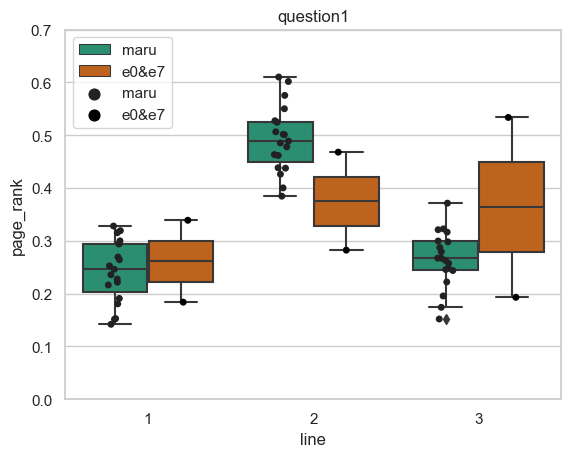

<Figure size 1000x500 with 0 Axes>

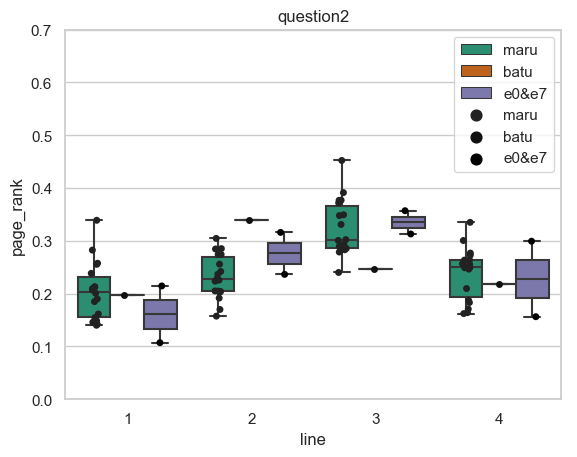

<Figure size 1000x500 with 0 Axes>

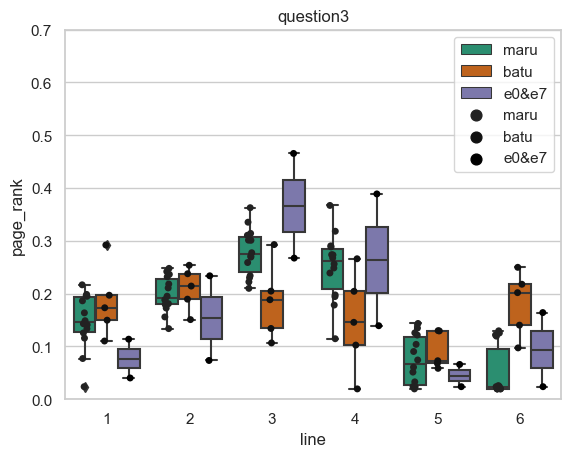

<Figure size 1000x500 with 0 Axes>

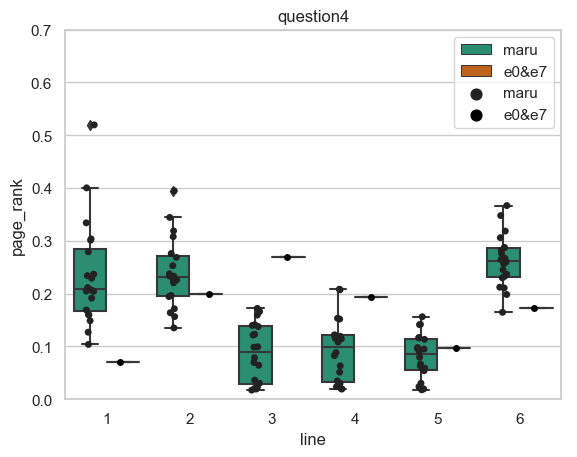

<Figure size 1000x500 with 0 Axes>

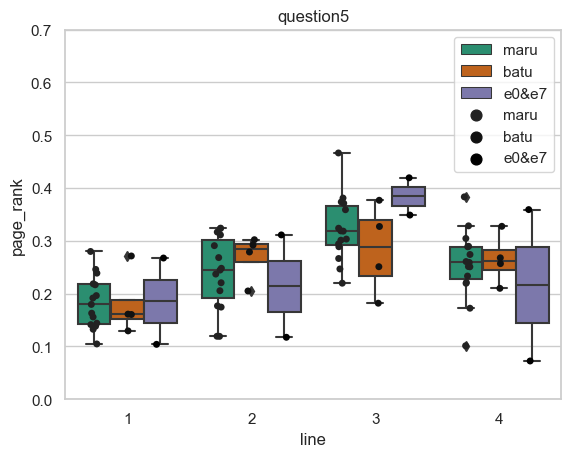

<Figure size 1000x500 with 0 Axes>

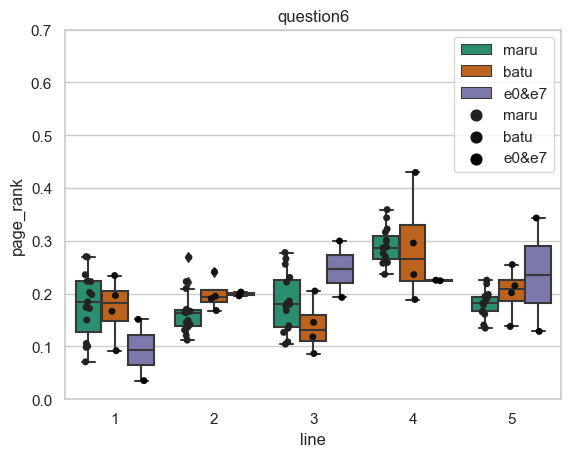

<Figure size 1000x500 with 0 Axes>

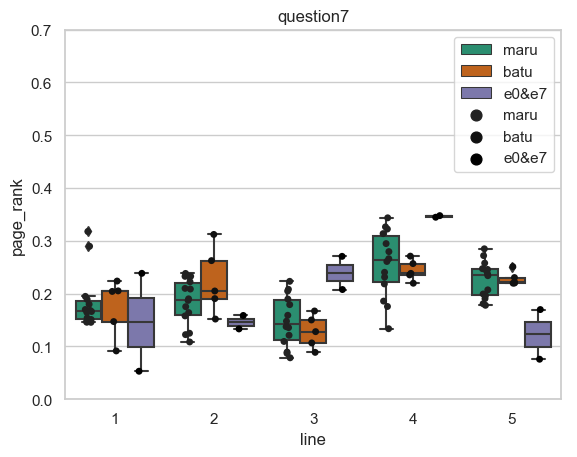

<Figure size 1000x500 with 0 Axes>

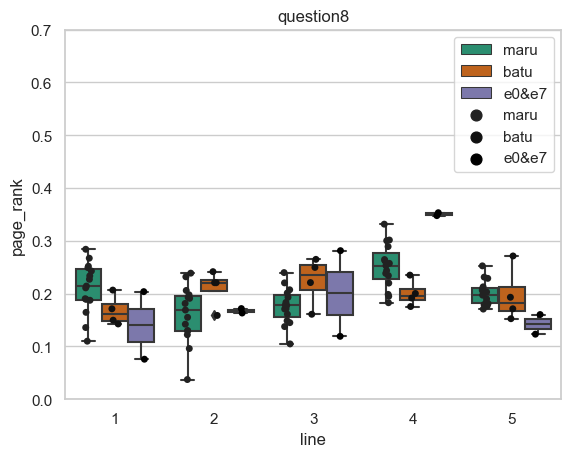

<Figure size 1000x500 with 0 Axes>

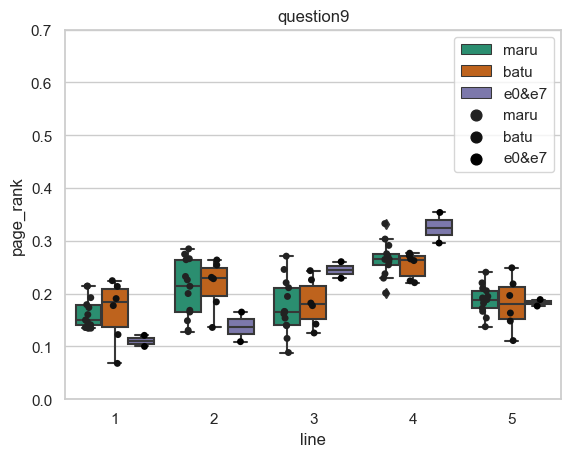

<Figure size 1000x500 with 0 Axes>

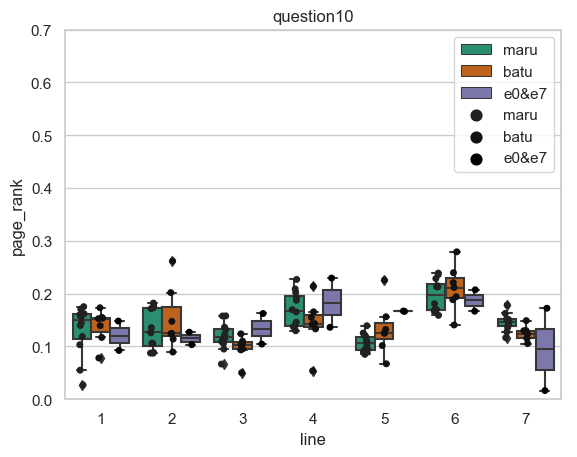

<Figure size 1000x500 with 0 Axes>

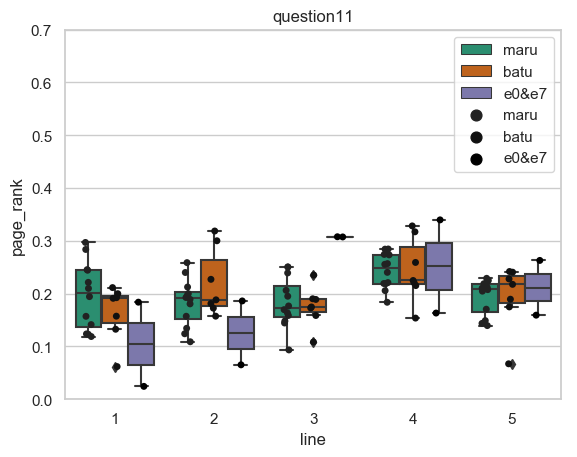

<Figure size 1000x500 with 0 Axes>

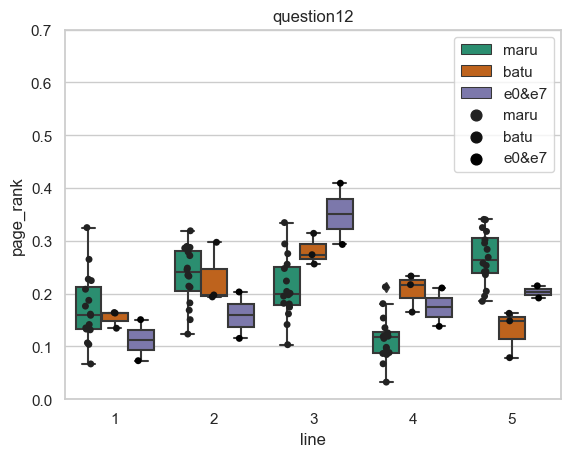

<Figure size 1000x500 with 0 Axes>

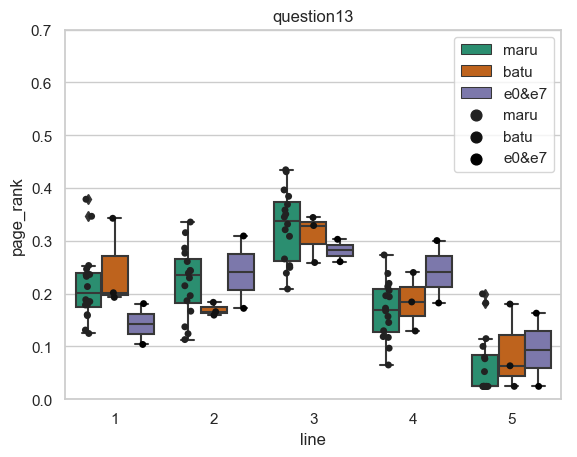

<Figure size 1000x500 with 0 Axes>

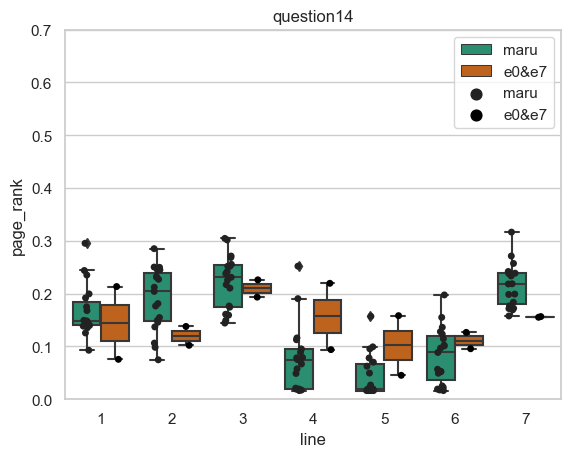

<Figure size 1000x500 with 0 Axes>

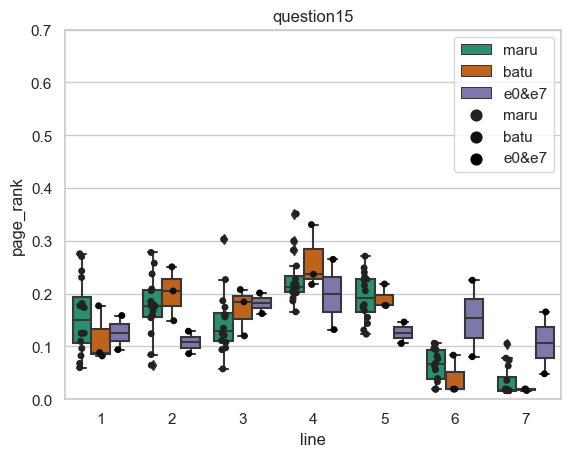

In [1590]:
#重要度の正解不正解分類
for i in range(1,16):
    page_rank_plot3(i)

In [2036]:
kentei_tioari(maru_15_6,maru_15_7)

有意差あり、p値は 0.006639639877738594


2 20


<Figure size 1000x500 with 0 Axes>

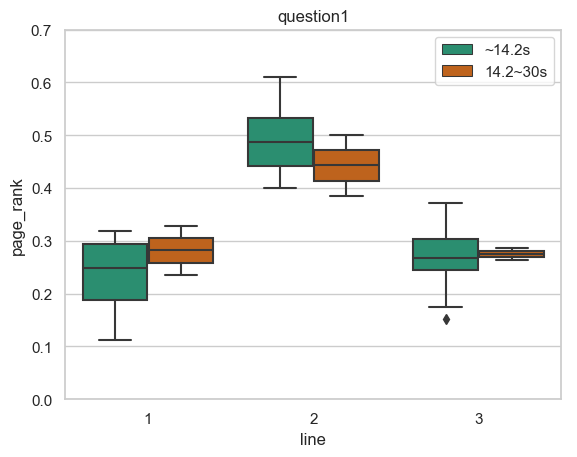

6 15


<Figure size 1000x500 with 0 Axes>

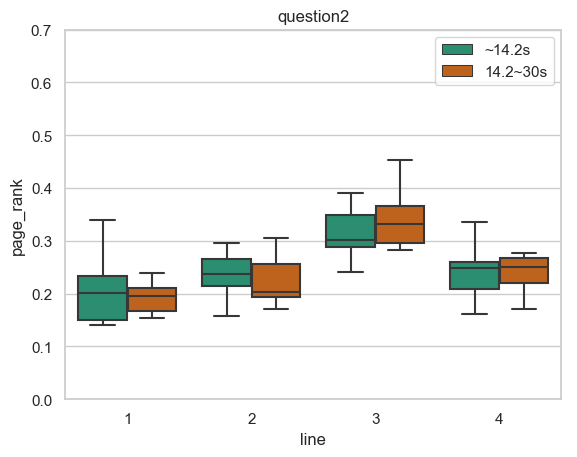

10 7


<Figure size 1000x500 with 0 Axes>

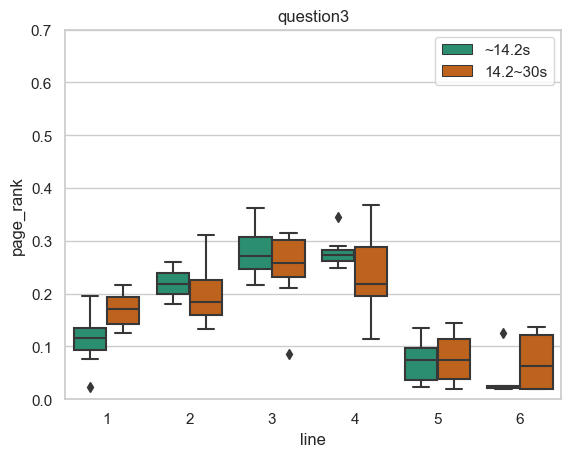

0 23


<Figure size 1000x500 with 0 Axes>

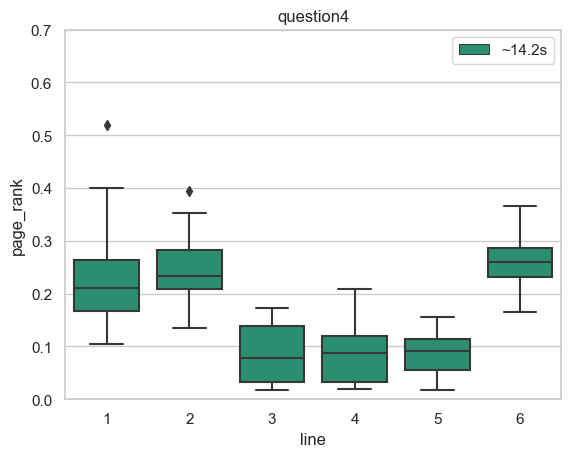

4 14


<Figure size 1000x500 with 0 Axes>

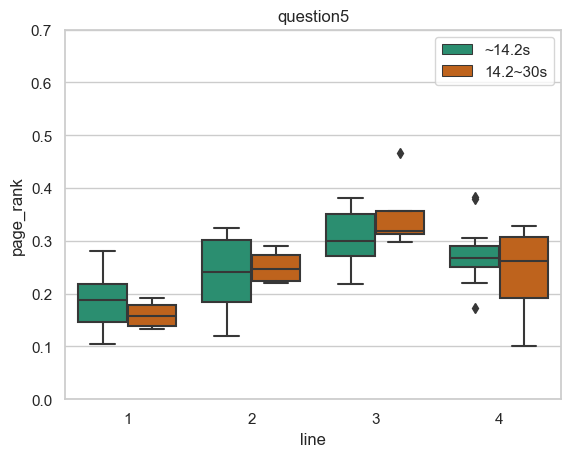

9 9


<Figure size 1000x500 with 0 Axes>

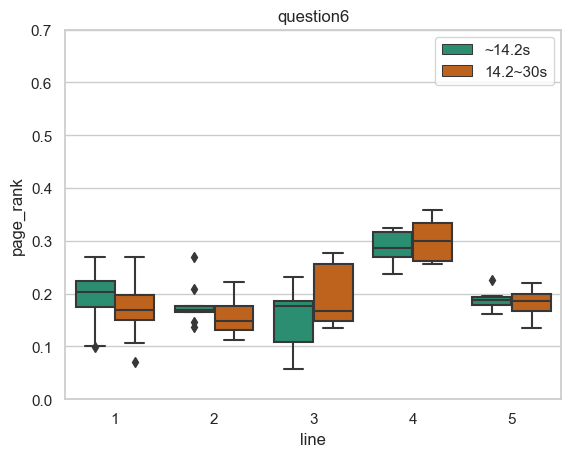

7 10


<Figure size 1000x500 with 0 Axes>

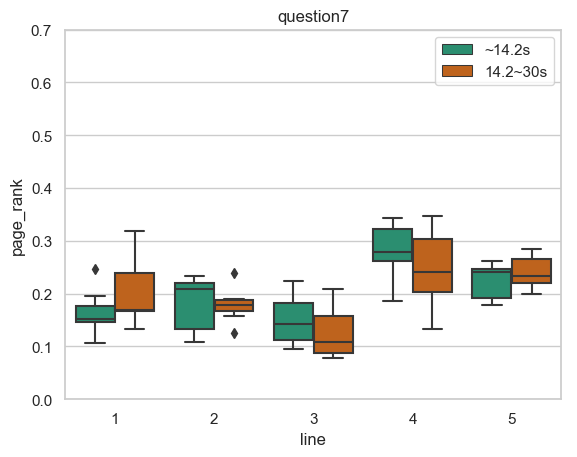

5 13


<Figure size 1000x500 with 0 Axes>

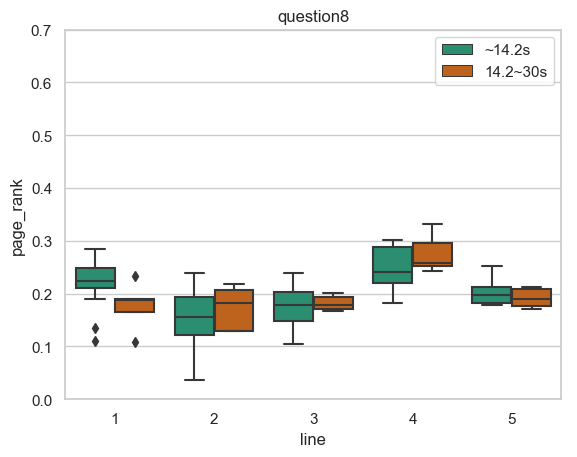

8 8


<Figure size 1000x500 with 0 Axes>

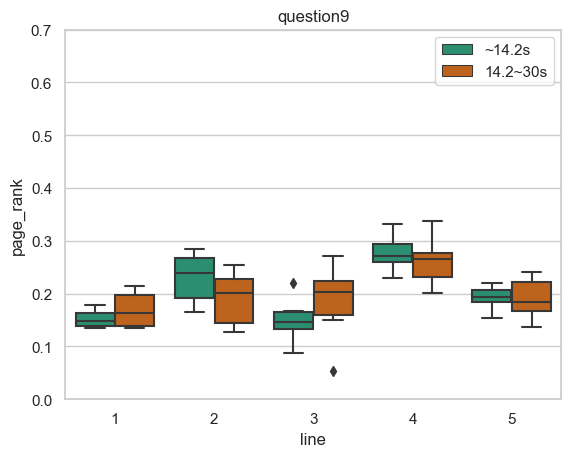

13 1


<Figure size 1000x500 with 0 Axes>

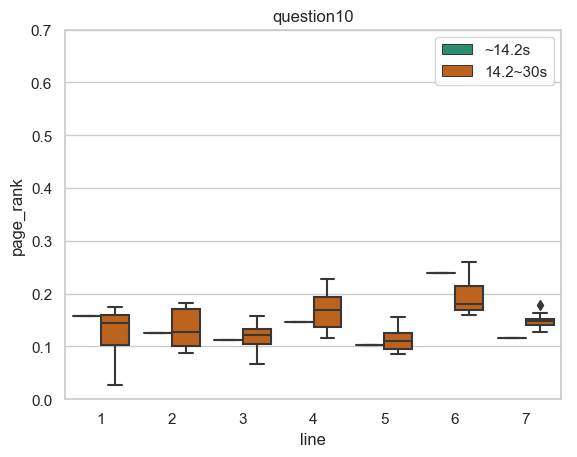

12 3


<Figure size 1000x500 with 0 Axes>

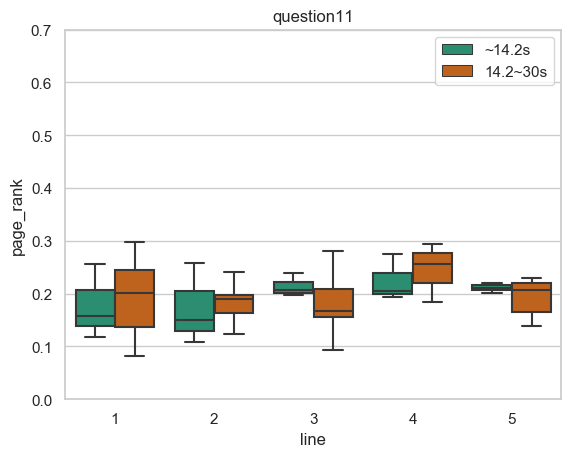

2 17


<Figure size 1000x500 with 0 Axes>

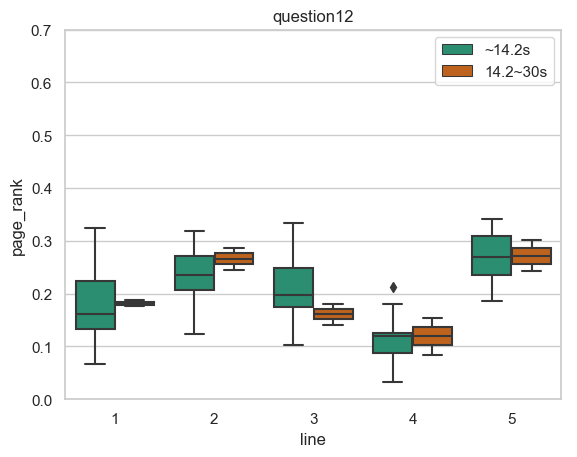

2 17


<Figure size 1000x500 with 0 Axes>

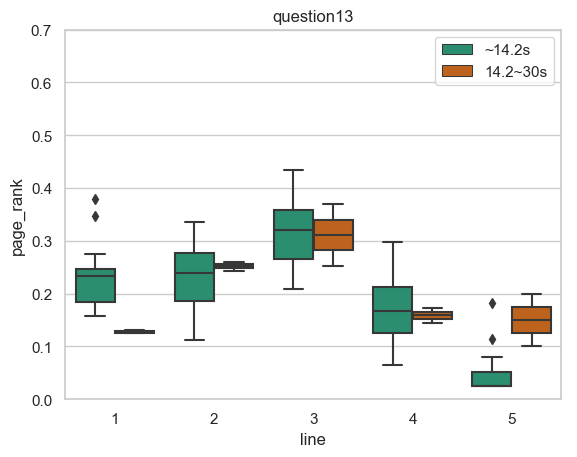

2 20


<Figure size 1000x500 with 0 Axes>

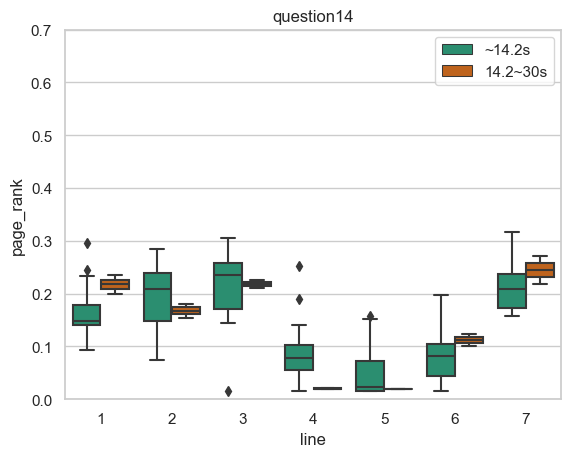

5 14


<Figure size 1000x500 with 0 Axes>

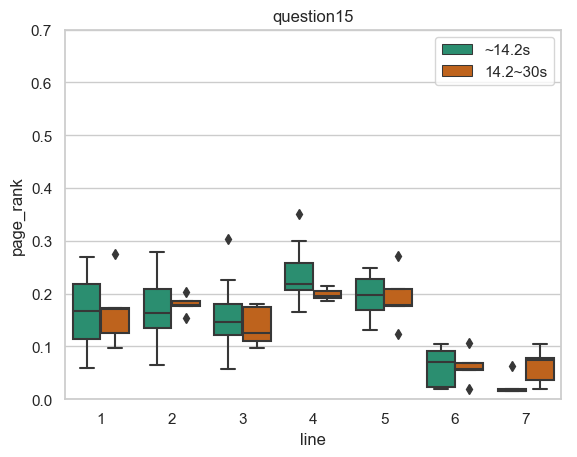

In [633]:
#重要度の解答時間分類
for i in range(1,16):
#     print(len())
    page_rank_plot_answer_time(i)

<Figure size 1000x500 with 0 Axes>

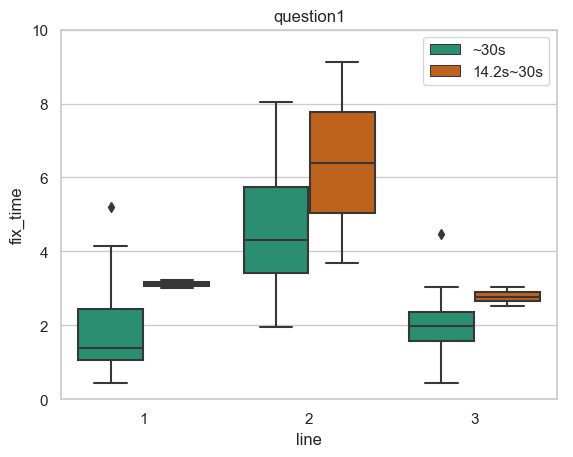

<Figure size 1000x500 with 0 Axes>

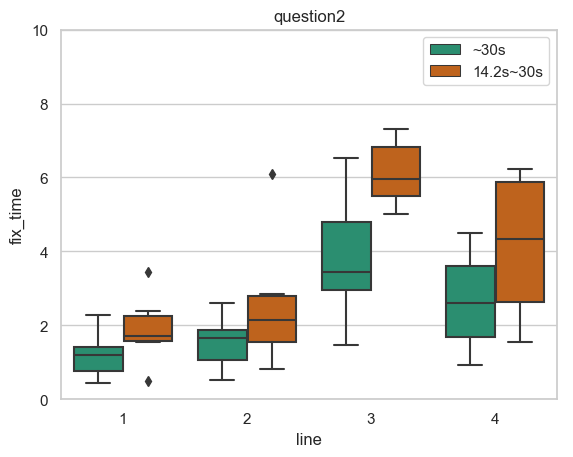

<Figure size 1000x500 with 0 Axes>

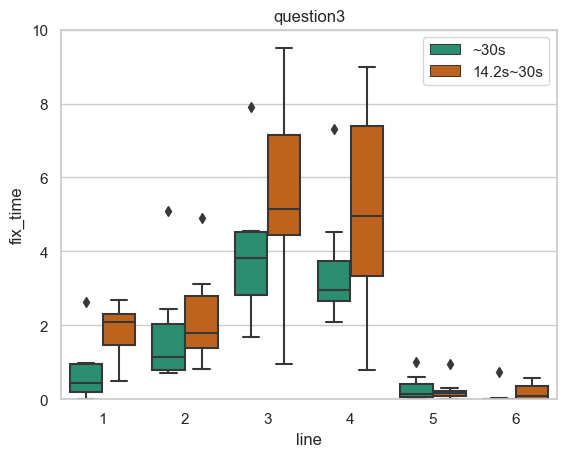

<Figure size 1000x500 with 0 Axes>

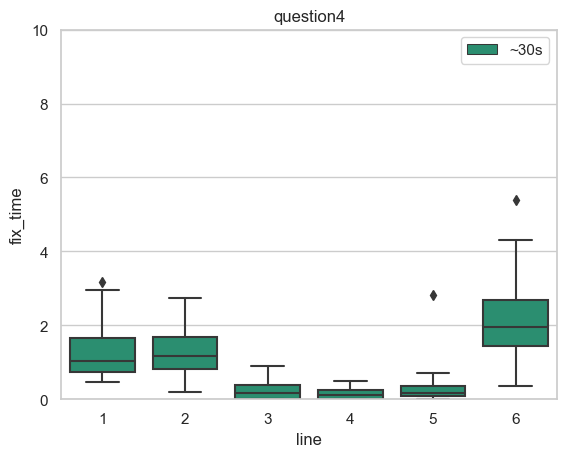

<Figure size 1000x500 with 0 Axes>

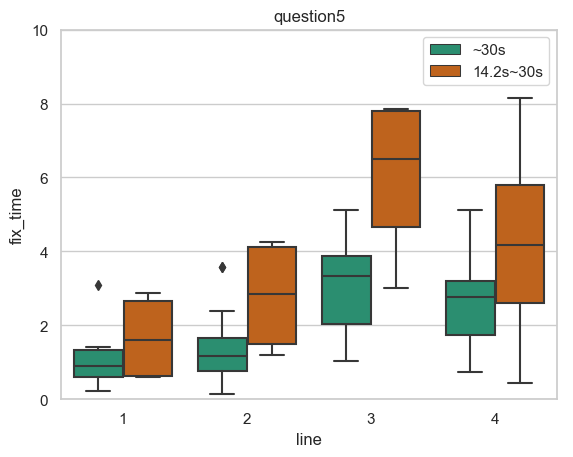

<Figure size 1000x500 with 0 Axes>

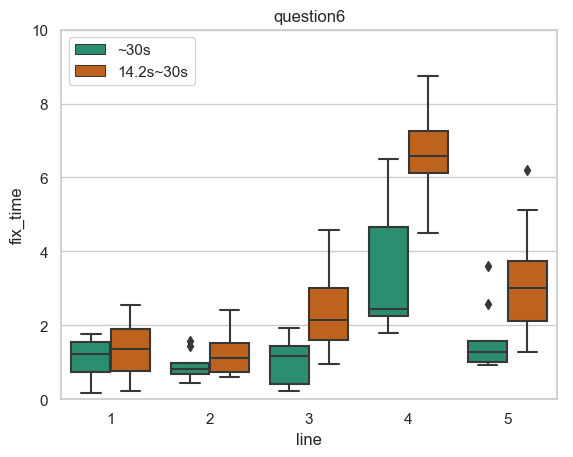

<Figure size 1000x500 with 0 Axes>

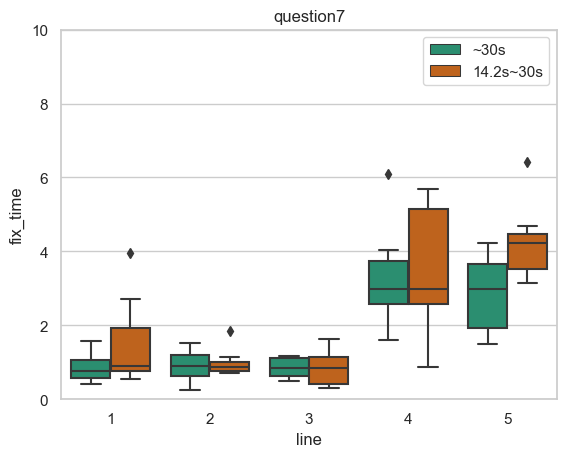

<Figure size 1000x500 with 0 Axes>

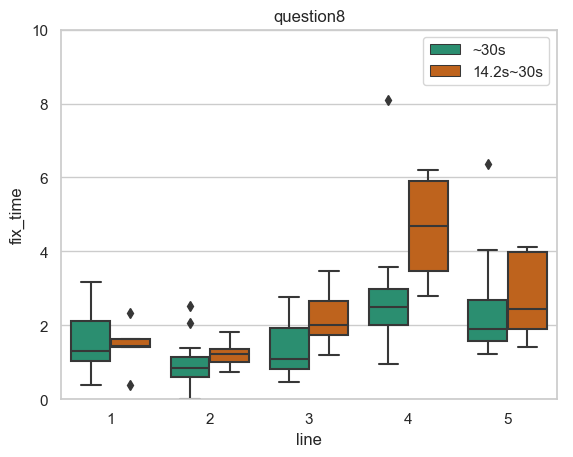

<Figure size 1000x500 with 0 Axes>

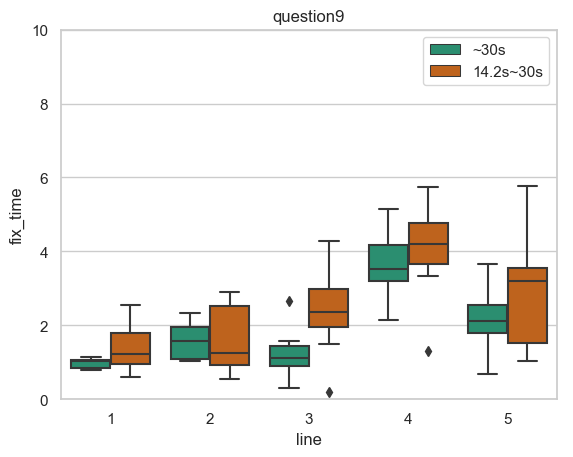

<Figure size 1000x500 with 0 Axes>

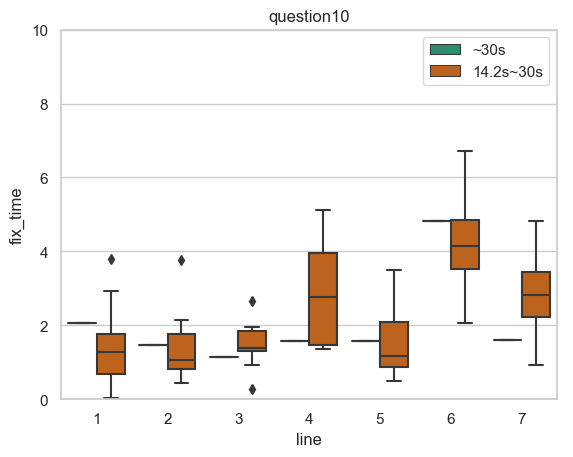

<Figure size 1000x500 with 0 Axes>

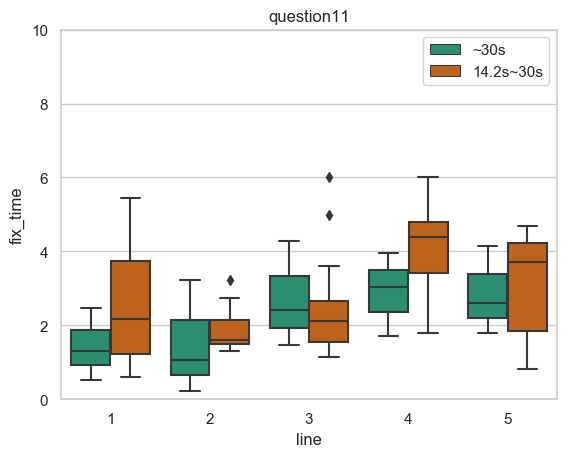

<Figure size 1000x500 with 0 Axes>

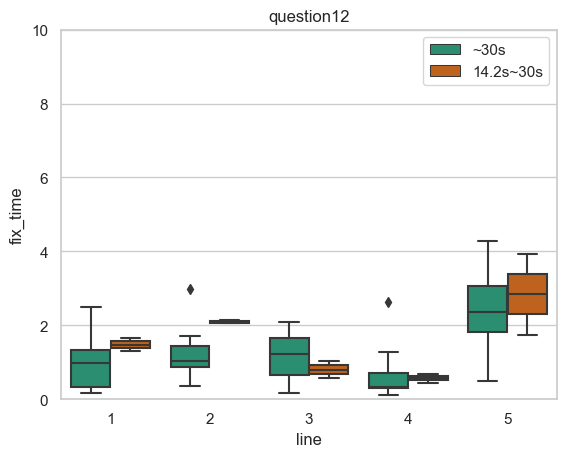

<Figure size 1000x500 with 0 Axes>

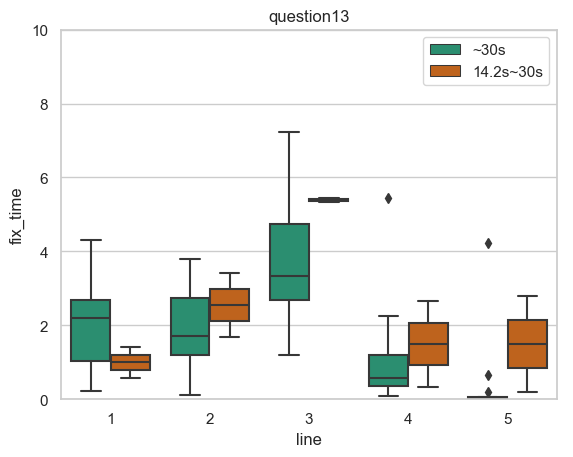

<Figure size 1000x500 with 0 Axes>

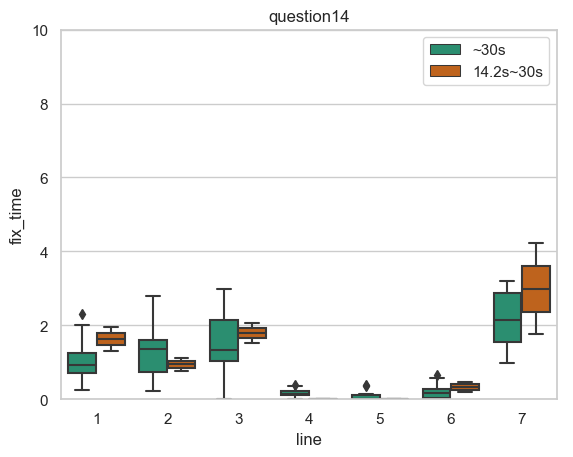

<Figure size 1000x500 with 0 Axes>

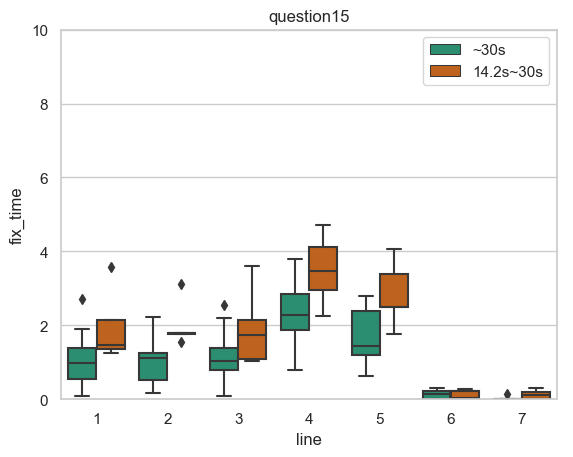

In [636]:
#注視時間の解答時間分類(正解のみ)(絶対値)
for i in range(1,16):
    fix_plot_answer_time(i)

<Figure size 1000x500 with 0 Axes>

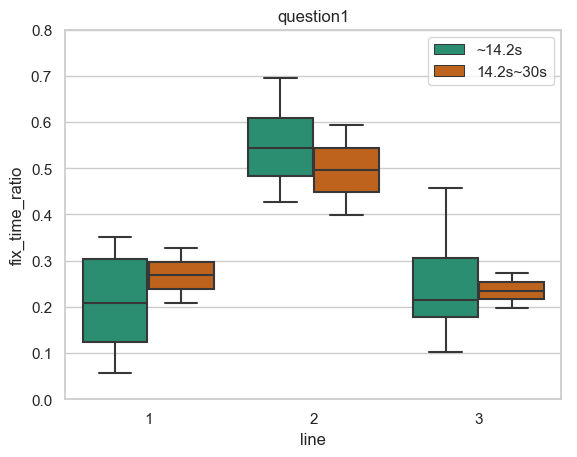

<Figure size 1000x500 with 0 Axes>

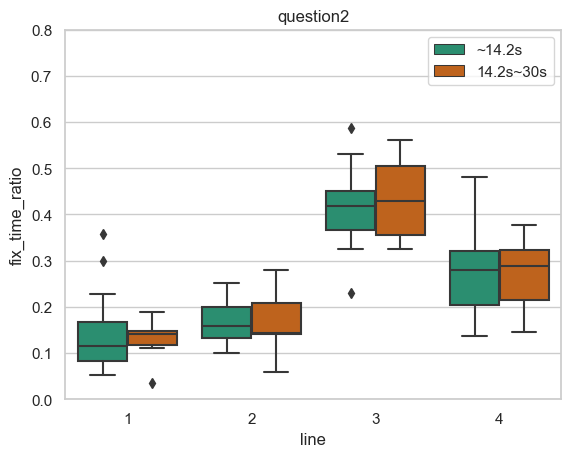

<Figure size 1000x500 with 0 Axes>

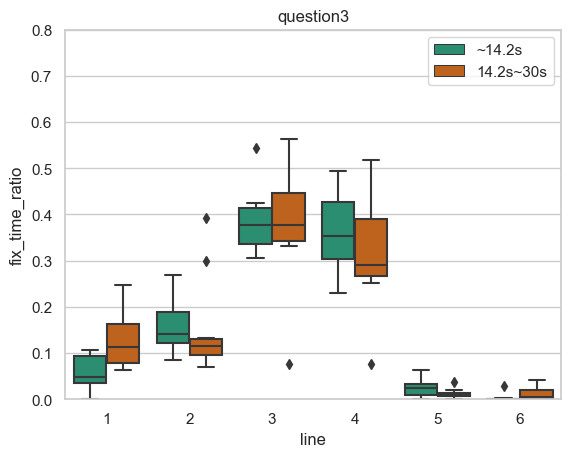

<Figure size 1000x500 with 0 Axes>

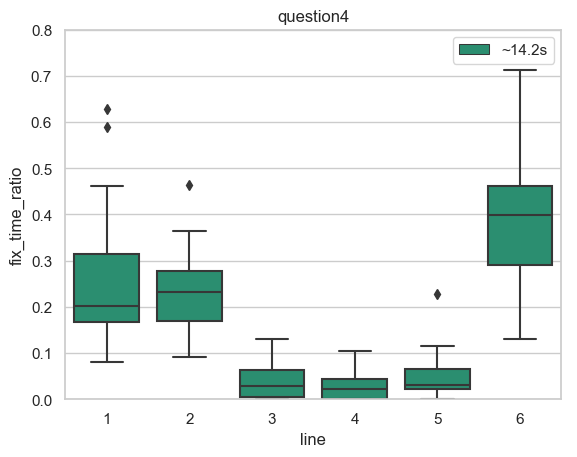

<Figure size 1000x500 with 0 Axes>

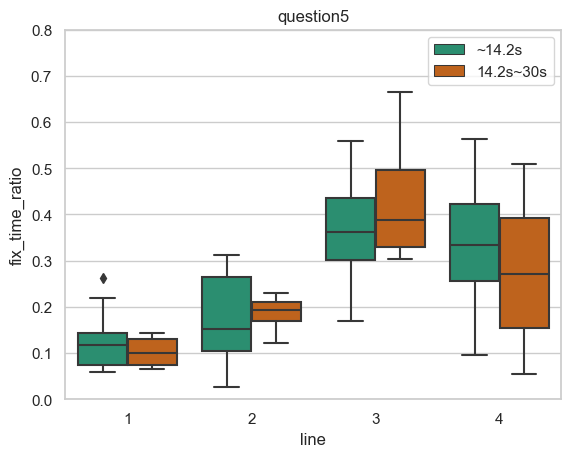

<Figure size 1000x500 with 0 Axes>

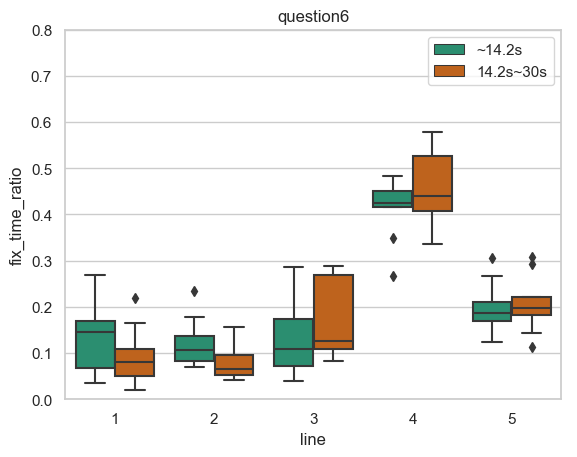

<Figure size 1000x500 with 0 Axes>

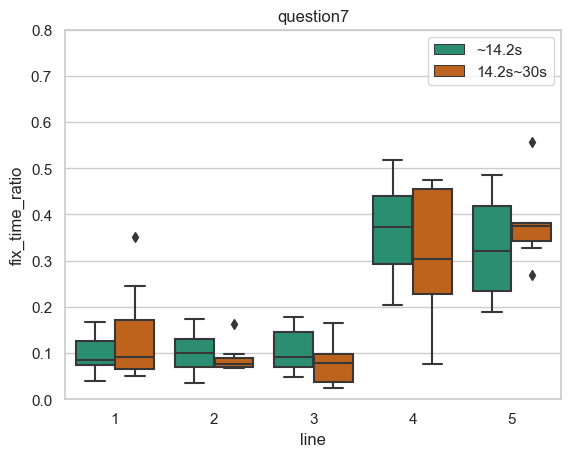

<Figure size 1000x500 with 0 Axes>

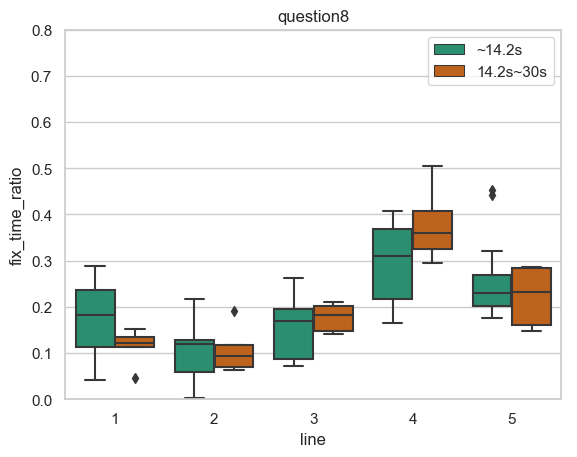

<Figure size 1000x500 with 0 Axes>

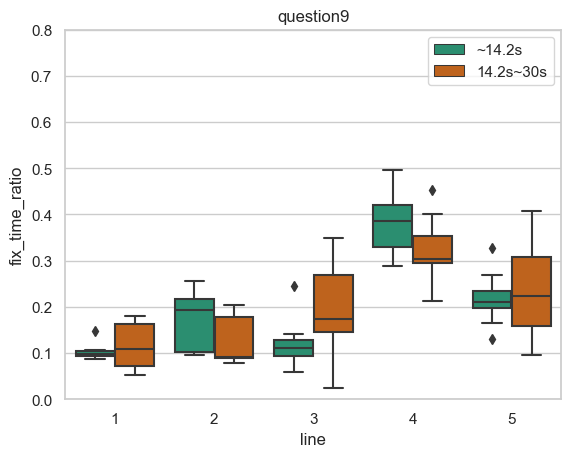

<Figure size 1000x500 with 0 Axes>

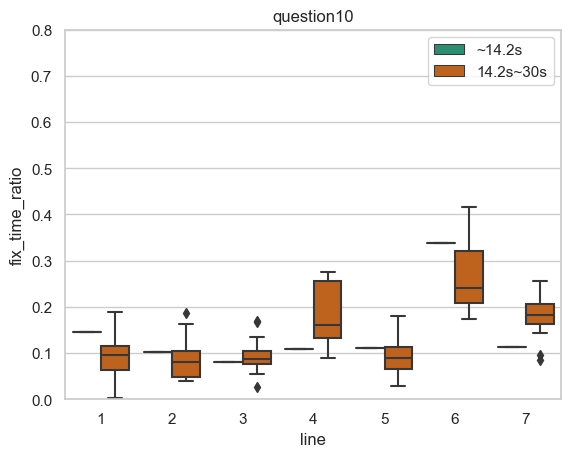

<Figure size 1000x500 with 0 Axes>

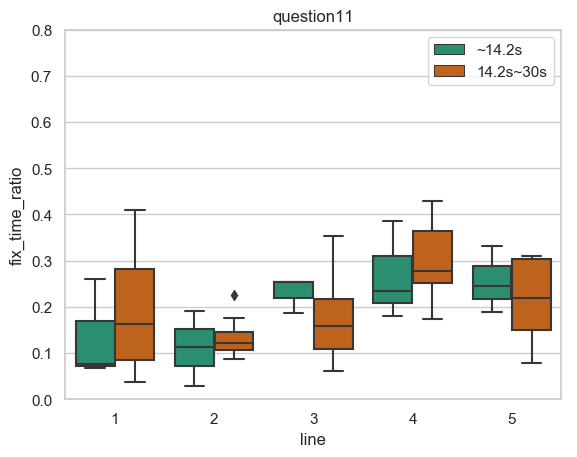

<Figure size 1000x500 with 0 Axes>

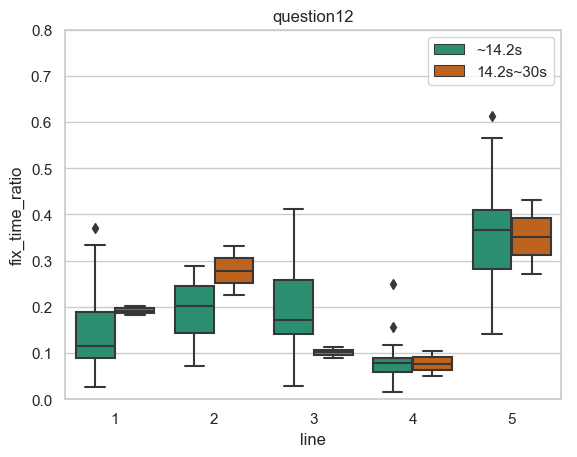

<Figure size 1000x500 with 0 Axes>

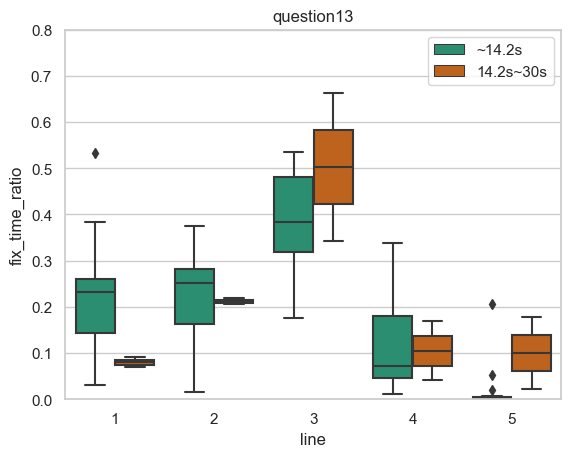

<Figure size 1000x500 with 0 Axes>

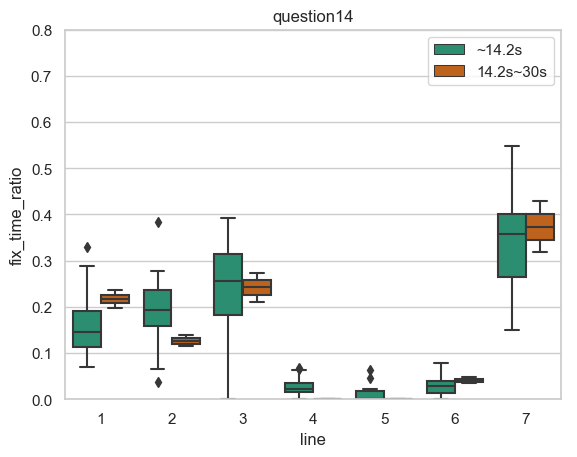

<Figure size 1000x500 with 0 Axes>

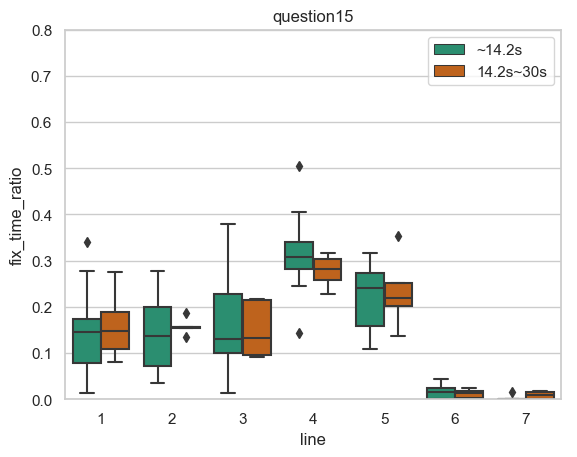

In [642]:
#注視時間の解答時間分類(正解のみ)(割合)
for i in range(1,16):
    fix_plot_answer_time_ratio(i)

In [1830]:
kentei(8,1)

8の1行目は有意差なし(等分散)


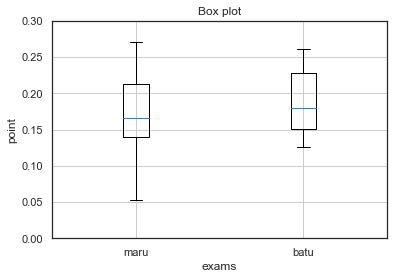

In [1168]:
fig, ax = plt.subplots()
points = (maru_9_3,batu_9_3)
bp = ax.boxplot(points)
ax.set_xticklabels(['maru', 'batu'])

plt.title('Box plot')
plt.xlabel('exams')
plt.ylabel('point')
# Y軸のメモリのrange
plt.ylim([0,0.3])
plt.grid()

# 描画
plt.show()

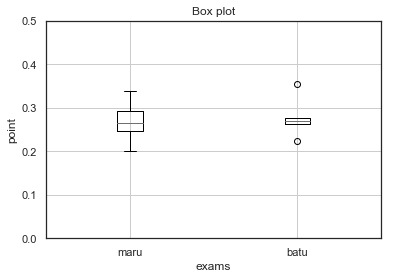

In [1170]:
fig, ax = plt.subplots()
points = (maru_9_4,batu_9_4)
bp = ax.boxplot(points)
ax.set_xticklabels(['maru', 'batu'])

plt.title('Box plot')
plt.xlabel('exams')
plt.ylabel('point')
# Y軸のメモリのrange
plt.ylim([0,0.5])
plt.grid()

# 描画
plt.show()

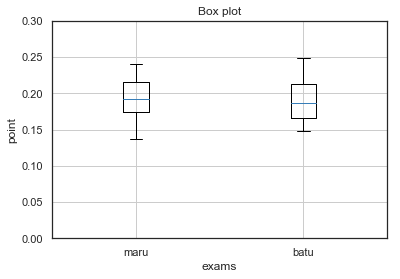

In [1171]:
fig, ax = plt.subplots()
points = (maru_9_5,batu_9_5)
bp = ax.boxplot(points)
ax.set_xticklabels(['maru', 'batu'])

plt.title('Box plot')
plt.xlabel('exams')
plt.ylabel('point')
# Y軸のメモリのrange
plt.ylim([0,0.3])
plt.grid()

# 描画
plt.show()

In [1394]:
df_1[9]

,time,x,y,velo,r_AOI
6584,110.001085,1001.8340,538.8365,0,0
6585,110.018276,1001.8340,538.8365,0,0
6586,110.034623,1001.8340,538.8365,0,0
6587,110.051549,913.6910,547.1534,0,0
6588,110.068029,968.5441,535.0245,0,0
6589,110.085112,968.5441,535.0245,0,0
6590,110.100921,922.5585,536.4164,0,0
6591,110.118242,975.4752,525.7032,0,0
6592,110.134859,930.9279,518.8898,0,0
6593,110.151539,978.7792,516.8907,0,0


In [ ]:
#サイトにつっこむcsvファイル生成
def create_csv(df,filename,participant_name):
    df = df[df["AOI"]!=-1]
    aoi,times = write_grah_x(df)
    a = []
    b = []
    for i in range(0, len(aoi), 2):
        if i+1 <len(aoi):
            a.append(times[i+1]-times[i])
            b.append(float(aoi[i]))
    c = np.reshape(b,(-1,1))
    d = np.reshape(a,(-1,1))
    data = np.concatenate([c,d],1)
    data = pd.DataFrame(data,columns={"AOIName","FixationDuration"})
    data["Stimulus"]= "Fruit Plate"
    data["Participant"]=participant_name
    file = filename+".csv"
    data.to_csv(file)
    
def write_grah_x(df,t=0.1):
    df_aoi = df[df["AOI"]!=0]
    df_aoi = df_aoi.reset_index(drop=True)
#     print(df_aoi)
    ao = df_aoi["AOI"].iloc[0]
    aoi = np.array(df_aoi["AOI"].iloc[0])
    times = np.array(df_aoi["time"].iloc[0])
    for i , j in df_aoi.iterrows():
        if i <=len(df_aoi)-2:
            if (j["AOI"]==ao)&(df_aoi.iloc[i+1]["AOI"]!=ao):
                    aoi=np.append(aoi,(j["AOI"]))
                    aoi=np.append(aoi,(df_aoi.iloc[i+1]["AOI"]))

                    times = np.append(times, j["time"])
                    times = np.append(times, df_aoi.iloc[i+1]["time"])
                    ao = df_aoi.iloc[i+1]["AOI"]
    return aoi,times

In [1597]:
def page_rank_plot4(m):#重要度の行ごとの比較
    fig = plt.figure(figsize=(10,5))
    line = lines[m-1]
    for i in range(line):
        name1 = "d"+str(i+1)
        name2 = "e_"+str(i+1)
        name3 = "f"+str(i+1)
        gl[name1]=gl["maru_"+str(m)+"_"+str(i+1)]
        gl[name2]=gl["batu_"+str(m)+"_74_"+str(i+1)]
#         gl[name3]=gl["e07_"+str(m)+"_"+str(i+1)]
#     print(f1)
    name = "page_rank_"+str(m)

    plt.style.use('default')
    sns.set()
    sns.set_style('whitegrid')
    sns.set_palette('Set3')


    if line == 3:
        df_batu = pd.DataFrame({
            '1': e_1,'2': e_2,'3':e_3})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3})
    elif line == 4:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4})
    elif line == 5:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5})
    elif line == 6:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6})
    elif line == 7:
        df_batu = pd.DataFrame({
            '1': e_1, '2': e_2,'3':e_3,'4':e_4,'5':e_5,'6':e_6,'7':e_7})
        df_maru = pd.DataFrame({
            '1': d1,'2': d2,'3': d3,'4':d4,'5':d5,'6':d6,'7':d7})
        df_e7 = pd.DataFrame({ '1': f1, '2': f2,'3':f3,'4':f4,'5':f5,'6':f6,'7':f7})
   

    # merge the two data frames to one data frame
    dfTa_melt = pd.melt(df_batu)
    dfTa_melt['species'] = 'batu_74'
    dfAt_melt = pd.melt(df_maru)
    dfAt_melt['species'] = 'maru'
#     dfe7_melt = pd.melt(df_e7)
#     dfe7_melt['species'] = 'e0&e7'
    df = pd.concat([dfAt_melt, dfTa_melt], axis=0)
#     df = pd.concat([df, dfe7_melt], axis=0)

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)
    sns.boxplot(x='variable', y='value', data=df, hue='species', palette='Dark2', ax=ax)
    sns.stripplot(x='variable', y='value', data=df, hue='species', dodge=True, jitter=True, color='black', ax=ax)

    ax.set_xlabel('line')
    ax.set_ylabel('page_rank')
    ax.set_ylim(0, 0.4)
    ax.legend()
    plt.title("question"+str(m))
    plt.show()

<Figure size 1000x500 with 0 Axes>

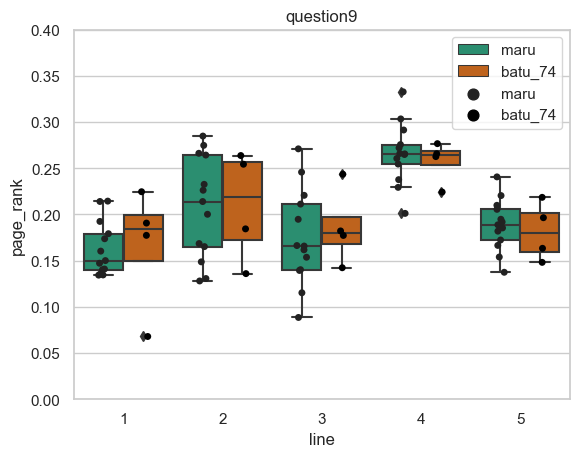

In [1598]:
page_rank_plot4(9)

In [321]:
seni_14_9_n

matrix([[0.    , 0.8778, 0.0461, 0.0761, 0.    ],
        [0.705 , 0.    , 0.184 , 0.0621, 0.049 ],
        [0.1343, 0.7322, 0.    , 0.1335, 0.    ],
        [0.2988, 0.    , 0.2009, 0.    , 0.5003],
        [0.    , 0.    , 0.2854, 0.7146, 0.    ]])

In [312]:
batu74_4_1 = np.array([seni_6_9_n[4,1],seni_8_9_n[4,1],seni_11_9_n[4,1],seni_14_9_n[4,1]])

In [313]:
batu74_4_1

array([0.0814, 0.1107, 0.    , 0.    ])

In [314]:
(seni_6_9_n+seni_8_9_n+seni_11_9_n+seni_14_9_n)[4,1]

0.19213016137329436

In [1624]:
maru74_4_1

array([3.067, 0.   , 0.116, 0.   , 0.035, 0.397, 0.   , 0.055, 0.092,
       0.154, 0.148, 0.333, 0.035, 0.095, 0.   , 0.   ])

In [1627]:
A=maru74_4_1
B = batu74_4_1
A_var = np.var(A, ddof=1)  # Aの不偏分散
B_var = np.var(B, ddof=1)  # Bの不偏分散
A_df = len(A) - 1  # Aの自由度
B_df = len(B) - 1  # Bの自由度
f = A_var / B_var  # F比の値
one_sided_pval1 = stats.f.cdf(f, A_df, B_df)  # 片側検定のp値 1
one_sided_pval2 = stats.f.sf(f, A_df, B_df)   # 片側検定のp値 2
two_sided_pval = min(one_sided_pval1, one_sided_pval2) * 2  # 両側検定のp値

print('F:       ', round(f, 3))
print('p-value: ', round(two_sided_pval, 3))
stats.ttest_ind(A, B, equal_var=False)

F:        175.506
p-value:  0.001


Ttest_indResult(statistic=1.236361908821908, pvalue=0.2345577457191755)

In [324]:
seni_21_7.T

matrix([[0.    , 0.5851, 0.0411, 0.0241, 0.    ],
        [0.9357, 0.    , 0.8757, 0.0734, 0.    ],
        [0.0212, 0.2766, 0.    , 0.0487, 0.    ],
        [0.0431, 0.1384, 0.0832, 0.    , 1.    ],
        [0.    , 0.    , 0.    , 0.8538, 0.    ]])

In [475]:
#3m6m8m9m10
se = seni_2_5.copy()
le = 1
maru74_4_1=np.array([])
for i in range(3,25):
    if df_5_maru[i-1]==1:
        le +=1
        se +=gl["seni_"+str(i)+"_5"]
print(le)
se = se/le
    

18


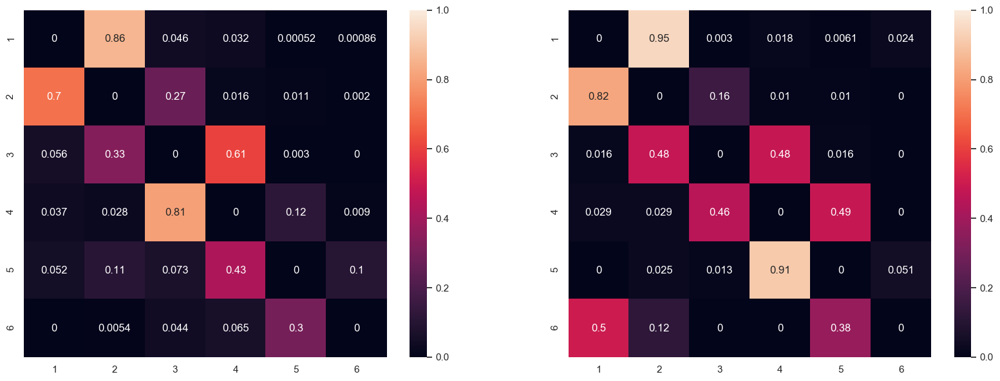

In [453]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(20,7))
# plt.figure(figsize=(20,10))
sns.heatmap(se,annot=True,xticklabels=[1,2,3,4,5,6],yticklabels=[1,2,3,4,5,6],ax=ax1,vmin=0,vmax=1)
sns.heatmap(seni_3_3,annot=True,xticklabels=[1,2,3,4,5,6],yticklabels=[1,2,3,4,5,6],ax=ax2,vmin=0,vmax=1)

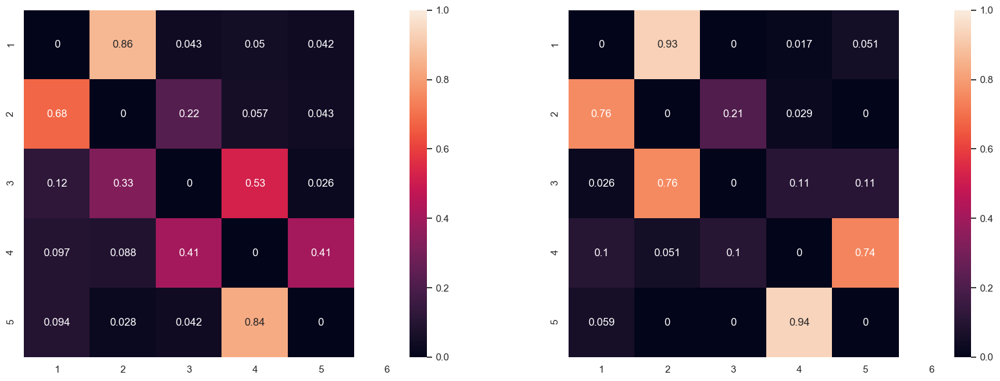

In [451]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(20,7))
# plt.figure(figsize=(20,10))
sns.heatmap(se,annot=True,xticklabels=[1,2,3,4,5,6],yticklabels=[1,2,3,4,5],ax=ax1,vmin=0,vmax=1)
sns.heatmap(seni_3_6,annot=True,xticklabels=[1,2,3,4,5,6],yticklabels=[1,2,3,4,5],ax=ax2,vmin=0,vmax=1)

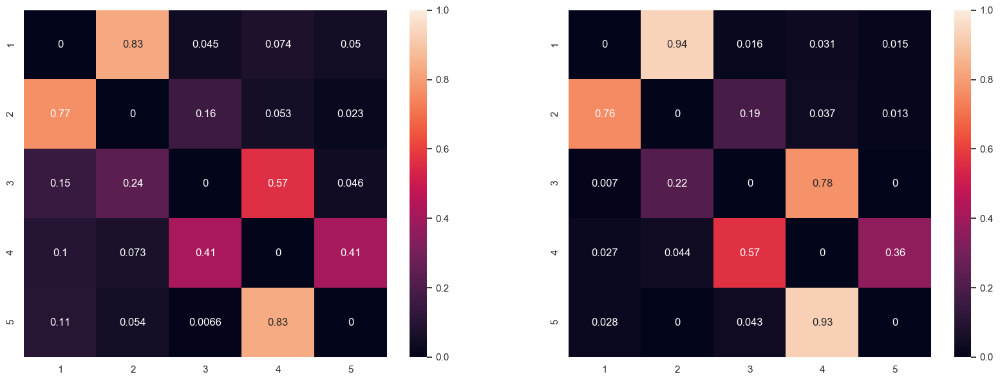

In [449]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(20,7))
# plt.figure(figsize=(20,10))
sns.heatmap(se,annot=True,xticklabels=[1,2,3,4,5],yticklabels=[1,2,3,4,5],ax=ax1,vmin=0,vmax=1)
sns.heatmap(seni_3_8,annot=True,xticklabels=[1,2,3,4,5],yticklabels=[1,2,3,4,5],ax=ax2,vmin=0,vmax=1)

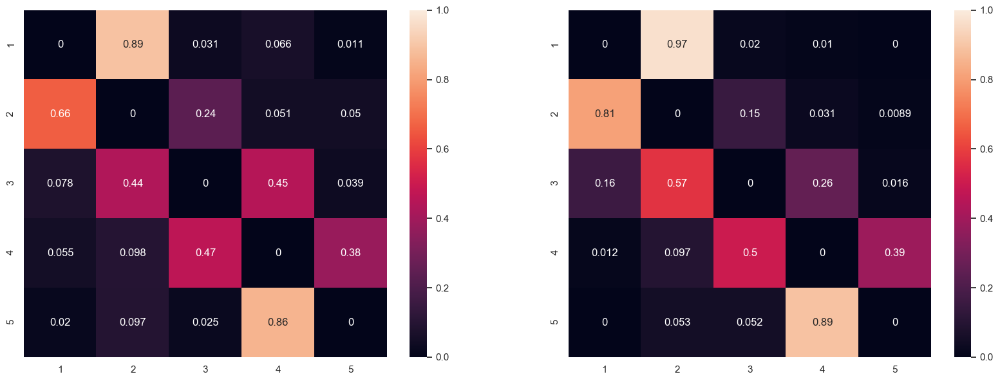

In [447]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(20,7))
# plt.figure(figsize=(20,10))
sns.heatmap(se,annot=True,xticklabels=[1,2,3,4,5],yticklabels=[1,2,3,4,5],ax=ax1,vmin=0,vmax=1)
sns.heatmap(seni_3_9,annot=True,xticklabels=[1,2,3,4,5],yticklabels=[1,2,3,4,5],ax=ax2,vmin=0,vmax=1)

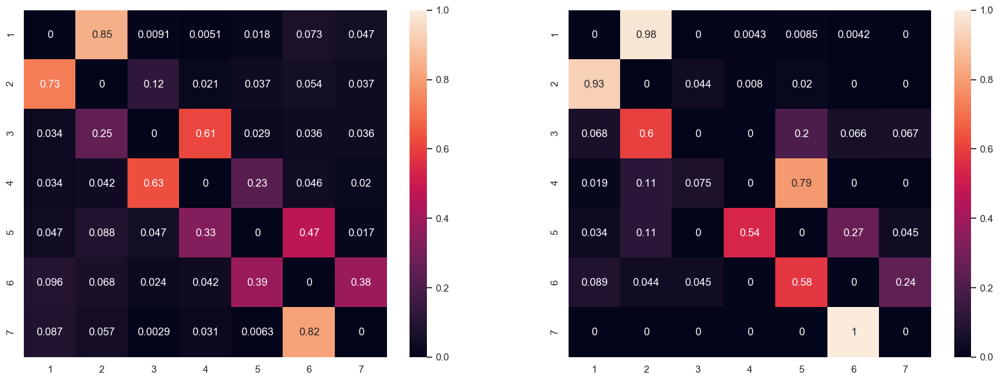

In [445]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(20,7))
sns.heatmap(se,annot=True,xticklabels=[1,2,3,4,5,6,7],yticklabels=[1,2,3,4,5,6,7],ax=ax1,vmin=0,vmax=1)
sns.heatmap(seni_3_10,annot=True,xticklabels=[1,2,3,4,5,6,7],yticklabels=[1,2,3,4,5,6,7],ax=ax2,vmin=0,vmax=1)

In [388]:
seni_3_10.T

matrix([[0.    , 0.9276, 0.0678, 0.0192, 0.0341, 0.0888, 0.    ],
        [0.9829, 0.    , 0.5994, 0.1129, 0.1123, 0.0442, 0.    ],
        [0.    , 0.0443, 0.    , 0.0754, 0.    , 0.0446, 0.    ],
        [0.0043, 0.008 , 0.    , 0.    , 0.5389, 0.    , 0.    ],
        [0.0085, 0.0201, 0.1998, 0.7925, 0.    , 0.5783, 0.    ],
        [0.0042, 0.    , 0.0658, 0.    , 0.2698, 0.    , 1.    ],
        [0.    , 0.    , 0.0672, 0.    , 0.0449, 0.2441, 0.    ]])

In [425]:
for i in range(1,25):
    for j in range(1,16):
        line = lines[j-1]
        name = "seni_"+str(i)+"_"+str(j)+"_n"
        b_name = gl["seni_"+str(i)+"_"+str(j)]
        for k in range(line):
            b_name[k,k]=0
        for r,l in enumerate(b_name):
            ma = l.sum()
            for y,m in enumerate(l):
                if ma!=0:
                    b_name[r,y] /= ma
        gl[name]=b_name
        

In [428]:
seni_1_3_n

matrix([[0.    , 0.8441, 0.078 , 0.0778, 0.    , 0.    ],
        [0.161 , 0.    , 0.8361, 0.003 , 0.    , 0.    ],
        [0.0123, 0.6938, 0.    , 0.2939, 0.    , 0.    ],
        [0.032 , 0.048 , 0.92  , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 0.    , 0.    , 0.    , 0.    ],
        [0.    , 0.    , 0.    , 0.    , 0.    , 0.    ]])

In [476]:
se+se**2

matrix([[0.5999, 0.9007, 0.3607, 0.1386],
        [0.7076, 0.7151, 0.3566, 0.2207],
        [0.4485, 0.5718, 0.493 , 0.4867],
        [0.254 , 0.5502, 0.821 , 0.3748]])

In [478]:
seni_18_5+seni_18_5**2

matrix([[0.5597, 0.9808, 0.4134, 0.0461],
        [0.6036, 0.8225, 0.4304, 0.1436],
        [0.4713, 0.7503, 0.4817, 0.2967],
        [0.2117, 0.7358, 0.8305, 0.222 ]])

In [429]:
# ll = np.array([[1.0,2,3],[3,3,3]])
l = np.array([[1.0,2,3],[3,3,3]])
for i,j in enumerate(l):
    ma = j.sum()
    for k,m in enumerate(j):
#         print(l[i,k],ma)
#         print(l[i,k]/ma)
        l[i,k]=m/ma
#         print(ll[i,k])
l

array([[0.1667, 0.3333, 0.5   ],
       [0.3333, 0.3333, 0.3333]])

In [522]:
fix_time_1_1

array([3.5597, 4.4625, 1.7007])

In [ ]:
ratio_fix_time_10_1

In [ ]:
line = lines[11-1]
a = np.zeros(line)
b = 0
for i in range(24):
    if df_11_maru[i]==1:
        a += gl["fix_time_"+str(i+1)+"_11"]
        b += 1
a/b
        

In [543]:
line = lines[3-1]
a = np.zeros(line)
b = 0
for i,j in enumerate(page_rank_3):
    if df_3_maru[i]==1:
        a += j
        b += 1
a/b
        

array([0.1458, 0.2052, 0.2623, 0.2551, 0.0742, 0.0574])

Text(0.5, 1.0, 'question11')

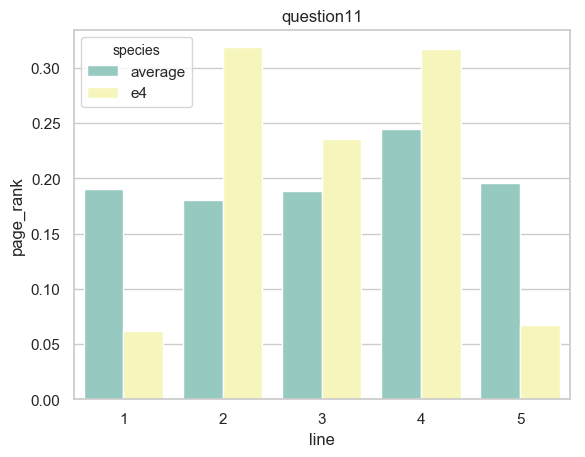

In [539]:
q = (a/b).copy()
c = pd.DataFrame({"1":q[0],"2":q[1],"3":q[2],"4":q[3],"5":q[4]},index=['i',])
d_ = page_rank_11[3]
d = pd.DataFrame({"1":d_[0],"2":d_[1],"3":d_[2],"4":d_[3],"5":d_[4]},index=['i',])
# d_= ratio_fix_time_21_11
# e = pd.DataFrame({"1":d_[0],"2":d_[1],"3":d_[2],"4":d_[3],"5":d_[4]},index=['i',])

dfTa_melt = pd.melt(c)
dfTa_melt['species'] = 'average'
dfAt_melt = pd.melt(d)
dfAt_melt['species'] = 'e4'
# dfDT_melt = pd.melt(e)
# dfDT_melt['species'] = 'e21'
df = pd.concat([dfTa_melt, dfAt_melt], axis=0)
# df = pd.concat([df, dfDT_melt], axis=0)
sns.barplot(x="variable", y="value", hue="species", data=df)
plt.ylabel("page_rank")
plt.xlabel("line")
plt.title("question11")

Text(0.5, 1.0, 'question12')

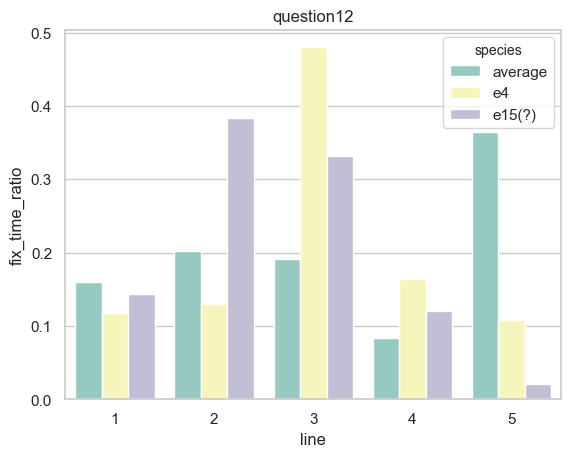

In [530]:
p = (a/b).copy()
c = pd.DataFrame({"1":p[0],"2":p[1],"3":p[2],"4":p[3],"5":p[4]},index=['i',])
d_ = ratio_fix_time_4_12
d = pd.DataFrame({"1":d_[0],"2":d_[1],"3":d_[2],"4":d_[3],"5":d_[4]},index=['i',])
d_= ratio_fix_time_15_12
e = pd.DataFrame({"1":d_[0],"2":d_[1],"3":d_[2],"4":d_[3],"5":d_[4]},index=['i',])

dfTa_melt = pd.melt(c)
dfTa_melt['species'] = 'average'
dfAt_melt = pd.melt(d)
dfAt_melt['species'] = 'e4'
dfDT_melt = pd.melt(e)
dfDT_melt['species'] = 'e15(?)'
df = pd.concat([dfTa_melt, dfAt_melt], axis=0)
df = pd.concat([df, dfDT_melt], axis=0)
sns.barplot(x="variable", y="value", hue="species", data=df)
plt.ylabel("fix_time_ratio")
plt.xlabel("line")
plt.title("question12")

In [541]:
se = seni_2_12.copy()
le = 1
maru74_4_1=np.array([])
for i in range(3,25):
    if df_12_maru[i-1]==1:
        le +=1
        se +=gl["seni_"+str(i)+"_12"]
print(le)
se = se/le

19


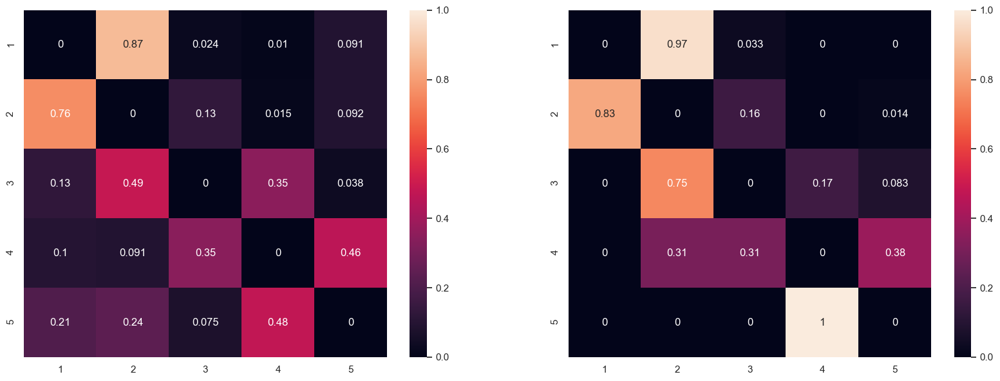

In [748]:
fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(20,7))
# plt.figure(figsize=(20,10))
sns.heatmap(se,annot=True,xticklabels=[1,2,3,4,5],yticklabels=[1,2,3,4,5],ax=ax1,vmin=0,vmax=1)
sns.heatmap(seni_15_12,annot=True,xticklabels=[1,2,3,4,5],yticklabels=[1,2,3,4,5],ax=ax2,vmin=0,vmax=1)

<Figure size 1000x500 with 0 Axes>

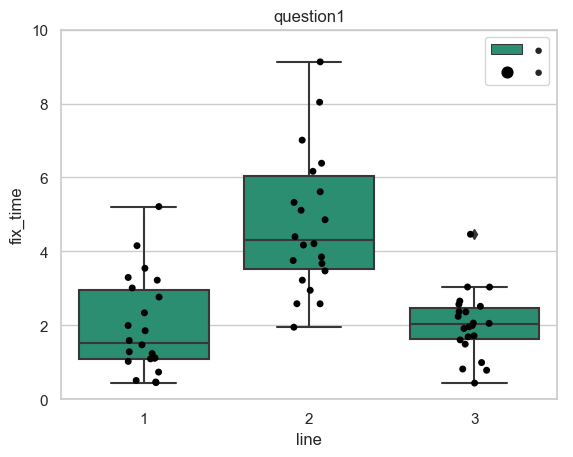

<Figure size 1000x500 with 0 Axes>

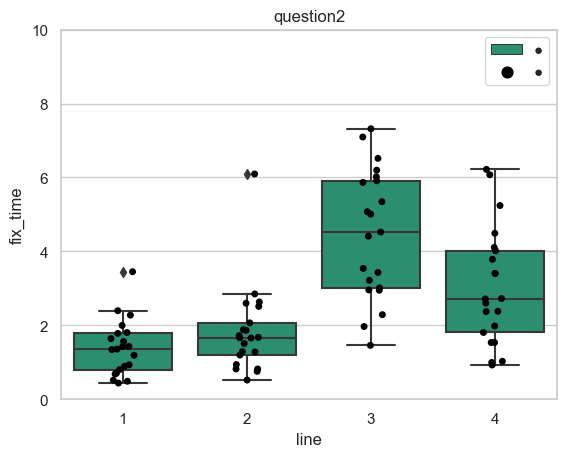

<Figure size 1000x500 with 0 Axes>

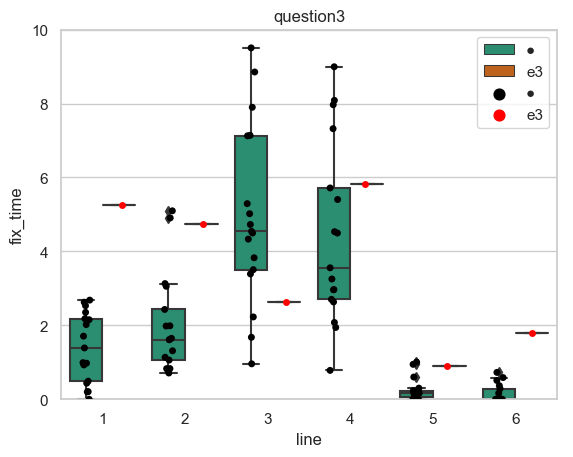

<Figure size 1000x500 with 0 Axes>

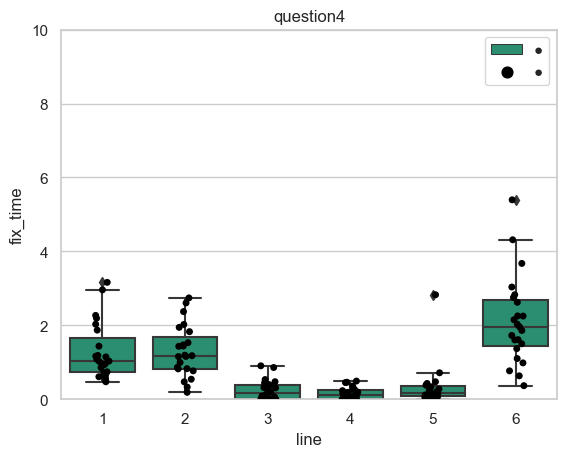

<Figure size 1000x500 with 0 Axes>

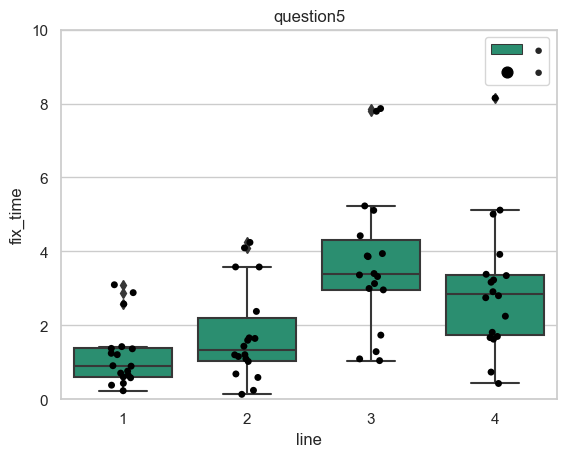

<Figure size 1000x500 with 0 Axes>

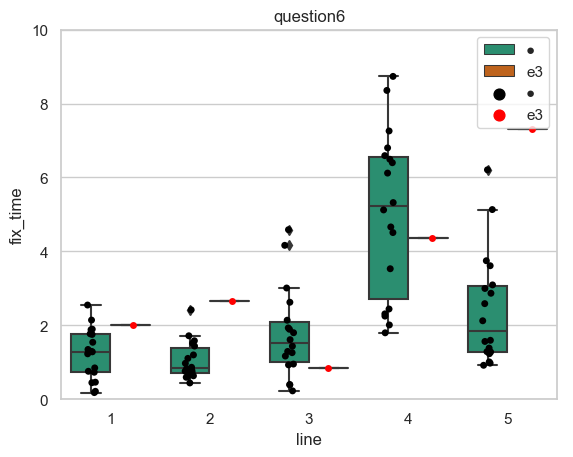

<Figure size 1000x500 with 0 Axes>

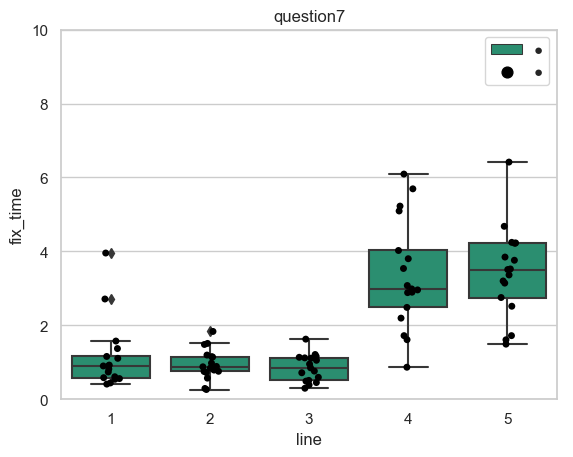

<Figure size 1000x500 with 0 Axes>

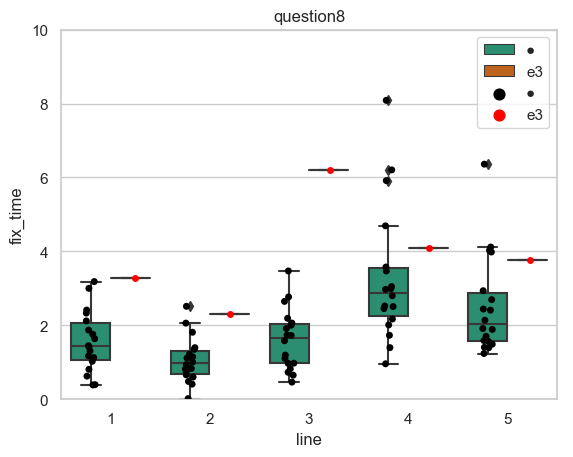

<Figure size 1000x500 with 0 Axes>

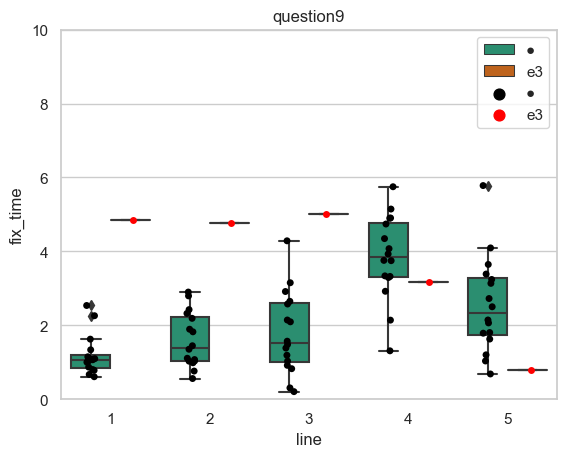

<Figure size 1000x500 with 0 Axes>

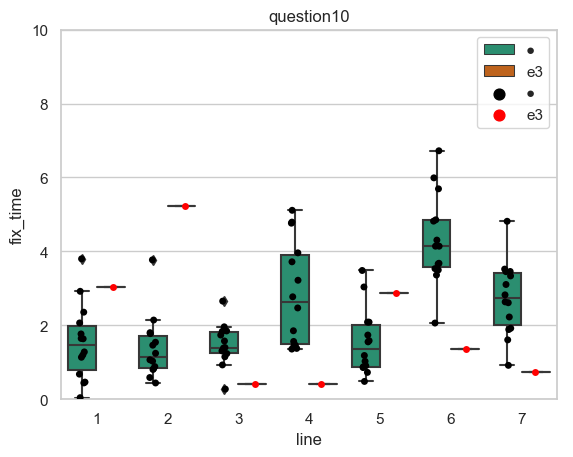

<Figure size 1000x500 with 0 Axes>

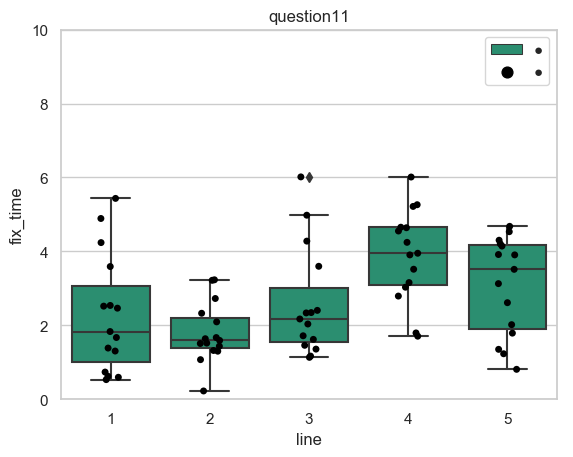

<Figure size 1000x500 with 0 Axes>

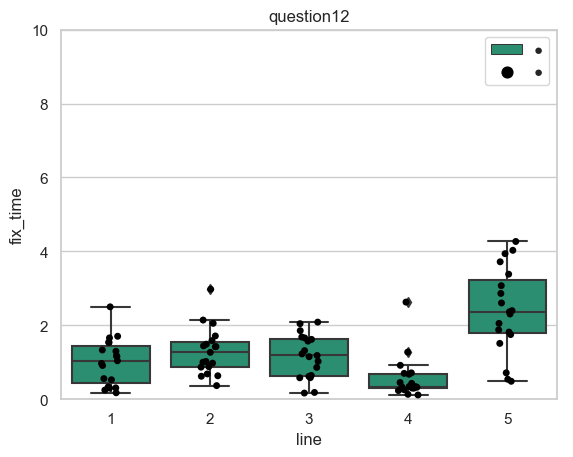

<Figure size 1000x500 with 0 Axes>

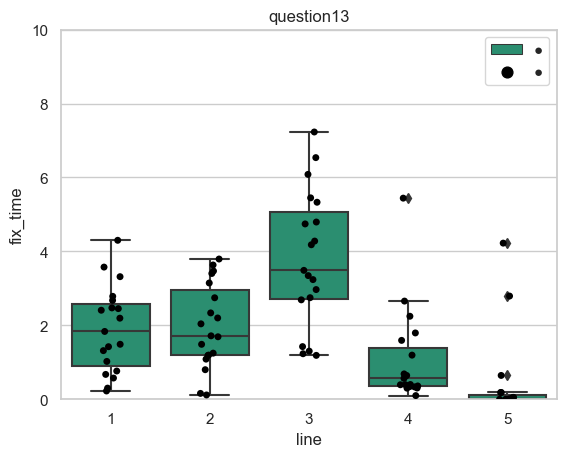

<Figure size 1000x500 with 0 Axes>

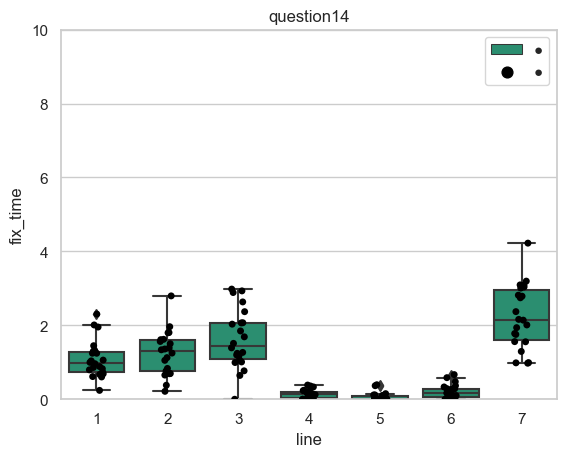

<Figure size 1000x500 with 0 Axes>

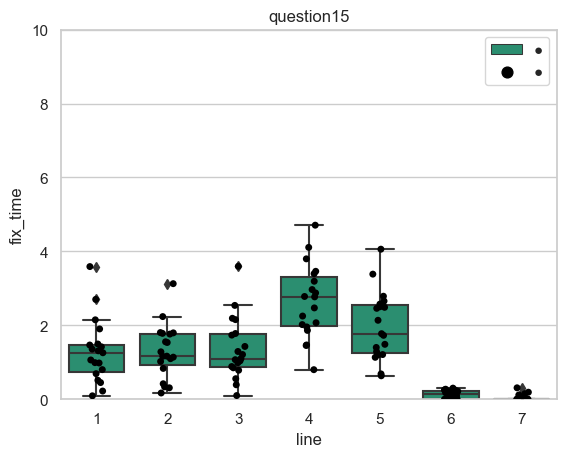

In [749]:
for i in range(1,16):
    fix_plot3(i)